In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
plt.rc('font',size=14)
sns.set(style='white')
sns.set(style='whitegrid',color_codes=True)
%matplotlib inline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import (RandomForestRegressor, GradientBoostingRegressor,AdaBoostRegressor,BaggingRegressor)
from sklearn.svm import SVR
from sklearn import metrics
from sklearn.ensemble import VotingRegressor
from scipy import stats
from scipy.stats import zscore
from sklearn.metrics import mean_squared_error,mean_absolute_error,r2_score
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn import preprocessing
from sklearn.preprocessing import PolynomialFeatures
from sklearn.cluster import KMeans
from sklearn.utils import resample
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
! pip install seaborn-qqplot

In [2]:
df_FE= pd.read_csv('Loan_Data.csv')

C:\Users\patry\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning: Columns (0,49) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [3]:
df_FE.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42536 entries, 0 to 42535
Columns: 151 entries, id to settlement_term
dtypes: float64(120), object(31)
memory usage: 49.0+ MB


In [4]:
threshold = 0.7
df_FE= df_FE[df_FE.columns[df_FE.isnull().mean() < threshold]]

In [5]:
df_FE.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42536 entries, 0 to 42535
Data columns (total 61 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id                          42536 non-null  object 
 1   loan_amnt                   42535 non-null  float64
 2   funded_amnt                 42535 non-null  float64
 3   funded_amnt_inv             42535 non-null  float64
 4   term                        42535 non-null  object 
 5   int_rate                    42535 non-null  object 
 6   installment                 42535 non-null  float64
 7   grade                       42535 non-null  object 
 8   sub_grade                   42535 non-null  object 
 9   emp_title                   39909 non-null  object 
 10  emp_length                  41423 non-null  object 
 11  home_ownership              42535 non-null  object 
 12  annual_inc                  42531 non-null  float64
 13  verification_status         425

In [6]:
# usunięcie dodatkowych niepotrzebnych wartości
df_FE.dropna( axis=1, how="all", thresh=None, subset=None, inplace=True)
df_FE.drop('emp_title', axis=1, inplace=True)
df_FE.drop('desc', axis=1, inplace=True)
df_FE.drop('mths_since_last_delinq', axis=1, inplace=True)
df_FE.drop('policy_code', axis=1, inplace=True)
df_FE.drop('chargeoff_within_12_mths', axis=1, inplace=True)
df_FE.drop('disbursement_method', axis=1, inplace=True)
df_FE.drop('last_pymnt_d', axis=1, inplace=True)
df_FE.drop('last_credit_pull_d', axis=1, inplace=True)
df_FE.drop('id', axis=1, inplace=True)
df_FE.drop('url', axis=1, inplace=True)
df_FE.drop('initial_list_status', axis=1, inplace=True)
df_FE.drop('tax_liens', axis=1, inplace=True)
df_FE.drop('acc_now_delinq', axis=1, inplace=True)
df_FE.drop('delinq_amnt', axis=1, inplace=True)
df_FE.drop('application_type', axis=1, inplace=True)
df_FE.drop('zip_code', axis=1, inplace=True)
df_FE = df_FE.drop(39786)
df_FE.drop('sub_grade', axis=1, inplace=True)
df_FE.drop('grade', axis=1, inplace=True)
df_FE.drop('collections_12_mths_ex_med', axis=1, inplace=True)
df_FE.drop('pymnt_plan', axis=1, inplace=True)
df_FE.drop('out_prncp', axis=1, inplace=True)
df_FE.drop('out_prncp_inv', axis=1, inplace=True)
df_FE.drop('addr_state', axis=1, inplace=True)

In [7]:
df_FE['int_rate'] = df_FE['int_rate'].str.rstrip('%').astype('float')
df_FE['term'] = df_FE['term'].str.rstrip('months').astype('float')
df_FE['emp_length'] = df_FE['emp_length'].str.rstrip('years')
df_FE['emp_length'] = df_FE['emp_length'].str.rstrip('year')
df_FE['revol_util'] = df_FE['revol_util'].str.rstrip('%').astype('float')
df_FE['emp_length']=df_FE['emp_length'].str.replace('< 1','0')
df_FE['emp_length']=df_FE['emp_length'].str.replace('+','')
df_FE['emp_length'] = df_FE['emp_length'].str.rstrip('').astype('float')
df_FE['annual_inc']=df_FE['annual_inc'].fillna(df_FE['annual_inc'].mean())
df_FE['delinq_2yrs']=df_FE['delinq_2yrs'].fillna(df_FE['delinq_2yrs'].median())
df_FE['inq_last_6mths']=df_FE['inq_last_6mths'].fillna(df_FE['inq_last_6mths'].mean())
df_FE['open_acc']=df_FE['open_acc'].fillna(df_FE['open_acc'].mean())
df_FE['pub_rec']=df_FE['pub_rec'].fillna(df_FE['pub_rec'].median())
df_FE['pub_rec_bankruptcies']=df_FE['pub_rec_bankruptcies'].fillna(df_FE['pub_rec_bankruptcies'].median())
df_FE['total_acc']=df_FE['total_acc'].fillna(df_FE['total_acc'].mean())
df_FE['revol_util']=df_FE['revol_util'].fillna(df_FE['revol_util'].mean())
df_FE['earliest_cr_line']=df_FE['earliest_cr_line'].fillna('Oct-1999') # df_FE['earliest_cr_line'].mode()
df_FE['emp_length']=df_FE['emp_length'].fillna(df_FE['emp_length'].mean())
df_FE['title']=df_FE['title'].fillna('other')

C:\Users\patry\AppData\Local\Temp/ipykernel_4320/1313697432.py:7: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df_FE['emp_length']=df_FE['emp_length'].str.replace('+','')


In [8]:
#1 zmienna- miesiąc w którym wzięto pierwszą pożyczkę
df_FE['earliest_cr_line_month']=df_FE.earliest_cr_line.str[0:3]

def zamiana(earliest_cr_line_month):        
        if earliest_cr_line_month=='Jan': return 1
        if earliest_cr_line_month=='Feb': return 2
        if earliest_cr_line_month=='Mar': return 3
        if earliest_cr_line_month=='Apr': return 4
        if earliest_cr_line_month=='May': return 5
        if earliest_cr_line_month=='Jun': return 6
        if earliest_cr_line_month=='Jul': return 7
        if earliest_cr_line_month=='Aug': return 8
        if earliest_cr_line_month=='Sep': return 9
        if earliest_cr_line_month=='Oct': return 10
        if earliest_cr_line_month=='Nov': return 11
        elif earliest_cr_line_month=='Dec': return 12
        

df_FE.earliest_cr_line_month=df_FE.earliest_cr_line_month.apply(zamiana) 

In [9]:
#2 zmienna- rok w którym wzięto pierwszą pożyczkę
df_FE['earliest_cr_line_year']=df_FE.earliest_cr_line.str[4:]
df_FE['earliest_cr_line_year'] = df_FE['earliest_cr_line_year'].str.rstrip(' ').astype('float')

In [10]:
#3 historia kredytowa pożyczkobiorcy w latach
df_FE['earliest_cr_line_YEARS']= 2011 - df_FE['earliest_cr_line_year']

In [11]:
#4 zmienna- miesiąc w którym przyznano pożyczkę
df_FE['issue_d_month']=df_FE.earliest_cr_line.str[0:3]

def zamiana(issue_d_month):        
        if issue_d_month=='Jan': return 1
        if issue_d_month=='Feb': return 2
        if issue_d_month=='Mar': return 3
        if issue_d_month=='Apr': return 4
        if issue_d_month=='May': return 5
        if issue_d_month=='Jun': return 6
        if issue_d_month=='Jul': return 7
        if issue_d_month=='Aug': return 8
        if issue_d_month=='Sep': return 9
        if issue_d_month=='Oct': return 10
        if issue_d_month=='Nov': return 11
        elif issue_d_month=='Dec': return 12
        

df_FE.issue_d_month=df_FE.issue_d_month.apply(zamiana) 

In [12]:
#5 zmienna- rok w którym przyznano pożyczkę
df_FE['issue_d_YEAR']=df_FE.earliest_cr_line.str[4:]
df_FE['issue_d_YEAR'] = df_FE['issue_d_YEAR'].str.rstrip(' ').astype('float')

In [13]:
#6 zmienna-ile lat temu przyznano pożyczke
df_FE['issue_d_YEARS']=2011 - df_FE['issue_d_YEAR'] 

In [14]:
#7 zmienna- średnia wartość FICO (FICO_low +FICO_high/2)
df_FE['fico_range_mean']=(df_FE.fico_range_low+df_FE.fico_range_high)/2

In [15]:
# 8 zmienna- średnia wartość ostatniego FICO
df_FE['last_fico_range_mean']=(df_FE.last_fico_range_low+df_FE.last_fico_range_high)/2

In [16]:
# 9 zmienna - podział na wysokość pożyczki
def wielkosc(loan_amnt):
        if loan_amnt < 10000: return 'Niska'
        elif loan_amnt >= 10000 and loan_amnt < 20000: return 'Srednia'
        elif loan_amnt >= 20000 and loan_amnt < 30000: return 'Wysoka'
        elif loan_amnt >= 30000: return 'Bardzo wysoka'
        
df_FE.insert(43,'loan_amnt_rating',df_FE.loan_amnt.apply(wielkosc))

In [17]:
#10 zmienna- zmienna- Kwota odsetek
df_FE['int_amnt']=df_FE['total_pymnt']-df_FE['loan_amnt']

In [18]:
#11 zmienna- roczna spłata kredytu
df_FE['annual_installment']=df_FE['installment']*12

In [19]:
#12 zmienna- % rocznego dochodu jaki stanowi rata kredytu
df_FE['percent_annual_inc']=(df_FE['annual_installment']/df_FE['annual_inc'])*100

In [20]:
# 13 zmienna - klasyfikacja współczynnika fico_range_high
def wielkosc(fico_range_high):
        if fico_range_high < 580: return 'Poor'
        elif fico_range_high >= 580 and fico_range_high <= 669: return 'Fair'
        elif fico_range_high >= 670 and fico_range_high <= 739: return 'Good'
        elif fico_range_high >= 740 and fico_range_high <= 799: return 'Very Good'
        elif fico_range_high >= 800: return 'Excellent'
        
df_FE.insert(44,'fico_range_high_rating',df_FE.fico_range_high.apply(wielkosc))

In [21]:
# 14 zmienna - klasyfikacja współczynnika last_fico_range_high
def wielkosc(last_fico_range_high):
        if last_fico_range_high < 580: return 'Poor'
        elif last_fico_range_high >= 580 and last_fico_range_high <= 669: return 'Fair'
        elif last_fico_range_high >= 670 and last_fico_range_high <= 739: return 'Good'
        elif last_fico_range_high >= 740 and last_fico_range_high <= 799: return 'Very Good'
        elif last_fico_range_high >= 800: return 'Excellent'
        
df_FE.insert(44,'last_fico_range_high_rating',df_FE.last_fico_range_high.apply(wielkosc))

In [22]:
# 15 zmienna- współczynnik finansowy, otrzymana kwota pożyczki do wnioskowanej financial_ratio
df_FE['financial_ratio']=(df_FE['funded_amnt']/df_FE['loan_amnt'])

In [23]:
# 16 zmienna- czy kredyt był konsolidacyjny debt_consolidation
def konsolidacja(purpose):
        if purpose =='debt_consolidation': return 1
        else: return 0
        
df_FE.insert(44,'debt_consolidation',df_FE.purpose.apply(konsolidacja))

In [24]:
# 17 zmienna- czy kredyt był na spłatę karty kredytowej credit_card
def karta(purpose):
        if purpose =='credit_card': return 1
        else: return 0
        
df_FE.insert(44,'credit_card',df_FE.purpose.apply(karta))

In [25]:
# 18 zmienna- czy kredyt był na spłatę karty kredytowej small_business
def firma(purpose):
        if purpose =='small_business': return 1
        else: return 0
        
df_FE.insert(44,'small_business',df_FE.purpose.apply(firma))

In [26]:
# 19 zmienna- ile liter mial opis kredytu expl
df_FE['expl']=df_FE.title.str.len()

In [27]:
# 20 zmienna- ile liter mial opis kredytu leng_expl
def opis(expl):
        if expl <=4: return 'Very Poor'
        elif expl >=5 and expl <=15: return 'Poor'
        elif expl >= 16 and expl <= 29: return 'Satisfactory'
        elif expl >= 30: return 'Sofisticated'
        
df_FE.insert(57,'leng_expl',df_FE.expl.apply(opis))

In [28]:
df_FE.drop('issue_d', axis=1, inplace=True)# ta kolumna już nie jest potrzebna 
df_FE.drop('earliest_cr_line', axis=1, inplace=True)#ta kolumna już nie jest potrzebna
df_FE.drop('hardship_flag', axis=1, inplace=True)# posiada tą samą wartość
df_FE.drop('title', axis=1, inplace=True)# ta kolumna już nie jest potrzebna 

In [29]:
# Ujednolicenie wartosci splacony/niesplacony

def zamiana(loan_status):        
        if loan_status=='Fully Paid': return 1
        if loan_status=='Charged Off': return 0
        if loan_status=='Does not meet the credit policy. Status:Fully Paid': return 1
        if loan_status=='Does not meet the credit policy. Status:Charged Off': return 0

df_FE.loan_status=df_FE.loan_status.apply(zamiana) 

In [30]:
df_FE=df_FE[['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'emp_length', 'home_ownership', 'annual_inc',
       'verification_status', 'purpose', 'dti', 'delinq_2yrs',
       'fico_range_low', 'fico_range_high', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp',
       'total_rec_int', 'total_rec_late_fee', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_amnt', 'last_fico_range_high',
       'last_fico_range_low', 'pub_rec_bankruptcies', 'debt_settlement_flag',
       'earliest_cr_line_month', 'earliest_cr_line_year',
       'earliest_cr_line_YEARS', 'loan_amnt_rating', 'small_business',
       'credit_card', 'debt_consolidation', 'last_fico_range_high_rating',
       'fico_range_high_rating', 'issue_d_month', 'issue_d_YEAR',
       'issue_d_YEARS', 'fico_range_mean', 'last_fico_range_mean', 'int_amnt',
       'annual_installment', 'percent_annual_inc', 'financial_ratio',
       'leng_expl', 'expl', 'loan_status']]

In [31]:
df_FE2=df_FE.copy()

In [32]:
#Zmiana wartości kategorycznych na numeryczne (df_FE2)
from sklearn.preprocessing import LabelEncoder

cols = ('home_ownership',  'verification_status', 'purpose','fico_range_high_rating','last_fico_range_high_rating','debt_settlement_flag','loan_amnt_rating','leng_expl')

for c in cols:
    lbl = LabelEncoder() 
    lbl.fit(list(df_FE2[c].values)) 
    df_FE2[c] = lbl.transform(list(df_FE2[c].values))

In [33]:
#One hot-encoding1
df_dummies = pd.get_dummies(df_FE.drop('loan_status',axis=1))
target = df_FE2.loan_status

### Badanie wartości odstających

<AxesSubplot:>

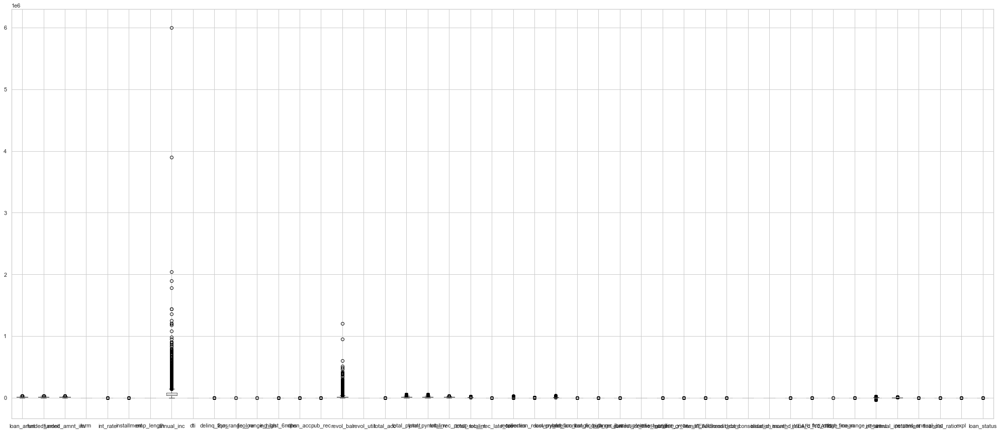

In [34]:
df_FE.boxplot(figsize=(35,15))

In [35]:
print('Number of outliers in last_fico_range_high: ',df_FE[((df_FE.last_fico_range_high - df_FE.last_fico_range_high.mean()) / df_FE.last_fico_range_high.std()).abs() >3]['last_fico_range_high'].count())
print('Number of outliers in fico_range_high: ',df_FE[((df_FE.fico_range_high - df_FE.fico_range_high.mean()) / df_FE.fico_range_high.std()).abs() >3]['fico_range_high'].count())
print('Number of outliers in earliest_cr_line_YEARS: ',df_FE[((df_FE.earliest_cr_line_YEARS - df_FE.earliest_cr_line_YEARS.mean()) / df_FE.earliest_cr_line_YEARS.std()).abs() >3]['earliest_cr_line_YEARS'].count())
print('Number of outliers in annual_inc: ',df_FE[((df_FE.annual_inc - df_FE.annual_inc.mean()) / df_FE.annual_inc.std()).abs() >3]['annual_inc'].count())
print('Number of outliers in loan_amnt: ',df_FE[((df_FE.loan_amnt - df_FE.loan_amnt.mean()) / df_FE.loan_amnt.std()).abs() >3]['loan_amnt'].count())
print('Number of outliers in revol_bal: ',df_FE[((df_FE.revol_bal - df_FE.revol_bal.mean()) / df_FE.revol_bal.std()).abs() >3]['revol_bal'].count())

Number of outliers in last_fico_range_high:  24
Number of outliers in fico_range_high:  3
Number of outliers in earliest_cr_line_YEARS:  631
Number of outliers in annual_inc:  341
Number of outliers in loan_amnt:  729
Number of outliers in revol_bal:  678


In [36]:
df_FE3=df_FE2.copy()

In [37]:
#Zastępowanie wartości odstających medianą
for col_name in df_FE3.columns[:-1]:
    q1 = df_FE3[col_name].quantile(0.25)
    q3 = df_FE3[col_name].quantile(0.75)
    iqr = q3 - q1
    
    low = q1-1.5*iqr
    high = q3+1.5*iqr
    df_FE3.loc[(df_FE3[col_name] < low) | (df_FE3[col_name] > high), col_name] = df_FE3[col_name].median()

<AxesSubplot:>

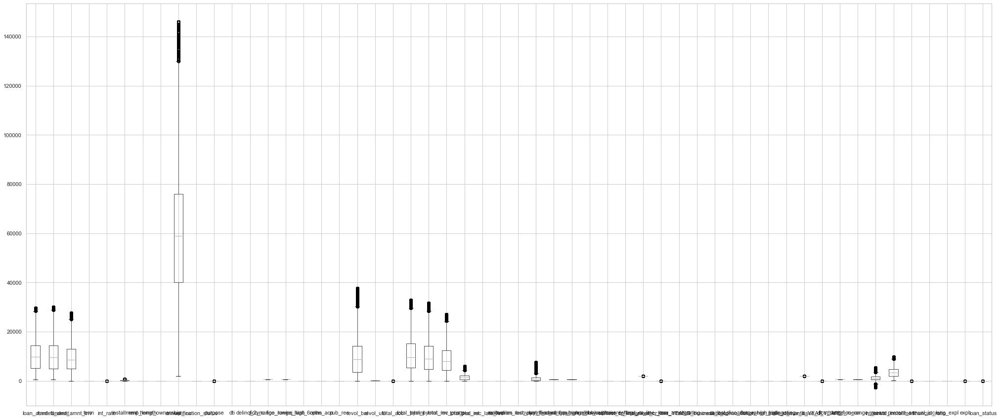

In [38]:
df_FE3.boxplot(figsize=(35,15))

In [39]:
print('Number of outliers in last_fico_range_high: ',df_FE3[((df_FE3.last_fico_range_high - df_FE3.last_fico_range_high.mean()) / df_FE3.last_fico_range_high.std()).abs() >3]['last_fico_range_high'].count())
print('Number of outliers in fico_range_high: ',df_FE3[((df_FE3.fico_range_high - df_FE3.fico_range_high.mean()) / df_FE3.fico_range_high.std()).abs() >3]['fico_range_high'].count())
print('Number of outliers in earliest_cr_line_YEARS: ',df_FE3[((df_FE3.earliest_cr_line_YEARS - df_FE3.earliest_cr_line_YEARS.mean()) / df_FE3.earliest_cr_line_YEARS.std()).abs() >3]['earliest_cr_line_YEARS'].count())
print('Number of outliers in annual_inc: ',df_FE3[((df_FE3.annual_inc - df_FE3.annual_inc.mean()) / df_FE3.annual_inc.std()).abs() >3]['annual_inc'].count())
print('Number of outliers in loan_amnt: ',df_FE3[((df_FE3.loan_amnt - df_FE3.loan_amnt.mean()) / df_FE3.loan_amnt.std()).abs() >3]['loan_amnt'].count())
print('Number of outliers in revol_bal: ',df_FE3[((df_FE3.revol_bal - df_FE3.revol_bal.mean()) / df_FE3.revol_bal.std()).abs() >3]['revol_bal'].count())

Number of outliers in last_fico_range_high:  0
Number of outliers in fico_range_high:  0
Number of outliers in earliest_cr_line_YEARS:  0
Number of outliers in annual_inc:  133
Number of outliers in loan_amnt:  14
Number of outliers in revol_bal:  401


Metoda ta znacząco zredukowała ilość odstających wartości dla większości cech.

In [40]:
df_FE4=df_FE2.copy()

In [41]:
# Usunięcie wszystkich wartości odstających - dla porównania
from scipy import stats

z = np.abs(stats.zscore(df_FE4[['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'emp_length', 'home_ownership', 'annual_inc',
       'verification_status', 'purpose', 'dti', 'delinq_2yrs',
       'fico_range_low', 'fico_range_high', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp',
       'total_rec_int', 'total_rec_late_fee', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_amnt', 'last_fico_range_high',
       'last_fico_range_low', 'pub_rec_bankruptcies', 'debt_settlement_flag',
       'earliest_cr_line_month', 'earliest_cr_line_year',
       'earliest_cr_line_YEARS', 'loan_amnt_rating', 'small_business',
       'credit_card', 'debt_consolidation', 'last_fico_range_high_rating',
       'fico_range_high_rating', 'issue_d_month', 'issue_d_YEAR',
       'issue_d_YEARS', 'fico_range_mean', 'last_fico_range_mean', 'int_amnt',
       'annual_installment', 'percent_annual_inc', 'financial_ratio',
       'leng_expl', 'expl']]))
print(z)

print("\n")
print("*******************************************************************************")
print("\n")

# threshold = 3  # selecting 3 as the threshold to identify outliers
print('Ponizej sa punkty odstajace - nr indeksow i odpowiadające im indeksy kolumn w drugim wektorze')
print("\n")
print(np.where(z > 3))

       loan_amnt  funded_amnt  funded_amnt_inv      term  int_rate  \
0       0.821731     0.814569         0.724242  0.590645  0.408592   
1       1.159074     1.164374         1.071293  1.693064  0.837399   
2       1.172567     1.178366         1.085315  0.590645  1.023488   
3       0.147044     0.114958         0.019623  0.590645  0.357342   
4       1.091605     1.094413         1.001181  1.693064  0.141586   
...          ...          ...              ...       ...       ...   
42531   1.024136     1.024452         1.390299  0.590645  0.508379   
42532   1.361480     1.374258         1.421849  0.590645  0.680984   
42533   1.155700     1.160876         1.390299  0.590645  0.764590   
42534   0.619325     0.604686         1.421849  0.590645  1.020800   
42535   0.821731     0.814569         1.421849  0.590645  1.190708   

       installment  emp_length  home_ownership    annual_inc  \
0         0.764644    1.441655        0.965107  7.042399e-01   
1         1.257836    1.397974 

In [42]:
df_FE4.shape

(42535, 54)

In [43]:
df_FE4_outliers_removed = df_FE4[(z<3).all(axis=1)]

In [44]:
df_FE4_outliers_removed.shape

(29187, 54)

<AxesSubplot:>

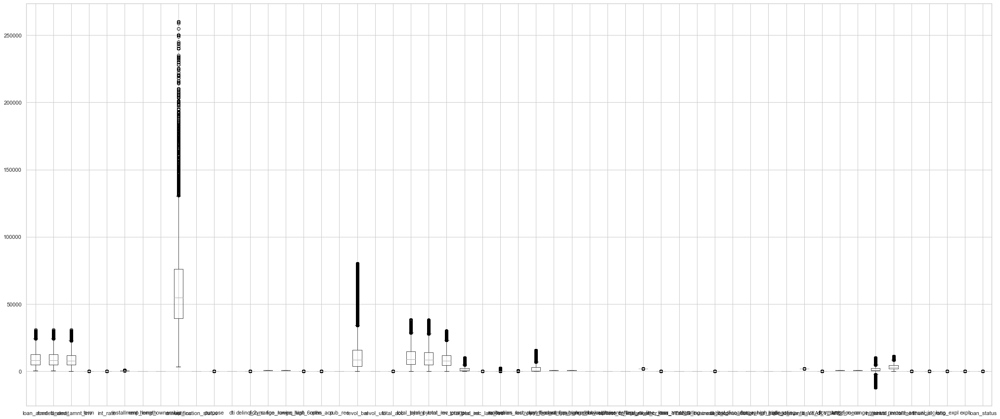

In [45]:
df_FE4_outliers_removed.boxplot(figsize=(35,15))

In [46]:
print('Number of outliers in last_fico_range_high: ',df_FE4_outliers_removed[((df_FE4_outliers_removed.last_fico_range_high - df_FE4_outliers_removed.last_fico_range_high.mean()) / df_FE4_outliers_removed.last_fico_range_high.std()).abs() >3]['last_fico_range_high'].count())
print('Number of outliers in fico_range_high: ',df_FE4_outliers_removed[((df_FE4_outliers_removed.fico_range_high - df_FE4_outliers_removed.fico_range_high.mean()) / df_FE4_outliers_removed.fico_range_high.std()).abs() >3]['fico_range_high'].count())
print('Number of outliers in earliest_cr_line_YEARS: ',df_FE4_outliers_removed[((df_FE4_outliers_removed.earliest_cr_line_YEARS - df_FE4.earliest_cr_line_YEARS.mean()) / df_FE4_outliers_removed.earliest_cr_line_YEARS.std()).abs() >3]['earliest_cr_line_YEARS'].count())
print('Number of outliers in annual_inc: ',df_FE4_outliers_removed[((df_FE4_outliers_removed.annual_inc - df_FE4_outliers_removed.annual_inc.mean()) / df_FE4_outliers_removed.annual_inc.std()).abs() >3]['annual_inc'].count())
print('Number of outliers in loan_amnt: ',df_FE4_outliers_removed[((df_FE4_outliers_removed.loan_amnt - df_FE4_outliers_removed.loan_amnt.mean()) / df_FE4_outliers_removed.loan_amnt.std()).abs() >3]['loan_amnt'].count())
print('Number of outliers in revol_bal: ',df_FE4_outliers_removed[((df_FE4_outliers_removed.revol_bal - df_FE4_outliers_removed.revol_bal.mean()) / df_FE4_outliers_removed.revol_bal.std()).abs() >3]['revol_bal'].count())

Number of outliers in last_fico_range_high:  0
Number of outliers in fico_range_high:  0
Number of outliers in earliest_cr_line_YEARS:  167
Number of outliers in annual_inc:  476
Number of outliers in loan_amnt:  102
Number of outliers in revol_bal:  663


In [47]:
df_FE4=df_FE4_outliers_removed

In [48]:
df_FE5=df_FE2.copy()

In [49]:
#Usuwanie wybranych wartości odstających - dla porównania

z = np.abs(stats.zscore(df_FE5[['loan_amnt', 'annual_inc',
        'fico_range_high', 'revol_bal', 'last_fico_range_high',
       'earliest_cr_line_YEARS']]))
print(z)

print("\n")
print("*******************************************************************************")
print("\n")

# threshold = 3  # selecting 3 as the threshold to identify outliers
print('Ponizej sa punkty odstajace - nr indeksow i odpowiadające im indeksy kolumn w drugim wektorze')
print("\n")
print(np.where(z > 3))

       loan_amnt    annual_inc  fico_range_high  revol_bal  \
0       0.821731  7.042399e-01         0.606484   0.029515   
1       1.159074  6.106254e-01         0.744651   0.572748   
2       1.172567  8.875373e-01         0.606484   0.515113   
3       0.147044  3.110587e-01         0.637022   0.395122   
4       1.091605  1.694961e-01         0.498854   0.612455   
...          ...           ...              ...        ...   
42531   1.024136  1.729739e+00         0.775189   0.649366   
42532   1.361480  8.914691e-01         0.498854   0.649366   
42533   1.155700  6.375690e-01         0.084352   0.649366   
42534   0.619325  9.081809e-16         0.744651   0.649366   
42535   0.821731  1.347182e-02         1.573655   0.649366   

       last_fico_range_high  earliest_cr_line_YEARS  
0                  0.607266                1.694115  
1                  2.362401                0.353270  
2                  0.607266                0.645754  
3                  1.063172            

In [50]:
df_FE5.shape

(42535, 54)

In [51]:
df_FE5_outliers_removed = df_FE5[(z<3).all(axis=1)]

In [52]:
df_FE5_outliers_removed.shape

(40325, 54)

In [53]:
print('Number of outliers in last_fico_range_high: ',df_FE5_outliers_removed[((df_FE5_outliers_removed.last_fico_range_high - df_FE5_outliers_removed.last_fico_range_high.mean()) / df_FE5_outliers_removed.last_fico_range_high.std()).abs() >3]['last_fico_range_high'].count())
print('Number of outliers in fico_range_high: ',df_FE5_outliers_removed[((df_FE5_outliers_removed.fico_range_high - df_FE5.fico_range_high.mean()) / df_FE5.fico_range_high.std()).abs() >3]['fico_range_high'].count())
print('Number of outliers in earliest_cr_line_YEARS: ',df_FE5_outliers_removed[((df_FE5_outliers_removed.earliest_cr_line_YEARS - df_FE5_outliers_removed.earliest_cr_line_YEARS.mean()) / df_FE5_outliers_removed.earliest_cr_line_YEARS.std()).abs() >3]['earliest_cr_line_YEARS'].count())
print('Number of outliers in annual_inc: ',df_FE5_outliers_removed[((df_FE5_outliers_removed.annual_inc - df_FE5_outliers_removed.annual_inc.mean()) / df_FE5_outliers_removed.annual_inc.std()).abs() >3]['annual_inc'].count())
print('Number of outliers in loan_amnt: ',df_FE5_outliers_removed[((df_FE5_outliers_removed.loan_amnt - df_FE5_outliers_removed.loan_amnt.mean()) / df_FE5_outliers_removed.loan_amnt.std()).abs() >3]['loan_amnt'].count())
print('Number of outliers in revol_bal: ',df_FE5_outliers_removed[((df_FE5_outliers_removed.revol_bal - df_FE5_outliers_removed.revol_bal.mean()) / df_FE5_outliers_removed.revol_bal.std()).abs() >3]['revol_bal'].count())

Number of outliers in last_fico_range_high:  0
Number of outliers in fico_range_high:  0
Number of outliers in earliest_cr_line_YEARS:  273
Number of outliers in annual_inc:  725
Number of outliers in loan_amnt:  92
Number of outliers in revol_bal:  938


<AxesSubplot:>

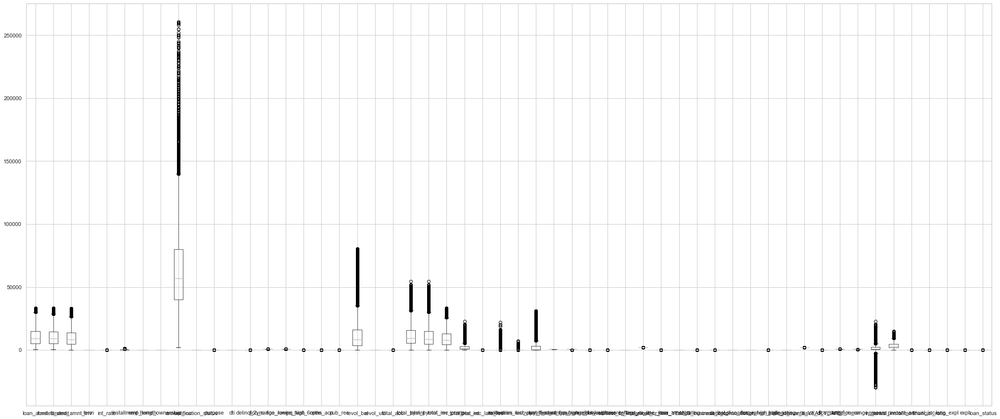

In [54]:
df_FE5_outliers_removed.boxplot(figsize=(35,15))

Metoda polegająca na usunięciu kilku kolumn z wartościami skrajnych odsłoniła kolejne wartości odstające. W tym przypadku lepsze jest usuwanie wartości odstających ze wszystkich kolumn.

In [55]:
df_FE6=df_FE2.copy()

In [56]:
#Zastępowanie wartości odstających średnią
for col_name in df_FE6.columns[:-1]:
    q1 = df_FE6[col_name].quantile(0.25)
    q3 = df_FE6[col_name].quantile(0.75)
    iqr = q3 - q1
    
    low = q1-1.5*iqr
    high = q3+1.5*iqr
    df_FE6.loc[(df_FE6[col_name] < low) | (df_FE6[col_name] > high), col_name] = df_FE6[col_name].mean()

<AxesSubplot:>

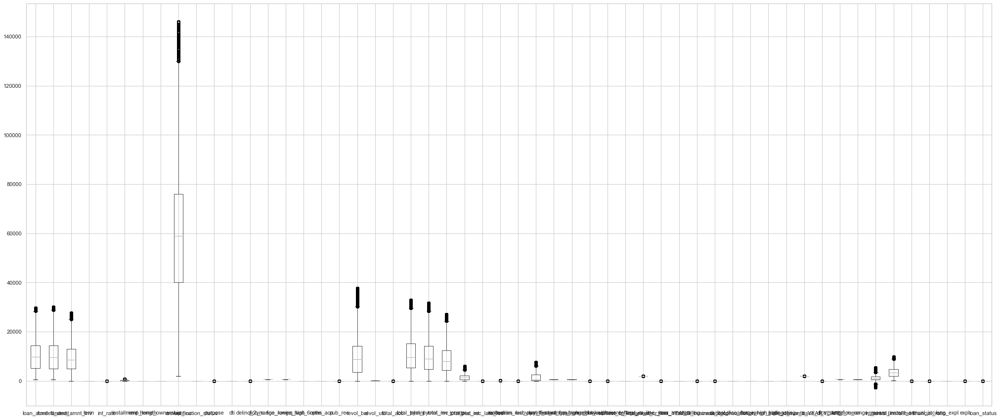

In [57]:
df_FE6.boxplot(figsize=(35,15))

In [58]:
print('Number of outliers in last_fico_range_high: ',df_FE6[((df_FE6.last_fico_range_high - df_FE6.last_fico_range_high.mean()) / df_FE6.last_fico_range_high.std()).abs() >3]['last_fico_range_high'].count())
print('Number of outliers in fico_range_high: ',df_FE6[((df_FE6.fico_range_high - df_FE6.fico_range_high.mean()) / df_FE6.fico_range_high.std()).abs() >3]['fico_range_high'].count())
print('Number of outliers in earliest_cr_line_YEARS: ',df_FE6[((df_FE6.earliest_cr_line_YEARS - df_FE6.earliest_cr_line_YEARS.mean()) / df_FE6.earliest_cr_line_YEARS.std()).abs() >3]['earliest_cr_line_YEARS'].count())
print('Number of outliers in annual_inc: ',df_FE6[((df_FE6.annual_inc - df_FE6.annual_inc.mean()) / df_FE6.annual_inc.std()).abs() >3]['annual_inc'].count())
print('Number of outliers in loan_amnt: ',df_FE6[((df_FE6.loan_amnt - df_FE6.loan_amnt.mean()) / df_FE6.loan_amnt.std()).abs() >3]['loan_amnt'].count())
print('Number of outliers in revol_bal: ',df_FE6[((df_FE6.revol_bal - df_FE6.revol_bal.mean()) / df_FE6.revol_bal.std()).abs() >3]['revol_bal'].count())

Number of outliers in last_fico_range_high:  0
Number of outliers in fico_range_high:  0
Number of outliers in earliest_cr_line_YEARS:  0
Number of outliers in annual_inc:  86
Number of outliers in loan_amnt:  14
Number of outliers in revol_bal:  288


Uzupełnienie wartości odstających wartością średnią najlepiej zredukowała ilość wartości odstających.

## Wytrenuj 5 różnych modeli, wykorzystując do każdego inny algorytm, a następnie porównaj ich działanie, za metrykę oceny jakości modelu przyjmij AUROC score

## Regresja logistyczna

##### Bez usuwania wartości odstających

In [59]:
from sklearn.model_selection import train_test_split

X = df_FE2.iloc[:, :-1]
y= df_FE2.iloc[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [60]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(solver = 'lbfgs')

In [61]:
logisticRegr.fit(X, y)

C:\Users\patry\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [62]:
score = logisticRegr.score(X_test, y_test)
print(score)

0.9988245435310712


In [63]:
predictions = logisticRegr.predict(X_test)

In [64]:
predictions

array([1, 1, 1, ..., 1, 0, 1], dtype=int64)

In [65]:
import numpy as np 
import matplotlib.pyplot as plt
index = 0
misclassifiedIndexes = []
for label, predict in zip(y_test, predictions):
    if label != predict:
        misclassifiedIndexes.append(index)
        index +=1

In [66]:
misclass = y_test!=predictions

In [67]:
misclass

19496    False
11187    False
17617    False
322      False
21334    False
         ...  
40373    False
34982    False
24719    False
16975    False
32877    False
Name: loan_status, Length: 12761, dtype: bool

In [68]:
misclass = pd.Series(misclass)
misclass= misclass[misclass==True]
misclass.index

Int64Index([20196, 23329, 28463, 42279,  2680, 17149, 21945, 17608, 38830,
            24095, 28118, 38763,   361,  3610,  4540],
           dtype='int64')

In [69]:
predictions = pd.Series(predictions) 

In [70]:
predictions.index = y_test.index

In [71]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
cm = metrics.confusion_matrix(y_test, predictions)
print(cm)

[[ 1858    13]
 [    2 10888]]


In [463]:
print('Precision:', 1858/(1858+2))
print('Recall:', 1858/(1858+13))
print('Specificity:', 10888/(10888+2))

Precision: 0.9989247311827957
Recall: 0.9930518439337253
Specificity: 0.9998163452708907


*  TP – liczba obserwacji, które były prawdziwe i zostały wskazane jako prawdziwe - 1858
*  FP – liczba obserwacji które były fałszywe, a zostały wskazane jako prawdziwe - 13
*  FN – liczba obserwacji które były prawdziwe, ale zostały wskazane jako fałszywe - 2
*  TN – liczba obserwacji które były fałszywe i zostały wskazane jako fałszywe - 10888

In [72]:
predictions = logisticRegr.predict(X_test)
expected=y_test
accuracy = metrics.accuracy_score(predictions, y_test)
print("Accuracy : %s" % "{0:.3%}".format(accuracy))

Accuracy : 99.882%


In [73]:
from sklearn.metrics import classification_report,confusion_matrix

def evaluate(predictions,y_test): 
    result = classification_report(y_test,predictions,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [74]:
result = classification_report(y_test,predictions,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [75]:
roc_auc=metrics.roc_auc_score(predictions,y_test)

In [76]:
results = pd.DataFrame({'DataFrame':['Bez modyfikacji'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUC_ROC':[roc_auc]},index={'1'})
results = results[['DataFrame', 'accuracy', 'f1-score', 'AUC_ROC']]

results

,DataFrame,accuracy,f1-score,AUC_ROC
1,Bez modyfikacji,0.998825,0.999312,0.998866


Wytrenowany model ma wysoką trafność, czułość oraz specyficzność (prawdopodobieństwo niespłacenia pożyczki w przypadku klientów z wyższą zdolnością kredytową). Model posiada także bardzo wysoki wskaźnik AUROC i wysoką dokładność.

##### Mediana

In [77]:
from sklearn.model_selection import train_test_split

X2=df_FE3.iloc[:, :-1]
y2=df_FE3.iloc[:, -1]

X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.3, random_state=42)

In [78]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(solver = 'lbfgs', random_state=1)

In [79]:
logisticRegr.fit(X2_train, y2_train)

C:\Users\patry\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(random_state=1)

In [80]:
score = logisticRegr.score(X2_test, y2_test)
print(score)

0.9699866781600188


In [81]:
predictions2 = logisticRegr.predict(X2_test)

In [82]:
predictions2

array([1, 1, 1, ..., 1, 0, 1], dtype=int64)

In [83]:
import numpy as np 
import matplotlib.pyplot as plt
index = 0
misclassifiedIndexes = []
for label, predict in zip(y2_test, predictions2):
    if label != predict:
        misclassifiedIndexes.append(index)
        index +=1

In [84]:
misclass = y2_test!=predictions2

In [85]:
misclass

19496    False
11187    False
17617    False
322      False
21334    False
         ...  
40373    False
34982    False
24719    False
16975    False
32877    False
Name: loan_status, Length: 12761, dtype: bool

In [86]:
misclass = pd.Series(misclass)
misclass= misclass[misclass==True]
misclass.index

Int64Index([ 5434, 38836, 24126, 42298, 36988, 18973, 41675, 13985, 21412,
            41689,
            ...
             8979, 15854, 38535, 32636,  7204, 33430, 15652, 39969, 33886,
            20296],
           dtype='int64', length=383)

In [87]:
predictions2 = pd.Series(predictions2) 

In [88]:
predictions2.index = y2_test.index

In [89]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
cm = metrics.confusion_matrix(y2_test, predictions2)
print(cm)

[[ 1575   296]
 [   87 10803]]


*  TP – liczba obserwacji, które były prawdziwe i zostały wskazane jako prawdziwe - 1575
*  FP – liczba obserwacji które były fałszywe, a zostały wskazane jako prawdziwe - 296
*  FN – liczba obserwacji które były prawdziwe, ale zostały wskazane jako fałszywe - 87
*  TN – liczba obserwacji które były fałszywe i zostały wskazane jako fałszywe - 10803

In [464]:
print('Precision:', 1575/(1575+87))
print('Recall:', 1575/(1575+296))
print('Specificity:', 10803/(10803+87))

Precision: 0.9476534296028881
Recall: 0.8417958311063602
Specificity: 0.9920110192837466


In [90]:
predictions2 = logisticRegr.predict(X2_test)
accuracy = metrics.accuracy_score(predictions2, y2_test)
print("Accuracy : %s" % "{0:.3%}".format(accuracy))

Accuracy : 96.999%


In [91]:
def evaluate(predictions2,y2_test): 
    result = classification_report(y2_test,predictions2,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [92]:
result = classification_report(y2_test,predictions2,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [93]:
predictions2

array([1, 1, 1, ..., 1, 0, 1], dtype=int64)

In [94]:
roc_auc2=metrics.roc_auc_score(predictions2,y2_test)
roc_auc2

0.9604921801586833

In [95]:
tempResultsDflogit = pd.DataFrame({'DataFrame':['Mediana'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUC_ROC':[roc_auc2]},index={'2'})
results = pd.concat([results, tempResultsDflogit])
results = results[['DataFrame', 'accuracy', 'f1-score','AUC_ROC']]
results

,DataFrame,accuracy,f1-score,AUC_ROC
1,Bez modyfikacji,0.998825,0.999312,0.998866
2,Mediana,0.969987,0.982582,0.960492


Wytrenowany model ma wysoką trafność i czułość oraz niższą specyficzność (prawdopodobieństwo niespłacenia pożyczki w przypadku klientów z wyższą zdolnością kredytową). Model posiada także bardzo wysoki wskaźnik AUROC i wysoką dokładność. Jednak otrzymane wartosci sa nizsze niz dla modelu wyuczonego na surowych danych.

##### Usunięcie outliersów

In [96]:
from sklearn.model_selection import train_test_split

X3=df_FE4.iloc[:, :-1]
y3=df_FE4.iloc[:, -1]

X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y3, test_size=0.3, random_state=42)

In [97]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(solver = 'lbfgs', random_state=1)

In [98]:
logisticRegr.fit(X3_train, y3_train)

C:\Users\patry\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(random_state=1)

In [99]:
score = logisticRegr.score(X3_test, y3_test)
print(score)

0.9990864451296106


In [100]:
predictions3 = logisticRegr.predict(X3_test)

In [101]:
predictions3

array([1, 1, 1, ..., 0, 1, 1], dtype=int64)

In [102]:
import numpy as np 
import matplotlib.pyplot as plt
index = 0
misclassifiedIndexes = []
for label, predict in zip(y_test, predictions3):
    if label != predict:
        misclassifiedIndexes.append(index)
        index +=1

In [103]:
misclass = y3_test!=predictions3

In [104]:
misclass

10985    False
32610    False
9039     False
16640    False
38795    False
         ...  
5768     False
11329    False
31486    False
22945    False
23860    False
Name: loan_status, Length: 8757, dtype: bool

In [105]:
misclass = pd.Series(misclass)
misclass= misclass[misclass==True]
misclass.index

Int64Index([24095, 20196, 28038, 361, 12800, 11117, 10868, 24188], dtype='int64')

In [106]:
predictions3 = pd.Series(predictions3) 

In [107]:
predictions3.index = y3_test.index

In [108]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
cm = metrics.confusion_matrix(y3_test, predictions3)
print(cm)

[[ 924    7]
 [   1 7825]]


*  TP – liczba obserwacji, które były prawdziwe i zostały wskazane jako prawdziwe - 924
*  FP – liczba obserwacji które były fałszywe, a zostały wskazane jako prawdziwe - 7
*  FN – liczba obserwacji które były prawdziwe, ale zostały wskazane jako fałszywe - 1
*  TN – liczba obserwacji które były fałszywe i zostały wskazane jako fałszywe - 7825

In [465]:
print('Precision:', 924/(924+1))
print('Recall:', 924/(924+7))
print('Specificity:', 7825/(7825+1))

Precision: 0.9989189189189189
Recall: 0.9924812030075187
Specificity: 0.9998722208024534


In [456]:
predictions3 = logisticRegr.predict(X3_test)
accuracy = metrics.accuracy_score(predictions3, y3_test)
print("Accuracy : %s" % "{0:.3%}".format(accuracy))

Accuracy : 99.178%


In [110]:
def evaluate(predictions3,y3_test): 
    result = classification_report(y3_test,predictions3,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [111]:
result = classification_report(y3_test,predictions3,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [112]:
roc_auc3=metrics.roc_auc_score(predictions3,y3_test)
roc_auc3

0.9990125748833614

In [113]:
tempResultsDflogit = pd.DataFrame({'DataFrame':['Bez outliersów'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUC_ROC':[roc_auc3]},index={'2'})
results = pd.concat([results, tempResultsDflogit])
results = results[['DataFrame', 'accuracy', 'f1-score','AUC_ROC']]
results

,DataFrame,accuracy,f1-score,AUC_ROC
1,Bez modyfikacji,0.998825,0.999312,0.998866
2,Mediana,0.969987,0.982582,0.960492
2,Bez outliersów,0.999086,0.999489,0.999013


Wytrenowany model ma wysoką trafność i czułość oraz niską specyficzność (prawdopodobieństwo niespłacenia pożyczki w przypadku klientów z wyższą zdolnością kredytową). Model posiada także bardzo wysoki wskaźnik AUROC i wysoką dokładność. Model ten ma lepsze wyniki w porównaniu do modelu wytrenowanego na niemodyfikowanym DF.

##### Dummies

In [114]:
from sklearn.model_selection import train_test_split

X4=df_dummies.iloc[:, :-1]
y4=target

X4_train, X4_test, y4_train, y4_test = train_test_split(X4, y4, test_size=1/7.0, random_state=42)

In [115]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(solver = 'lbfgs')

In [116]:
logisticRegr.fit(X4_train, y4_train)

C:\Users\patry\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [117]:
score = logisticRegr.score(X4_test, y4_test)
print(score)

0.9991772256047392


In [118]:
predictions4 = logisticRegr.predict(X4_test)

In [119]:
predictions4

array([1, 1, 1, ..., 1, 1, 1], dtype=int64)

In [120]:
import numpy as np 
import matplotlib.pyplot as plt
index = 0
misclassifiedIndexes = []
for label, predict in zip(y_test, predictions3):
    if label != predict:
        misclassifiedIndexes.append(index)
        index +=1

In [121]:
misclass = y4_test!=predictions4

In [122]:
misclass

19496    False
11187    False
17617    False
322      False
21334    False
         ...  
37183    False
24062    False
21968    False
14295    False
9194     False
Name: loan_status, Length: 6077, dtype: bool

In [123]:
misclass = pd.Series(misclass)
misclass= misclass[misclass==True]
misclass.index

Int64Index([20196, 23329, 28463, 2680, 17149], dtype='int64')

In [124]:
predictions4 = pd.Series(predictions4) 

In [125]:
predictions4.index = y4_test.index

In [126]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
cm = metrics.confusion_matrix(y4_test, predictions4)
print(cm)

[[ 864    5]
 [   0 5208]]


*  TP – liczba obserwacji, które były prawdziwe i zostały wskazane jako prawdziwe - 864
*  FP – liczba obserwacji które były fałszywe, a zostały wskazane jako prawdziwe - 5
*  FN – liczba obserwacji które były prawdziwe, ale zostały wskazane jako fałszywe - 0
*  TN – liczba obserwacji które były fałszywe i zostały wskazane jako fałszywe - 5208

In [466]:
print('Precision:', 864/(864+5))
print('Recall:', 864/(864+0))
print('Specificity:', 5208/(5208+0))

Precision: 0.9942462600690449
Recall: 1.0
Specificity: 1.0


In [127]:
predictions4 = logisticRegr.predict(X4_test)
accuracy = metrics.accuracy_score(predictions4, y4_test)
print("Accuracy : %s" % "{0:.3%}".format(accuracy))

Accuracy : 99.918%


In [128]:
def evaluate(predictions4,y4_test): 
    result = classification_report(y4_test,predictions4,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [129]:
result = classification_report(y4_test,predictions4,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [130]:
roc_auc4=metrics.roc_auc_score(predictions4,y4_test)
roc_auc4

0.9995204296949933

In [131]:
tempResultsDflogit = pd.DataFrame({'DataFrame':['Dummies'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUC_ROC':[roc_auc4]},index={'4'})
results = pd.concat([results, tempResultsDflogit])
results = results[['DataFrame', 'accuracy', 'f1-score','AUC_ROC']]
results

,DataFrame,accuracy,f1-score,AUC_ROC
1,Bez modyfikacji,0.998825,0.999312,0.998866
2,Mediana,0.969987,0.982582,0.960492
2,Bez outliersów,0.999086,0.999489,0.999013
4,Dummies,0.999177,0.999520,0.999520


Wytrenowany model ma wysoką trafność i czułość oraz niską specyficzność (prawdopodobieństwo niespłacenia pożyczki w przypadku klientów z wyższą zdolnością kredytową). Model posiada także bardzo wysoki wskaźnik AUROC i wysoką dokładność wynoszącą 1. Najpeliej wytrenowany model spośród wszystkich.

##### Uzupełnienie średnią

In [132]:
from sklearn.model_selection import train_test_split

X6 = df_FE6.iloc[:, :-1]
y6= df_FE6.iloc[:, -1]

X6_train, X6_test, y6_train, y6_test = train_test_split(X6, y6, test_size=0.3, random_state=42)

In [133]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(solver = 'lbfgs')

In [134]:
logisticRegr.fit(X6, y6)

C:\Users\patry\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [135]:
score = logisticRegr.score(X6_test, y6_test)
print(score)

0.9769610532089962


In [136]:
predictions = logisticRegr.predict(X6_test)

In [137]:
predictions

array([1, 1, 1, ..., 1, 0, 1], dtype=int64)

In [138]:
import numpy as np 
import matplotlib.pyplot as plt
index = 0
misclassifiedIndexes = []
for label, predict in zip(y_test, predictions):
    if label != predict:
        misclassifiedIndexes.append(index)
        index +=1

In [139]:
misclass = y6_test!=predictions

In [140]:
misclass

19496    False
11187    False
17617    False
322      False
21334    False
         ...  
40373    False
34982    False
24719    False
16975    False
32877    False
Name: loan_status, Length: 12761, dtype: bool

In [141]:
misclass = pd.Series(misclass)
misclass= misclass[misclass==True]
misclass.index

Int64Index([ 5434, 38836,  2830, 36988, 18973, 41675, 13985, 18674, 10050,
            26130,
            ...
            24129, 12617,  8979, 38535,  6909, 33430, 39969,  4894, 33886,
            20296],
           dtype='int64', length=294)

In [142]:
predictions = pd.Series(predictions) 

In [143]:
predictions.index = y6_test.index

In [144]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
cm = metrics.confusion_matrix(y6_test, predictions)
print(cm)

[[ 1656   215]
 [   79 10811]]


*  TP – liczba obserwacji, które były prawdziwe i zostały wskazane jako prawdziwe - 1656
*  FP – liczba obserwacji które były fałszywe, a zostały wskazane jako prawdziwe - 215
*  FN – liczba obserwacji które były prawdziwe, ale zostały wskazane jako fałszywe - 79
*  TN – liczba obserwacji które były fałszywe i zostały wskazane jako fałszywe - 10811

In [467]:
print('Precision:', 1656/(1656+215))
print('Recall:', 1656/(1656+79))
print('Specificity:', 10811/(10811+79))

Precision: 0.8850881881346874
Recall: 0.9544668587896253
Specificity: 0.9927456382001837


In [145]:
predictions = logisticRegr.predict(X6_test)
expected=y6_test
accuracy = metrics.accuracy_score(predictions, y6_test)
print("Accuracy : %s" % "{0:.3%}".format(accuracy))

Accuracy : 97.696%


In [146]:
from sklearn.metrics import classification_report,confusion_matrix

def evaluate(predictions,y6_test): 
    result = classification_report(y6_test,predictions,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [147]:
result = classification_report(y6_test,predictions,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [148]:
roc_auc6=metrics.roc_auc_score(predictions,y6_test)

In [149]:
tempResultsDflogit = pd.DataFrame({'DataFrame':['Srednia'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUC_ROC':[roc_auc6]},index={'2'})
results = pd.concat([results, tempResultsDflogit])
results = results[['DataFrame', 'accuracy', 'f1-score',
'AUC_ROC']]
results

,DataFrame,accuracy,f1-score,AUC_ROC
1,Bez modyfikacji,0.998825,0.999312,0.998866
2,Mediana,0.969987,0.982582,0.960492
2,Bez outliersów,0.999086,0.999489,0.999013
4,Dummies,0.999177,0.999520,0.999520
2,Srednia,0.976961,0.986585,0.967484


Wytrenowany model ma wysoką trafność, czułość i specyficzność (prawdopodobieństwo niespłacenia pożyczki w przypadku klientów z wyższą zdolnością kredytową). Model posiada także bardzo wysoki wskaźnik AUROC i wysoką dokładność. Model ten ma niższą precyzję w porównaniu do tego wytrenowanego dla DF, w którym wartości odstające zamieniono na medianę. Z kolei model ten jest bardziej czuły od tego, w którym wartości odstające zamieniono na medianę.

In [480]:
coef=logisticRegr.coef_[0]
imp_features = pd.Series(X.columns)[list(coef!=0)]
X_train = X_train[imp_features]
X_test = X_test[imp_features]

In [487]:
print('Ilosc cech nadmiarowych:', sum(logisticRegr.coef_[0]==0))
print('Cechy nadmiarowe:', list(pd.Series(X.columns)[list(coef==0)]))

Ilosc cech nadmiarowych: 0
Cechy nadmiarowe: []


Dla tego modelu wszystkie cechy są ważne ;)

### Drzewo decyzyjne 

##### Bez usuwania wartości odstających

In [249]:
from sklearn.tree import DecisionTreeClassifier

In [625]:
X=df_FE2.iloc[:, :-1]
y=df_FE2.iloc[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=42)

In [626]:
dtree = DecisionTreeClassifier()

In [627]:
dtree.fit(X_train,y_train)

DecisionTreeClassifier()

In [628]:
print('Feature importances: \n',pd.DataFrame(dtree.feature_importances_,columns=['Imp'],index=X_train.columns))

Feature importances: 
                                   Imp
loan_amnt                    0.000129
funded_amnt                  0.000000
funded_amnt_inv              0.000000
term                         0.000000
int_rate                     0.000000
installment                  0.000000
emp_length                   0.000000
home_ownership               0.000000
annual_inc                   0.000000
verification_status          0.000000
purpose                      0.000000
dti                          0.000129
delinq_2yrs                  0.000000
fico_range_low               0.000000
fico_range_high              0.000000
inq_last_6mths               0.000129
open_acc                     0.000004
pub_rec                      0.000000
revol_bal                    0.000000
revol_util                   0.000000
total_acc                    0.000003
total_pymnt                  0.000000
total_pymnt_inv              0.000000
total_rec_prncp              0.003872
total_rec_int              

In [629]:
y_pred = dtree.predict(X_test)
# performance on train data
print('Performance on training data using DT:',dtree.score(X_train,y_train))
# performance on test data
print('Performance on testing data using DT:',dtree.score(X_test,y_test))
#Evaluate the model using accuracy
acc_DT=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_DT)
print('MSE: ',metrics.mean_squared_error(y_test, y_pred))

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.9990596348248569
Accuracy DT:  0.9924843891026293
MSE:  0.0009403651751430139


In [630]:
cm = metrics.confusion_matrix(y_test, y_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1863     8]
 [    4 10886]]
Precision: 0.9978575254418853
Recall: 0.9957242116515232
Specificity: 0.9996326905417815


*  TP – liczba obserwacji, które były prawdziwe i zostały wskazane jako prawdziwe - 280
*  FP – liczba obserwacji które były fałszywe, a zostały wskazane jako prawdziwe - 1689
*  FN – liczba obserwacji które były prawdziwe, ale zostały wskazane jako fałszywe - 1591
*  TN – liczba obserwacji które były fałszywe i zostały wskazane jako fałszywe - 9201

In [156]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import precision_score

In [157]:
print(classification_report(y_test,y_pred))

dtree_pr= evaluate(y_pred,y_test)
dtree_pr

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1871
           1       1.00      1.00      1.00     10890

    accuracy                           1.00     12761
   macro avg       1.00      1.00      1.00     12761
weighted avg       1.00      1.00      1.00     12761



{'f1-score': 1.0, 'accuracy': 1.0}

In [158]:
def evaluate(y_pred,y_test): 
    result = classification_report(y_test,y_pred,output_dict=True)
    f1 = result['1']['f1-score']

    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [159]:
metrics.roc_auc_score(y_pred,y_test)

0.9985615881294244

Wysokie wartosci wskaznikow modelu.

In [160]:
result = classification_report(y_test,y_pred,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [161]:
from IPython.display import Image  
from sklearn.tree import export_graphviz

In [162]:
features = list(df_FE2.columns[:-1])
features

['loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'term',
 'int_rate',
 'installment',
 'emp_length',
 'home_ownership',
 'annual_inc',
 'verification_status',
 'purpose',
 'dti',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low',
 'pub_rec_bankruptcies',
 'debt_settlement_flag',
 'earliest_cr_line_month',
 'earliest_cr_line_year',
 'earliest_cr_line_YEARS',
 'loan_amnt_rating',
 'small_business',
 'credit_card',
 'debt_consolidation',
 'last_fico_range_high_rating',
 'fico_range_high_rating',
 'issue_d_month',
 'issue_d_YEAR',
 'issue_d_YEARS',
 'fico_range_mean',
 'last_fico_range_mean',
 'int_amnt',
 'annual_installment',
 'percent_annual_inc',
 'financial_ratio',
 'leng_expl',
 'expl']

[Text(0.36141304347826086, 0.9642857142857143, 'X[26] <= 0.005\ngini = 0.259\nsamples = 29774\nvalue = [4560, 25214]'),
 Text(0.3179347826086957, 0.8928571428571429, 'X[23] <= 468.065\ngini = 0.003\nsamples = 25257\nvalue = [43, 25214]'),
 Text(0.27445652173913043, 0.8214285714285714, 'gini = 0.0\nsamples = 14\nvalue = [14, 0]'),
 Text(0.36141304347826086, 0.8214285714285714, 'X[32] <= 0.5\ngini = 0.002\nsamples = 25243\nvalue = [29, 25214]'),
 Text(0.3179347826086957, 0.75, 'X[47] <= -6186.776\ngini = 0.002\nsamples = 25236\nvalue = [22, 25214]'),
 Text(0.13043478260869565, 0.6785714285714286, 'X[50] <= 0.861\ngini = 0.095\nsamples = 160\nvalue = [8, 152]'),
 Text(0.08695652173913043, 0.6071428571428571, 'X[24] <= 7223.77\ngini = 0.013\nsamples = 153\nvalue = [1, 152]'),
 Text(0.043478260869565216, 0.5357142857142857, 'gini = 0.0\nsamples = 152\nvalue = [0, 152]'),
 Text(0.13043478260869565, 0.5357142857142857, 'gini = 0.0\nsamples = 1\nvalue = [1, 0]'),
 Text(0.17391304347826086, 0.6

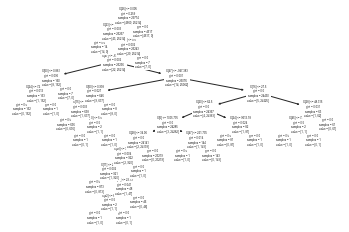

In [163]:
from sklearn import tree

tree.plot_tree(dtree)

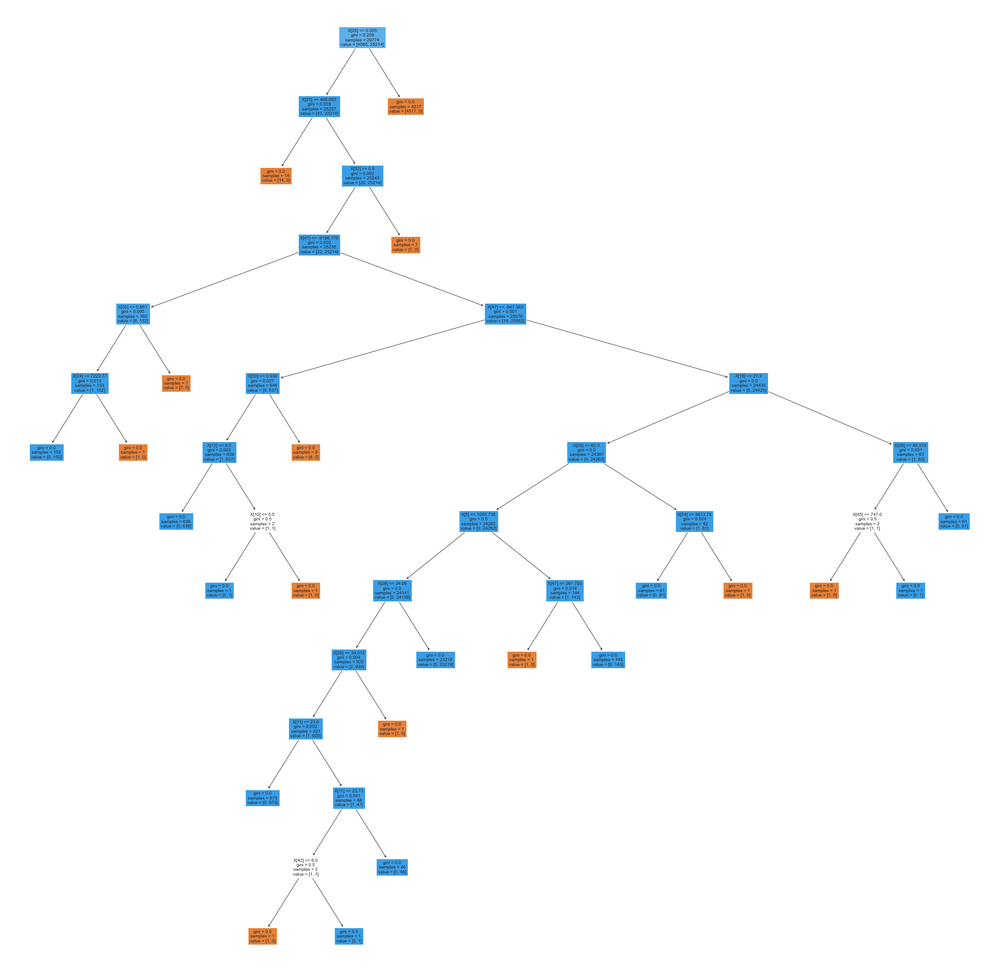

In [164]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtree, fontsize=10, filled=True)
plt.show()

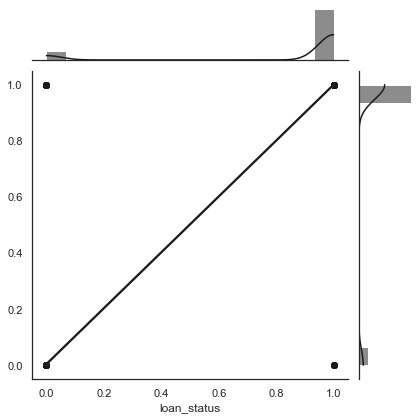

In [165]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y_test, y=y_pred,kind="reg", color="k");

In [167]:
results1 = pd.DataFrame({'DataFrame':['Bez modyfikacji dt1'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc]},index={'1'})
results1 = results1[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji dt1,0.99906,0.999449,0.998562


In [168]:
df_FE2dt=df_FE2.copy()

In [490]:
X = df_FE2dt.drop( ['loan_amnt', 'funded_amnt', 'term', 'emp_length', 'home_ownership', 'verification_status', 'purpose', 'delinq_2yrs', 'pub_rec', 'total_rec_late_fee', 'collection_recovery_fee', 'last_fico_range_high', 'last_fico_range_low', 'pub_rec_bankruptcies', 'earliest_cr_line_month', 'loan_amnt_rating', 'small_business', 'credit_card', 'debt_consolidation', 'last_fico_range_high_rating', 'fico_range_high_rating', 'issue_d_month', 'issue_d_YEAR', 'issue_d_YEARS', 'last_fico_range_mean', 'annual_installment', 'percent_annual_inc', 'leng_expl', 'expl','loan_status'] , axis=1)
y = df_FE2dt['loan_status']
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 1)

In [491]:
dtreen = DecisionTreeClassifier()
dtreen.fit(X_train , y_train)

DecisionTreeClassifier()

In [492]:
print('Feature importances: \n',pd.DataFrame(dtreen.feature_importances_,columns=['Imp'],index=X_train.columns))

Feature importances: 
                              Imp
funded_amnt_inv         0.000259
int_rate                0.000346
installment             0.000002
annual_inc              0.000000
dti                     0.000130
fico_range_low          0.000000
fico_range_high         0.000000
inq_last_6mths          0.000086
open_acc                0.000004
revol_bal               0.000000
revol_util              0.000000
total_acc               0.000004
total_pymnt             0.000000
total_pymnt_inv         0.000000
total_rec_prncp         0.004528
total_rec_int           0.000256
recoveries              0.987043
last_pymnt_amnt         0.000212
debt_settlement_flag    0.001813
earliest_cr_line_year   0.000130
earliest_cr_line_YEARS  0.000000
fico_range_mean         0.000130
int_amnt                0.000755
financial_ratio         0.004303


Usunięcie wartości nieistotnych spodowodało, obniżenie trafnosci modelu.

In [494]:
y_pred = dtreen.predict(X_test)
print('Performance on training data using DT:',dtreen.score(X_train,y_train))
print('Performance on testing data using DT:',dtreen.score(X_test,y_test))
acc_DT=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_DT)

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.9992163623540475
Accuracy DT:  0.9937782328348022


In [505]:
print(classification_report(y_test,y_pred))

dtreen_pr= evaluate(y_pred,y_test)
dtreen_pr

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1886
           1       1.00      1.00      1.00     10875

    accuracy                           1.00     12761
   macro avg       1.00      1.00      1.00     12761
weighted avg       1.00      1.00      1.00     12761



{'f1-score': 1.0, 'accuracy': 1.0}

In [506]:
def evaluate(y_pred,y_test): 
    result = classification_report(y_test,y_pred,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [497]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

[Text(0.5224609375, 0.9615384615384616, 'X[16] <= 0.005\ngini = 0.259\nsamples = 29774\nvalue = [4545, 25229]'),
 Text(0.4912109375, 0.8846153846153846, 'X[14] <= 468.065\ngini = 0.004\nsamples = 25279\nvalue = [50, 25229]'),
 Text(0.4599609375, 0.8076923076923077, 'gini = 0.0\nsamples = 17\nvalue = [17, 0]'),
 Text(0.5224609375, 0.8076923076923077, 'X[18] <= 0.5\ngini = 0.003\nsamples = 25262\nvalue = [33, 25229]'),
 Text(0.4912109375, 0.7307692307692307, 'X[22] <= -19.419\ngini = 0.002\nsamples = 25255\nvalue = [26, 25229]'),
 Text(0.171875, 0.6538461538461539, 'X[23] <= 0.986\ngini = 0.043\nsamples = 911\nvalue = [20, 891]'),
 Text(0.140625, 0.5769230769230769, 'X[14] <= 1174.28\ngini = 0.007\nsamples = 894\nvalue = [3, 891]'),
 Text(0.0625, 0.5, 'X[22] <= -4739.714\ngini = 0.5\nsamples = 2\nvalue = [1, 1]'),
 Text(0.03125, 0.4230769230769231, 'gini = 0.0\nsamples = 1\nvalue = [1, 0]'),
 Text(0.09375, 0.4230769230769231, 'gini = 0.0\nsamples = 1\nvalue = [0, 1]'),
 Text(0.21875, 0.5

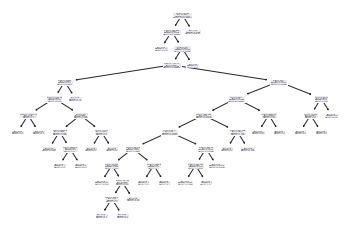

In [501]:
from sklearn import tree

tree.plot_tree(dtreen)

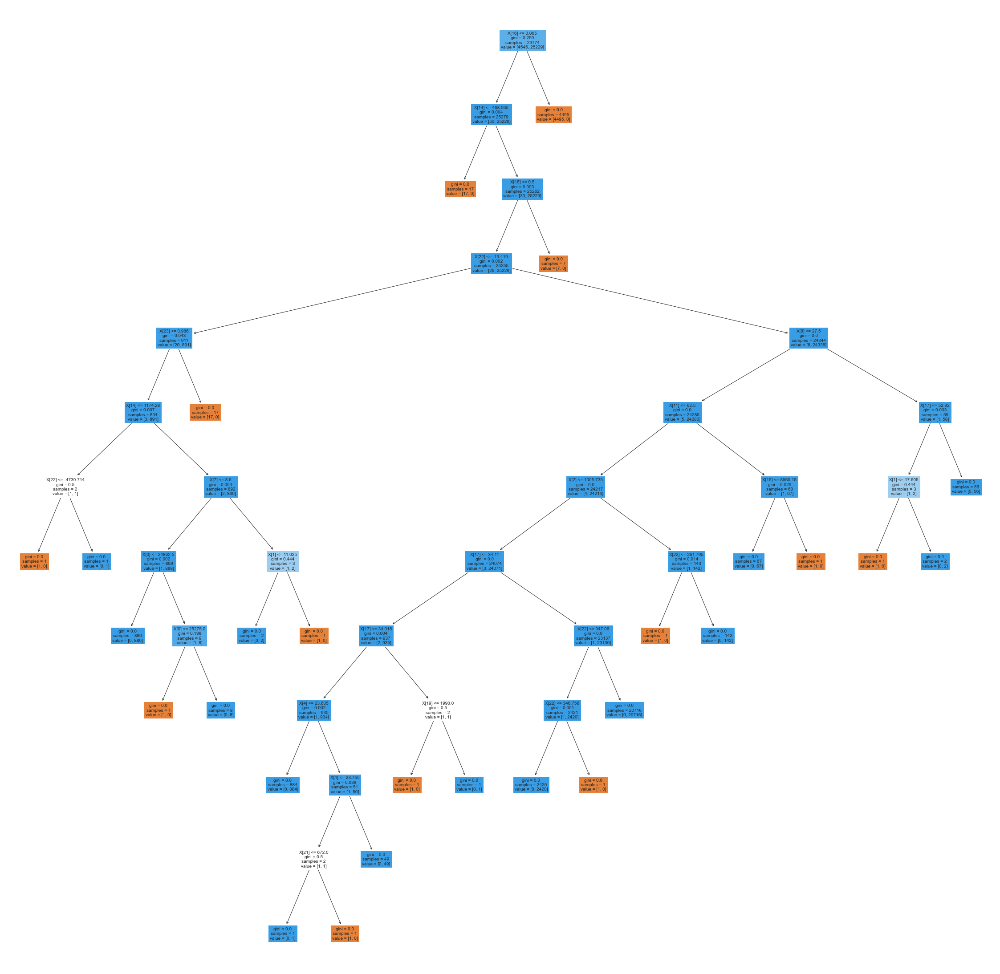

In [502]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtreen, fontsize=10, filled=True)
plt.show()

In [503]:
cm = metrics.confusion_matrix(y_test, y_pred)
print(cm)

[[ 1884     2]
 [    8 10867]]


*  TP – liczba obserwacji, które były prawdziwe i zostały wskazane jako prawdziwe - 1884
*  FP – liczba obserwacji które były fałszywe, a zostały wskazane jako prawdziwe - 8
*  FN – liczba obserwacji które były prawdziwe, ale zostały wskazane jako fałszywe - 2
*  TN – liczba obserwacji które były fałszywe i zostały wskazane jako fałszywe - 10867

In [504]:
print('Precision:', 1884/(1884+2))
print('Recall:', 1884/(1884+8))
print('Specificity:', 10867/(10867+8))

Precision: 0.9989395546129375
Recall: 0.9957716701902748
Specificity: 0.999264367816092


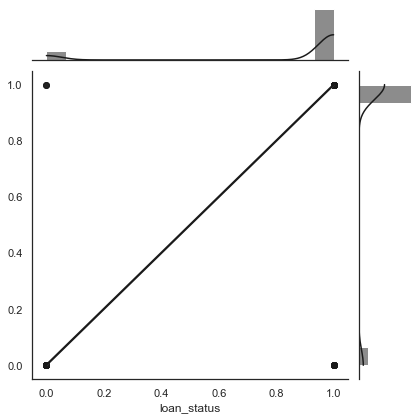

In [498]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y_test, y=y_pred, kind="reg", color="k");

In [499]:
roc_auc=metrics.roc_auc_score(y_pred,y_test)
roc_auc

0.9977938303108886

In [500]:
dtreee = pd.DataFrame({'DataFrame':['Bez modyfikacji dt2'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc]},index={'2'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Srednia dt1,0.989734,0.993958,0.970249
2,Srednia,0.989734,0.993958,1.000000
2,Bez modyfikacji dt2,0.989734,0.993958,0.997794


Wyrzucenie z DF mało waznych cech podniosła czułość, trafność oraz specyficzność modelu.

#### Mediana

In [631]:
X2=df_FE3.iloc[:, :-1]
y2=df_FE3.iloc[:, -1]


X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2, test_size = 0.3, random_state = 1)

In [632]:
dtree2 = DecisionTreeClassifier()

In [633]:
dtree2.fit(X2_train,y2_train)

DecisionTreeClassifier()

In [182]:
print('Feature importances: \n',pd.DataFrame(dtree2.feature_importances_,columns=['Imp'],index=X2_train.columns))

Feature importances: 
                                   Imp
loan_amnt                    0.037936
funded_amnt                  0.227385
funded_amnt_inv              0.022476
term                         0.001321
int_rate                     0.002428
installment                  0.006014
emp_length                   0.000844
home_ownership               0.000000
annual_inc                   0.002677
verification_status          0.000130
purpose                      0.000894
dti                          0.003529
delinq_2yrs                  0.000000
fico_range_low               0.000475
fico_range_high              0.001070
inq_last_6mths               0.000774
open_acc                     0.000561
pub_rec                      0.000000
revol_bal                    0.001071
revol_util                   0.002337
total_acc                    0.001383
total_pymnt                  0.004033
total_pymnt_inv              0.005269
total_rec_prncp              0.386738
total_rec_int              

In [183]:
y2_pred = dtree2.predict(X2_test)
# performance on train data
print('Performance on training data using DT:',dtree2.score(X2_train,y2_train))
# performance on test data
print('Performance on testing data using DT:',dtree2.score(X2_test,y2_test))
#Evaluate the model using accuracy
acc_DT2=metrics.r2_score(y2_test, y2_pred)
print('Accuracy DT: ',acc_DT2)
print('MSE: ',metrics.mean_squared_error(y2_test, y2_pred))

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.983465245670402
Accuracy DT:  0.8687207128143246
MSE:  0.016534754329597993


In [184]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import precision_score

In [637]:
print(classification_report(y2_test,y2_pred))

dtree_pr2= evaluate(y2_pred,y2_test)
dtree_pr2

              precision    recall  f1-score   support

           0       0.14      0.14      0.14      1886
           1       0.85      0.85      0.85     10875

    accuracy                           0.74     12761
   macro avg       0.50      0.50      0.50     12761
weighted avg       0.75      0.74      0.75     12761



{'f1-score': 0.85, 'accuracy': 0.74}

In [638]:
def evaluate(y2_pred,y2_test): 
    result = classification_report(y2_test,y2_pred,output_dict=True)
    f1 = result['1']['f1-score']

    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [187]:
result = classification_report(y2_test,y2_pred,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [188]:
from IPython.display import Image  
from sklearn.tree import export_graphviz

In [189]:
features = list(df_FE3.columns[:-1])
features

['loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'term',
 'int_rate',
 'installment',
 'emp_length',
 'home_ownership',
 'annual_inc',
 'verification_status',
 'purpose',
 'dti',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low',
 'pub_rec_bankruptcies',
 'debt_settlement_flag',
 'earliest_cr_line_month',
 'earliest_cr_line_year',
 'earliest_cr_line_YEARS',
 'loan_amnt_rating',
 'small_business',
 'credit_card',
 'debt_consolidation',
 'last_fico_range_high_rating',
 'fico_range_high_rating',
 'issue_d_month',
 'issue_d_YEAR',
 'issue_d_YEARS',
 'fico_range_mean',
 'last_fico_range_mean',
 'int_amnt',
 'annual_installment',
 'percent_annual_inc',
 'financial_ratio',
 'leng_expl',
 'expl']

[Text(0.22734019245364293, 0.9761904761904762, 'X[23] <= 2998.49\ngini = 0.259\nsamples = 29774\nvalue = [4545, 25229]'),
 Text(0.03836765671151953, 0.9285714285714286, 'X[1] <= 2987.5\ngini = 0.49\nsamples = 4349\nvalue = [2489, 1860]'),
 Text(0.03574212340006564, 0.8809523809523809, 'X[47] <= 6.0\ngini = 0.267\nsamples = 2211\nvalue = [351, 1860]'),
 Text(0.015753199868723335, 0.8333333333333334, 'X[0] <= 2975.0\ngini = 0.141\nsamples = 314\nvalue = [290, 24]'),
 Text(0.010502133245815556, 0.7857142857142857, 'X[28] <= 416.505\ngini = 0.052\nsamples = 297\nvalue = [289, 8]'),
 Text(0.007876599934361668, 0.7380952380952381, 'X[2] <= 353.402\ngini = 0.027\nsamples = 293\nvalue = [289, 4]'),
 Text(0.005251066622907778, 0.6904761904761905, 'X[22] <= 150.99\ngini = 0.375\nsamples = 16\nvalue = [12, 4]'),
 Text(0.002625533311453889, 0.6428571428571429, 'gini = 0.0\nsamples = 12\nvalue = [12, 0]'),
 Text(0.007876599934361668, 0.6428571428571429, 'gini = 0.0\nsamples = 4\nvalue = [0, 4]'),
 

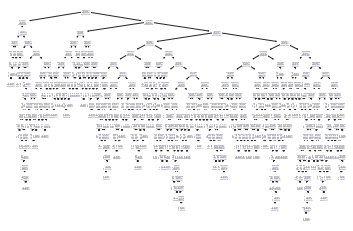

In [190]:
from sklearn import tree

tree.plot_tree(dtree2)

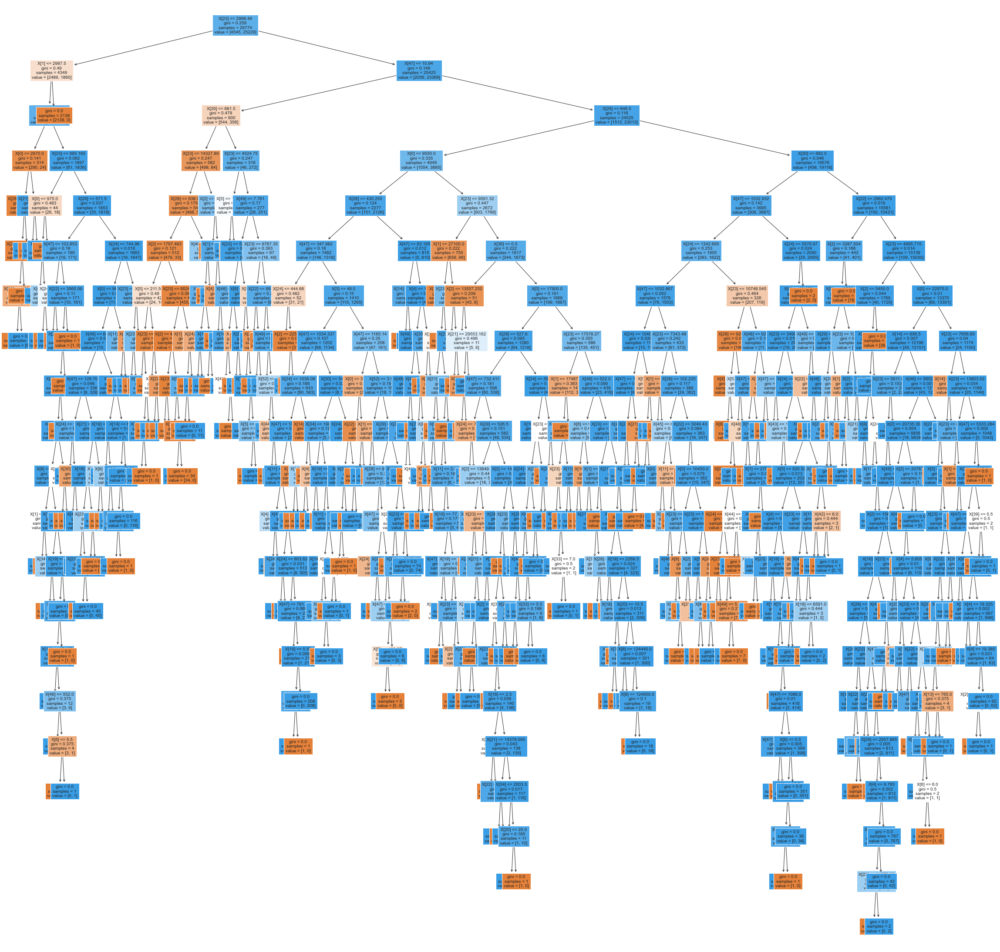

In [191]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtree2, fontsize=10, filled=True)
plt.show()

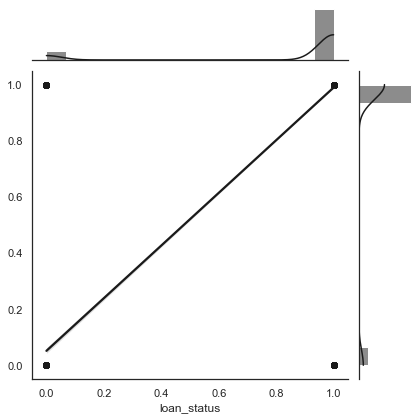

In [192]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y2_test, y=y2_pred,kind="reg", color="k");

In [650]:
cm = metrics.confusion_matrix(y2_test, y_pred2)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1787    99]
 [  105 10770]]
Precision: 0.9445031712473573
Recall: 0.9475079533404029
Specificity: 0.9903448275862069


In [651]:
roc_auc2=metrics.roc_auc_score(y_pred2,y2_test)
roc_auc2

0.967697348803364

Wartości wskaźnikow niższe jak dla modelu wyuczonego na niemodyfikowanych danych.

In [194]:
dtreee = pd.DataFrame({'DataFrame':['Mediana dt2'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc2]},index={'2'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji dt1,0.999060,0.999449,0.998562
2,Bez modyfikacji dt2,0.999060,0.999449,1.000000
2,Mediana dt2,0.983465,0.990291,0.965581


In [664]:
df_FE3dt=df_FE3.copy()

In [665]:
X2 = df_FE3dt.drop( [ 'home_ownership',
 'delinq_2yrs',
 'pub_rec',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'pub_rec_bankruptcies',
 'debt_settlement_flag',
 'small_business',
 'credit_card',
 'last_fico_range_high_rating',
 'financial_ratio', 'loan_status'] , axis=1)
y2 = df_FE3dt['loan_status']
X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2, test_size = 0.3, random_state = 1)

In [666]:
dtreen2 = DecisionTreeClassifier()
dtreen2.fit(X2_train , y2_train)

DecisionTreeClassifier()

In [534]:
print('Feature importances: \n',pd.DataFrame(dtreen2.feature_importances_,columns=['Imp'],index=X2_train.columns))

Feature importances: 
                              Imp
loan_amnt               0.034826
funded_amnt             0.239184
funded_amnt_inv         0.015906
term                    0.001321
int_rate                0.001419
installment             0.002726
emp_length              0.001729
annual_inc              0.002062
verification_status     0.000389
purpose                 0.001357
dti                     0.002657
fico_range_low          0.000507
fico_range_high         0.001031
inq_last_6mths          0.000686
open_acc                0.001433
revol_bal               0.001075
revol_util              0.002316
total_acc               0.001689
total_pymnt             0.002786
total_pymnt_inv         0.003732
total_rec_prncp         0.387616
total_rec_int           0.042675
last_pymnt_amnt         0.009679
last_fico_range_high    0.066195
last_fico_range_low     0.000914
earliest_cr_line_month  0.000479
earliest_cr_line_year   0.000397
earliest_cr_line_YEARS  0.000000
loan_amnt_rating    

In [667]:
y_pred2 = dtreen2.predict(X2_test)
print('Performance on training data using DT:',dtreen2.score(X2_train,y2_train))
print('Performance on testing data using DT:',dtreen2.score(X2_test,y2_test))
acc_DT2n=metrics.r2_score(y2_test, y_pred2)
print('Accuracy DT: ',acc_DT2n)

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.9840137920225688
Accuracy DT:  0.8730759498299631


In [668]:
print(classification_report(y2_test,y_pred2))

dtreen_pr2= evaluate(y_pred2,y2_test)
dtreen_pr2

              precision    recall  f1-score   support

           0       0.95      0.95      0.95      1886
           1       0.99      0.99      0.99     10875

    accuracy                           0.98     12761
   macro avg       0.97      0.97      0.97     12761
weighted avg       0.98      0.98      0.98     12761



{'f1-score': 0.99, 'accuracy': 0.98}

In [669]:
def evaluate(y_pred2,y2_test): 
    result = classification_report(y2_test,y_pred2,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [538]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

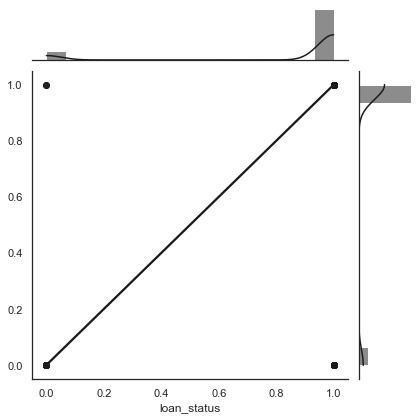

In [539]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y_test, y=y_pred, kind="reg", color="k");

[Text(0.22645475569017653, 0.9761904761904762, 'X[20] <= 2998.49\ngini = 0.259\nsamples = 29774\nvalue = [4545, 25229]'),
 Text(0.03821714612618503, 0.9285714285714286, 'X[1] <= 2987.5\ngini = 0.49\nsamples = 4349\nvalue = [2489, 1860]'),
 Text(0.035601912389669824, 0.8809523809523809, 'X[36] <= 6.0\ngini = 0.267\nsamples = 2211\nvalue = [351, 1860]'),
 Text(0.015691402419091206, 0.8333333333333334, 'X[0] <= 2975.0\ngini = 0.141\nsamples = 314\nvalue = [290, 24]'),
 Text(0.010460934946060804, 0.7857142857142857, 'X[22] <= 416.505\ngini = 0.052\nsamples = 297\nvalue = [289, 8]'),
 Text(0.007845701209545603, 0.7380952380952381, 'X[2] <= 353.402\ngini = 0.027\nsamples = 293\nvalue = [289, 4]'),
 Text(0.005230467473030402, 0.6904761904761905, 'X[19] <= 150.99\ngini = 0.375\nsamples = 16\nvalue = [12, 4]'),
 Text(0.002615233736515201, 0.6428571428571429, 'gini = 0.0\nsamples = 12\nvalue = [12, 0]'),
 Text(0.007845701209545603, 0.6428571428571429, 'gini = 0.0\nsamples = 4\nvalue = [0, 4]'),


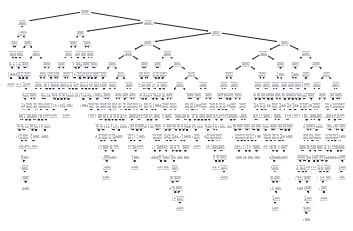

In [656]:
from sklearn import tree

tree.plot_tree(dtreen2)

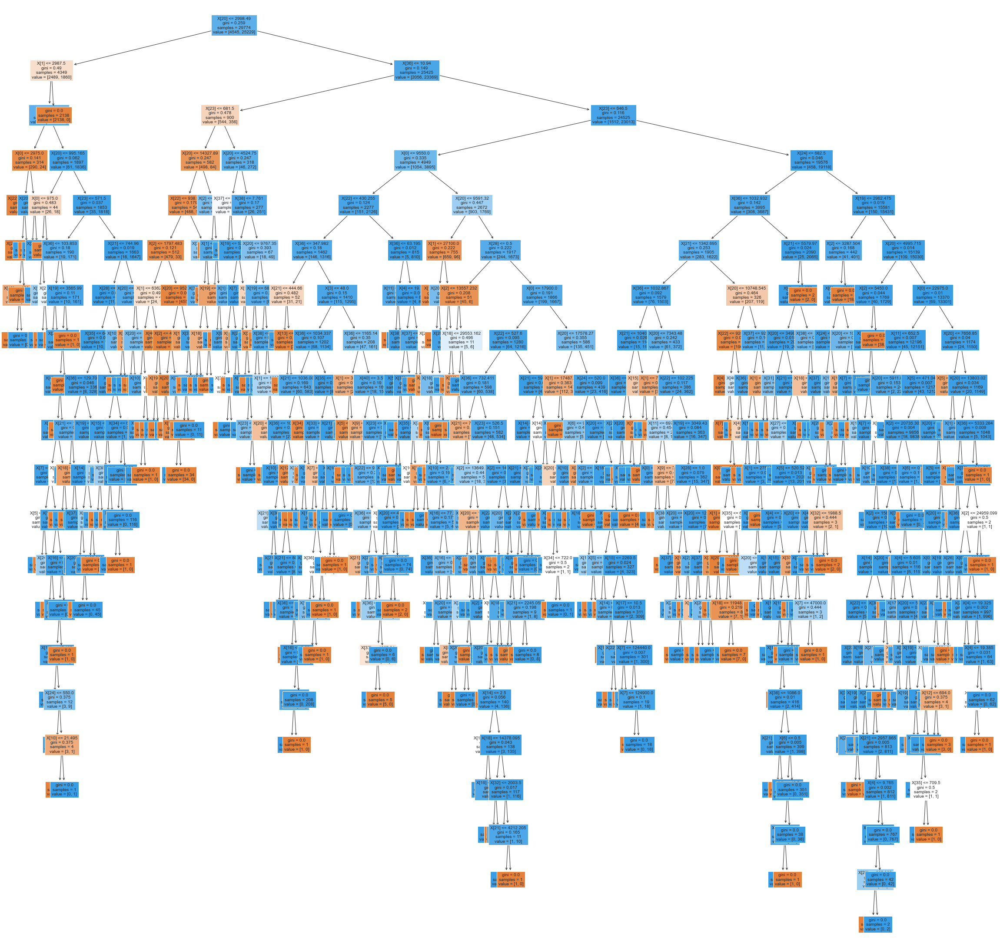

In [657]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtreen2, fontsize=10, filled=True)
plt.show()

In [542]:
dtreee = pd.DataFrame({'DataFrame':['Mediana dt2'], 'accuracy': [accuracy], 'f1-score': [f1]},index={'4'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score']]
results1

,DataFrame,accuracy,f1-score
1,Srednia dt1,0.989734,0.993958
2,Srednia,0.989734,0.993958
2,Bez modyfikacji dt2,0.989734,0.993958
4,Mediana dt2,0.989734,0.993958


In [670]:
cm = metrics.confusion_matrix(y2_test, y_pred2)
print(cm)

[[ 1785   101]
 [  103 10772]]


In [671]:
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

Precision: 0.9454449152542372
Recall: 0.9464475079533404
Specificity: 0.9905287356321839


In [672]:
roc_auc2=metrics.roc_auc_score(y_pred2,y2_test)
roc_auc2

0.9680779252993342

In [206]:
dtreee = pd.DataFrame({'DataFrame':['Mediana dt2'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc2]},index={'4'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji dt1,0.999060,0.999449,NaN
2,Bez modyfikacji dt2,0.999060,0.999449,NaN
2,Mediana dt2,0.983465,0.990291,NaN
4,Mediana dt2,0.983465,0.990291,NaN
4,Mediana dt2,0.983465,0.990291,0.965581


Odrzucenie nieistotnych cech nie spowodowało znacząco wartości parametrów klasyfikatora.

#### Bez outliersów

In [673]:
X3=df_FE4.iloc[:, :-1]
y3=df_FE4.iloc[:, -1]


X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3, test_size = 0.3, random_state = 1)

In [674]:
dtree3 = DecisionTreeClassifier()

In [675]:
dtree3.fit(X3_train,y3_train)

DecisionTreeClassifier()

In [577]:
print('Feature importances: \n',pd.DataFrame(dtree3.feature_importances_,columns=['Imp'],index=X3_train.columns))

Feature importances: 
                                   Imp
loan_amnt                    0.000000
funded_amnt                  0.000000
funded_amnt_inv              0.000000
term                         0.000000
int_rate                     0.000000
installment                  0.000000
emp_length                   0.000000
home_ownership               0.000000
annual_inc                   0.000000
verification_status          0.000000
purpose                      0.000000
dti                          0.000000
delinq_2yrs                  0.000000
fico_range_low               0.000000
fico_range_high              0.000000
inq_last_6mths               0.000000
open_acc                     0.000000
pub_rec                      0.000000
revol_bal                    0.000000
revol_util                   0.000000
total_acc                    0.000000
total_pymnt                  0.000000
total_pymnt_inv              0.000000
total_rec_prncp              0.000000
total_rec_int              

In [211]:
y3_pred = dtree3.predict(X3_test)
# performance on train data
print('Performance on training data using DT:',dtree3.score(X3_train,y3_train))
# performance on test data
print('Performance on testing data using DT:',dtree3.score(X3_test,y3_test))
#Evaluate the model using accuracy
acc_DT3=metrics.r2_score(y3_test, y3_pred)
print('Accuracy DT: ',acc_DT3)
print('MSE: ',metrics.mean_squared_error(y3_test, y3_pred))

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.999657416923604
Accuracy DT:  0.996331671314622
MSE:  0.00034258307639602604


In [212]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import precision_score

In [676]:
print(classification_report(y3_test,y3_pred))

dtree_pr3= evaluate(y3_pred,y3_test)
dtree_pr3

              precision    recall  f1-score   support

           0       0.11      0.11      0.11       913
           1       0.90      0.90      0.90      7844

    accuracy                           0.81      8757
   macro avg       0.50      0.50      0.50      8757
weighted avg       0.81      0.81      0.81      8757



{'f1-score': 0.9, 'accuracy': 0.81}

In [214]:
def evaluate(y3_pred,y3_test): 
    result = classification_report(y3_test,y3_pred,output_dict=True)
    f1 = result['1']['f1-score']

    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [217]:
result = classification_report(y3_test,y3_pred,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [218]:
from IPython.display import Image  
from sklearn.tree import export_graphviz

In [219]:
features = list(df_FE4.columns[:-1])
features

['loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'term',
 'int_rate',
 'installment',
 'emp_length',
 'home_ownership',
 'annual_inc',
 'verification_status',
 'purpose',
 'dti',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low',
 'pub_rec_bankruptcies',
 'debt_settlement_flag',
 'earliest_cr_line_month',
 'earliest_cr_line_year',
 'earliest_cr_line_YEARS',
 'loan_amnt_rating',
 'small_business',
 'credit_card',
 'debt_consolidation',
 'last_fico_range_high_rating',
 'fico_range_high_rating',
 'issue_d_month',
 'issue_d_YEAR',
 'issue_d_YEARS',
 'fico_range_mean',
 'last_fico_range_mean',
 'int_amnt',
 'annual_installment',
 'percent_annual_inc',
 'financial_ratio',
 'leng_expl',
 'expl']

[Text(0.4107142857142857, 0.9444444444444444, 'X[26] <= 0.005\ngini = 0.194\nsamples = 20430\nvalue = [2218, 18212]'),
 Text(0.3392857142857143, 0.8333333333333334, 'X[47] <= -2996.447\ngini = 0.002\nsamples = 18234\nvalue = [22, 18212]'),
 Text(0.14285714285714285, 0.7222222222222222, 'X[23] <= 18160.13\ngini = 0.231\nsamples = 15\nvalue = [13, 2]'),
 Text(0.07142857142857142, 0.6111111111111112, 'gini = 0.0\nsamples = 13\nvalue = [13, 0]'),
 Text(0.21428571428571427, 0.6111111111111112, 'gini = 0.0\nsamples = 2\nvalue = [0, 2]'),
 Text(0.5357142857142857, 0.7222222222222222, 'X[47] <= -1188.346\ngini = 0.001\nsamples = 18219\nvalue = [9, 18210]'),
 Text(0.35714285714285715, 0.6111111111111112, 'X[46] <= 669.5\ngini = 0.42\nsamples = 20\nvalue = [6, 14]'),
 Text(0.2857142857142857, 0.5, 'gini = 0.0\nsamples = 6\nvalue = [6, 0]'),
 Text(0.42857142857142855, 0.5, 'gini = 0.0\nsamples = 14\nvalue = [0, 14]'),
 Text(0.7142857142857143, 0.6111111111111112, 'X[47] <= -627.495\ngini = 0.0\ns

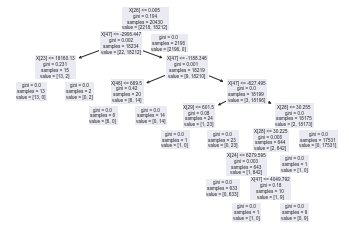

In [220]:
from sklearn import tree

tree.plot_tree(dtree3)

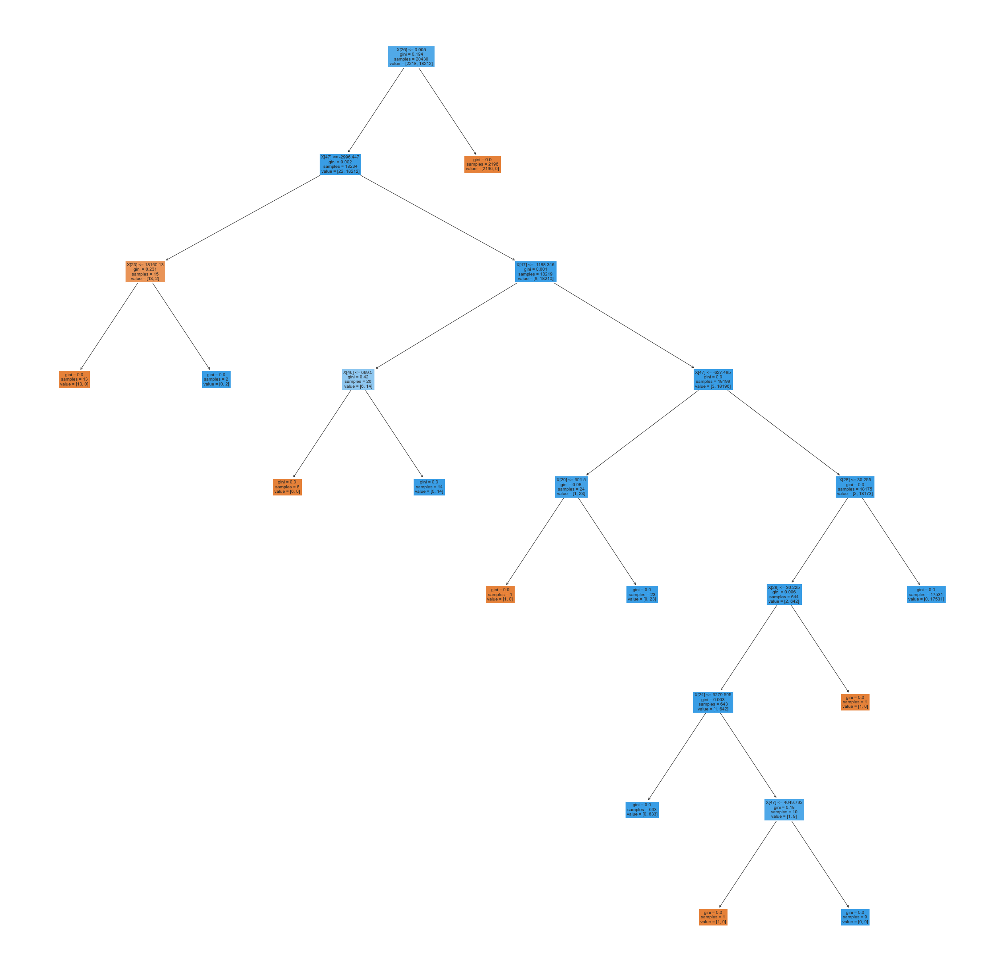

In [221]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtree3, fontsize=10, filled=True)
plt.show()

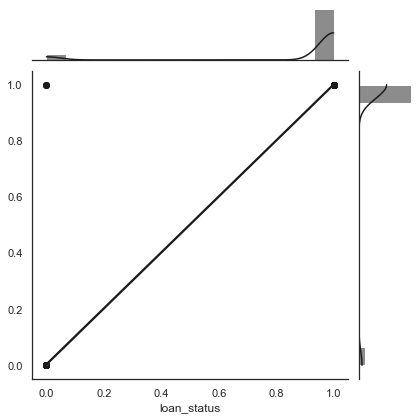

In [222]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y3_test, y=y3_pred,kind="reg", color="k");

In [578]:
cm = metrics.confusion_matrix(y3_test, y3_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 100  813]
 [ 810 7034]]
Precision: 0.10989010989010989
Recall: 0.10952902519167579
Specificity: 0.89673635900051


In [579]:
roc_auc3=metrics.roc_auc_score(y3_pred,y3_test)
roc_auc3

0.5031418180392311

Niskie wskażniki dla klasyfikatorów. Model słabo dopasowany.

In [224]:
dtreee = pd.DataFrame({'DataFrame':['Bez outliersow dt2'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc3]},index={'6'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji dt1,0.999060,0.999449,NaN
2,Bez modyfikacji dt2,0.999060,0.999449,NaN
2,Mediana dt2,0.983465,0.990291,NaN
4,Mediana dt2,0.983465,0.990291,NaN
4,Mediana dt2,0.983465,0.990291,0.965581
5,Bez outliersów dt1,0.983465,0.990291,0.999809
6,Bez outliersow dt2,0.999657,0.999809,0.999809


In [680]:
df_FE4dt=df_FE4.copy()

In [681]:
X3 = df_FE4dt.drop( ['loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'term',
 'int_rate',
 'installment',
 'emp_length',
 'home_ownership',
 'annual_inc',
 'verification_status',
 'purpose',
 'dti',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_late_fee',
 'collection_recovery_fee',
 'last_fico_range_low',
 'pub_rec_bankruptcies',
 'debt_settlement_flag',
 'earliest_cr_line_month',
 'earliest_cr_line_year',
 'earliest_cr_line_YEARS',
 'loan_amnt_rating',
 'small_business',
 'credit_card',
 'debt_consolidation',
 'last_fico_range_high_rating',
 'fico_range_high_rating',
 'issue_d_month',
 'issue_d_YEAR',
 'issue_d_YEARS',
 'fico_range_mean',
 'annual_installment',
 'percent_annual_inc',
 'financial_ratio',
 'leng_expl',
 'expl', 'loan_status'] , axis=1)
y3 = df_FE4dt['loan_status']
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3, test_size = 0.3, random_state = 1)

In [682]:
dtreen3 = DecisionTreeClassifier()
dtreen3.fit(X3_train , y3_train)

DecisionTreeClassifier()

In [683]:
print('Feature importances: \n',pd.DataFrame(dtreen3.feature_importances_,columns=['Imp'],index=X3_train.columns))

Feature importances: 
                            Imp
total_rec_prncp       0.000877
total_rec_int         0.000050
recoveries            0.988887
last_pymnt_amnt       0.000962
last_fico_range_high  0.000000
last_fico_range_mean  0.002609
int_amnt              0.006616


In [684]:
y_pred3 = dtreen3.predict(X3_test)
print('Performance on training data using DT:',dtreen3.score(X3_train,y3_train))
print('Performance on testing data using DT:',dtreen3.score(X3_test,y3_test))
acc_DT3n=metrics.r2_score(y3_test, y_pred3)
print('Accuracy DT: ',acc_DT3n)

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.999657416923604
Accuracy DT:  0.996331671314622


In [685]:
print(classification_report(y3_test,y_pred3))

dtreen_pr3= evaluate(y_pred3,y3_test)
dtreen_pr3

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       913
           1       1.00      1.00      1.00      7844

    accuracy                           1.00      8757
   macro avg       1.00      1.00      1.00      8757
weighted avg       1.00      1.00      1.00      8757



{'f1-score': 1.0, 'accuracy': 1.0}

In [559]:
def evaluate(y_pred3,y3_test): 
    result = classification_report(y3_test,y_pred3,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [560]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

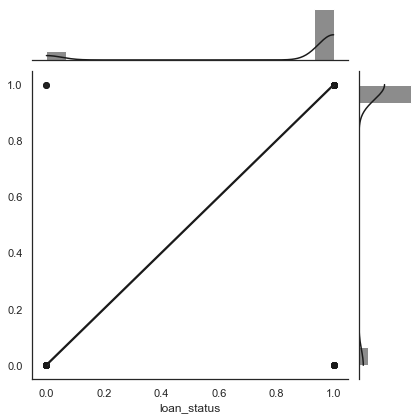

In [561]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y_test, y=y_pred, kind="reg", color="k");

[Text(0.4107142857142857, 0.9444444444444444, 'X[2] <= 0.005\ngini = 0.194\nsamples = 20430\nvalue = [2218, 18212]'),
 Text(0.3392857142857143, 0.8333333333333334, 'X[6] <= -2996.447\ngini = 0.002\nsamples = 18234\nvalue = [22, 18212]'),
 Text(0.14285714285714285, 0.7222222222222222, 'X[0] <= 18160.13\ngini = 0.231\nsamples = 15\nvalue = [13, 2]'),
 Text(0.07142857142857142, 0.6111111111111112, 'gini = 0.0\nsamples = 13\nvalue = [13, 0]'),
 Text(0.21428571428571427, 0.6111111111111112, 'gini = 0.0\nsamples = 2\nvalue = [0, 2]'),
 Text(0.5357142857142857, 0.7222222222222222, 'X[6] <= -1188.346\ngini = 0.001\nsamples = 18219\nvalue = [9, 18210]'),
 Text(0.35714285714285715, 0.6111111111111112, 'X[5] <= 669.5\ngini = 0.42\nsamples = 20\nvalue = [6, 14]'),
 Text(0.2857142857142857, 0.5, 'gini = 0.0\nsamples = 6\nvalue = [6, 0]'),
 Text(0.42857142857142855, 0.5, 'gini = 0.0\nsamples = 14\nvalue = [0, 14]'),
 Text(0.7142857142857143, 0.6111111111111112, 'X[6] <= -627.495\ngini = 0.0\nsamples

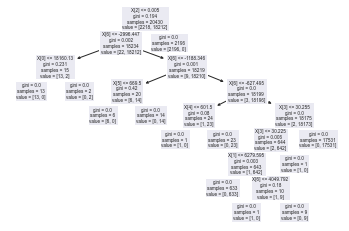

In [590]:
from sklearn import tree

tree.plot_tree(dtreen3)

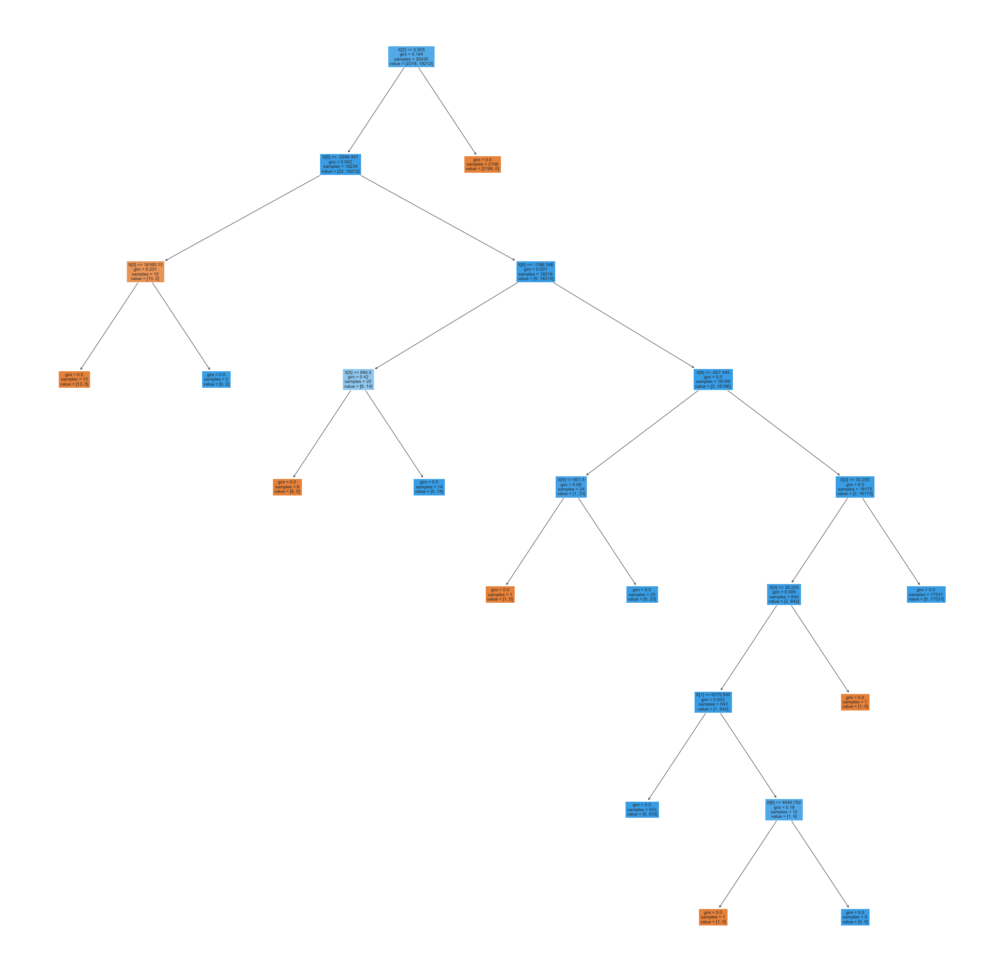

In [591]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtreen3, fontsize=10, filled=True)
plt.show()

In [686]:
cm = metrics.confusion_matrix(y3_test, y_pred3)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 910    3]
 [   0 7844]]
Precision: 1.0
Recall: 0.9967141292442497
Specificity: 1.0


In [687]:
roc_auc3=metrics.roc_auc_score(y_pred3,y3_test)
roc_auc3

0.999808844144259

Model zawierał dużo wartości nadmiarowych. Po ich usunieciu wszystkie parametry klasyfikatorów znacząco wzrosły. Bardzo dobre dopasowanie modelu.

In [235]:
dtreee = pd.DataFrame({'DataFrame':['Bez outliersow dt2'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc3]},index={'6'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji dt1,0.999060,0.999449,NaN
2,Bez modyfikacji dt2,0.999060,0.999449,NaN
2,Mediana dt2,0.983465,0.990291,NaN
4,Mediana dt2,0.983465,0.990291,NaN
4,Mediana dt2,0.983465,0.990291,0.965581
5,Bez outliersów dt1,0.983465,0.990291,0.999809
6,Bez outliersow dt2,0.999657,0.999809,0.999809
6,Bez outliersow dt2,0.999657,0.999809,1.000000


#### Dummies

In [688]:
X4=df_dummies.iloc[:, :-1]
y4=target


X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4, test_size = 0.3, random_state = 1)

In [689]:
dtree4 = DecisionTreeClassifier()

In [690]:
dtree4.fit(X4_train,y4_train)

DecisionTreeClassifier()

In [596]:
print('Feature importances: \n',pd.DataFrame(dtree4.feature_importances_,columns=['Imp'],index=X4_train.columns))

Feature importances: 
                                        Imp
loan_amnt                         0.000000
funded_amnt                       0.000000
funded_amnt_inv                   0.000029
term                              0.000000
int_rate                          0.000000
...                                    ...
fico_range_high_rating_Good       0.000000
fico_range_high_rating_Very Good  0.000000
leng_expl_Poor                    0.000130
leng_expl_Satisfactory            0.000000
leng_expl_Sofisticated            0.000130

[85 rows x 1 columns]


In [691]:
y4_pred = dtree4.predict(X4_test)
# performance on train data
print('Performance on training data using DT:',dtree4.score(X4_train,y4_train))
# performance on test data
print('Performance on testing data using DT:',dtree4.score(X4_test,y4_test))
#Evaluate the model using accuracy
acc_DT4=metrics.r2_score(y4_test, y4_pred)
print('Accuracy DT: ',acc_DT4)
print('MSE: ',metrics.mean_squared_error(y4_test, y4_pred))

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.9997649087062143
Accuracy DT:  0.9981334698504406
MSE:  0.00023509129378575347


In [692]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import precision_score

In [693]:
print(classification_report(y4_test,y4_pred))

dtree_pr4= evaluate(y4_pred,y4_test)
dtree_pr4

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1886
           1       1.00      1.00      1.00     10875

    accuracy                           1.00     12761
   macro avg       1.00      1.00      1.00     12761
weighted avg       1.00      1.00      1.00     12761



{'f1-score': 1.0, 'accuracy': 1.0}

In [603]:
def evaluate(y4_pred,y4_test): 
    result = classification_report(y4_test,y4_pred,output_dict=True)
    f1 = result['1']['f1-score']

    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [245]:
dtreee = pd.DataFrame({'DataFrame':['Dummies dt1'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc4]},index={'7'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji dt1,0.999060,0.999449,NaN
2,Bez modyfikacji dt2,0.999060,0.999449,NaN
2,Mediana dt2,0.983465,0.990291,NaN
4,Mediana dt2,0.983465,0.990291,NaN
4,Mediana dt2,0.983465,0.990291,0.965581
5,Bez outliersów dt1,0.983465,0.990291,0.999809
6,Bez outliersow dt2,0.999657,0.999809,0.999809
6,Bez outliersow dt2,0.999657,0.999809,1.000000
7,Dummies dt1,0.999657,0.999809,0.999643


In [246]:
result = classification_report(y4_test,y4_pred,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [247]:
from IPython.display import Image  
from sklearn.tree import export_graphviz

In [248]:
features = list(df_dummies.columns)
features

['loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'term',
 'int_rate',
 'installment',
 'emp_length',
 'annual_inc',
 'dti',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low',
 'pub_rec_bankruptcies',
 'earliest_cr_line_month',
 'earliest_cr_line_year',
 'earliest_cr_line_YEARS',
 'small_business',
 'credit_card',
 'debt_consolidation',
 'issue_d_month',
 'issue_d_YEAR',
 'issue_d_YEARS',
 'fico_range_mean',
 'last_fico_range_mean',
 'int_amnt',
 'annual_installment',
 'percent_annual_inc',
 'financial_ratio',
 'expl',
 'home_ownership_MORTGAGE',
 'home_ownership_NONE',
 'home_ownership_OTHER',
 'home_ownership_OWN',
 'home_ownership_RENT',
 'verification_status_Not Verified',
 'verificatio

[Text(0.4583333333333333, 0.9583333333333334, 'X[23] <= 0.005\ngini = 0.259\nsamples = 29774\nvalue = [4545, 25229]'),
 Text(0.425, 0.875, 'X[20] <= 468.065\ngini = 0.004\nsamples = 25279\nvalue = [50, 25229]'),
 Text(0.39166666666666666, 0.7916666666666666, 'gini = 0.0\nsamples = 17\nvalue = [17, 0]'),
 Text(0.4583333333333333, 0.7916666666666666, 'X[67] <= 0.5\ngini = 0.003\nsamples = 25262\nvalue = [33, 25229]'),
 Text(0.425, 0.7083333333333334, 'gini = 0.0\nsamples = 7\nvalue = [7, 0]'),
 Text(0.49166666666666664, 0.7083333333333334, 'X[40] <= -19.419\ngini = 0.002\nsamples = 25255\nvalue = [26, 25229]'),
 Text(0.18333333333333332, 0.625, 'X[43] <= 0.986\ngini = 0.043\nsamples = 911\nvalue = [20, 891]'),
 Text(0.15, 0.5416666666666666, 'X[20] <= 1174.28\ngini = 0.007\nsamples = 894\nvalue = [3, 891]'),
 Text(0.06666666666666667, 0.4583333333333333, 'X[83] <= 0.5\ngini = 0.5\nsamples = 2\nvalue = [1, 1]'),
 Text(0.03333333333333333, 0.375, 'gini = 0.0\nsamples = 1\nvalue = [0, 1]'),

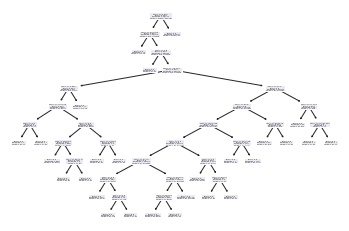

In [249]:
from sklearn import tree

tree.plot_tree(dtree4)

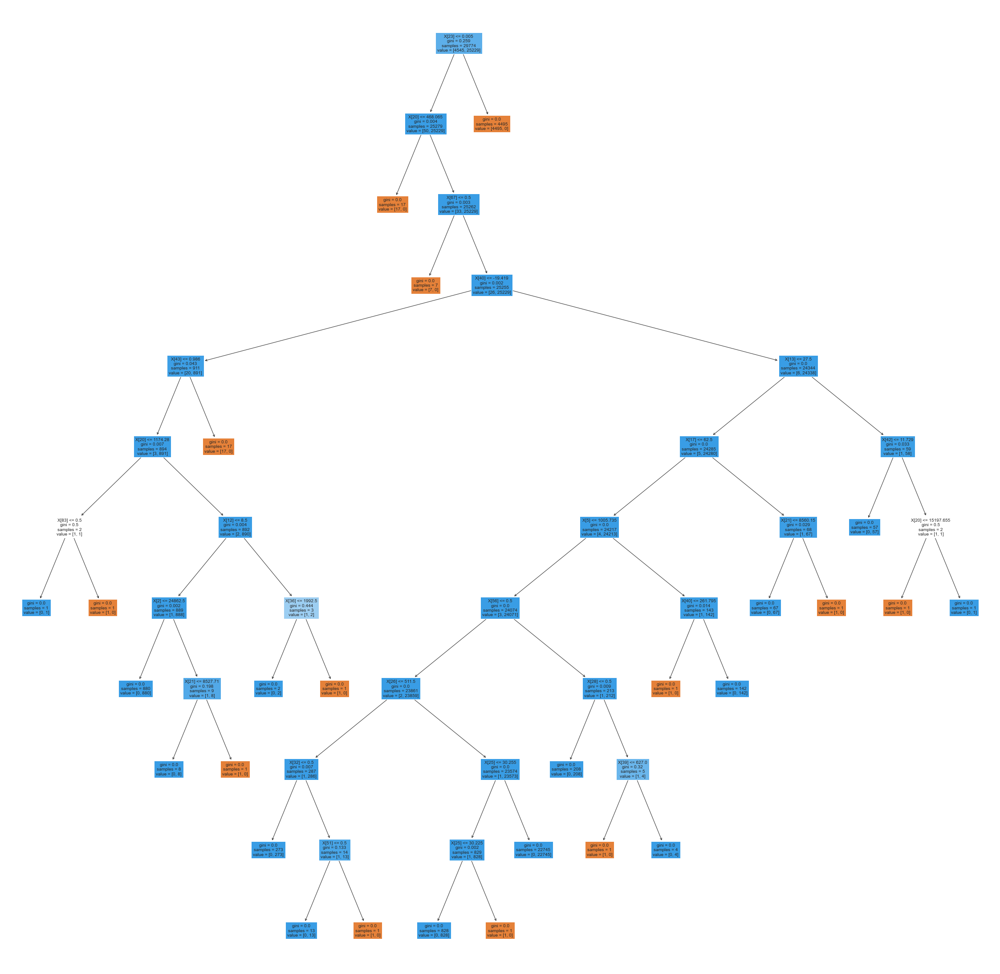

In [250]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtree4, fontsize=10, filled=True)
plt.show()

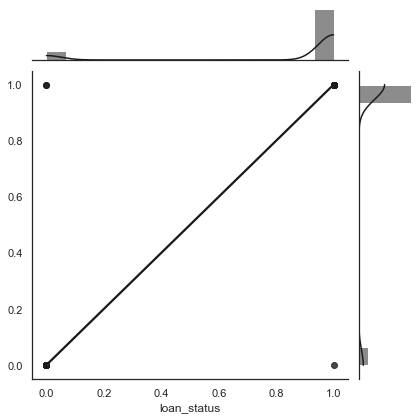

In [251]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y4_test, y=y4_pred,kind="reg", color="k");

In [694]:
cm = metrics.confusion_matrix(y4_test, y4_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1884     2]
 [    1 10874]]
Precision: 0.9994694960212201
Recall: 0.9989395546129375
Specificity: 0.9999080459770114


In [695]:
roc_auc4=metrics.roc_auc_score(y4_pred,y4_test)
roc_auc4

0.9996428024423866

Model bardzo dopasowany. Wysokie wskaźniki klasyfikatorów.

In [253]:
dtreee = pd.DataFrame({'DataFrame':['Bez modyfikacji dt2'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc4]},index={'2'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji dt1,0.999060,0.999449,NaN
2,Bez modyfikacji dt2,0.999060,0.999449,NaN
2,Mediana dt2,0.983465,0.990291,NaN
4,Mediana dt2,0.983465,0.990291,NaN
4,Mediana dt2,0.983465,0.990291,0.965581
5,Bez outliersów dt1,0.983465,0.990291,0.999809
6,Bez outliersow dt2,0.999657,0.999809,0.999809
6,Bez outliersow dt2,0.999657,0.999809,1.000000
7,Dummies dt1,0.999657,0.999809,0.999643
2,Bez modyfikacji dt2,0.999765,0.999862,0.999643


Wysokie wartości klasyfikatorów. Nie ma koniecznosci usuwania nadmiarowych cech.

##### Srednia

In [254]:
from sklearn.tree import DecisionTreeClassifier

In [715]:
X6=df_FE6.iloc[:, :-1]
y6=df_FE6.iloc[:, -1]

X6_train, X6_test, y6_train, y6_test = train_test_split(X6, y6, test_size=0.30,random_state=42)

In [716]:
dtree6 = DecisionTreeClassifier()

In [717]:
dtree6.fit(X6_train,y6_train)

DecisionTreeClassifier()

In [718]:
print('Feature importances: \n',pd.DataFrame(dtree6.feature_importances_,columns=['Imp'],index=X6_train.columns))

Feature importances: 
                                       Imp
loan_amnt                    4.439293e-04
funded_amnt                  1.332732e-06
funded_amnt_inv              1.529450e-03
term                         0.000000e+00
int_rate                     0.000000e+00
installment                  0.000000e+00
emp_length                   2.219646e-04
home_ownership               0.000000e+00
annual_inc                   0.000000e+00
verification_status          0.000000e+00
purpose                      4.930176e-04
dti                          1.333068e-04
delinq_2yrs                  0.000000e+00
fico_range_low               0.000000e+00
fico_range_high              0.000000e+00
inq_last_6mths               0.000000e+00
open_acc                     7.844691e-07
pub_rec                      0.000000e+00
revol_bal                    0.000000e+00
revol_util                   2.507639e-05
total_acc                    8.430632e-05
total_pymnt                  0.000000e+00
total_pymnt

In [719]:
y6_pred = dtree.predict(X6_test)
# performance on train data
print('Performance on training data using DT:',dtree.score(X6_train,y6_train))
# performance on test data
print('Performance on testing data using DT:',dtree.score(X6_test,y6_test))
#Evaluate the model using accuracy
acc_DT=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_DT)
print('MSE: ',metrics.mean_squared_error(y6_test, y6_pred))

Performance on training data using DT: 0.9909652717135756
Performance on testing data using DT: 0.9896559830734268
Accuracy DT:  0.9173282801289215
MSE:  0.010344016926573153


In [720]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import precision_score

In [721]:
print(classification_report(y6_test,y6_pred))

dtree_pr6= evaluate(y6_pred,y6_test)
dtree_pr6

              precision    recall  f1-score   support

           0       0.94      0.99      0.97      1871
           1       1.00      0.99      0.99     10890

    accuracy                           0.99     12761
   macro avg       0.97      0.99      0.98     12761
weighted avg       0.99      0.99      0.99     12761



{'f1-score': 0.99, 'accuracy': 0.99}

In [722]:
def evaluate(y6_pred,y6_test): 
    result = classification_report(y6_test,y6_pred,output_dict=True)
    f1 = result['1']['f1-score']

    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [723]:
result = classification_report(y6_test,y6_pred,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [724]:
from IPython.display import Image  
from sklearn.tree import export_graphviz

In [725]:
cm = metrics.confusion_matrix(y6_test, y6_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1854    17]
 [  115 10775]]
Precision: 0.941594718131031
Recall: 0.9909139497594869
Specificity: 0.9894398530762167


In [726]:
features = list(df_FE6.columns[:-1])
features

['loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'term',
 'int_rate',
 'installment',
 'emp_length',
 'home_ownership',
 'annual_inc',
 'verification_status',
 'purpose',
 'dti',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low',
 'pub_rec_bankruptcies',
 'debt_settlement_flag',
 'earliest_cr_line_month',
 'earliest_cr_line_year',
 'earliest_cr_line_YEARS',
 'loan_amnt_rating',
 'small_business',
 'credit_card',
 'debt_consolidation',
 'last_fico_range_high_rating',
 'fico_range_high_rating',
 'issue_d_month',
 'issue_d_YEAR',
 'issue_d_YEARS',
 'fico_range_mean',
 'last_fico_range_mean',
 'int_amnt',
 'annual_installment',
 'percent_annual_inc',
 'financial_ratio',
 'leng_expl',
 'expl']

[Text(0.25048828125, 0.9642857142857143, 'X[26] <= 51.508\ngini = 0.259\nsamples = 29774\nvalue = [4560, 25214]'),
 Text(0.21923828125, 0.8928571428571429, 'X[23] <= 468.065\ngini = 0.003\nsamples = 25257\nvalue = [43, 25214]'),
 Text(0.18798828125, 0.8214285714285714, 'gini = 0.0\nsamples = 14\nvalue = [14, 0]'),
 Text(0.25048828125, 0.8214285714285714, 'X[32] <= 0.002\ngini = 0.002\nsamples = 25243\nvalue = [29, 25214]'),
 Text(0.21923828125, 0.75, 'X[23] <= 894.245\ngini = 0.002\nsamples = 25236\nvalue = [22, 25214]'),
 Text(0.0625, 0.6785714285714286, 'X[0] <= 1650.0\ngini = 0.245\nsamples = 14\nvalue = [2, 12]'),
 Text(0.03125, 0.6071428571428571, 'gini = 0.0\nsamples = 12\nvalue = [0, 12]'),
 Text(0.09375, 0.6071428571428571, 'gini = 0.0\nsamples = 2\nvalue = [2, 0]'),
 Text(0.3759765625, 0.6785714285714286, 'X[22] <= 885.465\ngini = 0.002\nsamples = 25222\nvalue = [20, 25202]'),
 Text(0.15625, 0.6071428571428571, 'X[2] <= 1059.581\ngini = 0.031\nsamples = 441\nvalue = [7, 434]')

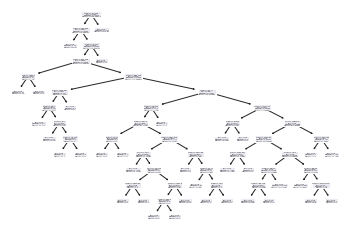

In [727]:
from sklearn import tree

tree.plot_tree(dtree6)

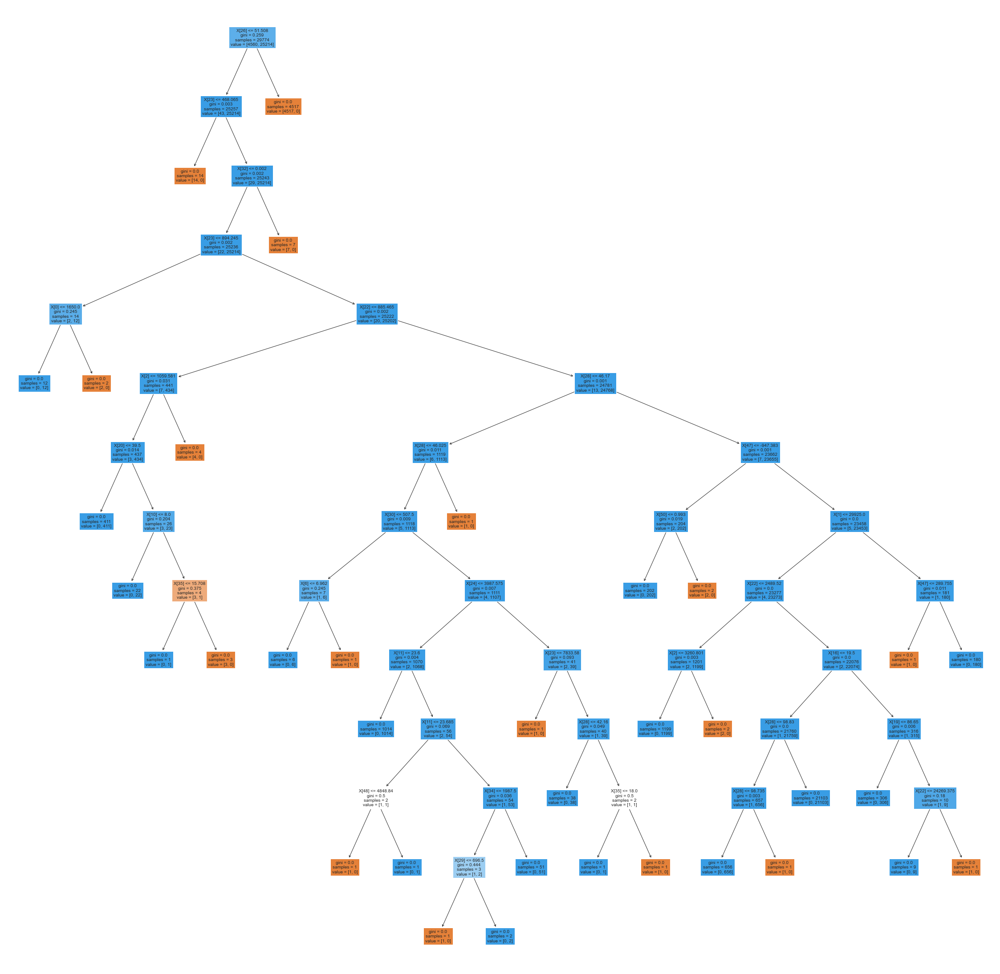

In [728]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtree6, fontsize=10, filled=True)
plt.show()

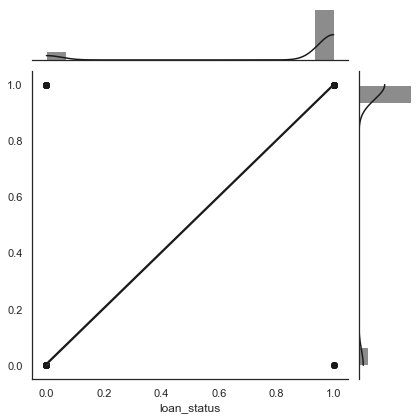

In [729]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y_test, y=y_pred,kind="reg", color="k");

In [730]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc

0.9977938303108886

Wysokie wartości wskaźników.

In [731]:
results1 = pd.DataFrame({'DataFrame':['Srednia dt1'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc6]},index={'1'})
results1 = results1[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Srednia dt1,0.989656,0.993912,0.97001


In [732]:
df_FE6dt=df_FE6.copy()

In [733]:
X6 = df_FE6dt.drop( ['loan_amnt',
 'term',
 'int_rate',
 'emp_length',
 'home_ownership',
 'annual_inc',
 'verification_status',
 'purpose',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'pub_rec',
 'revol_bal',
 'total_rec_late_fee',
 'collection_recovery_fee',
 'last_fico_range_high',
 'last_fico_range_low',
 'pub_rec_bankruptcies',
 'earliest_cr_line_month',
 'earliest_cr_line_year',
 'loan_amnt_rating',
 'small_business',
 'debt_consolidation',
 'last_fico_range_high_rating',
 'issue_d_month',
 'issue_d_YEAR',
 'fico_range_mean',
 'annual_installment',
 'leng_expl',
 'expl', 'loan_status'] , axis=1)
y6 = df_FE6dt['loan_status']

X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6, test_size = 0.3, random_state = 1)

In [734]:
dtreen6 = DecisionTreeClassifier()
dtreen6.fit(X6_train , y6_train)

DecisionTreeClassifier()

[Text(0.253515625, 0.9615384615384616, 'X[12] <= 51.508\ngini = 0.259\nsamples = 29774\nvalue = [4545, 25229]'),
 Text(0.228515625, 0.8846153846153846, 'X[10] <= 468.065\ngini = 0.004\nsamples = 25279\nvalue = [50, 25229]'),
 Text(0.203515625, 0.8076923076923077, 'gini = 0.0\nsamples = 17\nvalue = [17, 0]'),
 Text(0.253515625, 0.8076923076923077, 'X[14] <= 0.002\ngini = 0.003\nsamples = 25262\nvalue = [33, 25229]'),
 Text(0.228515625, 0.7307692307692307, 'X[20] <= -19.419\ngini = 0.002\nsamples = 25255\nvalue = [26, 25229]'),
 Text(0.075, 0.6538461538461539, 'X[22] <= 0.993\ngini = 0.036\nsamples = 379\nvalue = [7, 372]'),
 Text(0.05, 0.5769230769230769, 'gini = 0.0\nsamples = 372\nvalue = [0, 372]'),
 Text(0.1, 0.5769230769230769, 'gini = 0.0\nsamples = 7\nvalue = [7, 0]'),
 Text(0.38203125, 0.6538461538461539, 'X[9] <= 885.42\ngini = 0.002\nsamples = 24876\nvalue = [19, 24857]'),
 Text(0.15, 0.5769230769230769, 'X[1] <= 1059.581\ngini = 0.031\nsamples = 383\nvalue = [6, 377]'),
 Text

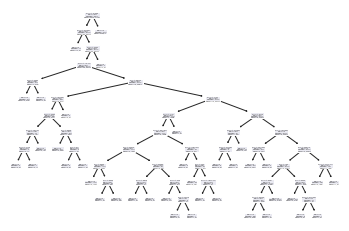

In [743]:
from sklearn import tree

tree.plot_tree(dtreen6)

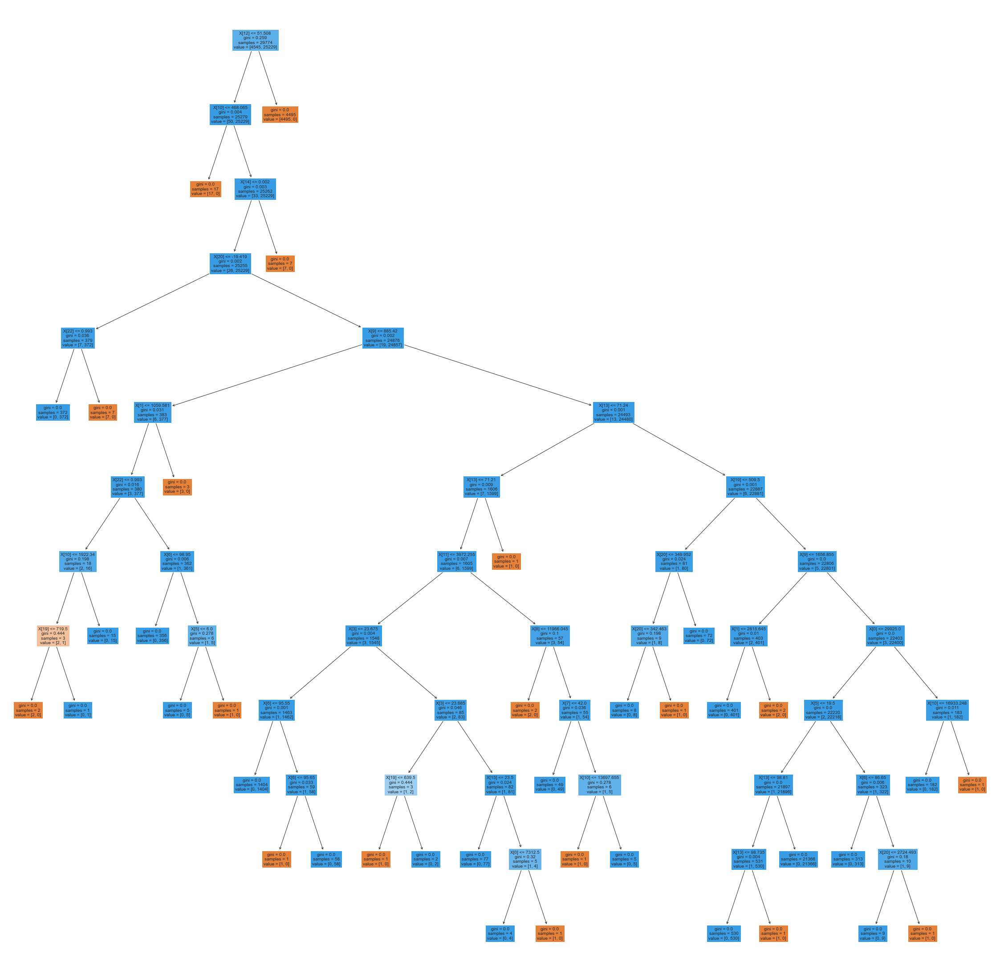

In [744]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtreen6, fontsize=10, filled=True)
plt.show()

In [735]:
print('Feature importances: \n',pd.DataFrame(dtreen6.feature_importances_,columns=['Imp'],index=X6_train.columns))

Feature importances: 
                              Imp
funded_amnt             0.000209
funded_amnt_inv         0.001277
installment             0.000000
dti                     0.000088
delinq_2yrs             0.000000
open_acc                0.000217
revol_util              0.000327
total_acc               0.000039
total_pymnt             0.000483
total_pymnt_inv         0.000025
total_rec_prncp         0.005163
total_rec_int           0.000037
recoveries              0.987043
last_pymnt_amnt         0.000524
debt_settlement_flag    0.001813
earliest_cr_line_YEARS  0.000049
credit_card             0.000000
fico_range_high_rating  0.000000
issue_d_YEARS           0.000000
last_fico_range_mean    0.000349
int_amnt                0.000521
percent_annual_inc      0.000000
financial_ratio         0.001836


In [736]:
y6_pred = dtreen6.predict(X6_test)
print('Performance on training data using DT:',dtreen6.score(X6_train,y6_train))
print('Performance on testing data using DT:',dtreen6.score(X6_test,y6_test))
acc_DT=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_DT)

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.9988245435310712
Accuracy DT:  0.9906673492522031


In [737]:
print(classification_report(y6_test,y6_pred))

dtreen_pr6= evaluate(y6_pred,y6_test)
dtreen_pr6

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1886
           1       1.00      1.00      1.00     10875

    accuracy                           1.00     12761
   macro avg       1.00      1.00      1.00     12761
weighted avg       1.00      1.00      1.00     12761



{'f1-score': 1.0, 'accuracy': 1.0}

In [738]:
def evaluate(y6_pred,y6_test): 
    result = classification_report(y6_test,y6_pred,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [739]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

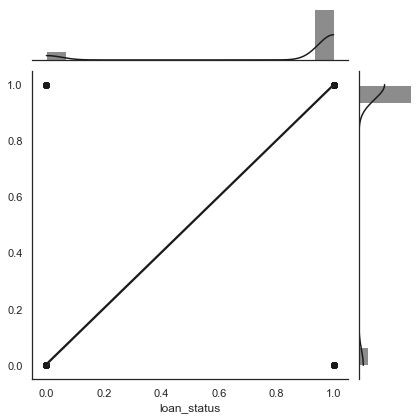

In [740]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y6_test, y=y6_pred, kind="reg", color="k");

In [741]:
cm = metrics.confusion_matrix(y6_test, y6_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1879     7]
 [    8 10867]]
Precision: 0.9957604663487016
Recall: 0.996288441145281
Specificity: 0.999264367816092


In [742]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc

0.9977938303108886

Usunięcie wartości nadmiarowych znaczaco poprawilo dzialanie modelu. W przypadku tego modelu wyliczonego na DF, w ktorym zamieniono wartosci odstajace na srednia, cechy ktore byl brane pod uwagę w predykcji byly najbardziej trafione.

In [745]:
dtreee = pd.DataFrame({'DataFrame':['Srednia'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc6]},index={'2'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Srednia dt1,0.989656,0.993912,0.970010
2,Srednia,0.989656,0.993912,0.997558


### K Nearest Neighbors (KNN)

#### Bez usuwania outliersow

In [748]:
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()
scale.fit(df_FE2.drop('loan_status',axis=1))
scaled_data = scale.transform(df_FE2.drop('loan_status',axis=1))
df_FE2_scaled = pd.DataFrame(scaled_data,columns=df_FE2.drop('loan_status',axis=1).columns)
df_FE2_scaled.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,emp_length,home_ownership,annual_inc,verification_status,...,issue_d_YEAR,issue_d_YEARS,fico_range_mean,last_fico_range_mean,int_amnt,annual_installment,percent_annual_inc,financial_ratio,leng_expl,expl
0,-0.821731,-0.814569,-0.724242,-0.590645,-0.408592,-0.764644,1.441655,0.965107,-0.704240,1.304982,...,-1.694115,1.694115,0.606484,0.554434,-0.015596,-0.764644,0.396035,0.204557,-0.976680,-1.021768
1,-1.159074,-1.164374,-1.071293,1.693064,0.837399,-1.257836,-1.397974,0.965107,-0.610625,0.144273,...,0.353270,-0.353270,0.744651,-4.491734,-0.559775,-1.257836,-1.034807,0.204557,2.860783,-1.459272
2,-1.172567,-1.178366,-1.085315,-0.590645,1.023488,-1.140569,1.441655,0.965107,-0.887537,-1.016435,...,0.645754,-0.645754,0.606484,0.554434,-0.075257,-1.140569,0.424911,0.204557,0.302474,0.290741
3,-0.147044,-0.114958,-0.019623,-0.590645,0.357342,0.079871,1.441655,0.965107,-0.311059,0.144273,...,-0.085455,0.085455,-0.637022,-0.842966,0.301541,0.079871,0.428968,0.204557,-0.976680,-1.021768
4,-1.091605,-1.094413,-1.001181,1.693064,0.141586,-1.219736,-1.114011,0.965107,0.169496,0.144273,...,-0.085455,0.085455,-0.498854,-0.014877,0.031614,-1.219736,-1.377283,0.204557,-0.976680,-1.021768


In [756]:
X = df_FE2_scaled
y= df_FE2['loan_status']
X_scaled_train, X_scaled_test, y_scaled_train, y_scaled_test = train_test_split(scaled_data,df_FE2['loan_status'],
                                                    test_size=0.30)

In [757]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=2)

In [758]:
knn.fit(X_scaled_train,y_scaled_train)

KNeighborsClassifier(n_neighbors=2)

In [759]:
knn_prediction = knn.predict(X_scaled_test)

In [760]:
print(classification_report(knn_prediction,y_scaled_test))
knn1_pr = evaluate(knn_prediction,y_scaled_test)
knn1_pr

              precision    recall  f1-score   support

           0       0.74      0.64      0.69      2204
           1       0.93      0.95      0.94     10557

    accuracy                           0.90     12761
   macro avg       0.84      0.80      0.81     12761
weighted avg       0.90      0.90      0.90     12761



{'f1-score': 0.94, 'accuracy': 0.9}

In [761]:
cm = metrics.confusion_matrix(y_scaled_test, knn_prediction)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1414   487]
 [  790 10070]]
Precision: 0.6415607985480943
Recall: 0.7438190426091531
Specificity: 0.927255985267035


In [762]:
def evaluate(knn_prediction,y_scaled_test): 
    result = classification_report(y_scaled_test,knn_prediction,output_dict=True)
    f1_a = result['1']['f1-score']
    accuracy_a = result['accuracy']
    performance_data= {'f1-score':round(f1_a, 2),
                      'accuracy':round(accuracy_a, 2)}
    return performance_data

In [763]:
f1_a = result['1']['f1-score']
accuracy_a = result['accuracy']

In [290]:
roc_auc=metrics.roc_auc_score(knn_prediction,y_scaled_test)
roc_auc

0.7959479229931972

Best alpha using built-in LassoCV: 0.001298
Best score using built-in LassoCV: 0.633744
Lasso picked 31 variables and eliminated the other 22 variables


Text(0.5, 1.0, 'Feature importance using Lasso Model')

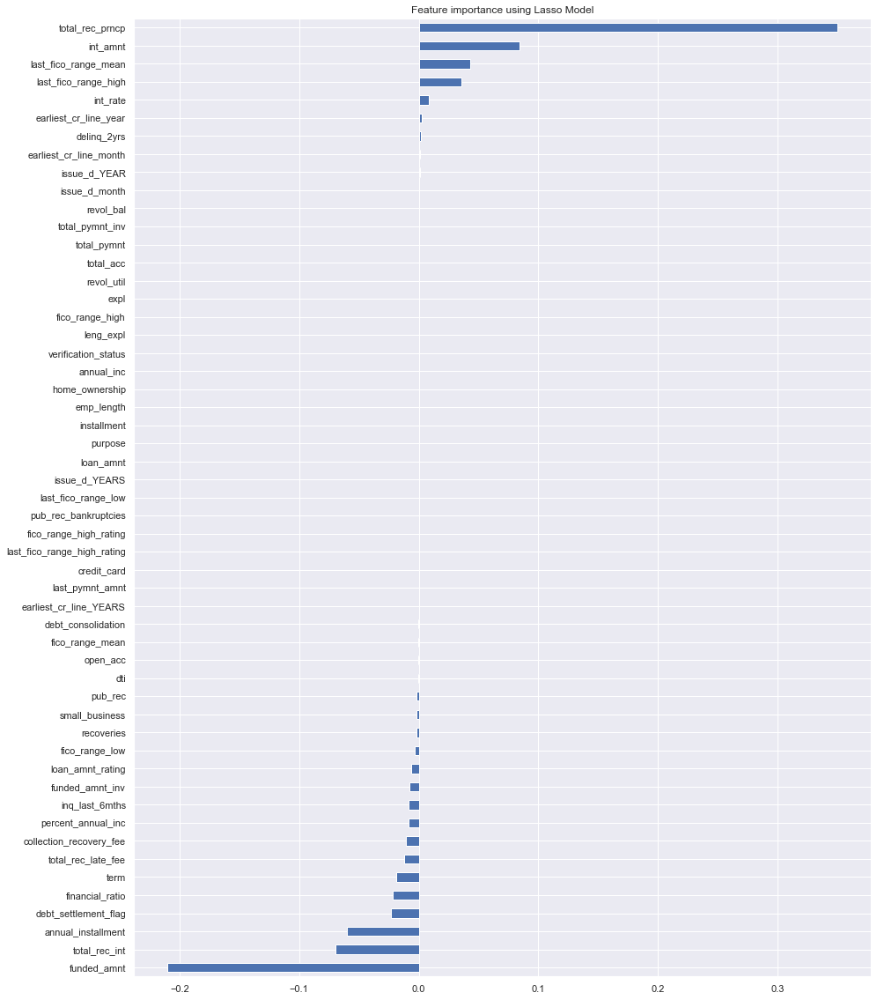

In [767]:
#Atrybuty, ktore sa istotne dla modelu
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE
from sklearn.linear_model import RidgeCV, LassoCV, Ridge, Lasso#Loading the dataset

X = df_FE2_scaled
y= df_FE2['loan_status']

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

In [291]:
results3= pd.DataFrame({'DataFrame':['Bez modyfikacji'], 'accuracy': [accuracy_a], 'f1-score': [f1_a], 'AUCROC':[roc_auc]},index={'1'})
results3 = results3[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results3

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.795948


Otrzymane wartości klasyfikatorów są znacznie niższe niż dla modeli regresji logistycznej i drzewa decyzyjnego. Model wyeliminowal 22 wartosci nadmiarowe a pozostawił .

#### Mediana

In [292]:
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()
scale.fit(df_FE3.drop('loan_status',axis=1))
scaled_data = scale.transform(df_FE3.drop('loan_status',axis=1))
df_FE3_scaled = pd.DataFrame(scaled_data,columns=df_FE3.drop('loan_status',axis=1).columns)
df_FE3_scaled.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,emp_length,home_ownership,annual_inc,verification_status,...,issue_d_YEAR,issue_d_YEARS,fico_range_mean,last_fico_range_mean,int_amnt,annual_installment,percent_annual_inc,financial_ratio,leng_expl,expl
0,-0.851697,-0.837808,-0.740909,-0.590645,-0.405910,-0.786611,1.441655,0.965107,-1.341564,1.304982,...,-2.166898,2.166898,0.606913,0.602788,-0.340148,-0.786611,0.517454,0.0,-1.060855,-1.109496
1,-1.244597,-1.224464,-1.146013,1.693064,0.852331,-1.371435,-1.397974,0.965107,-1.124484,0.144273,...,0.305077,-0.305077,0.745127,0.067666,-2.161415,-1.371435,-1.089964,0.0,0.477987,-1.631444
2,-1.260313,-1.239930,-1.162381,-0.590645,1.040250,-1.232380,1.441655,0.965107,-1.766607,-1.016435,...,0.658216,-0.658216,0.606913,0.602788,-0.539820,-1.232380,0.549894,0.0,0.477987,0.456347
3,-0.065898,-0.064497,0.081576,-0.590645,0.367554,0.214810,1.441655,0.965107,-0.429826,0.144273,...,-0.224632,0.224632,-0.637012,-1.203250,0.721252,0.214810,0.554452,0.0,-1.060855,-1.109496
4,-1.166017,-1.147133,-1.064174,1.693064,0.149677,-1.326256,-1.114011,0.965107,0.684520,0.144273,...,-0.224632,0.224632,-0.498798,-0.133005,-0.182146,-1.326256,-1.474704,0.0,-1.060855,-1.109496


In [769]:
X = df_FE3_scaled
y= df_FE3['loan_status']

X2_scaled_train, X2_scaled_test, y2_scaled_train, y2_scaled_test = train_test_split(scaled_data,df_FE3['loan_status'],
                                                    test_size=0.30)

In [770]:
from sklearn.neighbors import KNeighborsClassifier
knn2 = KNeighborsClassifier(n_neighbors=2)

In [771]:
knn2.fit(X2_scaled_train,y2_scaled_train)

KNeighborsClassifier(n_neighbors=2)

In [772]:
knn_prediction2 = knn2.predict(X2_scaled_test)

In [297]:
print(classification_report(knn_prediction2,y2_scaled_test))
knn1_pr2 = evaluate(knn_prediction2,y2_scaled_test)
knn1_pr2

              precision    recall  f1-score   support

           0       0.75      0.66      0.70      2199
           1       0.93      0.95      0.94     10562

    accuracy                           0.90     12761
   macro avg       0.84      0.81      0.82     12761
weighted avg       0.90      0.90      0.90     12761



{'f1-score': 0.94, 'accuracy': 0.9}

In [298]:
def evaluate(knn_prediction2,y2_scaled_test): 
    result = classification_report(y2_scaled_test,knn_prediction2,output_dict=True)
    f1_2 = result['1']['f1-score']
    accuracy2 = result['accuracy']
    performance_data= {'f1-score':round(f1_2, 2),
                      'accuracy':round(accuracy2, 2)}
    return performance_data

In [299]:
f1_2 = result['1']['f1-score']
accuracy2 = result['accuracy']

In [773]:
cm = metrics.confusion_matrix(y2_scaled_test,knn_prediction2)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1430   484]
 [  767 10080]]
Precision: 0.650887573964497
Recall: 0.7471264367816092
Specificity: 0.9292892043883101


In [774]:
roc_auc2=metrics.roc_auc_score(knn_prediction2,y2_scaled_test)
roc_auc2

0.8025357975842932

Best alpha using built-in LassoCV: 0.000165
Best score using built-in LassoCV: 0.608227
Lasso picked 39 variables and eliminated the other 14 variables


Text(0.5, 1.0, 'Feature importance using Lasso Model')

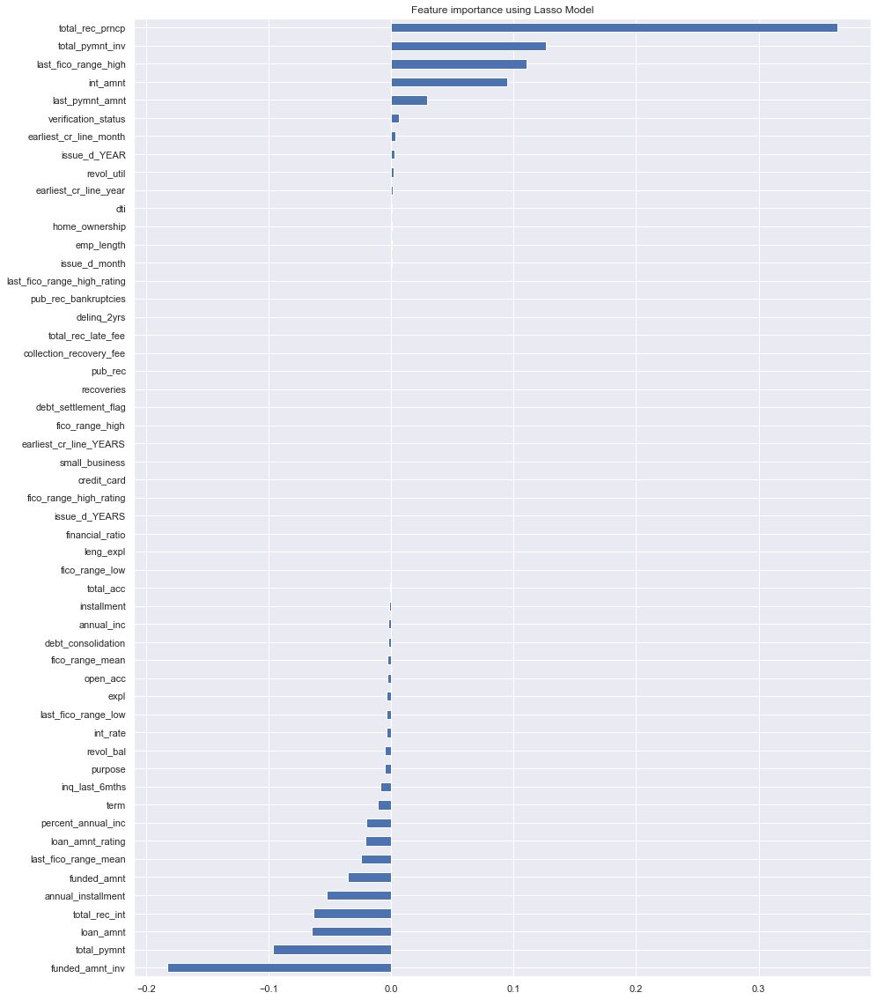

In [775]:
X = df_FE3_scaled
y= df_FE3['loan_status']

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

In [301]:
KNN= pd.DataFrame({'DataFrame':['Mediana'], 'accuracy': [accuracy2], 'f1-score': [f1_2],'AUCROC':[roc_auc2]},index={'2'})
results3 = pd.concat([results3, KNN])
results3 = results3[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results3

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.795948
2,Mediana,0.989734,0.993958,0.805267


Wartosci klasyfikatorow sa delikatnie wyzsze jak w przypadku poprzedniego modelu. W tym przypadku model odrzuil 14 wartosci nadmiarowych.

#### Usunięcie outliersów

In [776]:
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()
scale.fit(df_FE4.drop('loan_status',axis=1))
scaled_data = scale.transform(df_FE4.drop('loan_status',axis=1))
df_FE4_scaled = pd.DataFrame(scaled_data,columns=df_FE4.drop('loan_status',axis=1).columns)
df_FE4_scaled.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,emp_length,home_ownership,annual_inc,verification_status,...,issue_d_YEAR,issue_d_YEARS,fico_range_mean,last_fico_range_mean,int_amnt,annual_installment,percent_annual_inc,financial_ratio,leng_expl,expl
0,-0.789457,-0.789265,-0.708176,-0.521948,-0.272383,-0.719294,1.513269,0.897586,-1.138378,1.431694,...,-2.065991,2.065991,0.614387,0.559949,-0.151146,-0.719294,0.493992,0.088629,-0.958099,-1.061281
1,0.081449,0.085040,0.169625,-0.521948,0.551084,0.297890,1.513269,0.897586,-0.383496,0.237136,...,-0.252529,0.252529,-0.682005,-1.257211,0.369942,0.297890,0.529860,0.088629,-0.958099,-1.061281
2,-1.137819,-1.138988,-1.053182,1.915899,0.319121,-1.267433,-1.080442,0.897586,0.539137,0.237136,...,-0.252529,0.252529,-0.537961,-0.180375,-0.073576,-1.267433,-1.437301,0.088629,-0.958099,-1.061281
3,-0.789457,-0.789265,-0.703809,-0.521948,-1.069755,-0.756247,-0.504062,0.897586,-0.778911,0.237136,...,1.066352,-1.066352,0.470344,-1.795628,-0.239069,-0.756247,-0.299529,0.088629,1.611889,2.396843
4,-0.441095,-0.439543,-0.354435,1.915899,1.267268,-0.677728,0.936888,0.897586,-0.449279,-0.957423,...,1.231212,-1.231212,-0.682005,-0.584189,0.714844,-0.677728,-0.536172,0.088629,2.896884,-1.538264


In [777]:
X = df_FE4_scaled
y= df_FE4['loan_status']
X3_scaled_train, X3_scaled_test, y3_scaled_train, y3_scaled_test = train_test_split(scaled_data,df_FE4['loan_status'],
                                                    test_size=0.30)

In [778]:
from sklearn.neighbors import KNeighborsClassifier
knn3 = KNeighborsClassifier(n_neighbors=2)

In [779]:
knn3.fit(X3_scaled_train,y3_scaled_train)

KNeighborsClassifier(n_neighbors=2)

In [780]:
knn_prediction3 = knn3.predict(X3_scaled_test)

In [781]:
print(classification_report(knn_prediction3,y3_scaled_test))
knn1_pr3 = evaluate(knn_prediction3,y3_scaled_test)
knn1_pr3

              precision    recall  f1-score   support

           0       0.74      0.69      0.71       972
           1       0.96      0.97      0.97      7785

    accuracy                           0.94      8757
   macro avg       0.85      0.83      0.84      8757
weighted avg       0.94      0.94      0.94      8757



{'f1-score': 0.97, 'accuracy': 0.94}

In [308]:
def evaluate(knn_prediction3,y3_scaled_test): 
    result = classification_report(y3_scaled_test,knn_prediction3,output_dict=True)
    f1_3 = result['1']['f1-score']
    accuracy3 = result['accuracy']
    performance_data= {'f1-score':round(f1_3, 2),
                      'accuracy':round(accuracy3, 2)}
    return performance_data

In [309]:
f1_3 = result['1']['f1-score']
accuracy3 = result['accuracy']

In [782]:
cm = metrics.confusion_matrix(knn_prediction3,y3_scaled_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 670  302]
 [ 239 7546]]
Precision: 0.7370737073707371
Recall: 0.6893004115226338
Specificity: 0.9692999357739243


In [783]:
roc_auc3=metrics.roc_auc_score(knn_prediction3,y3_scaled_test)
roc_auc3

0.829300173648279

Best alpha using built-in LassoCV: 0.000196
Best score using built-in LassoCV: 0.692313
Lasso picked 41 variables and eliminated the other 12 variables


C:\Users\patry\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.179e+00, tolerance: 2.795e-01
  model = cd_fast.enet_coordinate_descent(


Text(0.5, 1.0, 'Feature importance using Lasso Model')

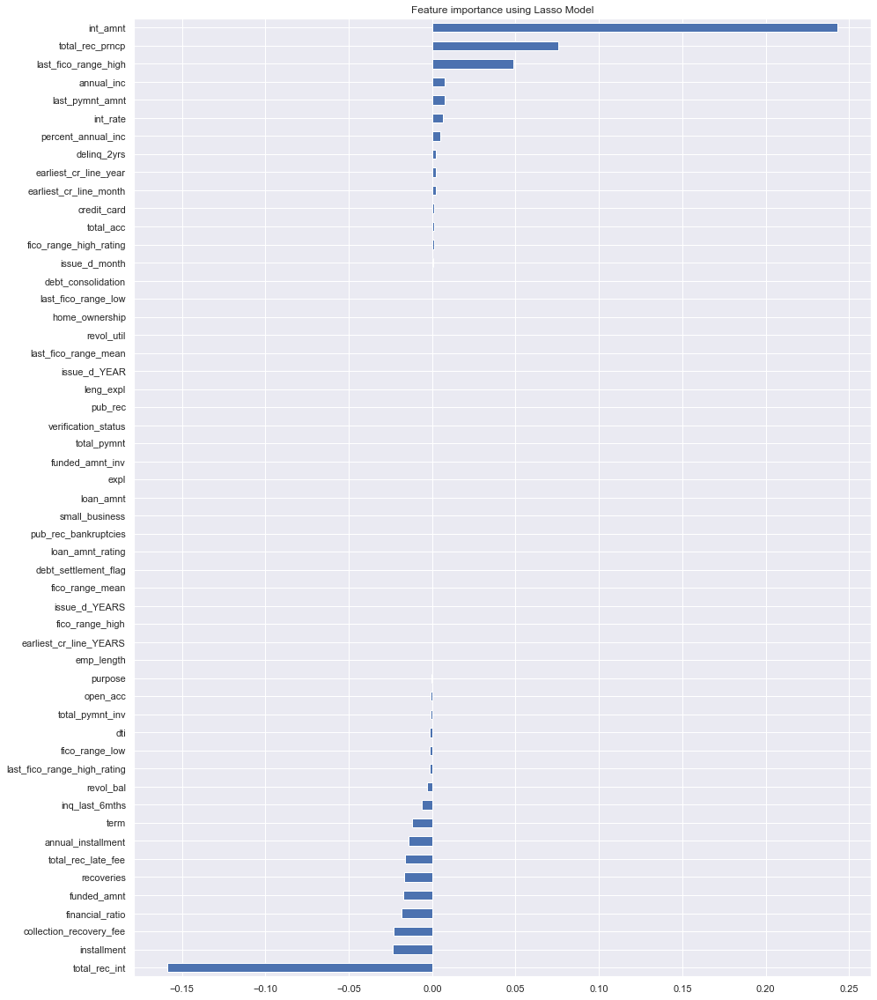

In [784]:
X = df_FE4_scaled
y= df_FE4['loan_status']

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

In [311]:
KNN= pd.DataFrame({'DataFrame':['Bez outliersow'], 'accuracy': [accuracy3], 'f1-score': [f1_3],'AUCROC':[roc_auc3]},index={'3'})
results3 = pd.concat([results3, KNN])
results3 = results3[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results3

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.795948
2,Mediana,0.989734,0.993958,0.805267
3,Bez outliersow,0.989734,0.993958,0.841934


Wartosci klasyfikatorow sa delikatnie wyzsze jak w przypadku poprzednich modeli. W tym przypadku model odrzuil 12 wartosci nadmiarowych.


#### Dummies

In [312]:
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()
scale.fit(df_dummies)
scaled_data = scale.transform(df_dummies)
df_dummies_scaled = pd.DataFrame(scaled_data,columns=df_dummies.columns)
df_dummies_scaled.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,emp_length,annual_inc,dti,delinq_2yrs,...,last_fico_range_high_rating_Poor,last_fico_range_high_rating_Very Good,fico_range_high_rating_Excellent,fico_range_high_rating_Fair,fico_range_high_rating_Good,fico_range_high_rating_Very Good,leng_expl_Poor,leng_expl_Satisfactory,leng_expl_Sofisticated,leng_expl_Very Poor
0,-0.821731,-0.814569,-0.724242,-0.590645,-0.408592,-0.764644,1.441655,-0.704240,2.122578,-0.297409,...,-0.358203,-0.527602,-0.122019,-0.317449,0.726298,-0.560597,1.188031,-0.893897,-0.340837,-0.196221
1,-1.159074,-1.164374,-1.071293,1.693064,0.837399,-1.257836,-1.397974,-0.610625,-1.839520,-0.297409,...,2.791715,-0.527602,-0.122019,-0.317449,-1.376846,1.783813,-0.841729,-0.893897,-0.340837,5.096283
2,-1.172567,-1.178366,-1.085315,-0.590645,1.023488,-1.140569,1.441655,-0.887537,-0.691775,-0.297409,...,-0.358203,-0.527602,-0.122019,-0.317449,0.726298,-0.560597,-0.841729,1.118697,-0.340837,-0.196221
3,-0.147044,-0.114958,-0.019623,-0.590645,0.357342,0.079871,1.441655,-0.311059,0.985240,-0.297409,...,-0.358203,-0.527602,-0.122019,-0.317449,0.726298,-0.560597,1.188031,-0.893897,-0.340837,-0.196221
4,-1.091605,-1.094413,-1.001181,1.693064,0.141586,-1.219736,-1.114011,0.169496,0.678977,-0.297409,...,-0.358203,-0.527602,-0.122019,-0.317449,0.726298,-0.560597,1.188031,-0.893897,-0.340837,-0.196221


In [313]:
X4_scaled_train, X4_scaled_test, y4_scaled_train, y4_scaled_test = train_test_split(scaled_data, target,
                                                    test_size=0.30)

In [314]:
from sklearn.neighbors import KNeighborsClassifier
knn4 = KNeighborsClassifier(n_neighbors=2)

In [315]:
knn4.fit(X4_scaled_train,y4_scaled_train)

KNeighborsClassifier(n_neighbors=2)

In [316]:
knn_prediction4 = knn4.predict(X4_scaled_test)

In [317]:
print(classification_report(knn_prediction4,y4_scaled_test))
knn1_pr4 = evaluate(knn_prediction4,y4_scaled_test)
knn1_pr4

              precision    recall  f1-score   support

           0       0.69      0.59      0.63      2316
           1       0.91      0.94      0.93     10445

    accuracy                           0.88     12761
   macro avg       0.80      0.76      0.78     12761
weighted avg       0.87      0.88      0.87     12761



{'f1-score': 0.93, 'accuracy': 0.88}

In [318]:
def evaluate(knn_prediction4,y4_scaled_test): 
    result = classification_report(y4_scaled_test,knn_prediction4,output_dict=True)
    f1_4 = result['1']['f1-score']
    accuracy4 = result['accuracy']
    performance_data= {'f1-score':round(f1_4, 2),
                      'accuracy':round(accuracy4, 2)}
    return performance_data

In [319]:
f1_4 = result['1']['f1-score']
accuracy4 = result['accuracy']

In [785]:
cm = metrics.confusion_matrix(knn_prediction4,y4_scaled_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[1355  961]
 [ 603 9842]]
Precision: 0.6920326864147089
Recall: 0.5850604490500864
Specificity: 0.9422690282431786


In [786]:
roc_auc4=metrics.roc_auc_score(knn_prediction4,y4_scaled_test)
roc_auc4

0.7636647386466324

Best alpha using built-in LassoCV: 0.001298
Best score using built-in LassoCV: 0.640111
Lasso picked 46 variables and eliminated the other 40 variables


Text(0.5, 1.0, 'Feature importance using Lasso Model')

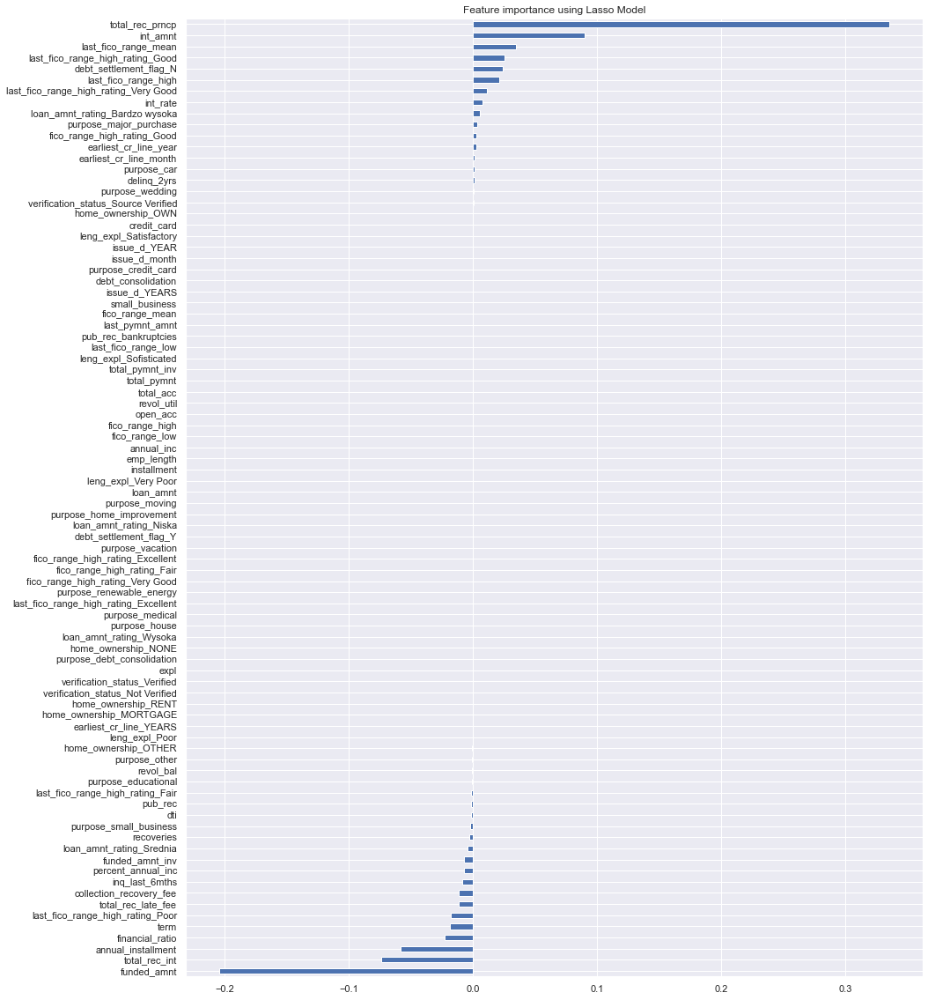

In [787]:
X = df_dummies_scaled
y= df_FE2['loan_status']

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

In [321]:
KNN= pd.DataFrame({'DataFrame':['Dummies'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc4]},index={'4'})
results3 = pd.concat([results3, KNN])
results3 = results3[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results3

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.795948
2,Mediana,0.989734,0.993958,0.805267
3,Bez outliersow,0.989734,0.993958,0.841934
4,Dummies,0.989734,0.993958,0.763665


DF z one-hot-encodingiem miał o wiele niższe wartości klasyfikatora. Model odrzucił 40 wartości nadmiarowych.

#### Srednia

In [788]:
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()
scale.fit(df_FE6.drop('loan_status',axis=1))
scaled_data6 = scale.transform(df_FE6.drop('loan_status',axis=1))
df_FE6_scaled = pd.DataFrame(scaled_data6,columns=df_FE6.drop('loan_status',axis=1).columns)
df_FE6_scaled.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,emp_length,home_ownership,annual_inc,verification_status,...,issue_d_YEAR,issue_d_YEARS,fico_range_mean,last_fico_range_mean,int_amnt,annual_installment,percent_annual_inc,financial_ratio,leng_expl,expl
0,-0.857989,-0.840964,-0.748373,-0.590645,-0.406016,-0.795039,1.441655,0.965107,-1.356725,1.304982,...,-2.159419,2.159419,0.606907,0.606135,-0.324449,-0.795039,0.513319,0.221951,-1.051669,-1.114563
1,-1.250906,-1.227659,-1.153576,1.693064,0.852227,-1.379920,-1.397974,0.965107,-1.140021,0.144273,...,0.312693,-0.312693,0.745121,-0.110378,-2.139358,-1.379920,-1.094372,0.221951,0.128122,-1.636458
2,-1.266622,-1.243127,-1.169948,-0.590645,1.040146,-1.240852,1.441655,0.965107,-1.781030,-1.016435,...,0.665852,-0.665852,0.606907,0.606135,-0.523424,-1.240852,0.545764,0.221951,0.493498,0.451123
3,-0.072155,-0.067573,0.074312,-0.590645,0.367449,0.206478,1.441655,0.965107,-0.446570,0.144273,...,-0.217045,0.217045,-0.637018,-1.199771,0.733246,0.206478,0.550323,0.221951,-1.051669,-1.114563
4,-1.172322,-1.150320,-1.071717,1.693064,0.149572,-1.334737,-1.114011,0.965107,0.665841,0.144273,...,-0.217045,0.217045,-0.498804,-0.129605,-0.166998,-1.334737,-1.479177,0.221951,-1.051669,-1.114563


In [789]:
X = df_FE6_scaled
y= df_FE6['loan_status']

X6_scaled_train, X6_scaled_test, y6_scaled_train, y6_scaled_test = train_test_split(scaled_data6,df_FE6['loan_status'],
                                                    test_size=0.30)

In [790]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=2)

In [791]:
knn.fit(X6_scaled_train,y6_scaled_train)

KNeighborsClassifier(n_neighbors=2)

In [792]:
knn_prediction6 = knn.predict(X6_scaled_test)

In [793]:
print(classification_report(knn_prediction6,y6_scaled_test))
knn1_pr6 = evaluate(knn_prediction6,y6_scaled_test)
knn1_pr6

              precision    recall  f1-score   support

           0       0.96      0.99      0.98      1896
           1       1.00      0.99      1.00     10865

    accuracy                           0.99     12761
   macro avg       0.98      0.99      0.99     12761
weighted avg       0.99      0.99      0.99     12761



{'f1-score': 1.0, 'accuracy': 0.99}

In [794]:
def evaluate(knn_prediction6,y6_scaled_test): 
    result = classification_report(y6_scaled_test,knn_prediction6,output_dict=True)
    f1_a = result['1']['f1-score']
    accuracy_a = result['accuracy']
    performance_data= {'f1-score':round(f1_a, 2),
                      'accuracy':round(accuracy_a, 2)}
    return performance_data

In [795]:
f1_a = result['1']['f1-score']
accuracy_a = result['accuracy']

In [797]:
cm = metrics.confusion_matrix(knn_prediction6,y6_scaled_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1875    21]
 [   71 10794]]
Precision: 0.9635149023638232
Recall: 0.9889240506329114
Specificity: 0.993465255407271


In [330]:
roc_auc6=metrics.roc_auc_score(knn_prediction6,y6_scaled_test)
roc_auc6

0.9912784483197333

Best alpha using built-in LassoCV: 0.000409
Best score using built-in LassoCV: 0.987148
Lasso picked 18 variables and eliminated the other 35 variables


Text(0.5, 1.0, 'Feature importance using Lasso Model')

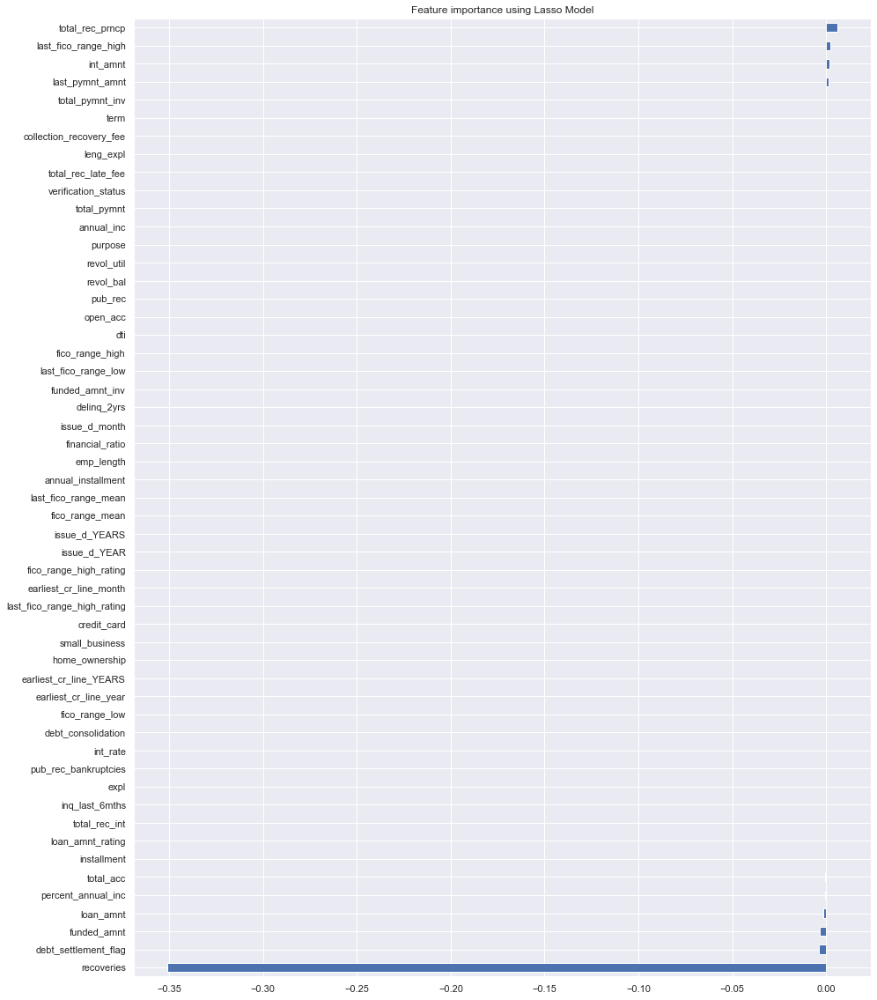

In [798]:
X = df_FE6_scaled
y= df_FE6['loan_status']

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

In [331]:
KNN= pd.DataFrame({'DataFrame':['Srednia'], 'accuracy': [accuracy2], 'f1-score': [f1_2],'AUCROC':[roc_auc2]},index={'2'})
results3 = pd.concat([results3, KNN])
results3 = results3[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results3

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.795948
2,Mediana,0.989734,0.993958,0.805267
3,Bez outliersow,0.989734,0.993958,0.841934
4,Dummies,0.989734,0.993958,0.763665
2,Srednia,0.989734,0.993958,0.805267


In [ ]:
Najlepiej wytrenowany model sposrod wszystkich KNN. Najwyższe wartosci wskaźników. Model odrzucił 35 nadmiarowych cech. Istotna okazala sie cecha recoveries  

### Bagging

In [332]:
!pip install xgboost 
!pip install lightgbm
!pip install catboost

#### Bez usuwania outliersow

In [800]:
from sklearn.ensemble import BaggingClassifier
from sklearn import tree

X=df_FE2.iloc[:, :-1]
y=df_FE2.iloc[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 42)

model = BaggingClassifier(tree.DecisionTreeClassifier(random_state=1))
model.fit(X_train, y_train)
model.score(X_test,y_test)

0.9992163623540475

In [801]:
y_pred = model.predict(X_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train,y_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X_test,y_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y_test, y_pred))

Performance on training data using GBR: 0.9999664136494928
Performance on testing data using GBR: 0.9992163623540475
Accuracy DT:  0.9937369909188577
MSE:  0.0007836376459525115


In [802]:
cm = metrics.confusion_matrix(y_pred,y_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1863     2]
 [    8 10888]]
Precision: 0.9957242116515232
Recall: 0.9989276139410188
Specificity: 0.9992657856093979


In [803]:
roc_auc=metrics.roc_auc_score(y_pred,y_test)
roc_auc

0.9990966997752083

In [336]:
results4= pd.DataFrame({'Bez modyfikacji':['BaggingClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y_test, y_pred)], 'AUCROC':[roc_auc]},index={'1'})
results4 = results4[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results4

,Bez modyfikacji,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.993111,0.000862,0.999051


In [804]:
from sklearn.ensemble import AdaBoostClassifier

X=df_FE2.iloc[:, :-1]
y=df_FE2.iloc[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 42)

model = AdaBoostClassifier(random_state=1)
model.fit(X_train, y_train)
model.score(X_test,y_test)

0.9994514536478333

In [805]:
y_pred = model.predict(X_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train,y_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X_test,y_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y_test, y_pred))

Performance on training data using GBR: 1.0
Performance on testing data using GBR: 0.9994514536478333
Accuracy DT:  0.9956158936432004
MSE:  0.0005485463521667581


In [806]:
cm = metrics.confusion_matrix(y_pred,y_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1864     0]
 [    7 10890]]
Precision: 0.9962586851950829
Recall: 1.0
Specificity: 0.9993576213636781


In [339]:
roc_auc=metrics.roc_auc_score(y_pred,y_test)
roc_auc

0.9996788106818391

In [340]:
BAG= pd.DataFrame({'Bez modyfikacji':['AdaBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y_test, y_pred)], 'AUCROC':[roc_auc]},index={'4'})
results4 = pd.concat([results4, BAG])
results4 = results4[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results4

,Bez modyfikacji,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.993111,0.000862,0.999051
4,AdaBoostClassifier,0.995616,0.000549,0.999679


In [807]:
import xgboost as xgb #wczytanie

X=df_FE2.iloc[:, :-1]
y=df_FE2.iloc[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 42)

model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X_train, y_train)
model.score(X_test,y_test)

0.998746179766476

In [808]:
y_pred = model.predict(X_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train,y_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X_test,y_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y_test, y_pred))

Performance on training data using GBR: 0.9994962047423926
Performance on testing data using GBR: 0.998746179766476
Accuracy DT:  0.9899791854701723
MSE:  0.0012538202335240186


In [809]:
cm = metrics.confusion_matrix(y_pred,y_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1855     0]
 [   16 10890]]
Precision: 0.9914484233030465
Recall: 1.0
Specificity: 0.9985329176600036


In [810]:
roc_auc=metrics.roc_auc_score(y_pred,y_test)
roc_auc

0.9992664588300018

In [344]:
BAG= pd.DataFrame({'Bez modyfikacji':['xgboost'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y_test, y_pred)], 'AUCROC':[roc_auc]},index={'4'})
results4 = pd.concat([results4, BAG])
results4 = results4[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results4

,Bez modyfikacji,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.993111,0.000862,0.999051
4,AdaBoostClassifier,0.995616,0.000549,0.999679
4,xgboost,0.989979,0.001254,0.999266


In [811]:
from catboost import CatBoostClassifier
X=df_FE2.iloc[:, :-1]
y=df_FE2.iloc[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)
model=CatBoostClassifier()
categorical_features_indices = np.where(df_FE2.dtypes != np.float64)[0]
print(categorical_features_indices)
model.fit(X_train,y_train,eval_set=(X_test, y_test))
model.score(X_test,y_test)

[ 7  9 10 32 33 36 37 38 39 40 41 42 51 52 53]
Learning rate set to 0.073273
0:	learn: 0.4847278	test: 0.4849470	best: 0.4849470 (0)	total: 39.3ms	remaining: 39.3s
1:	learn: 0.3548911	test: 0.3550122	best: 0.3550122 (1)	total: 49ms	remaining: 24.5s
2:	learn: 0.2496466	test: 0.2496540	best: 0.2496540 (2)	total: 58.8ms	remaining: 19.5s
3:	learn: 0.1777737	test: 0.1777386	best: 0.1777386 (3)	total: 68.8ms	remaining: 17.1s
4:	learn: 0.1285872	test: 0.1285275	best: 0.1285275 (4)	total: 79ms	remaining: 15.7s
5:	learn: 0.0938631	test: 0.0939067	best: 0.0939067 (5)	total: 88.5ms	remaining: 14.7s
6:	learn: 0.0692474	test: 0.0692648	best: 0.0692648 (6)	total: 97.9ms	remaining: 13.9s
7:	learn: 0.0521572	test: 0.0521310	best: 0.0521310 (7)	total: 106ms	remaining: 13.2s
8:	learn: 0.0397540	test: 0.0396612	best: 0.0396612 (8)	total: 115ms	remaining: 12.7s
9:	learn: 0.0321201	test: 0.0319151	best: 0.0319151 (9)	total: 122ms	remaining: 12.1s
10:	learn: 0.0259794	test: 0.0257010	best: 0.0257010 (10)	to

102:	learn: 0.0020269	test: 0.0022289	best: 0.0022289 (102)	total: 839ms	remaining: 7.3s
103:	learn: 0.0020269	test: 0.0022289	best: 0.0022289 (103)	total: 847ms	remaining: 7.29s
104:	learn: 0.0020269	test: 0.0022288	best: 0.0022288 (104)	total: 855ms	remaining: 7.28s
105:	learn: 0.0020268	test: 0.0022288	best: 0.0022288 (105)	total: 861ms	remaining: 7.26s
106:	learn: 0.0020069	test: 0.0022158	best: 0.0022158 (106)	total: 871ms	remaining: 7.27s
107:	learn: 0.0019818	test: 0.0022119	best: 0.0022119 (107)	total: 880ms	remaining: 7.26s
108:	learn: 0.0019574	test: 0.0021870	best: 0.0021870 (108)	total: 889ms	remaining: 7.26s
109:	learn: 0.0019574	test: 0.0021870	best: 0.0021870 (109)	total: 895ms	remaining: 7.24s
110:	learn: 0.0019574	test: 0.0021870	best: 0.0021870 (109)	total: 902ms	remaining: 7.22s
111:	learn: 0.0019574	test: 0.0021870	best: 0.0021870 (111)	total: 908ms	remaining: 7.2s
112:	learn: 0.0019574	test: 0.0021870	best: 0.0021870 (111)	total: 914ms	remaining: 7.17s
113:	learn: 

214:	learn: 0.0018314	test: 0.0021461	best: 0.0021430 (171)	total: 1.58s	remaining: 5.78s
215:	learn: 0.0018314	test: 0.0021461	best: 0.0021430 (171)	total: 1.59s	remaining: 5.77s
216:	learn: 0.0018314	test: 0.0021461	best: 0.0021430 (171)	total: 1.6s	remaining: 5.77s
217:	learn: 0.0018314	test: 0.0021461	best: 0.0021430 (171)	total: 1.6s	remaining: 5.75s
218:	learn: 0.0018314	test: 0.0021461	best: 0.0021430 (171)	total: 1.61s	remaining: 5.75s
219:	learn: 0.0018314	test: 0.0021460	best: 0.0021430 (171)	total: 1.62s	remaining: 5.73s
220:	learn: 0.0018314	test: 0.0021460	best: 0.0021430 (171)	total: 1.62s	remaining: 5.72s
221:	learn: 0.0018314	test: 0.0021460	best: 0.0021430 (171)	total: 1.63s	remaining: 5.71s
222:	learn: 0.0018314	test: 0.0021460	best: 0.0021430 (171)	total: 1.64s	remaining: 5.7s
223:	learn: 0.0018313	test: 0.0021460	best: 0.0021430 (171)	total: 1.64s	remaining: 5.7s
224:	learn: 0.0018313	test: 0.0021460	best: 0.0021430 (171)	total: 1.65s	remaining: 5.69s
225:	learn: 0.

324:	learn: 0.0018018	test: 0.0021473	best: 0.0021430 (171)	total: 2.31s	remaining: 4.79s
325:	learn: 0.0018018	test: 0.0021473	best: 0.0021430 (171)	total: 2.31s	remaining: 4.78s
326:	learn: 0.0018018	test: 0.0021473	best: 0.0021430 (171)	total: 2.32s	remaining: 4.77s
327:	learn: 0.0018018	test: 0.0021473	best: 0.0021430 (171)	total: 2.33s	remaining: 4.76s
328:	learn: 0.0018018	test: 0.0021473	best: 0.0021430 (171)	total: 2.33s	remaining: 4.76s
329:	learn: 0.0018018	test: 0.0021473	best: 0.0021430 (171)	total: 2.34s	remaining: 4.75s
330:	learn: 0.0018018	test: 0.0021473	best: 0.0021430 (171)	total: 2.34s	remaining: 4.74s
331:	learn: 0.0018018	test: 0.0021473	best: 0.0021430 (171)	total: 2.35s	remaining: 4.73s
332:	learn: 0.0018017	test: 0.0021473	best: 0.0021430 (171)	total: 2.36s	remaining: 4.72s
333:	learn: 0.0018017	test: 0.0021473	best: 0.0021430 (171)	total: 2.36s	remaining: 4.71s
334:	learn: 0.0018017	test: 0.0021473	best: 0.0021430 (171)	total: 2.37s	remaining: 4.7s
335:	learn:

443:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.06s	remaining: 3.83s
444:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.06s	remaining: 3.82s
445:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.07s	remaining: 3.81s
446:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.08s	remaining: 3.81s
447:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.08s	remaining: 3.8s
448:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.09s	remaining: 3.79s
449:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.09s	remaining: 3.78s
450:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.1s	remaining: 3.77s
451:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.1s	remaining: 3.76s
452:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.11s	remaining: 3.75s
453:	learn: 0.0018014	test: 0.0021469	best: 0.0021430 (171)	total: 3.12s	remaining: 3.75s
454:	learn: 0

543:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.05s	remaining: 3.4s
544:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.08s	remaining: 3.4s
545:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.1s	remaining: 3.41s
546:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.12s	remaining: 3.41s
547:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.14s	remaining: 3.42s
548:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.17s	remaining: 3.42s
549:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.19s	remaining: 3.43s
550:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.21s	remaining: 3.44s
551:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.24s	remaining: 3.44s
552:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.26s	remaining: 3.45s
553:	learn: 0.0017868	test: 0.0021475	best: 0.0021430 (171)	total: 4.29s	remaining: 3.45s
554:	learn: 0

640:	learn: 0.0017866	test: 0.0021472	best: 0.0021430 (171)	total: 7.38s	remaining: 4.13s
641:	learn: 0.0017865	test: 0.0021472	best: 0.0021430 (171)	total: 7.42s	remaining: 4.14s
642:	learn: 0.0017865	test: 0.0021472	best: 0.0021430 (171)	total: 7.46s	remaining: 4.14s
643:	learn: 0.0017865	test: 0.0021472	best: 0.0021430 (171)	total: 7.49s	remaining: 4.14s
644:	learn: 0.0017865	test: 0.0021472	best: 0.0021430 (171)	total: 7.52s	remaining: 4.14s
645:	learn: 0.0017865	test: 0.0021471	best: 0.0021430 (171)	total: 7.55s	remaining: 4.14s
646:	learn: 0.0017865	test: 0.0021471	best: 0.0021430 (171)	total: 7.59s	remaining: 4.14s
647:	learn: 0.0017865	test: 0.0021471	best: 0.0021430 (171)	total: 7.63s	remaining: 4.14s
648:	learn: 0.0017865	test: 0.0021471	best: 0.0021430 (171)	total: 7.67s	remaining: 4.14s
649:	learn: 0.0017865	test: 0.0021471	best: 0.0021430 (171)	total: 7.7s	remaining: 4.15s
650:	learn: 0.0017865	test: 0.0021471	best: 0.0021430 (171)	total: 7.73s	remaining: 4.14s
651:	learn:

738:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.5s	remaining: 3.71s
739:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.5s	remaining: 3.7s
740:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.5s	remaining: 3.69s
741:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.6s	remaining: 3.67s
742:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.6s	remaining: 3.66s
743:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.6s	remaining: 3.65s
744:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.6s	remaining: 3.64s
745:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.7s	remaining: 3.63s
746:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.7s	remaining: 3.62s
747:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.7s	remaining: 3.61s
748:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 10.8s	remaining: 3.6s
749:	learn: 

833:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.3s	remaining: 2.65s
834:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.4s	remaining: 2.64s
835:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.4s	remaining: 2.63s
836:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.4s	remaining: 2.62s
837:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.5s	remaining: 2.6s
838:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.5s	remaining: 2.59s
839:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.5s	remaining: 2.58s
840:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.6s	remaining: 2.56s
841:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.6s	remaining: 2.55s
842:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.6s	remaining: 2.54s
843:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 13.7s	remaining: 2.52s
844:	learn:

928:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.2s	remaining: 1.23s
929:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.2s	remaining: 1.22s
930:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.2s	remaining: 1.2s
931:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.3s	remaining: 1.19s
932:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.3s	remaining: 1.17s
933:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.4s	remaining: 1.16s
934:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.4s	remaining: 1.14s
935:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.4s	remaining: 1.12s
936:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.5s	remaining: 1.11s
937:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.5s	remaining: 1.09s
938:	learn: 0.0017863	test: 0.0021469	best: 0.0021430 (171)	total: 16.5s	remaining: 1.07s
939:	learn:

0.9992947261186428

In [812]:
y_pred = model.predict(X_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train,y_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X_test,y_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y_test, y_pred))

Performance on training data using GBR: 0.9996977228454356
Performance on testing data using GBR: 0.9992947261186428
Accuracy DT:  0.9946153023141414
MSE:  0.0007052738813572604


In [347]:
roc_auc=metrics.roc_auc_score(y_pred,y_test)
roc_auc

0.9995830244625649

In [813]:
cm = metrics.confusion_matrix(y_pred,y_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1969     0]
 [    9 10783]]
Precision: 0.9954499494438828
Recall: 1.0
Specificity: 0.9991660489251297


In [814]:
BAG= pd.DataFrame({'Bez modyfikacji':['CatBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y_test, y_pred)], 'AUCROC':[roc_auc]},index={'4'})
results4 = pd.concat([results4, BAG])
results4 = results4[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results4

,Bez modyfikacji,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.993111,0.000862,0.999051
4,AdaBoostClassifier,0.995616,0.000549,0.999679
4,xgboost,0.989979,0.001254,0.999266
4,CatBoostClassifier,0.994615,0.000705,0.999583
4,CatBoostClassifier,0.994615,0.000705,0.999266


POwyzsze modele mialy bardzo wysokie wartosci klasyfikatorow. Byc moze dobre dopasowanie wynika z niezbalansowanych danych.

#### Mediana

In [815]:
from sklearn.ensemble import BaggingClassifier
from sklearn import tree

X2=df_FE3.iloc[:, :-1]
y2=df_FE3.iloc[:, -1]

X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2, test_size = 0.3, random_state = 42)

model = BaggingClassifier(tree.DecisionTreeClassifier(random_state=1))
model.fit(X2_train, y2_train)
model.score(X2_test,y2_test)

0.9891858004858554

In [816]:
y2_pred = model.predict(X2_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X2_train,y2_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X2_test,y2_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y2_test, y2_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y2_test, y_pred))

Performance on training data using GBR: 0.9994626183918855
Performance on testing data using GBR: 0.9891858004858554
Accuracy DT:  0.9135704746802361
MSE:  0.2570331478724238


In [817]:
cm = metrics.confusion_matrix(y2_pred,y2_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1766    33]
 [  105 10857]]
Precision: 0.9438802779262426
Recall: 0.9816564758198999
Specificity: 0.9904214559386973


In [351]:
roc_auc2=metrics.roc_auc_score(y2_pred,y2_test)
roc_auc2

0.9809756873232381

In [352]:
results5= pd.DataFrame({'Mediana':['BaggingClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y_test, y_pred)], 'AUCROC':[roc_auc2]},index={'1'})
results5 = results5[['Mediana', 'Accuracy DT', 'MSE','AUCROC']]
results5

,Mediana,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.892276,0.000705,0.980976


In [818]:
from sklearn.ensemble import AdaBoostClassifier

X2=df_FE3.iloc[:, :-1]
y2=df_FE3.iloc[:, -1]

X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2, test_size = 0.3, random_state = 42)

model = AdaBoostClassifier(random_state=1)
model.fit(X2_train, y2_train)
model.score(X2_test,y2_test)

0.9777446908549486

In [819]:
y2_pred = model.predict(X2_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X2_train,y2_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X2_test,y2_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y2_test, y2_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y2_test, y2_pred))

Performance on training data using GBR: 0.9792100490360718
Performance on testing data using GBR: 0.9777446908549486
Accuracy DT:  0.8221305420955585
MSE:  0.02225530914505133


In [355]:
roc_auc2=metrics.roc_auc_score(y2_pred,y2_test)
roc_auc2

0.9725224768812253

In [820]:
cm = metrics.confusion_matrix(y2_pred,y2_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))



[[ 1646    59]
 [  225 10831]]
Precision: 0.8797434526990914
Recall: 0.9653958944281525
Specificity: 0.9796490593342981


In [821]:
BAG= pd.DataFrame({'Mediana':['AdaBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y2_test, y2_pred)], 'AUCROC':[roc_auc2]},index={'4'})
results5 = pd.concat([results5, BAG])
results5 = results5[['Mediana', 'Accuracy DT', 'MSE','AUCROC']]
results5

,Mediana,Accuracy DT,MSE,AUCROC
1,NaN,0.892276,0.000705,0.980976
4,NaN,0.822131,0.022255,0.972522
4,NaN,0.780168,0.027506,0.964644
4,NaN,0.960512,0.005172,0.996958
4,AdaBoostClassifier,0.822131,0.022255,0.802536


In [822]:
import xgboost as xgb #wczytanie

X2=df_FE3.iloc[:, :-1]
y2=df_FE3.iloc[:, -1]

X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2, test_size = 0.3, random_state = 42)

model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X2_train, y2_train)
model.score(X2_test,y2_test)

0.9724943186270668

In [823]:
y2_pred = model.predict(X2_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X2_train,y2_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X2_test,y2_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y2_test, y2_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y2_test, y2_pred))

Performance on training data using GBR: 0.9759521730368779
Performance on testing data using GBR: 0.9724943186270668
Accuracy DT:  0.7801683812519049
MSE:  0.027505681372933157


In [824]:
cm = metrics.confusion_matrix(y2_pred,y2_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1597    77]
 [  274 10813]]
Precision: 0.8535542490646713
Recall: 0.9540023894862605
Specificity: 0.9752863714259944


In [825]:
roc_auc2=metrics.roc_auc_score(y2_pred,y2_test)
roc_auc2

0.9646443804561275

In [360]:
BAG= pd.DataFrame({'Bez modyfikacji':['xgboost'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y2_test, y2_pred)], 'AUCROC':[roc_auc2]},index={'4'})
results5 = pd.concat([results5, BAG])
results5 = results5[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results5

,Bez modyfikacji,Accuracy DT,MSE,AUCROC
1,NaN,0.892276,0.000705,0.980976
4,NaN,0.822131,0.022255,0.972522
4,xgboost,0.780168,0.027506,0.964644


In [826]:
from catboost import CatBoostClassifier
X2=df_FE3.iloc[:, :-1]
y2=df_FE3.iloc[:, -1]

X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.3, random_state=0)
model=CatBoostClassifier()
categorical_features_indices = np.where(df_FE3.dtypes != np.float64)[0]
print(categorical_features_indices)
model.fit(X2_train,y2_train,eval_set=(X2_test, y2_test))
model.score(X2_test,y2_test)

[ 7  9 10 32 33 36 37 38 39 40 41 42 51 52 53]
Learning rate set to 0.073273
0:	learn: 0.5747533	test: 0.5756927	best: 0.5756927 (0)	total: 8.35ms	remaining: 8.34s
1:	learn: 0.4621862	test: 0.4643824	best: 0.4643824 (1)	total: 16.2ms	remaining: 8.1s
2:	learn: 0.4099837	test: 0.4123969	best: 0.4123969 (2)	total: 24.3ms	remaining: 8.08s
3:	learn: 0.3499303	test: 0.3528258	best: 0.3528258 (3)	total: 32.3ms	remaining: 8.03s
4:	learn: 0.2987951	test: 0.3022764	best: 0.3022764 (4)	total: 40.8ms	remaining: 8.12s
5:	learn: 0.2574966	test: 0.2615126	best: 0.2615126 (5)	total: 49.3ms	remaining: 8.17s
6:	learn: 0.2216986	test: 0.2263163	best: 0.2263163 (6)	total: 58.4ms	remaining: 8.28s
7:	learn: 0.1965176	test: 0.2015980	best: 0.2015980 (7)	total: 66.8ms	remaining: 8.28s
8:	learn: 0.1772527	test: 0.1825791	best: 0.1825791 (8)	total: 74.9ms	remaining: 8.24s
9:	learn: 0.1591411	test: 0.1648304	best: 0.1648304 (9)	total: 83.5ms	remaining: 8.26s
10:	learn: 0.1471009	test: 0.1529809	best: 0.1529809 (

114:	learn: 0.0234764	test: 0.0292511	best: 0.0292511 (114)	total: 915ms	remaining: 7.04s
115:	learn: 0.0232209	test: 0.0290872	best: 0.0290872 (115)	total: 924ms	remaining: 7.04s
116:	learn: 0.0231261	test: 0.0290291	best: 0.0290291 (116)	total: 933ms	remaining: 7.04s
117:	learn: 0.0229739	test: 0.0289267	best: 0.0289267 (117)	total: 943ms	remaining: 7.05s
118:	learn: 0.0226436	test: 0.0286407	best: 0.0286407 (118)	total: 951ms	remaining: 7.04s
119:	learn: 0.0224175	test: 0.0284201	best: 0.0284201 (119)	total: 960ms	remaining: 7.04s
120:	learn: 0.0221280	test: 0.0281831	best: 0.0281831 (120)	total: 968ms	remaining: 7.04s
121:	learn: 0.0220995	test: 0.0281794	best: 0.0281794 (121)	total: 977ms	remaining: 7.03s
122:	learn: 0.0219308	test: 0.0280231	best: 0.0280231 (122)	total: 984ms	remaining: 7.02s
123:	learn: 0.0219030	test: 0.0280129	best: 0.0280129 (123)	total: 992ms	remaining: 7.01s
124:	learn: 0.0218548	test: 0.0280165	best: 0.0280129 (123)	total: 999ms	remaining: 6.99s
125:	learn

210:	learn: 0.0141086	test: 0.0207717	best: 0.0207717 (210)	total: 1.64s	remaining: 6.14s
211:	learn: 0.0141058	test: 0.0207723	best: 0.0207717 (210)	total: 1.65s	remaining: 6.12s
212:	learn: 0.0140756	test: 0.0207433	best: 0.0207433 (212)	total: 1.65s	remaining: 6.11s
213:	learn: 0.0140171	test: 0.0207077	best: 0.0207077 (213)	total: 1.66s	remaining: 6.11s
214:	learn: 0.0138976	test: 0.0205607	best: 0.0205607 (214)	total: 1.67s	remaining: 6.1s
215:	learn: 0.0138561	test: 0.0205565	best: 0.0205565 (215)	total: 1.68s	remaining: 6.09s
216:	learn: 0.0137838	test: 0.0205049	best: 0.0205049 (216)	total: 1.69s	remaining: 6.08s
217:	learn: 0.0137088	test: 0.0204953	best: 0.0204953 (217)	total: 1.69s	remaining: 6.07s
218:	learn: 0.0136909	test: 0.0204951	best: 0.0204951 (218)	total: 1.7s	remaining: 6.06s
219:	learn: 0.0136530	test: 0.0204662	best: 0.0204662 (219)	total: 1.71s	remaining: 6.05s
220:	learn: 0.0136360	test: 0.0204663	best: 0.0204662 (219)	total: 1.71s	remaining: 6.04s
221:	learn: 

309:	learn: 0.0104763	test: 0.0180720	best: 0.0180698 (303)	total: 2.61s	remaining: 5.81s
310:	learn: 0.0104763	test: 0.0180720	best: 0.0180698 (303)	total: 2.63s	remaining: 5.83s
311:	learn: 0.0104763	test: 0.0180720	best: 0.0180698 (303)	total: 2.64s	remaining: 5.83s
312:	learn: 0.0104762	test: 0.0180719	best: 0.0180698 (303)	total: 2.66s	remaining: 5.83s
313:	learn: 0.0104762	test: 0.0180719	best: 0.0180698 (303)	total: 2.67s	remaining: 5.83s
314:	learn: 0.0104762	test: 0.0180719	best: 0.0180698 (303)	total: 2.69s	remaining: 5.84s
315:	learn: 0.0104762	test: 0.0180719	best: 0.0180698 (303)	total: 2.7s	remaining: 5.84s
316:	learn: 0.0104762	test: 0.0180719	best: 0.0180698 (303)	total: 2.71s	remaining: 5.85s
317:	learn: 0.0104205	test: 0.0180157	best: 0.0180157 (317)	total: 2.73s	remaining: 5.86s
318:	learn: 0.0104205	test: 0.0180157	best: 0.0180157 (318)	total: 2.74s	remaining: 5.86s
319:	learn: 0.0104205	test: 0.0180157	best: 0.0180157 (319)	total: 2.76s	remaining: 5.86s
320:	learn:

405:	learn: 0.0092734	test: 0.0172424	best: 0.0172424 (404)	total: 6.22s	remaining: 9.09s
406:	learn: 0.0092459	test: 0.0172292	best: 0.0172292 (406)	total: 6.27s	remaining: 9.13s
407:	learn: 0.0092459	test: 0.0172292	best: 0.0172292 (406)	total: 6.3s	remaining: 9.15s
408:	learn: 0.0092458	test: 0.0172292	best: 0.0172292 (408)	total: 6.34s	remaining: 9.17s
409:	learn: 0.0092458	test: 0.0172292	best: 0.0172292 (408)	total: 6.39s	remaining: 9.19s
410:	learn: 0.0092458	test: 0.0172292	best: 0.0172292 (410)	total: 6.43s	remaining: 9.21s
411:	learn: 0.0092458	test: 0.0172292	best: 0.0172292 (411)	total: 6.47s	remaining: 9.23s
412:	learn: 0.0092458	test: 0.0172292	best: 0.0172292 (411)	total: 6.51s	remaining: 9.25s
413:	learn: 0.0092458	test: 0.0172292	best: 0.0172292 (413)	total: 6.54s	remaining: 9.26s
414:	learn: 0.0092458	test: 0.0172292	best: 0.0172292 (414)	total: 6.59s	remaining: 9.28s
415:	learn: 0.0092457	test: 0.0172292	best: 0.0172292 (415)	total: 6.62s	remaining: 9.3s
416:	learn: 

499:	learn: 0.0090967	test: 0.0171112	best: 0.0171087 (495)	total: 10.1s	remaining: 10.1s
500:	learn: 0.0090967	test: 0.0171112	best: 0.0171087 (495)	total: 10.1s	remaining: 10.1s
501:	learn: 0.0090967	test: 0.0171112	best: 0.0171087 (495)	total: 10.1s	remaining: 10s
502:	learn: 0.0090967	test: 0.0171112	best: 0.0171087 (495)	total: 10.1s	remaining: 10s
503:	learn: 0.0090967	test: 0.0171112	best: 0.0171087 (495)	total: 10.1s	remaining: 9.98s
504:	learn: 0.0090967	test: 0.0171112	best: 0.0171087 (495)	total: 10.2s	remaining: 10s
505:	learn: 0.0090784	test: 0.0171035	best: 0.0171035 (505)	total: 10.3s	remaining: 10s
506:	learn: 0.0090581	test: 0.0171051	best: 0.0171035 (505)	total: 10.3s	remaining: 10s
507:	learn: 0.0090332	test: 0.0170967	best: 0.0170967 (507)	total: 10.4s	remaining: 10s
508:	learn: 0.0090332	test: 0.0170967	best: 0.0170967 (508)	total: 10.4s	remaining: 10s
509:	learn: 0.0090331	test: 0.0170966	best: 0.0170966 (509)	total: 10.5s	remaining: 10s
510:	learn: 0.0090330	test

593:	learn: 0.0081323	test: 0.0163398	best: 0.0163398 (593)	total: 13.8s	remaining: 9.44s
594:	learn: 0.0081323	test: 0.0163398	best: 0.0163398 (594)	total: 13.9s	remaining: 9.43s
595:	learn: 0.0081323	test: 0.0163398	best: 0.0163398 (595)	total: 13.9s	remaining: 9.42s
596:	learn: 0.0081323	test: 0.0163398	best: 0.0163398 (596)	total: 13.9s	remaining: 9.4s
597:	learn: 0.0081301	test: 0.0163423	best: 0.0163398 (596)	total: 14s	remaining: 9.38s
598:	learn: 0.0081301	test: 0.0163423	best: 0.0163398 (596)	total: 14s	remaining: 9.36s
599:	learn: 0.0081301	test: 0.0163423	best: 0.0163398 (596)	total: 14s	remaining: 9.35s
600:	learn: 0.0081300	test: 0.0163423	best: 0.0163398 (596)	total: 14.1s	remaining: 9.34s
601:	learn: 0.0081300	test: 0.0163423	best: 0.0163398 (596)	total: 14.1s	remaining: 9.32s
602:	learn: 0.0081300	test: 0.0163423	best: 0.0163398 (596)	total: 14.1s	remaining: 9.31s
603:	learn: 0.0081299	test: 0.0163423	best: 0.0163398 (596)	total: 14.2s	remaining: 9.29s
604:	learn: 0.008

688:	learn: 0.0076577	test: 0.0160237	best: 0.0160237 (688)	total: 17.5s	remaining: 7.89s
689:	learn: 0.0076577	test: 0.0160237	best: 0.0160237 (688)	total: 17.5s	remaining: 7.87s
690:	learn: 0.0076363	test: 0.0160106	best: 0.0160106 (690)	total: 17.6s	remaining: 7.86s
691:	learn: 0.0075789	test: 0.0159927	best: 0.0159927 (691)	total: 17.6s	remaining: 7.85s
692:	learn: 0.0075789	test: 0.0159927	best: 0.0159927 (692)	total: 17.7s	remaining: 7.83s
693:	learn: 0.0075789	test: 0.0159927	best: 0.0159927 (693)	total: 17.7s	remaining: 7.82s
694:	learn: 0.0075789	test: 0.0159925	best: 0.0159925 (694)	total: 17.8s	remaining: 7.8s
695:	learn: 0.0075789	test: 0.0159925	best: 0.0159925 (695)	total: 17.8s	remaining: 7.78s
696:	learn: 0.0075788	test: 0.0159925	best: 0.0159925 (696)	total: 17.8s	remaining: 7.76s
697:	learn: 0.0075787	test: 0.0159925	best: 0.0159925 (696)	total: 17.9s	remaining: 7.74s
698:	learn: 0.0075787	test: 0.0159925	best: 0.0159925 (696)	total: 17.9s	remaining: 7.72s
699:	learn:

783:	learn: 0.0074249	test: 0.0159062	best: 0.0159062 (782)	total: 21.1s	remaining: 5.8s
784:	learn: 0.0074249	test: 0.0159062	best: 0.0159062 (782)	total: 21.1s	remaining: 5.78s
785:	learn: 0.0074248	test: 0.0159062	best: 0.0159062 (785)	total: 21.1s	remaining: 5.75s
786:	learn: 0.0073793	test: 0.0159139	best: 0.0159062 (785)	total: 21.2s	remaining: 5.73s
787:	learn: 0.0073793	test: 0.0159139	best: 0.0159062 (785)	total: 21.2s	remaining: 5.7s
788:	learn: 0.0073793	test: 0.0159139	best: 0.0159062 (785)	total: 21.2s	remaining: 5.67s
789:	learn: 0.0073793	test: 0.0159139	best: 0.0159062 (785)	total: 21.2s	remaining: 5.65s
790:	learn: 0.0073793	test: 0.0159139	best: 0.0159062 (785)	total: 21.3s	remaining: 5.62s
791:	learn: 0.0073793	test: 0.0159139	best: 0.0159062 (785)	total: 21.3s	remaining: 5.6s
792:	learn: 0.0073792	test: 0.0159140	best: 0.0159062 (785)	total: 21.3s	remaining: 5.57s
793:	learn: 0.0073618	test: 0.0159108	best: 0.0159062 (785)	total: 21.4s	remaining: 5.55s
794:	learn: 0

876:	learn: 0.0072361	test: 0.0158337	best: 0.0158337 (875)	total: 24.2s	remaining: 3.39s
877:	learn: 0.0072202	test: 0.0158163	best: 0.0158163 (877)	total: 24.2s	remaining: 3.37s
878:	learn: 0.0072202	test: 0.0158163	best: 0.0158163 (877)	total: 24.3s	remaining: 3.34s
879:	learn: 0.0072202	test: 0.0158163	best: 0.0158163 (877)	total: 24.3s	remaining: 3.31s
880:	learn: 0.0072201	test: 0.0158164	best: 0.0158163 (877)	total: 24.3s	remaining: 3.29s
881:	learn: 0.0072201	test: 0.0158163	best: 0.0158163 (877)	total: 24.4s	remaining: 3.26s
882:	learn: 0.0072200	test: 0.0158164	best: 0.0158163 (877)	total: 24.4s	remaining: 3.23s
883:	learn: 0.0072027	test: 0.0157877	best: 0.0157877 (883)	total: 24.4s	remaining: 3.21s
884:	learn: 0.0072027	test: 0.0157877	best: 0.0157877 (883)	total: 24.5s	remaining: 3.18s
885:	learn: 0.0072027	test: 0.0157877	best: 0.0157877 (883)	total: 24.5s	remaining: 3.15s
886:	learn: 0.0072026	test: 0.0157877	best: 0.0157877 (886)	total: 24.5s	remaining: 3.13s
887:	learn

968:	learn: 0.0070828	test: 0.0156699	best: 0.0156699 (966)	total: 27.4s	remaining: 877ms
969:	learn: 0.0070828	test: 0.0156699	best: 0.0156699 (969)	total: 27.4s	remaining: 849ms
970:	learn: 0.0070828	test: 0.0156699	best: 0.0156699 (969)	total: 27.5s	remaining: 821ms
971:	learn: 0.0070828	test: 0.0156699	best: 0.0156699 (971)	total: 27.5s	remaining: 792ms
972:	learn: 0.0070828	test: 0.0156699	best: 0.0156699 (971)	total: 27.5s	remaining: 764ms
973:	learn: 0.0070828	test: 0.0156699	best: 0.0156699 (973)	total: 27.6s	remaining: 736ms
974:	learn: 0.0070828	test: 0.0156699	best: 0.0156699 (973)	total: 27.6s	remaining: 708ms
975:	learn: 0.0070828	test: 0.0156699	best: 0.0156699 (973)	total: 27.6s	remaining: 680ms
976:	learn: 0.0070827	test: 0.0156699	best: 0.0156699 (973)	total: 27.7s	remaining: 651ms
977:	learn: 0.0070827	test: 0.0156698	best: 0.0156698 (977)	total: 27.7s	remaining: 623ms
978:	learn: 0.0070827	test: 0.0156698	best: 0.0156698 (977)	total: 27.7s	remaining: 595ms
979:	learn

0.9948279915367134

In [827]:
y2_pred = model.predict(X2_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X2_train,y2_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X2_test,y2_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y2_test, y2_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y2_test, y2_pred))

Performance on training data using GBR: 0.9986565459797139
Performance on testing data using GBR: 0.9948279915367134
Accuracy DT:  0.9605122169703706
MSE:  0.005172008463286576


In [363]:
roc_auc2=metrics.roc_auc_score(y2_pred,y2_test)
roc_auc2

0.9969582449995391

In [828]:
cm = metrics.confusion_matrix(y2_pred,y2_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1912     0]
 [   66 10783]]
Precision: 0.9666329625884732
Recall: 1.0
Specificity: 0.9939164899990782


In [829]:
BAG= pd.DataFrame({'Bez modyfikacji':['CatBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y2_test, y2_pred)], 'AUCROC':[roc_auc2]},index={'4'})
results5 = pd.concat([results5, BAG])
results5 = results5[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results5

,Bez modyfikacji,Accuracy DT,MSE,AUCROC
1,NaN,0.892276,0.000705,0.980976
4,NaN,0.822131,0.022255,0.972522
4,NaN,0.780168,0.027506,0.964644
4,NaN,0.960512,0.005172,0.996958
4,NaN,0.822131,0.022255,0.802536
4,CatBoostClassifier,0.960512,0.005172,0.964644


Wartosci klasyfikatorow otrzymane dla wytrenownych modeli sa nizsze niz dla modeli wytrenowanych na danych bez modyfikacji.

#### Usunięcie outliersow

In [830]:
from sklearn.ensemble import BaggingClassifier
from sklearn import tree

X3=df_FE4.iloc[:, :-1]
y3=df_FE4.iloc[:, -1]

X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3, test_size = 0.3, random_state = 42)

model = BaggingClassifier(tree.DecisionTreeClassifier(random_state=1))
model.fit(X3_train, y3_train)
model.score(X3_test,y3_test)

0.9997716112824027

In [831]:
y3_pred = model.predict(X3_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X3_train,y3_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X3_test,y3_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y3_test, y3_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y3_test, y3_pred))

Performance on training data using GBR: 0.9999510523739599
Performance on testing data using GBR: 0.9997716112824027
Accuracy DT:  0.9975962138927692
MSE:  0.00022838871759735068


In [832]:
cm = metrics.confusion_matrix(y3_pred,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 930    1]
 [   1 7825]]
Precision: 0.9989258861439313
Recall: 0.9989258861439313
Specificity: 0.9998722208024534


In [833]:
roc_auc3=metrics.roc_auc_score(y3_pred,y3_test)
roc_auc3

0.9993990534731924

In [368]:
results6= pd.DataFrame({'Bez outliersow':['BaggingClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y3_test, y3_pred)], 'AUCROC':[roc_auc3]},index={'1'})
results6 = results6[['Bez outliersow', 'Accuracy DT', 'MSE','AUCROC']]
results6

,Bez outliersow,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.996394,0.000343,0.998863


In [834]:
from sklearn.ensemble import AdaBoostClassifier

X3=df_FE4.iloc[:, :-1]
y3=df_FE4.iloc[:, -1]

X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3, test_size = 0.3, random_state = 42)

model = AdaBoostClassifier(random_state=1)
model.fit(X3_train, y3_train)
model.score(X3_test,y3_test)

0.9998858056412013

In [835]:
y3_pred = model.predict(X3_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X3_train,y3_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X3_test,y3_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y3_test, y3_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y3_test, y3_pred))

Performance on training data using GBR: 1.0
Performance on testing data using GBR: 0.9998858056412013
Accuracy DT:  0.9987981069463846
MSE:  0.00011419435879867534


In [836]:
cm = metrics.confusion_matrix(y3_pred,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 930    0]
 [   1 7826]]
Precision: 0.9989258861439313
Recall: 1.0
Specificity: 0.9998722371278906


In [837]:
roc_auc3=metrics.roc_auc_score(y3_pred,y3_test)
roc_auc3

0.9999361185639453

In [838]:
BAG= pd.DataFrame({'Bez outliersow':['AdaBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y3_test, y3_pred)], 'AUCROC':[roc_auc3]},index={'4'})
results6 = pd.concat([results6, BAG])
results6 = results6[['Bez outliersow', 'Accuracy DT', 'MSE','AUCROC']]
results6

,Bez outliersow,Accuracy DT,MSE,AUCROC
1,NaN,0.996394,0.000343,0.998863
4,NaN,0.998798,0.000114,0.999936
4,NaN,0.997596,0.000228,0.999399
4,NaN,0.997552,0.000228,0.999583
4,AdaBoostClassifier,0.998798,0.000114,0.999936


In [839]:
import xgboost as xgb #wczytanie

X3=df_FE4.iloc[:, :-1]
y3=df_FE4.iloc[:, -1]

X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3, test_size = 0.3, random_state = 42)

model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X3_train, y3_train)
model.score(X3_test,y3_test)

0.9997716112824027

In [840]:
y3_pred = model.predict(X3_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X3_train,y3_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X3_test,y3_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y3_test, y3_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y3_test, y3_pred))

Performance on training data using GBR: 0.9999021047479197
Performance on testing data using GBR: 0.9997716112824027
Accuracy DT:  0.9975962138927692
MSE:  0.00022838871759735068


In [841]:
cm = metrics.confusion_matrix(y3_pred,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 930    1]
 [   1 7825]]
Precision: 0.9989258861439313
Recall: 0.9989258861439313
Specificity: 0.9998722208024534


In [375]:
roc_auc3=metrics.roc_auc_score(y3_pred,y3_test)
roc_auc3

0.9993990534731924

In [376]:
BAG= pd.DataFrame({'Bez modyfikacji':['xgboost'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y3_test, y3_pred)], 'AUCROC':[roc_auc3]},index={'4'})
results6 = pd.concat([results6, BAG])
results6 = results6[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results6

,Bez modyfikacji,Accuracy DT,MSE,AUCROC
1,NaN,0.996394,0.000343,0.998863
4,NaN,0.998798,0.000114,0.999936
4,xgboost,0.997596,0.000228,0.999399


In [842]:
from catboost import CatBoostClassifier
X3=df_FE4.iloc[:, :-1]
y3=df_FE4.iloc[:, -1]

X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y3, test_size=0.3, random_state=0)
model=CatBoostClassifier()
categorical_features_indices = np.where(df_FE4.dtypes != np.float64)[0]
print(categorical_features_indices)
model.fit(X3_train,y3_train,eval_set=(X3_test, y3_test))
model.score(X3_test,y3_test)

[ 7  9 10 32 33 36 37 38 39 40 41 42 51 52 53]
Learning rate set to 0.066764
0:	learn: 0.5236186	test: 0.5242105	best: 0.5242105 (0)	total: 7.09ms	remaining: 7.09s
1:	learn: 0.3625547	test: 0.3628350	best: 0.3628350 (1)	total: 13.7ms	remaining: 6.85s
2:	learn: 0.2655142	test: 0.2659856	best: 0.2659856 (2)	total: 21.9ms	remaining: 7.29s
3:	learn: 0.1903798	test: 0.1908704	best: 0.1908704 (3)	total: 29.2ms	remaining: 7.26s
4:	learn: 0.1376459	test: 0.1380108	best: 0.1380108 (4)	total: 36.5ms	remaining: 7.25s
5:	learn: 0.0955769	test: 0.0959669	best: 0.0959669 (5)	total: 43.9ms	remaining: 7.27s
6:	learn: 0.0691528	test: 0.0696179	best: 0.0696179 (6)	total: 51.2ms	remaining: 7.26s
7:	learn: 0.0504721	test: 0.0509159	best: 0.0509159 (7)	total: 59.2ms	remaining: 7.34s
8:	learn: 0.0382794	test: 0.0387059	best: 0.0387059 (8)	total: 66.6ms	remaining: 7.33s
9:	learn: 0.0284870	test: 0.0288607	best: 0.0288607 (9)	total: 74ms	remaining: 7.33s
10:	learn: 0.0219627	test: 0.0222349	best: 0.0222349 (1

102:	learn: 0.0008590	test: 0.0010325	best: 0.0010325 (102)	total: 692ms	remaining: 6.02s
103:	learn: 0.0008589	test: 0.0010325	best: 0.0010325 (102)	total: 698ms	remaining: 6.01s
104:	learn: 0.0008589	test: 0.0010325	best: 0.0010325 (102)	total: 704ms	remaining: 6s
105:	learn: 0.0008589	test: 0.0010325	best: 0.0010325 (102)	total: 710ms	remaining: 5.99s
106:	learn: 0.0008589	test: 0.0010325	best: 0.0010325 (102)	total: 715ms	remaining: 5.97s
107:	learn: 0.0008588	test: 0.0010325	best: 0.0010325 (102)	total: 721ms	remaining: 5.95s
108:	learn: 0.0008588	test: 0.0010325	best: 0.0010325 (102)	total: 726ms	remaining: 5.93s
109:	learn: 0.0008588	test: 0.0010325	best: 0.0010325 (102)	total: 731ms	remaining: 5.92s
110:	learn: 0.0008587	test: 0.0010325	best: 0.0010325 (102)	total: 737ms	remaining: 5.9s
111:	learn: 0.0008444	test: 0.0010346	best: 0.0010325 (102)	total: 743ms	remaining: 5.89s
112:	learn: 0.0008444	test: 0.0010346	best: 0.0010325 (102)	total: 749ms	remaining: 5.88s
113:	learn: 0.

199:	learn: 0.0007493	test: 0.0009577	best: 0.0009561 (159)	total: 1.24s	remaining: 4.98s
200:	learn: 0.0007493	test: 0.0009577	best: 0.0009561 (159)	total: 1.25s	remaining: 4.97s
201:	learn: 0.0007491	test: 0.0009577	best: 0.0009561 (159)	total: 1.26s	remaining: 4.97s
202:	learn: 0.0007491	test: 0.0009577	best: 0.0009561 (159)	total: 1.26s	remaining: 4.96s
203:	learn: 0.0007491	test: 0.0009577	best: 0.0009561 (159)	total: 1.27s	remaining: 4.95s
204:	learn: 0.0007491	test: 0.0009577	best: 0.0009561 (159)	total: 1.27s	remaining: 4.94s
205:	learn: 0.0007488	test: 0.0009578	best: 0.0009561 (159)	total: 1.28s	remaining: 4.94s
206:	learn: 0.0007488	test: 0.0009578	best: 0.0009561 (159)	total: 1.29s	remaining: 4.93s
207:	learn: 0.0007488	test: 0.0009578	best: 0.0009561 (159)	total: 1.29s	remaining: 4.92s
208:	learn: 0.0007488	test: 0.0009578	best: 0.0009561 (159)	total: 1.3s	remaining: 4.91s
209:	learn: 0.0007487	test: 0.0009578	best: 0.0009561 (159)	total: 1.3s	remaining: 4.9s
210:	learn: 0

291:	learn: 0.0007474	test: 0.0009584	best: 0.0009561 (159)	total: 1.8s	remaining: 4.37s
292:	learn: 0.0007473	test: 0.0009585	best: 0.0009561 (159)	total: 1.81s	remaining: 4.36s
293:	learn: 0.0007473	test: 0.0009585	best: 0.0009561 (159)	total: 1.81s	remaining: 4.35s
294:	learn: 0.0007473	test: 0.0009585	best: 0.0009561 (159)	total: 1.82s	remaining: 4.35s
295:	learn: 0.0007473	test: 0.0009585	best: 0.0009561 (159)	total: 1.82s	remaining: 4.34s
296:	learn: 0.0007473	test: 0.0009585	best: 0.0009561 (159)	total: 1.83s	remaining: 4.33s
297:	learn: 0.0007472	test: 0.0009585	best: 0.0009561 (159)	total: 1.83s	remaining: 4.32s
298:	learn: 0.0007472	test: 0.0009585	best: 0.0009561 (159)	total: 1.84s	remaining: 4.31s
299:	learn: 0.0007471	test: 0.0009585	best: 0.0009561 (159)	total: 1.84s	remaining: 4.31s
300:	learn: 0.0007471	test: 0.0009586	best: 0.0009561 (159)	total: 1.85s	remaining: 4.3s
301:	learn: 0.0007471	test: 0.0009586	best: 0.0009561 (159)	total: 1.86s	remaining: 4.29s
302:	learn: 

383:	learn: 0.0007455	test: 0.0009593	best: 0.0009561 (159)	total: 2.34s	remaining: 3.76s
384:	learn: 0.0007455	test: 0.0009593	best: 0.0009561 (159)	total: 2.35s	remaining: 3.75s
385:	learn: 0.0007455	test: 0.0009593	best: 0.0009561 (159)	total: 2.36s	remaining: 3.75s
386:	learn: 0.0007454	test: 0.0009593	best: 0.0009561 (159)	total: 2.36s	remaining: 3.74s
387:	learn: 0.0007454	test: 0.0009593	best: 0.0009561 (159)	total: 2.37s	remaining: 3.74s
388:	learn: 0.0007454	test: 0.0009593	best: 0.0009561 (159)	total: 2.38s	remaining: 3.73s
389:	learn: 0.0007454	test: 0.0009593	best: 0.0009561 (159)	total: 2.38s	remaining: 3.73s
390:	learn: 0.0007453	test: 0.0009594	best: 0.0009561 (159)	total: 2.39s	remaining: 3.72s
391:	learn: 0.0007453	test: 0.0009594	best: 0.0009561 (159)	total: 2.4s	remaining: 3.71s
392:	learn: 0.0007453	test: 0.0009594	best: 0.0009561 (159)	total: 2.4s	remaining: 3.71s
393:	learn: 0.0007453	test: 0.0009594	best: 0.0009561 (159)	total: 2.41s	remaining: 3.7s
394:	learn: 0

478:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.9s	remaining: 3.16s
479:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.91s	remaining: 3.15s
480:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.92s	remaining: 3.15s
481:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.92s	remaining: 3.14s
482:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.93s	remaining: 3.13s
483:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.93s	remaining: 3.13s
484:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.94s	remaining: 3.12s
485:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.94s	remaining: 3.11s
486:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.95s	remaining: 3.11s
487:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.96s	remaining: 3.1s
488:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 2.96s	remaining: 3.09s
489:	learn: 

580:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 3.9s	remaining: 2.81s
581:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 3.93s	remaining: 2.82s
582:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 3.96s	remaining: 2.83s
583:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 3.98s	remaining: 2.84s
584:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 4.01s	remaining: 2.84s
585:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 4.03s	remaining: 2.85s
586:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 4.06s	remaining: 2.86s
587:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 4.1s	remaining: 2.87s
588:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 4.13s	remaining: 2.88s
589:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 4.17s	remaining: 2.9s
590:	learn: 0.0007440	test: 0.0009599	best: 0.0009561 (159)	total: 4.21s	remaining: 2.91s
591:	learn: 0

676:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.35s	remaining: 3.51s
677:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.38s	remaining: 3.5s
678:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.41s	remaining: 3.5s
679:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.43s	remaining: 3.5s
680:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.46s	remaining: 3.5s
681:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.49s	remaining: 3.49s
682:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.52s	remaining: 3.49s
683:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.54s	remaining: 3.48s
684:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.58s	remaining: 3.49s
685:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.61s	remaining: 3.48s
686:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 7.64s	remaining: 3.48s
687:	learn: 0.

773:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.4s	remaining: 3.03s
774:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.4s	remaining: 3.02s
775:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.5s	remaining: 3.02s
776:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.5s	remaining: 3.01s
777:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.5s	remaining: 3.01s
778:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.6s	remaining: 3s
779:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.6s	remaining: 2.99s
780:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.7s	remaining: 2.99s
781:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.7s	remaining: 2.98s
782:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.7s	remaining: 2.97s
783:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 10.8s	remaining: 2.96s
784:	learn: 0

865:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.5s	remaining: 2.09s
866:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.5s	remaining: 2.08s
867:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.6s	remaining: 2.06s
868:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.6s	remaining: 2.05s
869:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.6s	remaining: 2.04s
870:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.7s	remaining: 2.03s
871:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.7s	remaining: 2.01s
872:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.8s	remaining: 2s
873:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.8s	remaining: 1.99s
874:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.8s	remaining: 1.98s
875:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 13.9s	remaining: 1.96s
876:	learn: 0

959:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.6s	remaining: 691ms
960:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.6s	remaining: 674ms
961:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.6s	remaining: 657ms
962:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.7s	remaining: 641ms
963:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.7s	remaining: 624ms
964:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.7s	remaining: 607ms
965:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.8s	remaining: 590ms
966:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.8s	remaining: 573ms
967:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.8s	remaining: 557ms
968:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.9s	remaining: 540ms
969:	learn: 0.0007440	test: 0.0009600	best: 0.0009561 (159)	total: 16.9s	remaining: 523ms
970:	learn

0.9997716112824027

In [843]:
y3_pred = model.predict(X3_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X3_train,y3_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X3_test,y3_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y3_test, y3_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y3_test, y3_pred))

Performance on training data using GBR: 0.9999021047479197
Performance on testing data using GBR: 0.9997716112824027
Accuracy DT:  0.9975520780919794
MSE:  0.00022838871759735068


In [844]:
cm = metrics.confusion_matrix(y3_pred,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 910    0]
 [   2 7845]]
Precision: 0.9978070175438597
Recall: 1.0
Specificity: 0.9997451255256786


In [845]:
roc_auc3=metrics.roc_auc_score(y3_pred,y3_test)
roc_auc3

0.9998725627628393

In [380]:
BAG= pd.DataFrame({'Bez modyfikacji':['CatBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y3_test, y3_pred)], 'AUCROC':[roc_auc]},index={'4'})
results6 = pd.concat([results6, BAG])
results6 = results6[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results6

,Bez modyfikacji,Accuracy DT,MSE,AUCROC
1,NaN,0.996394,0.000343,0.998863
4,NaN,0.998798,0.000114,0.999936
4,xgboost,0.997596,0.000228,0.999399
4,CatBoostClassifier,0.997552,0.000228,0.999583


Bardzo wysokie wartosci klasyfikatorow.

#### Dummies

In [847]:
from sklearn.ensemble import BaggingClassifier
from sklearn import tree

X4=df_dummies
y4=df_FE2.iloc[:, -1]

X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4, test_size = 0.3, random_state = 42)

model = BaggingClassifier(tree.DecisionTreeClassifier(random_state=1))
model.fit(X4_train, y4_train)
model.score(X4_test,y4_test)

0.9992947261186428

In [848]:
y4_pred = model.predict(X4_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X4_train,y4_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X4_test,y4_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y4_test, y4_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y4_test, y4_pred))

Performance on training data using GBR: 0.9999664136494928
Performance on testing data using GBR: 0.9992947261186428
Accuracy DT:  0.9943632918269719
MSE:  0.0007052738813572604


In [864]:
cm = metrics.confusion_matrix(y4_pred,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1974     0]
 [    4 10783]]
Precision: 0.9979777553083923
Recall: 1.0
Specificity: 0.9996291832761658


In [850]:
roc_auc4=metrics.roc_auc_score(y4_pred,y4_test)
roc_auc4

0.999587118084228

In [384]:
results7= pd.DataFrame({'Dummies':['BaggingClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y4_test, y4_pred)], 'AUCROC':[roc_auc4]},index={'1'})
results7 = results7[['Dummies', 'Accuracy DT', 'MSE','AUCROC']]
results7

,Dummies,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.994363,0.000705,0.999365


In [865]:
from sklearn.ensemble import AdaBoostClassifier

X4=df_dummies
y4=df_FE2.iloc[:, -1]

X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4, test_size = 0.3, random_state = 42)

model = AdaBoostClassifier(random_state=1)
model.fit(X4_train, y4_train)
model.score(X4_test,y4_test)

0.9992947261186428

In [866]:
y4_pred = model.predict(X4_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X4_train,y4_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X4_test,y4_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y4_test, y4_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y4_test, y4_pred))

Performance on training data using GBR: 1.0
Performance on testing data using GBR: 0.9992947261186428
Accuracy DT:  0.9943632918269719
MSE:  0.0007052738813572604


In [853]:
cm = metrics.confusion_matrix(y4_pred,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 910    0]
 [   2 7845]]
Precision: 0.9978070175438597
Recall: 1.0
Specificity: 0.9997451255256786


In [854]:
roc_auc4=metrics.roc_auc_score(y4_pred,y4_test)
roc_auc4

0.999587118084228

In [388]:
BAG= pd.DataFrame({'Dummies':['AdaBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y4_test, y4_pred)], 'AUCROC':[roc_auc4]},index={'4'})
results7 = pd.concat([results7, BAG])
results7 = results7[['Dummies', 'Accuracy DT', 'MSE','AUCROC']]
results7

,Dummies,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.994363,0.000705,0.999365
4,AdaBoostClassifier,0.994363,0.000705,0.999587


In [867]:
import xgboost as xgb #wczytanie

X4=df_dummies
y4=df_FE2.iloc[:, -1]

X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4, test_size = 0.3, random_state = 42)

model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X4_train, y4_train)
model.score(X4_test,y4_test)

0.998746179766476

In [868]:
y4_pred = model.predict(X4_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X4_train,y4_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X4_test,y4_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y4_test, y4_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y4_test, y4_pred))

Performance on training data using GBR: 0.9994962047423926
Performance on testing data using GBR: 0.998746179766476
Accuracy DT:  0.9899791854701723
MSE:  0.0012538202335240186


In [869]:
cm = metrics.confusion_matrix(y4_pred,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1855     0]
 [   16 10890]]
Precision: 0.9914484233030465
Recall: 1.0
Specificity: 0.9985329176600036


In [858]:
roc_auc4=metrics.roc_auc_score(y4_pred,y4_test)
roc_auc4

0.9992664588300018

In [392]:
BAG= pd.DataFrame({'Dummies':['xgboost'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y4_test, y4_pred)], 'AUCROC':[roc_auc4]},index={'4'})
results7 = pd.concat([results7, BAG])
results7 = results7[['Dummies', 'Accuracy DT', 'MSE','AUCROC']]
results7

,Dummies,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.994363,0.000705,0.999365
4,AdaBoostClassifier,0.994363,0.000705,0.999587
4,xgboost,0.989979,0.001254,0.999266


In [870]:
from catboost import CatBoostClassifier
X4=df_dummies
y4=df_FE2.iloc[:, -1]

X4_train, X4_test, y4_train, y4_test = train_test_split(X4, y4, test_size=0.3, random_state=0)
model=CatBoostClassifier()
categorical_features_indices = np.where(df_dummies.dtypes != np.float64)[0]
print(categorical_features_indices)
model.fit(X4_train,y4_train,eval_set=(X4_test, y4_test))
model.score(X4_test,y4_test)

[29 32 33 34 35 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62
 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85]
Learning rate set to 0.073273
0:	learn: 0.5119237	test: 0.5124695	best: 0.5124695 (0)	total: 44.8ms	remaining: 44.8s
1:	learn: 0.3721716	test: 0.3723613	best: 0.3723613 (1)	total: 53.8ms	remaining: 26.8s
2:	learn: 0.2563634	test: 0.2562689	best: 0.2562689 (2)	total: 62.7ms	remaining: 20.8s
3:	learn: 0.1754616	test: 0.1754880	best: 0.1754880 (3)	total: 71.2ms	remaining: 17.7s
4:	learn: 0.1232565	test: 0.1232621	best: 0.1232621 (4)	total: 79.3ms	remaining: 15.8s
5:	learn: 0.0856082	test: 0.0856285	best: 0.0856285 (5)	total: 88.2ms	remaining: 14.6s
6:	learn: 0.0591170	test: 0.0591871	best: 0.0591871 (6)	total: 96.8ms	remaining: 13.7s
7:	learn: 0.0449873	test: 0.0448704	best: 0.0448704 (7)	total: 105ms	remaining: 13.1s
8:	learn: 0.0342714	test: 0.0339994	best: 0.0339994 (8)	total: 114ms	remaining: 12.5s
9:	learn: 0.0277078	test: 0.0272847	best: 0.0

113:	learn: 0.0018518	test: 0.0018990	best: 0.0018990 (112)	total: 923ms	remaining: 7.17s
114:	learn: 0.0018518	test: 0.0018990	best: 0.0018990 (114)	total: 936ms	remaining: 7.2s
115:	learn: 0.0018361	test: 0.0018738	best: 0.0018738 (115)	total: 947ms	remaining: 7.21s
116:	learn: 0.0018361	test: 0.0018738	best: 0.0018738 (115)	total: 955ms	remaining: 7.21s
117:	learn: 0.0018361	test: 0.0018738	best: 0.0018738 (117)	total: 963ms	remaining: 7.2s
118:	learn: 0.0018361	test: 0.0018738	best: 0.0018738 (117)	total: 971ms	remaining: 7.19s
119:	learn: 0.0018361	test: 0.0018738	best: 0.0018738 (117)	total: 979ms	remaining: 7.18s
120:	learn: 0.0018361	test: 0.0018738	best: 0.0018738 (117)	total: 988ms	remaining: 7.17s
121:	learn: 0.0018360	test: 0.0018738	best: 0.0018738 (121)	total: 997ms	remaining: 7.17s
122:	learn: 0.0018360	test: 0.0018738	best: 0.0018738 (122)	total: 1s	remaining: 7.17s
123:	learn: 0.0018360	test: 0.0018738	best: 0.0018738 (122)	total: 1.01s	remaining: 7.17s
124:	learn: 0.0

205:	learn: 0.0015928	test: 0.0018380	best: 0.0018298 (171)	total: 3.08s	remaining: 11.9s
206:	learn: 0.0015928	test: 0.0018380	best: 0.0018298 (171)	total: 3.13s	remaining: 12s
207:	learn: 0.0015928	test: 0.0018380	best: 0.0018298 (171)	total: 3.18s	remaining: 12.1s
208:	learn: 0.0015797	test: 0.0018383	best: 0.0018298 (171)	total: 3.24s	remaining: 12.3s
209:	learn: 0.0015797	test: 0.0018383	best: 0.0018298 (171)	total: 3.29s	remaining: 12.4s
210:	learn: 0.0015797	test: 0.0018383	best: 0.0018298 (171)	total: 3.34s	remaining: 12.5s
211:	learn: 0.0015797	test: 0.0018383	best: 0.0018298 (171)	total: 3.39s	remaining: 12.6s
212:	learn: 0.0015797	test: 0.0018383	best: 0.0018298 (171)	total: 3.43s	remaining: 12.7s
213:	learn: 0.0015797	test: 0.0018383	best: 0.0018298 (171)	total: 3.48s	remaining: 12.8s
214:	learn: 0.0015796	test: 0.0018383	best: 0.0018298 (171)	total: 3.52s	remaining: 12.9s
215:	learn: 0.0015796	test: 0.0018382	best: 0.0018298 (171)	total: 3.56s	remaining: 12.9s
216:	learn: 

298:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.52s	remaining: 15.3s
299:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.55s	remaining: 15.3s
300:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.58s	remaining: 15.3s
301:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.61s	remaining: 15.3s
302:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.64s	remaining: 15.3s
303:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.67s	remaining: 15.3s
304:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.7s	remaining: 15.3s
305:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.72s	remaining: 15.3s
306:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.76s	remaining: 15.3s
307:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.8s	remaining: 15.3s
308:	learn: 0.0015794	test: 0.0018380	best: 0.0018298 (171)	total: 6.83s	remaining: 15.3s
309:	learn: 

392:	learn: 0.0015790	test: 0.0018377	best: 0.0018298 (171)	total: 9.65s	remaining: 14.9s
393:	learn: 0.0015790	test: 0.0018377	best: 0.0018298 (171)	total: 9.69s	remaining: 14.9s
394:	learn: 0.0015789	test: 0.0018377	best: 0.0018298 (171)	total: 9.73s	remaining: 14.9s
395:	learn: 0.0015789	test: 0.0018377	best: 0.0018298 (171)	total: 9.77s	remaining: 14.9s
396:	learn: 0.0015789	test: 0.0018377	best: 0.0018298 (171)	total: 9.8s	remaining: 14.9s
397:	learn: 0.0015789	test: 0.0018377	best: 0.0018298 (171)	total: 9.84s	remaining: 14.9s
398:	learn: 0.0015789	test: 0.0018377	best: 0.0018298 (171)	total: 9.88s	remaining: 14.9s
399:	learn: 0.0015789	test: 0.0018377	best: 0.0018298 (171)	total: 9.91s	remaining: 14.9s
400:	learn: 0.0015789	test: 0.0018377	best: 0.0018298 (171)	total: 9.94s	remaining: 14.8s
401:	learn: 0.0015789	test: 0.0018377	best: 0.0018298 (171)	total: 9.97s	remaining: 14.8s
402:	learn: 0.0015789	test: 0.0018376	best: 0.0018298 (171)	total: 10s	remaining: 14.8s
403:	learn: 0

487:	learn: 0.0015786	test: 0.0018374	best: 0.0018298 (171)	total: 13s	remaining: 13.6s
488:	learn: 0.0015786	test: 0.0018374	best: 0.0018298 (171)	total: 13s	remaining: 13.6s
489:	learn: 0.0015786	test: 0.0018374	best: 0.0018298 (171)	total: 13.1s	remaining: 13.6s
490:	learn: 0.0015786	test: 0.0018374	best: 0.0018298 (171)	total: 13.1s	remaining: 13.6s
491:	learn: 0.0015786	test: 0.0018374	best: 0.0018298 (171)	total: 13.1s	remaining: 13.6s
492:	learn: 0.0015786	test: 0.0018374	best: 0.0018298 (171)	total: 13.2s	remaining: 13.5s
493:	learn: 0.0015785	test: 0.0018374	best: 0.0018298 (171)	total: 13.2s	remaining: 13.5s
494:	learn: 0.0015785	test: 0.0018374	best: 0.0018298 (171)	total: 13.2s	remaining: 13.5s
495:	learn: 0.0015785	test: 0.0018374	best: 0.0018298 (171)	total: 13.3s	remaining: 13.5s
496:	learn: 0.0015785	test: 0.0018374	best: 0.0018298 (171)	total: 13.3s	remaining: 13.5s
497:	learn: 0.0015785	test: 0.0018374	best: 0.0018298 (171)	total: 13.4s	remaining: 13.5s
498:	learn: 0.

585:	learn: 0.0015781	test: 0.0018370	best: 0.0018298 (171)	total: 16.3s	remaining: 11.5s
586:	learn: 0.0015781	test: 0.0018370	best: 0.0018298 (171)	total: 16.3s	remaining: 11.5s
587:	learn: 0.0015781	test: 0.0018370	best: 0.0018298 (171)	total: 16.3s	remaining: 11.5s
588:	learn: 0.0015781	test: 0.0018370	best: 0.0018298 (171)	total: 16.4s	remaining: 11.4s
589:	learn: 0.0015781	test: 0.0018370	best: 0.0018298 (171)	total: 16.4s	remaining: 11.4s
590:	learn: 0.0015780	test: 0.0018370	best: 0.0018298 (171)	total: 16.5s	remaining: 11.4s
591:	learn: 0.0015780	test: 0.0018370	best: 0.0018298 (171)	total: 16.5s	remaining: 11.4s
592:	learn: 0.0015780	test: 0.0018370	best: 0.0018298 (171)	total: 16.5s	remaining: 11.4s
593:	learn: 0.0015780	test: 0.0018370	best: 0.0018298 (171)	total: 16.6s	remaining: 11.3s
594:	learn: 0.0015780	test: 0.0018370	best: 0.0018298 (171)	total: 16.6s	remaining: 11.3s
595:	learn: 0.0015780	test: 0.0018370	best: 0.0018298 (171)	total: 16.6s	remaining: 11.3s
596:	learn

679:	learn: 0.0015777	test: 0.0018368	best: 0.0018298 (171)	total: 19.8s	remaining: 9.33s
680:	learn: 0.0015777	test: 0.0018368	best: 0.0018298 (171)	total: 19.9s	remaining: 9.3s
681:	learn: 0.0015777	test: 0.0018368	best: 0.0018298 (171)	total: 19.9s	remaining: 9.28s
682:	learn: 0.0015777	test: 0.0018368	best: 0.0018298 (171)	total: 19.9s	remaining: 9.25s
683:	learn: 0.0015777	test: 0.0018368	best: 0.0018298 (171)	total: 20s	remaining: 9.22s
684:	learn: 0.0015777	test: 0.0018368	best: 0.0018298 (171)	total: 20s	remaining: 9.19s
685:	learn: 0.0015776	test: 0.0018368	best: 0.0018298 (171)	total: 20s	remaining: 9.16s
686:	learn: 0.0015776	test: 0.0018368	best: 0.0018298 (171)	total: 20.1s	remaining: 9.14s
687:	learn: 0.0015776	test: 0.0018368	best: 0.0018298 (171)	total: 20.1s	remaining: 9.11s
688:	learn: 0.0015776	test: 0.0018368	best: 0.0018298 (171)	total: 20.1s	remaining: 9.08s
689:	learn: 0.0015776	test: 0.0018368	best: 0.0018298 (171)	total: 20.2s	remaining: 9.05s
690:	learn: 0.001

776:	learn: 0.0015772	test: 0.0018365	best: 0.0018298 (171)	total: 23.3s	remaining: 6.69s
777:	learn: 0.0015772	test: 0.0018365	best: 0.0018298 (171)	total: 23.3s	remaining: 6.66s
778:	learn: 0.0015771	test: 0.0018365	best: 0.0018298 (171)	total: 23.4s	remaining: 6.63s
779:	learn: 0.0015771	test: 0.0018365	best: 0.0018298 (171)	total: 23.4s	remaining: 6.61s
780:	learn: 0.0015771	test: 0.0018365	best: 0.0018298 (171)	total: 23.5s	remaining: 6.58s
781:	learn: 0.0015771	test: 0.0018365	best: 0.0018298 (171)	total: 23.5s	remaining: 6.55s
782:	learn: 0.0015771	test: 0.0018365	best: 0.0018298 (171)	total: 23.5s	remaining: 6.52s
783:	learn: 0.0015771	test: 0.0018365	best: 0.0018298 (171)	total: 23.6s	remaining: 6.49s
784:	learn: 0.0015771	test: 0.0018365	best: 0.0018298 (171)	total: 23.6s	remaining: 6.46s
785:	learn: 0.0015771	test: 0.0018365	best: 0.0018298 (171)	total: 23.6s	remaining: 6.43s
786:	learn: 0.0015771	test: 0.0018365	best: 0.0018298 (171)	total: 23.6s	remaining: 6.4s
787:	learn:

869:	learn: 0.0015765	test: 0.0018361	best: 0.0018298 (171)	total: 26.4s	remaining: 3.94s
870:	learn: 0.0015765	test: 0.0018361	best: 0.0018298 (171)	total: 26.4s	remaining: 3.92s
871:	learn: 0.0015764	test: 0.0018361	best: 0.0018298 (171)	total: 26.5s	remaining: 3.88s
872:	learn: 0.0015764	test: 0.0018360	best: 0.0018298 (171)	total: 26.5s	remaining: 3.85s
873:	learn: 0.0015764	test: 0.0018360	best: 0.0018298 (171)	total: 26.5s	remaining: 3.82s
874:	learn: 0.0015764	test: 0.0018360	best: 0.0018298 (171)	total: 26.6s	remaining: 3.79s
875:	learn: 0.0015764	test: 0.0018360	best: 0.0018298 (171)	total: 26.6s	remaining: 3.77s
876:	learn: 0.0015764	test: 0.0018360	best: 0.0018298 (171)	total: 26.6s	remaining: 3.74s
877:	learn: 0.0015764	test: 0.0018360	best: 0.0018298 (171)	total: 26.7s	remaining: 3.71s
878:	learn: 0.0015763	test: 0.0018360	best: 0.0018298 (171)	total: 26.7s	remaining: 3.68s
879:	learn: 0.0015763	test: 0.0018360	best: 0.0018298 (171)	total: 26.8s	remaining: 3.65s
880:	learn

966:	learn: 0.0015758	test: 0.0018358	best: 0.0018298 (171)	total: 29.8s	remaining: 1.02s
967:	learn: 0.0015758	test: 0.0018358	best: 0.0018298 (171)	total: 29.9s	remaining: 987ms
968:	learn: 0.0015758	test: 0.0018358	best: 0.0018298 (171)	total: 29.9s	remaining: 956ms
969:	learn: 0.0015758	test: 0.0018358	best: 0.0018298 (171)	total: 29.9s	remaining: 925ms
970:	learn: 0.0015758	test: 0.0018358	best: 0.0018298 (171)	total: 30s	remaining: 895ms
971:	learn: 0.0015758	test: 0.0018358	best: 0.0018298 (171)	total: 30s	remaining: 864ms
972:	learn: 0.0015758	test: 0.0018358	best: 0.0018298 (171)	total: 30s	remaining: 833ms
973:	learn: 0.0015758	test: 0.0018357	best: 0.0018298 (171)	total: 30.1s	remaining: 803ms
974:	learn: 0.0015758	test: 0.0018357	best: 0.0018298 (171)	total: 30.1s	remaining: 772ms
975:	learn: 0.0015758	test: 0.0018357	best: 0.0018298 (171)	total: 30.1s	remaining: 741ms
976:	learn: 0.0015758	test: 0.0018357	best: 0.0018298 (171)	total: 30.2s	remaining: 710ms
977:	learn: 0.00

0.999686544941619

In [871]:
y4_pred = model.predict(X4_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X4_train,y4_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X4_test,y4_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y4_test, y4_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y4_test, y4_pred))

Performance on training data using GBR: 0.9997984818969571
Performance on testing data using GBR: 0.999686544941619
Accuracy DT:  0.9976068010285073
MSE:  0.00031345505838100465


In [872]:
cm = metrics.confusion_matrix(y4_pred,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1974     0]
 [    4 10783]]
Precision: 0.9979777553083923
Recall: 1.0
Specificity: 0.9996291832761658


In [395]:
roc_auc4=metrics.roc_auc_score(y4_pred,y4_test)
roc_auc4

0.999814591638083

In [396]:
BAG= pd.DataFrame({'Bez modyfikacji':['CatBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y4_test, y4_pred)], 'AUCROC':[roc_auc4]},index={'4'})
results7 = pd.concat([results7, BAG])
results7 = results7[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results7

,Bez modyfikacji,Accuracy DT,MSE,AUCROC
1,NaN,0.994363,0.000705,0.999365
4,NaN,0.994363,0.000705,0.999587
4,NaN,0.989979,0.001254,0.999266
4,CatBoostClassifier,0.997607,0.000313,0.999815


Bardzo wysokie wartosci klasyfikatorow.

#### Srednia

In [873]:
from sklearn.ensemble import BaggingClassifier
from sklearn import tree

X6=df_FE6.iloc[:, :-1]
y6=df_FE6.iloc[:, -1]

X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6, test_size = 0.3, random_state = 42)

model = BaggingClassifier(tree.DecisionTreeClassifier(random_state=1))
model.fit(X_train, y_train)
model.score(X_test,y_test)

0.9996081811770238

In [874]:
y6_pred = model.predict(X6_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X6_train,y6_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X6_test,y6_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y6_test, y6_pred))

Performance on training data using GBR: 0.988882917982132
Performance on testing data using GBR: 0.9876968889585456
Accuracy DT:  0.9016707574260657
MSE:  0.012303111041454432


In [875]:
cm = metrics.confusion_matrix(y6_pred,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1857   143]
 [   14 10747]]
Precision: 0.9925173703901656
Recall: 0.9285
Specificity: 0.9986990056686181


In [399]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc6

0.9656986149837686

In [400]:
results9= pd.DataFrame({'Srednia':['BaggingClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y6_test, y6_pred)], 'AUCROC':[roc_auc6]},index={'1'})
results9 = results9[['Srednia', 'Accuracy DT', 'MSE','AUCROC']]
results9

,Srednia,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.907307,0.011598,0.965699


In [876]:
from sklearn.ensemble import AdaBoostClassifier

X6=df_FE6.iloc[:, :-1]
y6=df_FE6.iloc[:, -1]

X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6, test_size = 0.3, random_state = 42)

model = AdaBoostClassifier(random_state=1)
model.fit(X6_train, y6_train)
model.score(X6_test,y6_test)

0.9986678160018807

In [877]:
y6_pred = model.predict(X6_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X6_train,y6_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X6_test,y6_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y6_test, y6_pred))

Performance on training data using GBR: 0.9999664136494928
Performance on testing data using GBR: 0.9986678160018807
Accuracy DT:  0.989352884562058
MSE:  0.0013321839981192695


In [878]:
cm = metrics.confusion_matrix(y6_pred,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1856     2]
 [   15 10888]]
Precision: 0.9919828968466061
Recall: 0.9989235737351991
Specificity: 0.99862423186279


In [879]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc6

0.9987739027989946

In [404]:
BAG= pd.DataFrame({'Srednia':['AdaBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y6_test, y6_pred)], 'AUCROC':[roc_auc6]},index={'4'})
results9 = pd.concat([results9, BAG])
results9 = results9[['Srednia', 'Accuracy DT', 'MSE','AUCROC']]
results9

,Srednia,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.907307,0.011598,0.965699
4,AdaBoostClassifier,0.989353,0.001332,0.998774


In [880]:
import xgboost as xgb #wczytanie

X6=df_FE6.iloc[:, :-1]
y6=df_FE6.iloc[:, -1]

X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6, test_size = 0.3, random_state = 42)

model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X6_train, y6_train)
model.score(X6_test,y6_test)

0.9985894522372855

In [881]:
y6_pred = model.predict(X6_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X6_train,y6_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X6_test,y6_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y6_test, y6_pred))

Performance on training data using GBR: 0.9992611002888426
Performance on testing data using GBR: 0.9985894522372855
Accuracy DT:  0.9887265836539438
MSE:  0.0014105477627145207


In [882]:
cm = metrics.confusion_matrix(y6_pred,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1853     0]
 [   18 10890]]
Precision: 0.9903794762159273
Recall: 1.0
Specificity: 0.9983498349834984


In [883]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc6

0.9991749174917492

In [408]:
BAG= pd.DataFrame({'Srednia':['xgboost'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y6_test, y6_pred)], 'AUCROC':[roc_auc6]},index={'4'})
results9 = pd.concat([results9, BAG])
results9= results9[['Srednia', 'Accuracy DT', 'MSE','AUCROC']]
results9

,Srednia,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.907307,0.011598,0.965699
4,AdaBoostClassifier,0.989353,0.001332,0.998774
4,xgboost,0.988727,0.001411,0.999175


In [884]:
from catboost import CatBoostClassifier
X6=df_FE6.iloc[:, :-1]
y6=df_FE6.iloc[:, -1]

X6_train, X6_test, y6_train, y6_test = train_test_split(X6, y6, test_size=0.3, random_state=0)
model=CatBoostClassifier()
categorical_features_indices = np.where(df_FE6.dtypes != np.float64)[0]
print(categorical_features_indices)
model.fit(X6_train,y6_train,eval_set=(X6_test, y6_test))
model.score(X6_test,y6_test)

[53]
Learning rate set to 0.073273
0:	learn: 0.4840947	test: 0.4834798	best: 0.4834798 (0)	total: 26ms	remaining: 26s
1:	learn: 0.3424949	test: 0.3419903	best: 0.3419903 (1)	total: 35ms	remaining: 17.5s
2:	learn: 0.2362271	test: 0.2356128	best: 0.2356128 (2)	total: 43.1ms	remaining: 14.3s
3:	learn: 0.1647207	test: 0.1644452	best: 0.1644452 (3)	total: 51.6ms	remaining: 12.8s
4:	learn: 0.1181396	test: 0.1179251	best: 0.1179251 (4)	total: 59.3ms	remaining: 11.8s
5:	learn: 0.0849200	test: 0.0848593	best: 0.0848593 (5)	total: 67.8ms	remaining: 11.2s
6:	learn: 0.0619377	test: 0.0619028	best: 0.0619028 (6)	total: 75.9ms	remaining: 10.8s
7:	learn: 0.0471510	test: 0.0470004	best: 0.0470004 (7)	total: 83.3ms	remaining: 10.3s
8:	learn: 0.0355658	test: 0.0353214	best: 0.0353214 (8)	total: 91.2ms	remaining: 10s
9:	learn: 0.0275082	test: 0.0272986	best: 0.0272986 (9)	total: 99.4ms	remaining: 9.84s
10:	learn: 0.0217670	test: 0.0215613	best: 0.0215613 (10)	total: 108ms	remaining: 9.74s
11:	learn: 0.01

95:	learn: 0.0018082	test: 0.0032829	best: 0.0032829 (95)	total: 1.33s	remaining: 12.6s
96:	learn: 0.0017985	test: 0.0032721	best: 0.0032721 (96)	total: 1.37s	remaining: 12.7s
97:	learn: 0.0017863	test: 0.0032713	best: 0.0032713 (97)	total: 1.4s	remaining: 12.9s
98:	learn: 0.0017863	test: 0.0032713	best: 0.0032713 (98)	total: 1.43s	remaining: 13s
99:	learn: 0.0017701	test: 0.0032513	best: 0.0032513 (99)	total: 1.47s	remaining: 13.3s
100:	learn: 0.0017640	test: 0.0032452	best: 0.0032452 (100)	total: 1.51s	remaining: 13.4s
101:	learn: 0.0017398	test: 0.0032512	best: 0.0032452 (100)	total: 1.54s	remaining: 13.6s
102:	learn: 0.0017059	test: 0.0032326	best: 0.0032326 (102)	total: 1.59s	remaining: 13.9s
103:	learn: 0.0016697	test: 0.0032041	best: 0.0032041 (103)	total: 1.63s	remaining: 14.1s
104:	learn: 0.0016625	test: 0.0031990	best: 0.0031990 (104)	total: 1.67s	remaining: 14.2s
105:	learn: 0.0016625	test: 0.0031989	best: 0.0031989 (105)	total: 1.7s	remaining: 14.3s
106:	learn: 0.0016278	te

188:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (187)	total: 5.14s	remaining: 22.1s
189:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (189)	total: 5.18s	remaining: 22.1s
190:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (189)	total: 5.22s	remaining: 22.1s
191:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (191)	total: 5.26s	remaining: 22.1s
192:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (192)	total: 5.3s	remaining: 22.2s
193:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (193)	total: 5.34s	remaining: 22.2s
194:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (193)	total: 5.37s	remaining: 22.2s
195:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (195)	total: 5.41s	remaining: 22.2s
196:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (195)	total: 5.45s	remaining: 22.2s
197:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (197)	total: 5.49s	remaining: 22.2s
198:	learn: 0.0014083	test: 0.0030815	best: 0.0030815 (198)	total: 5.53s	remaining: 22.2s
199:	learn:

283:	learn: 0.0014079	test: 0.0030810	best: 0.0030810 (283)	total: 8.75s	remaining: 22.1s
284:	learn: 0.0014079	test: 0.0030810	best: 0.0030810 (284)	total: 8.79s	remaining: 22s
285:	learn: 0.0014079	test: 0.0030810	best: 0.0030810 (285)	total: 8.83s	remaining: 22s
286:	learn: 0.0014079	test: 0.0030810	best: 0.0030810 (286)	total: 8.87s	remaining: 22s
287:	learn: 0.0014079	test: 0.0030809	best: 0.0030809 (287)	total: 8.9s	remaining: 22s
288:	learn: 0.0014079	test: 0.0030809	best: 0.0030809 (288)	total: 8.95s	remaining: 22s
289:	learn: 0.0014079	test: 0.0030809	best: 0.0030809 (289)	total: 8.98s	remaining: 22s
290:	learn: 0.0014079	test: 0.0030809	best: 0.0030809 (290)	total: 9.02s	remaining: 22s
291:	learn: 0.0014079	test: 0.0030809	best: 0.0030809 (291)	total: 9.06s	remaining: 22s
292:	learn: 0.0014078	test: 0.0030809	best: 0.0030809 (292)	total: 9.1s	remaining: 22s
293:	learn: 0.0014078	test: 0.0030809	best: 0.0030809 (293)	total: 9.14s	remaining: 21.9s
294:	learn: 0.0014079	test: 0.

378:	learn: 0.0014076	test: 0.0030806	best: 0.0030806 (378)	total: 12.3s	remaining: 20.2s
379:	learn: 0.0014076	test: 0.0030806	best: 0.0030806 (379)	total: 12.3s	remaining: 20.1s
380:	learn: 0.0014076	test: 0.0030806	best: 0.0030806 (380)	total: 12.4s	remaining: 20.1s
381:	learn: 0.0014076	test: 0.0030806	best: 0.0030806 (381)	total: 12.4s	remaining: 20.1s
382:	learn: 0.0014076	test: 0.0030806	best: 0.0030806 (382)	total: 12.5s	remaining: 20.1s
383:	learn: 0.0014076	test: 0.0030806	best: 0.0030806 (383)	total: 12.5s	remaining: 20s
384:	learn: 0.0014076	test: 0.0030805	best: 0.0030805 (384)	total: 12.5s	remaining: 20s
385:	learn: 0.0014076	test: 0.0030805	best: 0.0030805 (385)	total: 12.6s	remaining: 20s
386:	learn: 0.0014076	test: 0.0030805	best: 0.0030805 (386)	total: 12.6s	remaining: 20s
387:	learn: 0.0014076	test: 0.0030805	best: 0.0030805 (387)	total: 12.7s	remaining: 20s
388:	learn: 0.0014076	test: 0.0030805	best: 0.0030805 (388)	total: 12.7s	remaining: 19.9s
389:	learn: 0.001407

472:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 15.6s	remaining: 17.4s
473:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 15.6s	remaining: 17.3s
474:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 15.7s	remaining: 17.3s
475:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 15.7s	remaining: 17.3s
476:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 15.7s	remaining: 17.3s
477:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 15.8s	remaining: 17.2s
478:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 15.8s	remaining: 17.2s
479:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 15.9s	remaining: 17.2s
480:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 15.9s	remaining: 17.1s
481:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 15.9s	remaining: 17.1s
482:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 16s	remaining: 17.1s
483:	learn: 

569:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19s	remaining: 14.3s
570:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19s	remaining: 14.3s
571:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19.1s	remaining: 14.3s
572:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19.1s	remaining: 14.3s
573:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19.2s	remaining: 14.2s
574:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19.2s	remaining: 14.2s
575:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19.3s	remaining: 14.2s
576:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19.3s	remaining: 14.1s
577:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19.3s	remaining: 14.1s
578:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19.4s	remaining: 14.1s
579:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 19.4s	remaining: 14.1s
580:	learn: 0.

661:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.5s	remaining: 11.5s
662:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.5s	remaining: 11.4s
663:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.6s	remaining: 11.4s
664:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.6s	remaining: 11.4s
665:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.6s	remaining: 11.3s
666:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.7s	remaining: 11.3s
667:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.7s	remaining: 11.3s
668:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.7s	remaining: 11.3s
669:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.8s	remaining: 11.2s
670:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.8s	remaining: 11.2s
671:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 22.9s	remaining: 11.2s
672:	learn

754:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 25.9s	remaining: 8.41s
755:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 25.9s	remaining: 8.37s
756:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 26s	remaining: 8.34s
757:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 26s	remaining: 8.3s
758:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 26s	remaining: 8.27s
759:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 26.1s	remaining: 8.23s
760:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 26.1s	remaining: 8.2s
761:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 26.1s	remaining: 8.17s
762:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 26.2s	remaining: 8.13s
763:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 26.2s	remaining: 8.1s
764:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 26.2s	remaining: 8.06s
765:	learn: 0.00140

849:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.4s	remaining: 5.19s
850:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.5s	remaining: 5.16s
851:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.5s	remaining: 5.12s
852:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.5s	remaining: 5.09s
853:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.6s	remaining: 5.06s
854:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.6s	remaining: 5.02s
855:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.7s	remaining: 4.99s
856:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.7s	remaining: 4.96s
857:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.7s	remaining: 4.92s
858:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.8s	remaining: 4.89s
859:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 29.8s	remaining: 4.85s
860:	learn

944:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 32.9s	remaining: 1.92s
945:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 33s	remaining: 1.88s
946:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 33s	remaining: 1.85s
947:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 33.1s	remaining: 1.81s
948:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 33.1s	remaining: 1.78s
949:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 33.1s	remaining: 1.74s
950:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 33.2s	remaining: 1.71s
951:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 33.2s	remaining: 1.67s
952:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 33.2s	remaining: 1.64s
953:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 33.3s	remaining: 1.6s
954:	learn: 0.0014073	test: 0.0030802	best: 0.0030802 (435)	total: 33.3s	remaining: 1.57s
955:	learn: 0.0

0.999373089883238

In [885]:
y6_pred = model.predict(X6_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X6_train,y6_train))
# performance on test data
print('Performance on testing data using GBR:',model.score(X6_test,y6_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y6_test, y6_pred))

Performance on training data using GBR: 0.9996641364949285
Performance on testing data using GBR: 0.999373089883238
Accuracy DT:  0.9952136020570146
MSE:  0.0006269101167620093


In [886]:
cm = metrics.confusion_matrix(y6_pred,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1970     0]
 [    8 10783]]
Precision: 0.9959555106167847
Recall: 1.0
Specificity: 0.9992586414604763


In [411]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc6

0.9996293207302381

In [412]:
BAG= pd.DataFrame({'Srednia':['CatBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y6_test, y6_pred)], 'AUCROC':[roc_auc6]},index={'4'})
results9 = pd.concat([results9, BAG])
results9 = results9[['Srednia', 'Accuracy DT', 'MSE','AUCROC']]
results9

,Srednia,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.907307,0.011598,0.965699
4,AdaBoostClassifier,0.989353,0.001332,0.998774
4,xgboost,0.988727,0.001411,0.999175
4,CatBoostClassifier,0.995214,0.000627,0.999629


Bardzo wysokie wartosci klasyfikatora

### Support Vector Machine (SVM)

#### Bez usuwania outliersów

In [413]:
from sklearn.svm import SVC #SVR

In [894]:
model = SVC()

In [895]:
X=df_FE2.iloc[:, :-1]
y=df_FE2.iloc[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

model.fit(X_train,y_train)

SVC()

In [896]:
svm_prediction = model.predict(X_test)

In [897]:
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(y_test,svm_prediction))
svm_pr = evaluate(svm_prediction,y_test)
svm_pr

              precision    recall  f1-score   support

           0       1.00      0.81      0.89      1871
           1       0.97      1.00      0.98     10890

    accuracy                           0.97     12761
   macro avg       0.98      0.90      0.94     12761
weighted avg       0.97      0.97      0.97     12761



{'f1-score': 0.98, 'accuracy': 0.97}

In [898]:
def evaluate(svm_prediction,y_test): 
    result = classification_report(y_test,svm_prediction,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [899]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [900]:
cm = metrics.confusion_matrix(svm_prediction,y_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1513     0]
 [  358 10890]]
Precision: 0.8086584714056654
Recall: 1.0
Specificity: 0.9681721194879089


In [901]:
roc_auc=metrics.roc_auc_score(svm_prediction,y_test)
roc_auc

0.9840860597439545

In [421]:
results8= pd.DataFrame({'DataFrame':['Bez modyfikacji'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc]},index={'1'})
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.984086


In [422]:
## Grid Search- zrobiony tylko RAZ! Analiza trwała ponad 24h :o
from sklearn.model_selection import GridSearchCV
svm_param_grid= {'C': [0.1,1, 10, 100, 1000], 'gamma': [1,0.1,0.01,0.001,0.0001,0.00001],
           'kernel': ['rbf','sigmoid']}

In [423]:
#svm_grid = GridSearchCV(SVC(),svm_param_grid,refit=True,verbose=2)
#svm_grid.fit(X_train,y_train)

Fitting 5 folds for each of 60 candidates, totalling 300 fits
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time= 7.0min
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time= 6.4min
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time= 6.3min
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=12.4min
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=11.3min
[CV] END .....................C=0.1, gamma=1, kernel=sigmoid; total time=  13.2s
[CV] END .....................C=0.1, gamma=1, kernel=sigmoid; total time=  13.3s
[CV] END .....................C=0.1, gamma=1, kernel=sigmoid; total time=  13.3s
[CV] END .....................C=0.1, gamma=1, kernel=sigmoid; total time=  13.4s
[CV] END .....................C=0.1, gamma=1, kernel=sigmoid; total time=  13.5s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time= 7.8min
[CV] END .......................C=0.1, gamma=0.

[CV] END ......................C=1, gamma=0.0001, kernel=rbf; total time= 9.1min
[CV] END ......................C=1, gamma=0.0001, kernel=rbf; total time= 9.2min
[CV] END ......................C=1, gamma=0.0001, kernel=rbf; total time= 9.2min
[CV] END ......................C=1, gamma=0.0001, kernel=rbf; total time= 9.2min
[CV] END ..................C=1, gamma=0.0001, kernel=sigmoid; total time=  13.2s
[CV] END ..................C=1, gamma=0.0001, kernel=sigmoid; total time=  13.4s
[CV] END ..................C=1, gamma=0.0001, kernel=sigmoid; total time=  13.5s
[CV] END ..................C=1, gamma=0.0001, kernel=sigmoid; total time=  13.4s
[CV] END ..................C=1, gamma=0.0001, kernel=sigmoid; total time=  13.5s
[CV] END .......................C=1, gamma=1e-05, kernel=rbf; total time= 8.8min
[CV] END .......................C=1, gamma=1e-05, kernel=rbf; total time= 8.8min
[CV] END .......................C=1, gamma=1e-05, kernel=rbf; total time= 8.9min
[CV] END ...................

[CV] END ......................C=100, gamma=0.01, kernel=rbf; total time=17.6min
[CV] END ......................C=100, gamma=0.01, kernel=rbf; total time=17.7min
[CV] END ..................C=100, gamma=0.01, kernel=sigmoid; total time=  21.9s
[CV] END ..................C=100, gamma=0.01, kernel=sigmoid; total time=  23.0s
[CV] END ..................C=100, gamma=0.01, kernel=sigmoid; total time=  22.5s
[CV] END ..................C=100, gamma=0.01, kernel=sigmoid; total time=  23.4s
[CV] END ..................C=100, gamma=0.01, kernel=sigmoid; total time=  22.5s
[CV] END .....................C=100, gamma=0.001, kernel=rbf; total time=17.5min
[CV] END .....................C=100, gamma=0.001, kernel=rbf; total time=18.0min
[CV] END .....................C=100, gamma=0.001, kernel=rbf; total time=18.9min
[CV] END .....................C=100, gamma=0.001, kernel=rbf; total time=19.0min
[CV] END .....................C=100, gamma=0.001, kernel=rbf; total time=14.2min
[CV] END .................C=

GridSearchCV(estimator=SVC(),
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001, 1e-05],
                         'kernel': ['rbf', 'sigmoid']},
             verbose=2)

In [424]:
#svm_grid.best_params_

{'C': 10, 'gamma': 1e-05, 'kernel': 'rbf'}

In [446]:
svm_param_grid= {'C': [10], 'gamma': [0.00001], 'kernel': ['rbf']}

svm_grid = GridSearchCV(SVC(),svm_param_grid,refit=True,verbose=2)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

svm_grid.fit(X_train,y_train)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV] END ......................C=10, gamma=1e-05, kernel=rbf; total time=13.2min
[CV] END ......................C=10, gamma=1e-05, kernel=rbf; total time=12.7min
[CV] END ......................C=10, gamma=1e-05, kernel=rbf; total time=13.4min
[CV] END ......................C=10, gamma=1e-05, kernel=rbf; total time=13.5min
[CV] END ......................C=10, gamma=1e-05, kernel=rbf; total time=14.5min


GridSearchCV(estimator=SVC(),
             param_grid={'C': [10], 'gamma': [1e-05], 'kernel': ['rbf']},
             verbose=2)

In [902]:
svm_grid_prediction = svm_grid.predict(X_test)

In [903]:
print(classification_report(y_test,svm_grid_prediction))
svm_grid_pr = evaluate(svm_grid_prediction,y_test)
svm_grid_pr

              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1871
           1       0.85      1.00      0.92     10890

    accuracy                           0.85     12761
   macro avg       0.43      0.50      0.46     12761
weighted avg       0.73      0.85      0.79     12761



C:\Users\patry\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\patry\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\patry\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\patry\anaconda3\lib\site-packages\sklearn\metr

{'f1-score': 0.92, 'accuracy': 0.85}

In [904]:
def evaluate(svm_grid_prediction,y_test): 
    result = classification_report(y_test,svm_grid_prediction,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [905]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [906]:
cm = metrics.confusion_matrix(y2_test, y2_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1912    66]
 [    0 10783]]
Precision: 1.0
Recall: 0.9666329625884732
Specificity: 1.0


In [907]:
# nie udalo sie policzyc tego parametru
roc_auc=metrics.roc_auc_score(svm_grid_prediction, y_test)
roc_auc

ValueError: Only one class present in y_true. ROC AUC score is not defined in that case.

In [914]:
SVM= pd.DataFrame({'DataFrame':['Bez modyfikacji grid'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc]},index={'2'})
results8 = pd.concat([results8, SVM])
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.984086
2,Bez modyfikacji grid,0.989734,0.993958,0.984086


Wysoka wartosc wskaznika. Wartosc nizsza jak dla modeli trenowanych poprzez boosting.

#### Mediana

In [915]:
from sklearn.svm import SVC #SVR

In [916]:
model = SVC()

In [917]:
X2=df_FE3.iloc[:, :-1]
y2=df_FE3.iloc[:, -1]
model.fit(X2_train,y2_train)

SVC()

In [918]:
svm_prediction2 = model.predict(X2_test)

In [919]:
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(y2_test,svm_prediction2))
svm_pr2 = evaluate(svm_prediction2,y2_test)
svm_pr2

              precision    recall  f1-score   support

           0       0.98      0.81      0.89      1978
           1       0.97      1.00      0.98     10783

    accuracy                           0.97     12761
   macro avg       0.97      0.90      0.93     12761
weighted avg       0.97      0.97      0.97     12761



{'f1-score': 0.98, 'accuracy': 0.97}

In [920]:
def evaluate(svm_prediction2,y2_test): 
    result = classification_report(y2_test,svm_prediction2,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [921]:
y_test

19496    1
11187    1
17617    1
322      1
21334    1
        ..
40373    1
34982    1
24719    1
16975    0
32877    1
Name: loan_status, Length: 12761, dtype: int64

In [922]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [923]:
cm = metrics.confusion_matrix(svm_prediction2,y2_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1600    28]
 [  378 10755]]
Precision: 0.8088978766430738
Recall: 0.9828009828009828
Specificity: 0.9660468876313663


In [924]:
roc_auc2=metrics.roc_auc_score(svm_prediction2,y2_test)
roc_auc2

0.9744239352161744

In [925]:
SVM= pd.DataFrame({'DataFrame':['Mediana'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc2]},index={'3'})
results8 = pd.concat([results8, SVM])
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.984086
2,Bez modyfikacji grid,0.989734,0.993958,0.984086
3,Mediana,0.989734,0.993958,0.974424


#### Bez outliersow

In [926]:
from sklearn.svm import SVC #SVR

In [927]:
model = SVC()

In [928]:
X3=df_FE4.iloc[:, :-1]
y3=df_FE4.iloc[:, -1]
model.fit(X3_train,y3_train)

SVC()

In [929]:
svm_prediction3= model.predict(X3_test)

In [930]:
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(y3_test,svm_prediction3))
svm_pr3 = evaluate(svm_prediction3,y3_test)
svm_pr3

              precision    recall  f1-score   support

           0       1.00      0.80      0.89       912
           1       0.98      1.00      0.99      7845

    accuracy                           0.98      8757
   macro avg       0.99      0.90      0.94      8757
weighted avg       0.98      0.98      0.98      8757



{'f1-score': 0.99, 'accuracy': 0.98}

In [931]:
def evaluate(svm_prediction3,y3_test): 
    result = classification_report(y3_test,svm_prediction3,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [932]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [933]:
cm = metrics.confusion_matrix(svm_prediction3,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 729    0]
 [ 183 7845]]
Precision: 0.7993421052631579
Recall: 1.0
Specificity: 0.977204783258595


In [934]:
roc_auc3=metrics.roc_auc_score(svm_prediction3,y3_test)
roc_auc3

0.9886023916292974

In [935]:
SVM= pd.DataFrame({'DataFrame':['Bez outliersow'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc3]},index={'5'})
results8 = pd.concat([results8, SVM])
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.984086
2,Bez modyfikacji grid,0.989734,0.993958,0.984086
3,Mediana,0.989734,0.993958,0.974424
5,Bez outliersow,0.989734,0.993958,0.988602


#### Dummies

In [936]:
from sklearn.svm import SVC #SVR

In [937]:
model = SVC()

In [938]:
X4=df_dummies
y4=target
model.fit(X4_train,y4_train)

SVC()

In [939]:
svm_prediction4= model.predict(X4_test)

In [940]:
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(y4_test,svm_prediction4))
svm_pr4 = evaluate(svm_prediction4,y4_test)
svm_pr4

              precision    recall  f1-score   support

           0       1.00      0.82      0.90      1978
           1       0.97      1.00      0.98     10783

    accuracy                           0.97     12761
   macro avg       0.98      0.91      0.94     12761
weighted avg       0.97      0.97      0.97     12761



{'f1-score': 0.98, 'accuracy': 0.97}

In [941]:
def evaluate(svm_prediction4,y4_test): 
    result = classification_report(y4_test,svm_prediction4,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [942]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [943]:
cm = metrics.confusion_matrix(svm_prediction4,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1618     1]
 [  360 10782]]
Precision: 0.8179979777553084
Recall: 0.9993823347745522
Specificity: 0.9676898222940227


In [944]:
roc_auc4=metrics.roc_auc_score(svm_prediction4,y4_test)
roc_auc4

0.9835360785342875

In [945]:
SVM= pd.DataFrame({'DataFrame':['Bez outliersow grid'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc4]},index={'7'})
results8 = pd.concat([results8, SVM])
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.984086
2,Bez modyfikacji grid,0.989734,0.993958,0.984086
3,Mediana,0.989734,0.993958,0.974424
5,Bez outliersow,0.989734,0.993958,0.988602
7,Bez outliersow grid,0.989734,0.993958,0.983536


#### outliersy zastąpione średnią

In [946]:
from sklearn.svm import SVC #SVR

In [947]:
model = SVC()

In [948]:
X6=df_FE6.iloc[:, :-1]
y6=df_FE6.iloc[:, -1]

X6_train, X6_test, y6_train, y6_test = train_test_split(X6, y6, test_size=0.3, random_state=42)

model.fit(X6_train,y6_train)

SVC()

In [949]:
svm_prediction6 = model.predict(X6_test)

In [950]:
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(y6_test,svm_prediction6))
svm_pr = evaluate(svm_prediction6,y6_test)
svm_pr

              precision    recall  f1-score   support

           0       0.99      0.81      0.89      1871
           1       0.97      1.00      0.98     10890

    accuracy                           0.97     12761
   macro avg       0.98      0.90      0.94     12761
weighted avg       0.97      0.97      0.97     12761



{'f1-score': 0.98, 'accuracy': 0.97}

In [951]:
def evaluate(svm_prediction6,y6_test): 
    result = classification_report(y6_test,svm_prediction,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [952]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [953]:
cm = metrics.confusion_matrix(svm_prediction6,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1509    20]
 [  362 10870]]
Precision: 0.806520577231427
Recall: 0.986919555264879
Specificity: 0.9677706552706553


In [954]:
roc_auc6=metrics.roc_auc_score(svm_prediction6,y6_test)
roc_auc6

0.9773451052677671

In [955]:
SVM= pd.DataFrame({'DataFrame':['Srednia'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc4]},index={'8'})
results8 = pd.concat([results8, SVM])
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.989734,0.993958,0.984086
2,Bez modyfikacji grid,0.989734,0.993958,0.984086
3,Mediana,0.989734,0.993958,0.974424
5,Bez outliersow,0.989734,0.993958,0.988602
7,Bez outliersow grid,0.989734,0.993958,0.983536
8,Srednia,0.989734,0.993958,0.983536


## 5. Skompresowanie danych metodą PCA (albo tak żeby zachować xx% zmienności, albo do wybranej liczby komponentów - np. redukcja liczby kolumn ze 100 do 20)

#### bez usuwania outliersów

In [59]:
X = df_FE2.iloc[:, :-1]

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

X_scaled_df_FE = pd.DataFrame(X_scaled,columns=X.columns)

<AxesSubplot:>

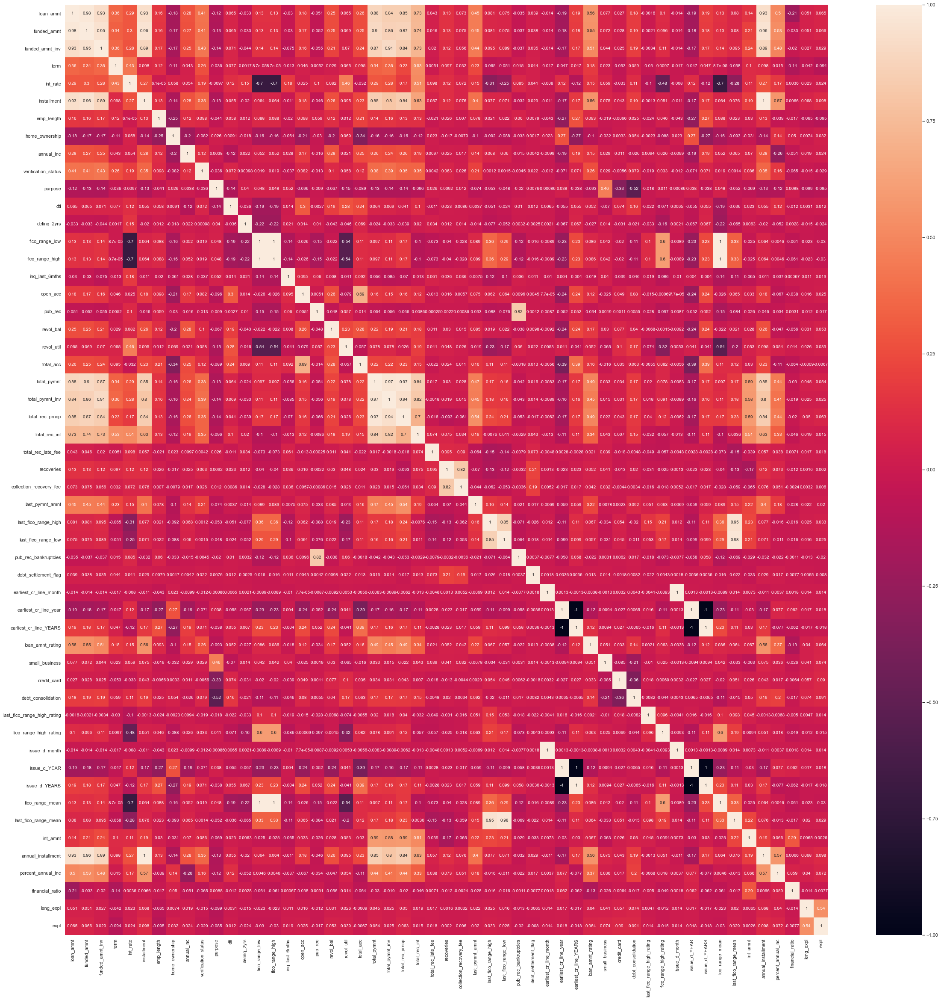

In [60]:
plt.figure(figsize = (40,40))       
sns.heatmap(X_scaled_df_FE.corr(),annot = True)

In [61]:
from sklearn.decomposition import PCA
pca = PCA(random_state=42)
pca.fit(X_scaled)

pca.components_[0]

pca.explained_variance_ratio_

var_cumu = np.cumsum(pca.explained_variance_ratio_)
var_cumu

array([0.19021191, 0.29932549, 0.37480687, 0.42386496, 0.46214664,
       0.49892991, 0.53394684, 0.56756428, 0.59905531, 0.63016784,
       0.65587004, 0.68086921, 0.70558435, 0.72825267, 0.74966607,
       0.76871411, 0.7872396 , 0.80508199, 0.82214439, 0.83897752,
       0.85418302, 0.86880417, 0.88251873, 0.89584192, 0.90861778,
       0.92040534, 0.93193239, 0.94276736, 0.95277202, 0.96138194,
       0.96940614, 0.97518312, 0.97992073, 0.98323515, 0.98649514,
       0.98961083, 0.99260782, 0.99522297, 0.99740918, 0.99940026,
       0.99981675, 0.99995712, 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        ])

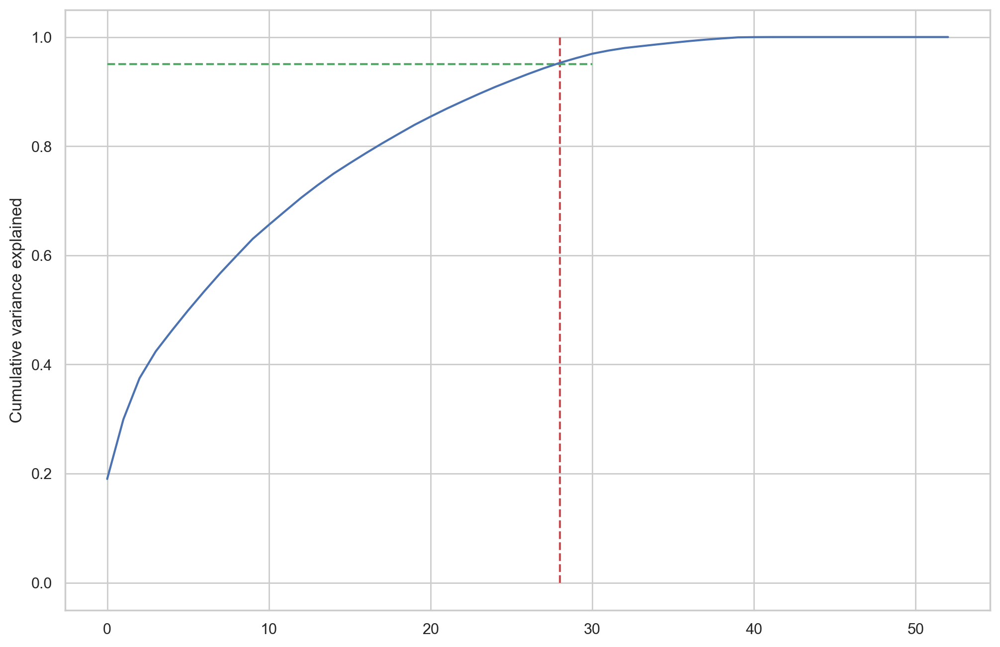

In [62]:
fig = plt.figure(figsize=[12,8],dpi=200)
plt.vlines(x=28, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.95, xmax=30, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

In [63]:
from sklearn.decomposition import IncrementalPCA
pca_final = IncrementalPCA(n_components=28)
X_pca_final = pca_final.fit_transform(X_scaled)

In [64]:
print(X.shape)
print(X_pca_final.shape)

(42535, 53)
(42535, 28)


In [65]:
corrmat = np.corrcoef(X_pca_final.transpose())

corrmat.shape

(28, 28)

<AxesSubplot:>

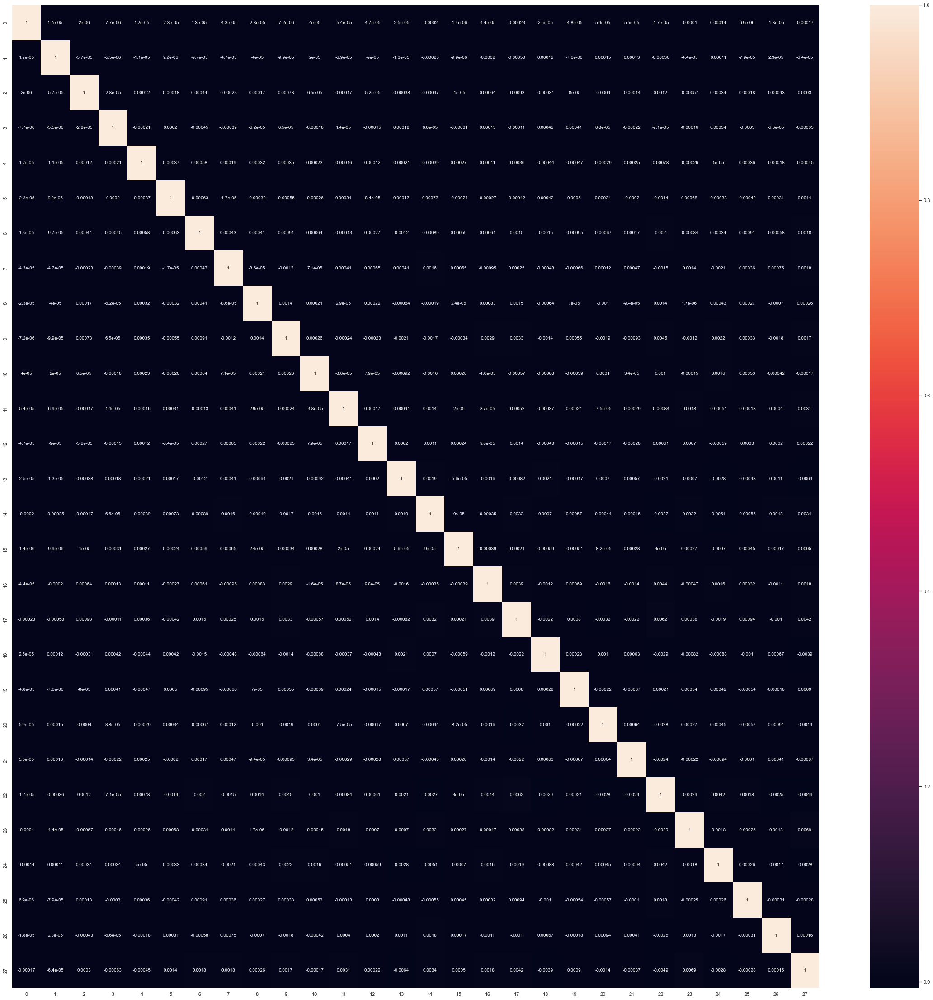

In [66]:
plt.figure(figsize=[40,40])
sns.heatmap(corrmat, annot=True)

In [67]:
colnames = list(X.columns)
pca_df_FE = pd.DataFrame({'PC1':pca.components_[0],'PC2':pca.components_[1], 'Feature':colnames})
pca_df_FE[:59]

,PC1,PC2,Feature
0,0.295447,-0.056332,loan_amnt
1,0.298903,-0.062015,funded_amnt
2,0.291769,-0.054536,funded_amnt_inv
3,0.107466,-0.072259,term
4,0.075017,-0.323057,int_rate
5,0.284140,-0.071835,installment
6,0.070907,0.060436,emp_length
7,-0.079115,-0.099669,home_ownership
8,0.099852,0.035541,annual_inc
9,0.136490,-0.048676,verification_status


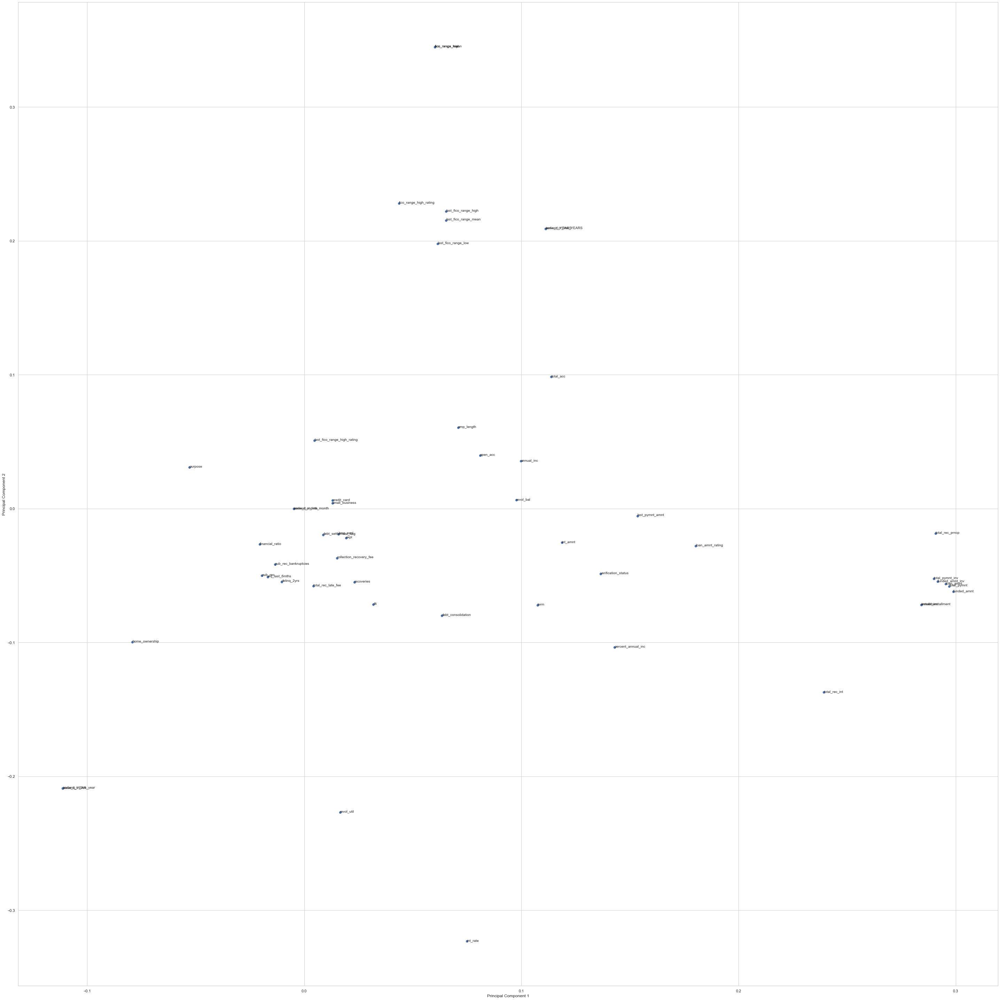

In [68]:
fig = plt.figure(figsize = (40,40))
plt.scatter(pca_df_FE.PC1, pca_df_FE.PC2)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
for i, txt in enumerate(pca_df_FE.Feature):
    plt.annotate(txt, (pca_df_FE.PC1[i],pca_df_FE.PC2[i]))
plt.tight_layout()
plt.show()

#### Mediana

In [69]:
X2 = df_FE3.iloc[:, :-1]

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X2_scaled = scaler.fit_transform(X2)

X2_scaled_df_FE3 = pd.DataFrame(X2_scaled,columns=X2.columns)

<AxesSubplot:>

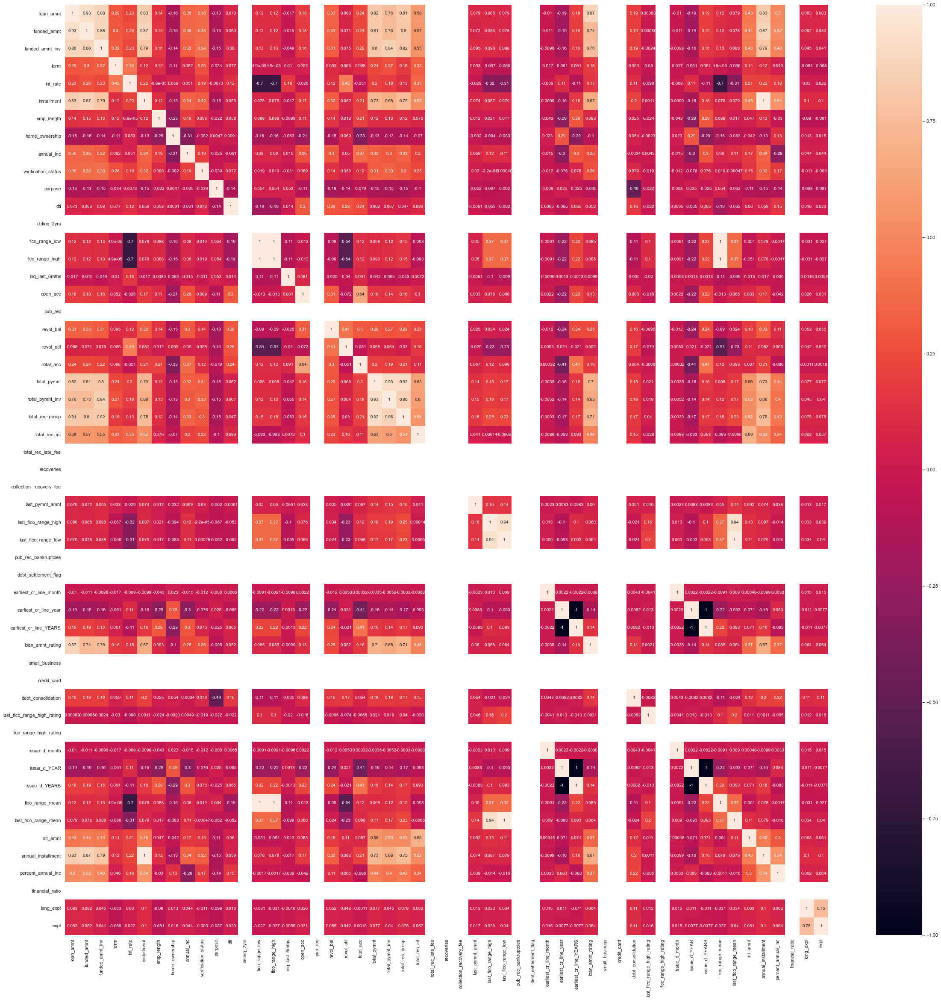

In [70]:
plt.figure(figsize = (40,40))       
sns.heatmap(X2_scaled_df_FE3.corr(),annot = True)

In [71]:
from sklearn.decomposition import PCA
pca = PCA(random_state=42)
pca.fit(X2_scaled)

pca.components_[0]

pca.explained_variance_ratio_

var_cumu = np.cumsum(pca.explained_variance_ratio_)
var_cumu

array([0.23052128, 0.36199606, 0.45643751, 0.51144488, 0.55918896,
       0.60240992, 0.64065735, 0.67704691, 0.70535719, 0.73207889,
       0.75738527, 0.78107835, 0.80358462, 0.82578868, 0.84683972,
       0.86626595, 0.88371056, 0.9000959 , 0.91463172, 0.92703569,
       0.93878189, 0.94890892, 0.95797804, 0.96496367, 0.97156073,
       0.97742385, 0.98322943, 0.98743258, 0.99136036, 0.99441739,
       0.99664265, 0.99842706, 0.9993099 , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        ])

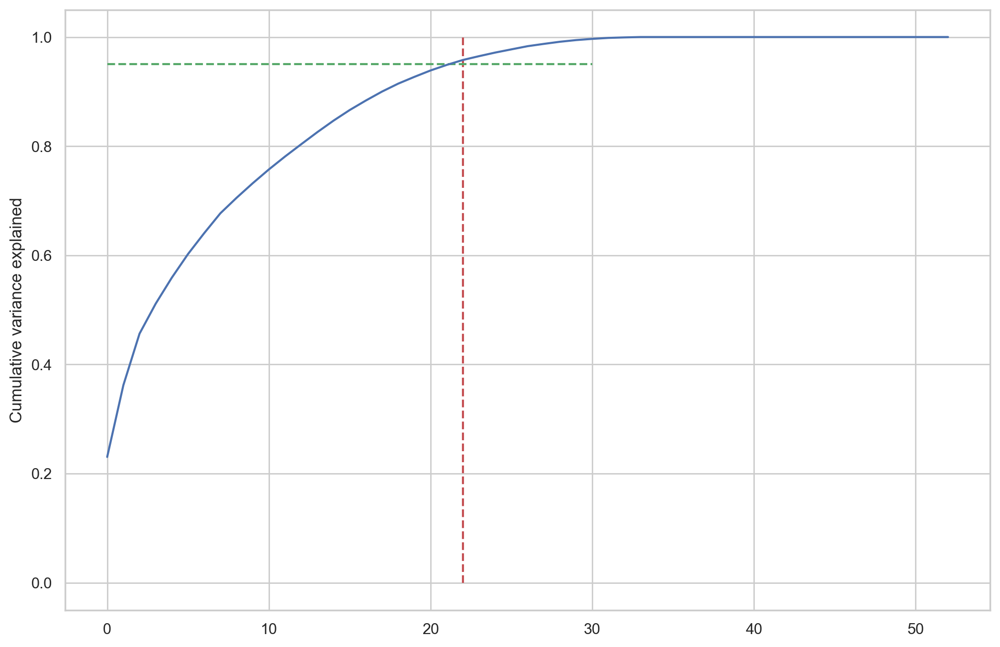

In [72]:
fig = plt.figure(figsize=[12,8],dpi=200)
plt.vlines(x=22, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.95, xmax=30, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

In [73]:
from sklearn.decomposition import IncrementalPCA
pca_final = IncrementalPCA(n_components=22)
X2_pca_final = pca_final.fit_transform(X2_scaled)

print(X2.shape)
print(X2_pca_final.shape)

corrmat = np.corrcoef(X2_pca_final.transpose())

corrmat.shape

(42535, 53)
(42535, 22)


(22, 22)

<AxesSubplot:>

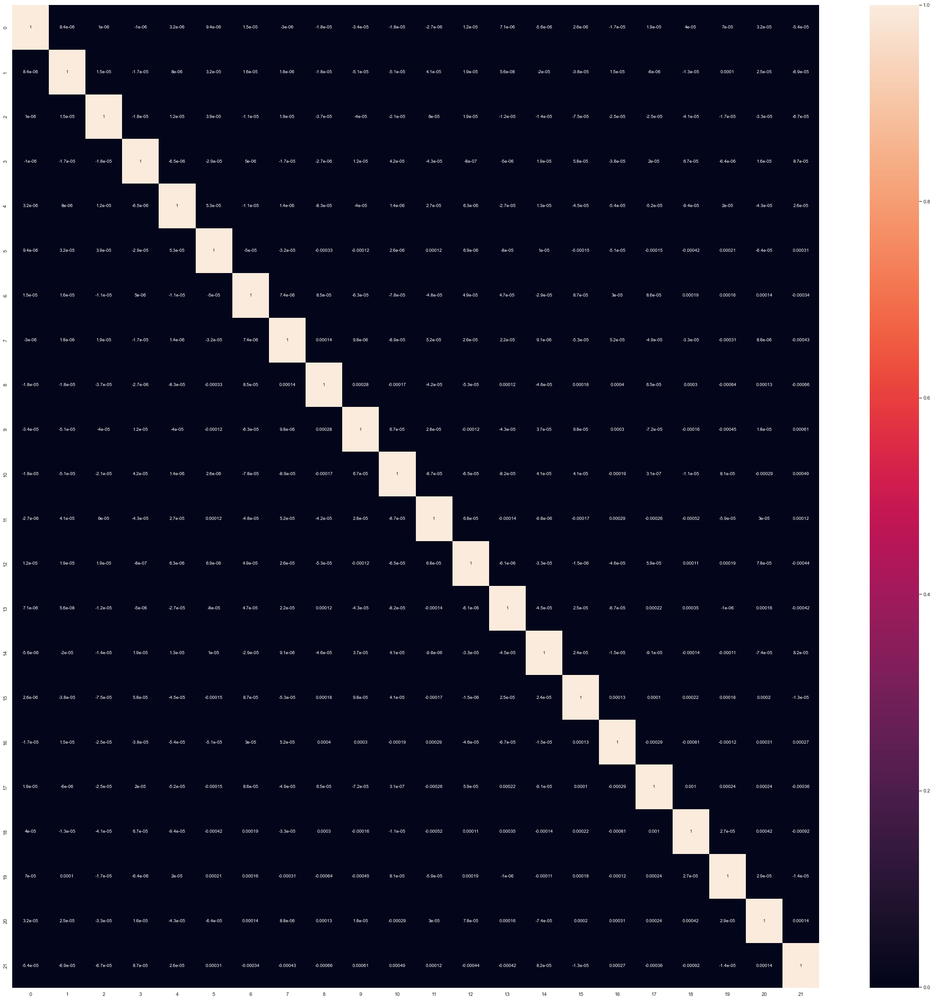

In [74]:
plt.figure(figsize=[40,40])
sns.heatmap(corrmat, annot=True)

In [75]:
colnames = list(X2.columns)
pca_df_FE3 = pd.DataFrame({'PC1':pca.components_[0],'PC2':pca.components_[1], 'Feature':colnames})
pca_df_FE3[:59]

,PC1,PC2,Feature
0,0.294551,-6.376927e-02,loan_amnt
1,0.293010,-6.618138e-02,funded_amnt
2,0.286999,-6.278449e-02,funded_amnt_inv
3,0.093503,-6.595524e-02,term
4,0.058331,-3.113908e-01,int_rate
5,0.276527,-7.234346e-02,installment
6,0.071730,7.511293e-02,emp_length
7,-0.078224,-1.171137e-01,home_ownership
8,0.139574,6.992910e-02,annual_inc
9,0.126904,-4.602159e-02,verification_status


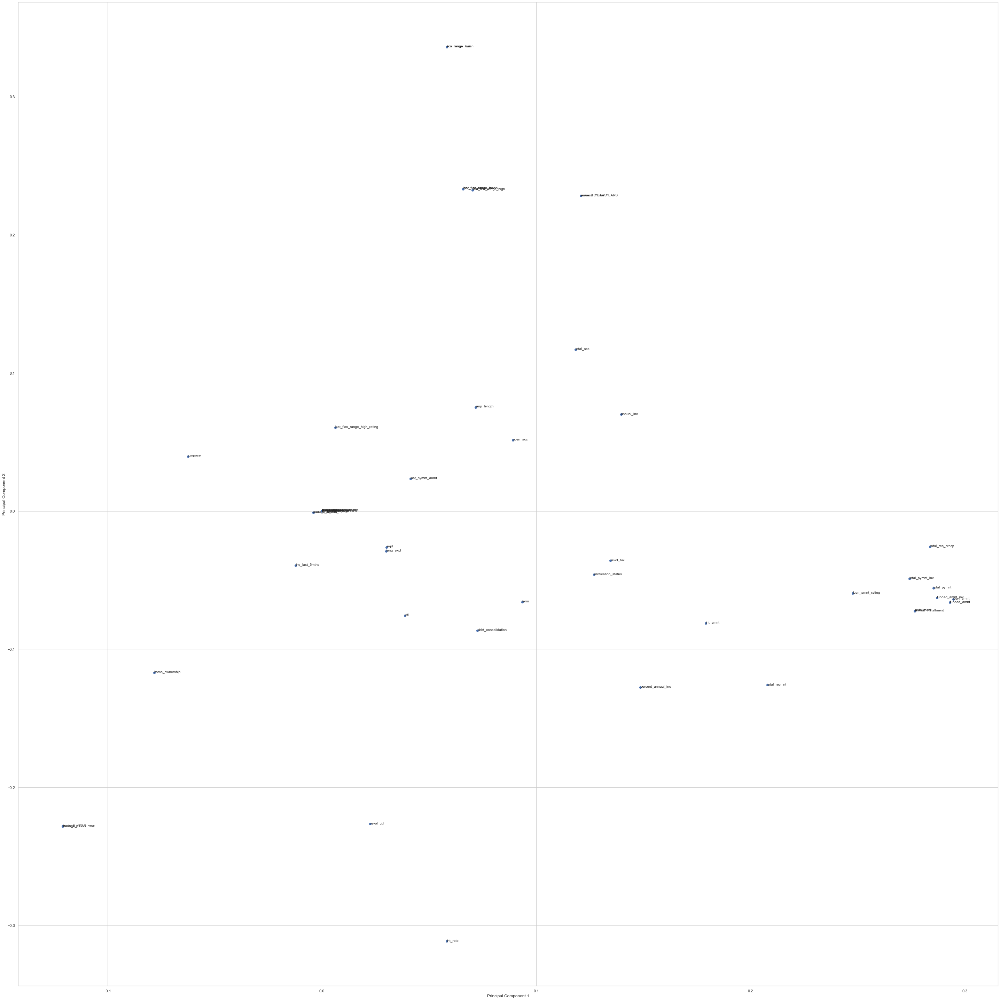

In [76]:
fig = plt.figure(figsize = (40,40))
plt.scatter(pca_df_FE3.PC1, pca_df_FE3.PC2)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
for i, txt in enumerate(pca_df_FE3.Feature):
    plt.annotate(txt, (pca_df_FE3.PC1[i],pca_df_FE3.PC2[i]))
plt.tight_layout()
plt.show()

#### Całkowite usunięcie outliersow

In [77]:
X3 = df_FE4.iloc[:, :-1]

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X3_scaled = scaler.fit_transform(X3)

X3_scaled_df_FE4 = pd.DataFrame(X3_scaled,columns=X3.columns)

<AxesSubplot:>

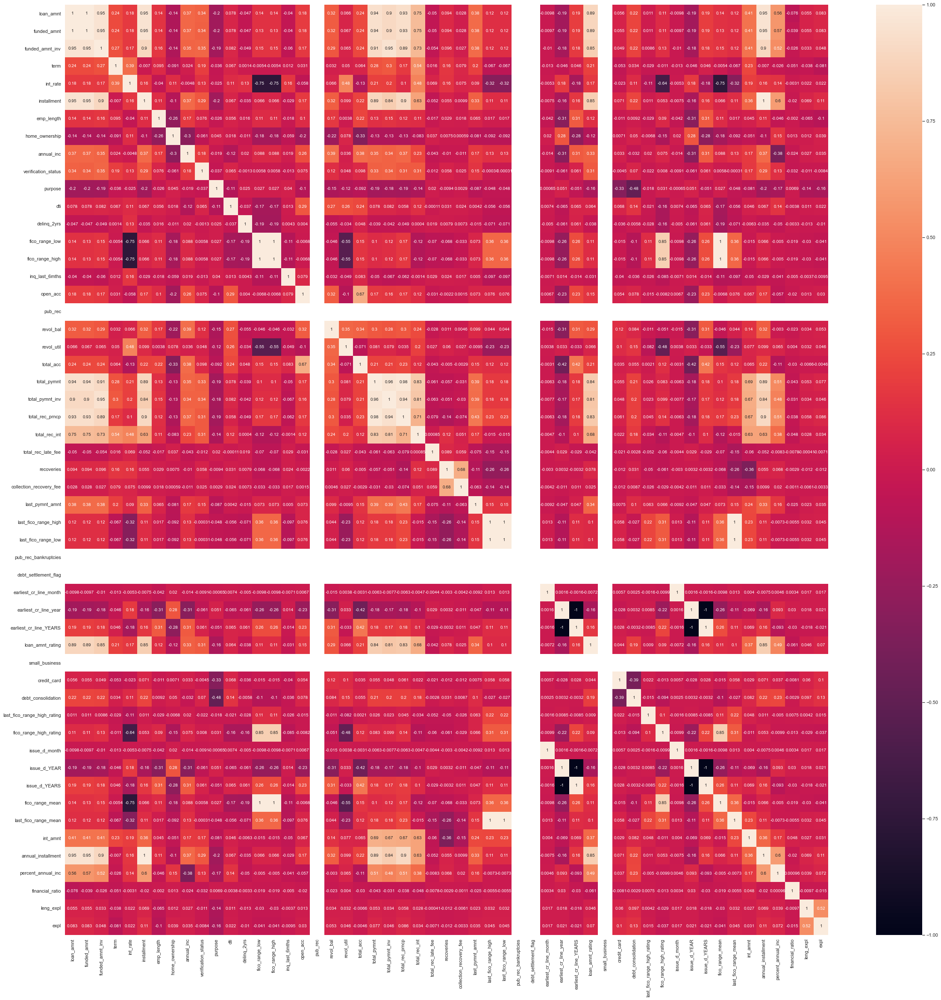

In [78]:
plt.figure(figsize = (40,40))       
sns.heatmap(X3_scaled_df_FE4.corr(),annot = True)

In [79]:
from sklearn.decomposition import PCA
pca = PCA(random_state=42)
pca.fit(X3_scaled)

pca.components_[0]

pca.explained_variance_ratio_

var_cumu = np.cumsum(pca.explained_variance_ratio_)
var_cumu

array([0.22224455, 0.35114242, 0.43464448, 0.48879444, 0.52996112,
       0.56862225, 0.60288583, 0.63451311, 0.66404805, 0.69264211,
       0.71972732, 0.74350272, 0.7650421 , 0.78576792, 0.80585659,
       0.82563574, 0.8446216 , 0.86270888, 0.88027921, 0.89701173,
       0.91180217, 0.92576174, 0.9390145 , 0.94889809, 0.95853918,
       0.96667142, 0.97196521, 0.97697563, 0.98189129, 0.98596163,
       0.98960429, 0.99280426, 0.99551101, 0.99759592, 0.99958287,
       0.99995183, 0.99999578, 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        ])

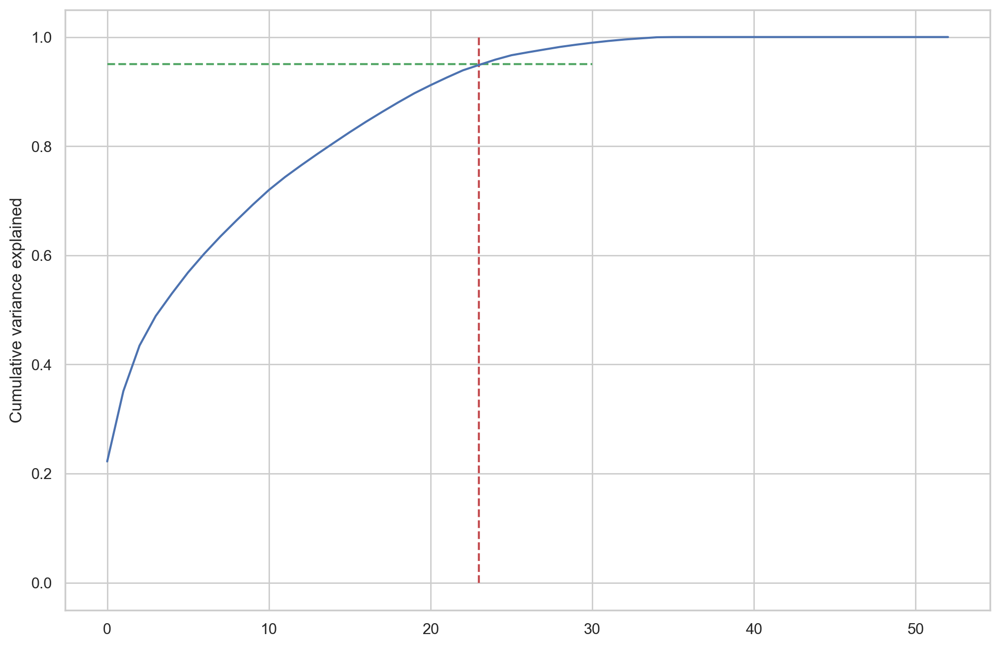

In [80]:
fig = plt.figure(figsize=[12,8],dpi=200)
plt.vlines(x=23, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.95, xmax=30, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

In [81]:
from sklearn.decomposition import IncrementalPCA
pca_final = IncrementalPCA(n_components=21)
X3_pca_final = pca_final.fit_transform(X3_scaled)

print(X3.shape)
print(X3_pca_final.shape)

corrmat = np.corrcoef(X3_pca_final.transpose())

corrmat.shape

(29187, 53)
(29187, 21)


(21, 21)

<AxesSubplot:>

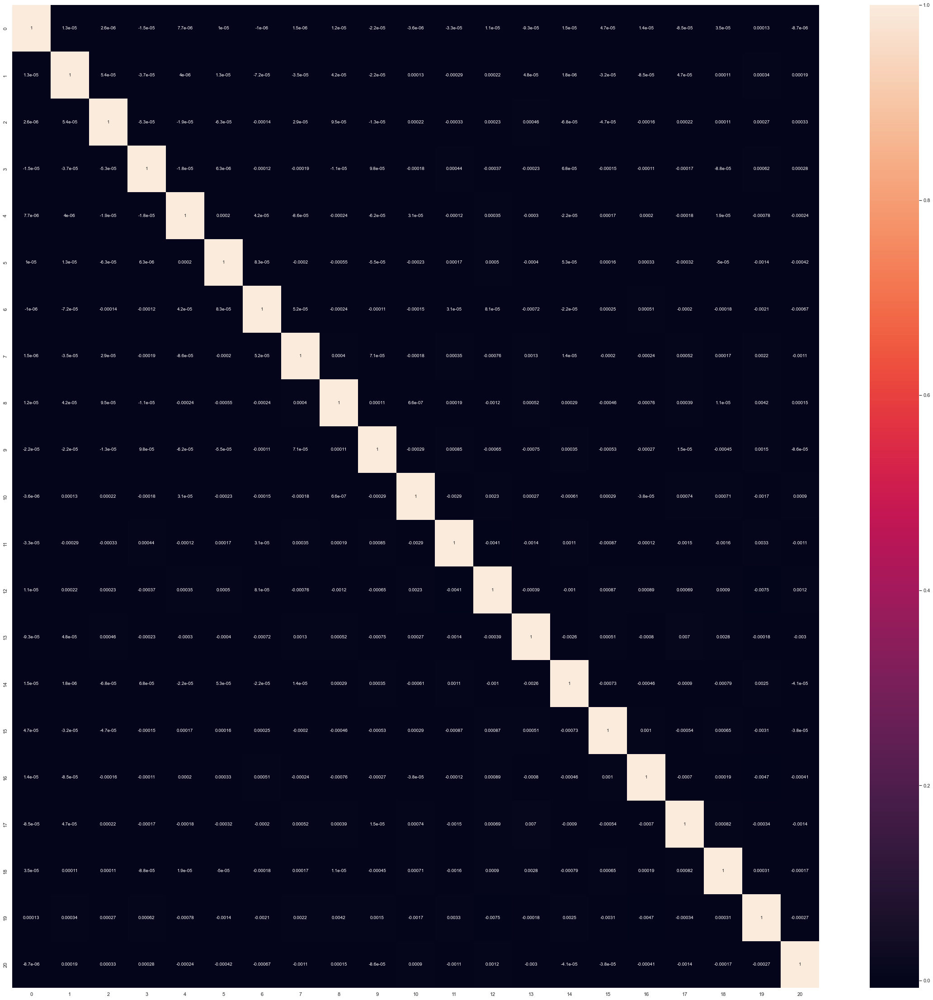

In [82]:
plt.figure(figsize=[40,40])
sns.heatmap(corrmat, annot=True)

In [83]:
colnames = list(X3.columns)
pca_df_FE4 = pd.DataFrame({'PC1':pca.components_[0],'PC2':pca.components_[1], 'Feature':colnames})
pca_df_FE4[:59]

,PC1,PC2,Feature
0,2.898483e-01,-0.064386,loan_amnt
1,2.899399e-01,-0.064706,funded_amnt
2,2.827354e-01,-0.058133,funded_amnt_inv
3,7.402388e-02,-0.065680,term
4,3.019906e-02,-0.319483,int_rate
5,2.744680e-01,-0.075412,installment
6,6.484407e-02,0.067604,emp_length
7,-6.684091e-02,-0.105646,home_ownership
8,1.310500e-01,0.060995,annual_inc
9,1.083452e-01,-0.045624,verification_status


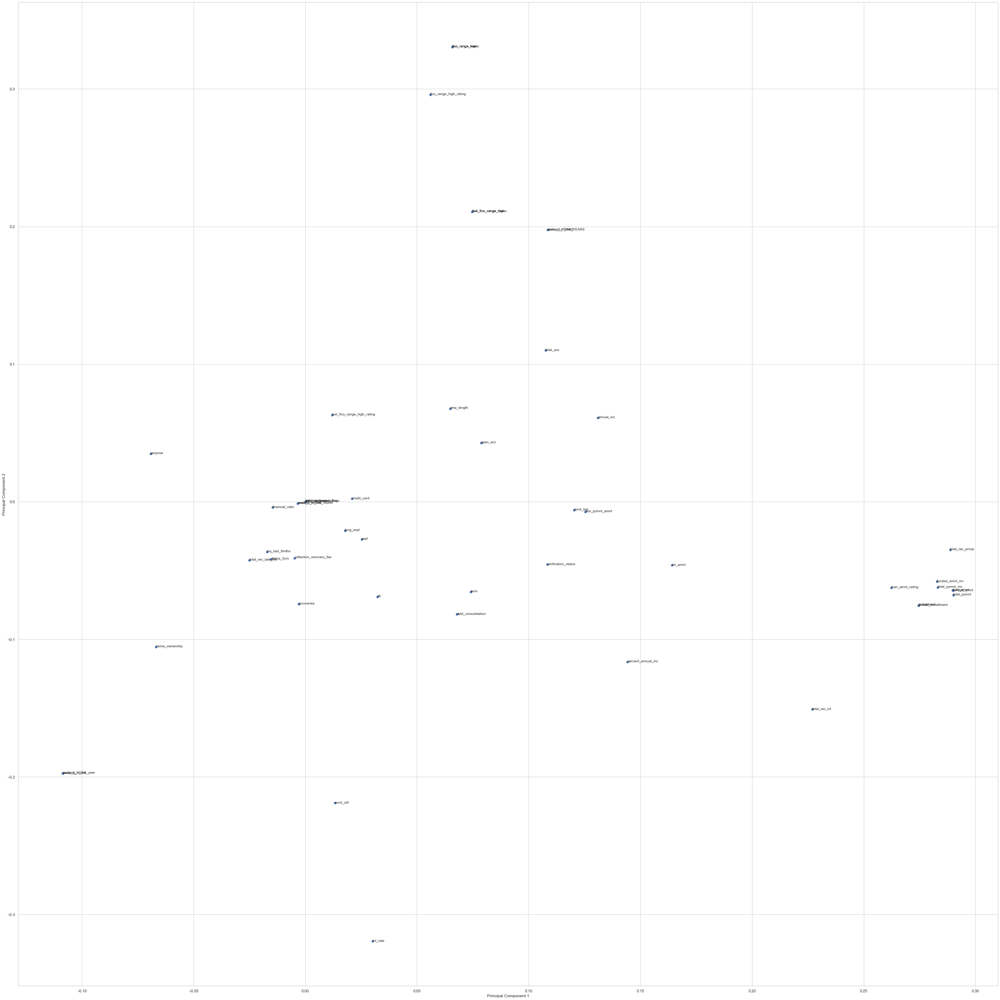

In [84]:
fig = plt.figure(figsize = (40,40))
plt.scatter(pca_df_FE4.PC1, pca_df_FE4.PC2)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
for i, txt in enumerate(pca_df_FE4.Feature):
    plt.annotate(txt, (pca_df_FE4.PC1[i],pca_df_FE4.PC2[i]))
plt.tight_layout()
plt.show()

#### Dummies

In [85]:
X4 = df_dummies

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X4_scaled = scaler.fit_transform(X4)

X4_scaled_df_dummies = pd.DataFrame(X4_scaled,columns=X4.columns)

<AxesSubplot:>

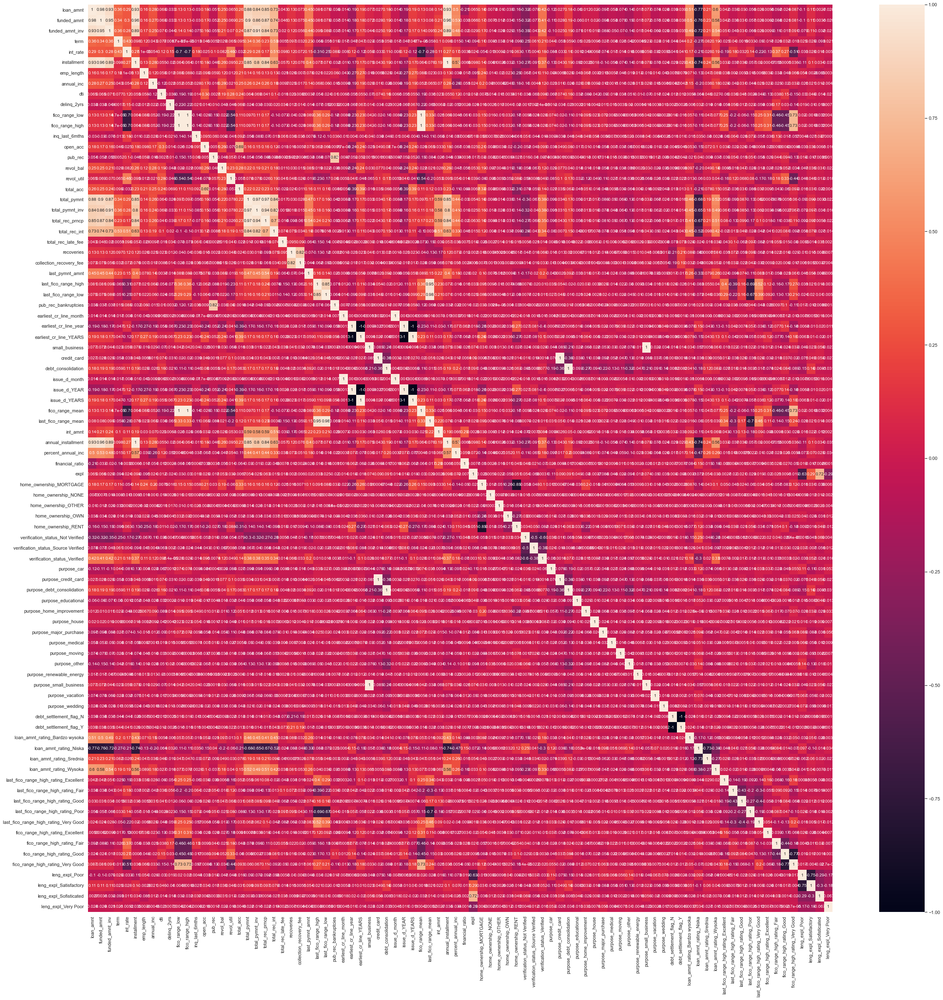

In [86]:
plt.figure(figsize = (40,40))       
sns.heatmap(X4_scaled_df_dummies.corr(),annot = True)

In [87]:
from sklearn.decomposition import PCA
pca = PCA(random_state=42)
pca.fit(X4_scaled)

pca.components_[0]

pca.explained_variance_ratio_

var_cumu = np.cumsum(pca.explained_variance_ratio_)
var_cumu

array([0.13145354, 0.2115811 , 0.26132032, 0.29922935, 0.33178931,
       0.36234521, 0.38914643, 0.41453022, 0.43809632, 0.4605851 ,
       0.48179201, 0.50216566, 0.52172589, 0.54026818, 0.55830225,
       0.57552929, 0.59236859, 0.60859538, 0.62431319, 0.6390129 ,
       0.65351558, 0.66776547, 0.68169531, 0.69535313, 0.70866904,
       0.7218326 , 0.73450542, 0.74675789, 0.7589788 , 0.77097988,
       0.78285566, 0.79467535, 0.80645564, 0.81822956, 0.82995681,
       0.84157862, 0.85313319, 0.86462784, 0.87604232, 0.88717063,
       0.89808403, 0.90892502, 0.91948254, 0.92975857, 0.93919637,
       0.94815673, 0.95643178, 0.96428767, 0.97081695, 0.97593535,
       0.97961275, 0.98276402, 0.98560651, 0.98841454, 0.99043948,
       0.99235355, 0.99402446, 0.99563961, 0.9968747 , 0.99802513,
       0.99914753, 0.99965999, 0.9998879 , 0.99997376, 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.     

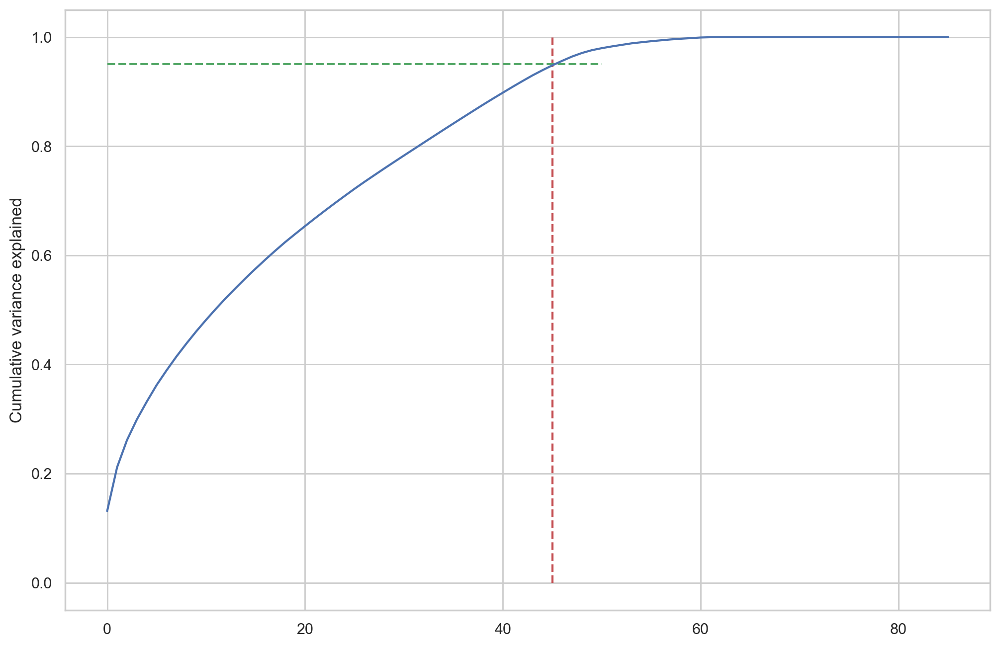

In [88]:
fig = plt.figure(figsize=[12,8],dpi=200)
plt.vlines(x=45, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.95, xmax=50, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

In [89]:
from sklearn.decomposition import IncrementalPCA
pca_final = IncrementalPCA(n_components=45)
X4_pca_final = pca_final.fit_transform(X4_scaled)

print(X4.shape)
print(X4_pca_final.shape)

corrmat = np.corrcoef(X4_pca_final.transpose())

corrmat.shape

(42535, 86)
(42535, 45)


(45, 45)

<AxesSubplot:>

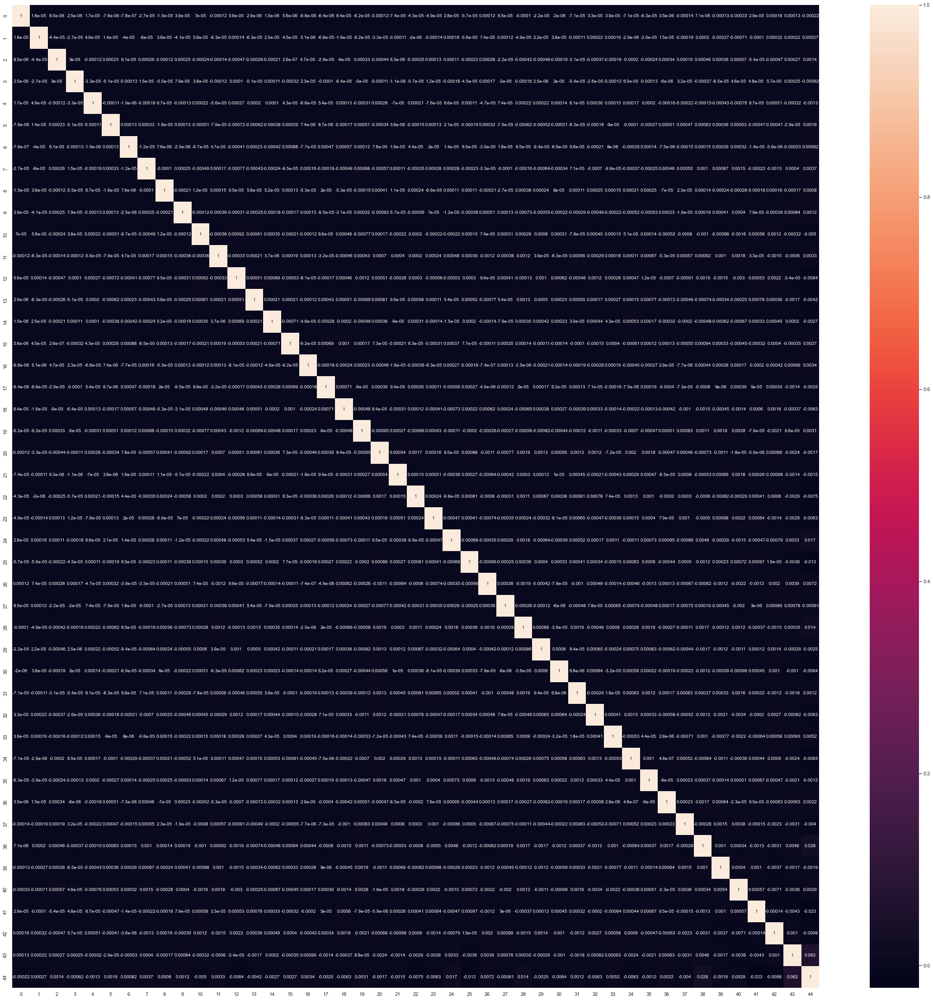

In [90]:
plt.figure(figsize=[40,40])
sns.heatmap(corrmat, annot=True)

In [91]:
colnames = list(X4.columns)
pca_df_dummies = pd.DataFrame({'PC1':pca.components_[0],'PC2':pca.components_[1], 'Feature':colnames})
pca_df_dummies[:59]

,PC1,PC2,Feature
0,0.280481,-0.053954,loan_amnt
1,0.282770,-0.057942,funded_amnt
2,0.275744,-0.050302,funded_amnt_inv
3,0.101111,-0.064239,term
4,0.066960,-0.290139,int_rate
5,0.268107,-0.067084,installment
6,0.066110,0.045444,emp_length
7,0.093543,0.026409,annual_inc
8,0.028372,-0.077958,dti
9,-0.011272,-0.051495,delinq_2yrs


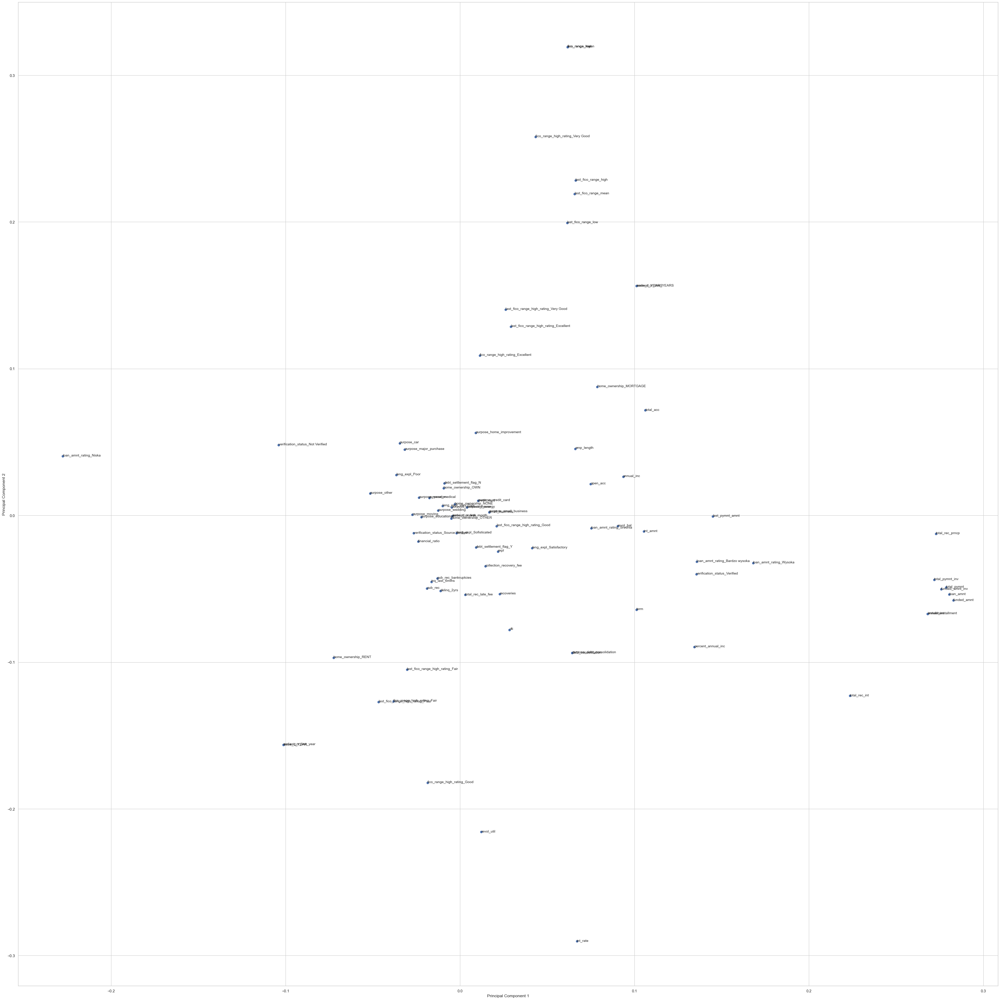

In [92]:
fig = plt.figure(figsize = (40,40))
plt.scatter(pca_df_dummies.PC1, pca_df_dummies.PC2)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
for i, txt in enumerate(pca_df_dummies.Feature):
    plt.annotate(txt, (pca_df_dummies.PC1[i],pca_df_dummies.PC2[i]))
plt.tight_layout()
plt.show()

#### Srednia

In [93]:
#średnia zamiast outliersow
#1 - standaryzacja
X4 = df_FE6.iloc[:, :-1]

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled4 = scaler.fit_transform(X4)

X_scaled_df_FE6 = pd.DataFrame(X_scaled4,columns=X4.columns)

<AxesSubplot:>

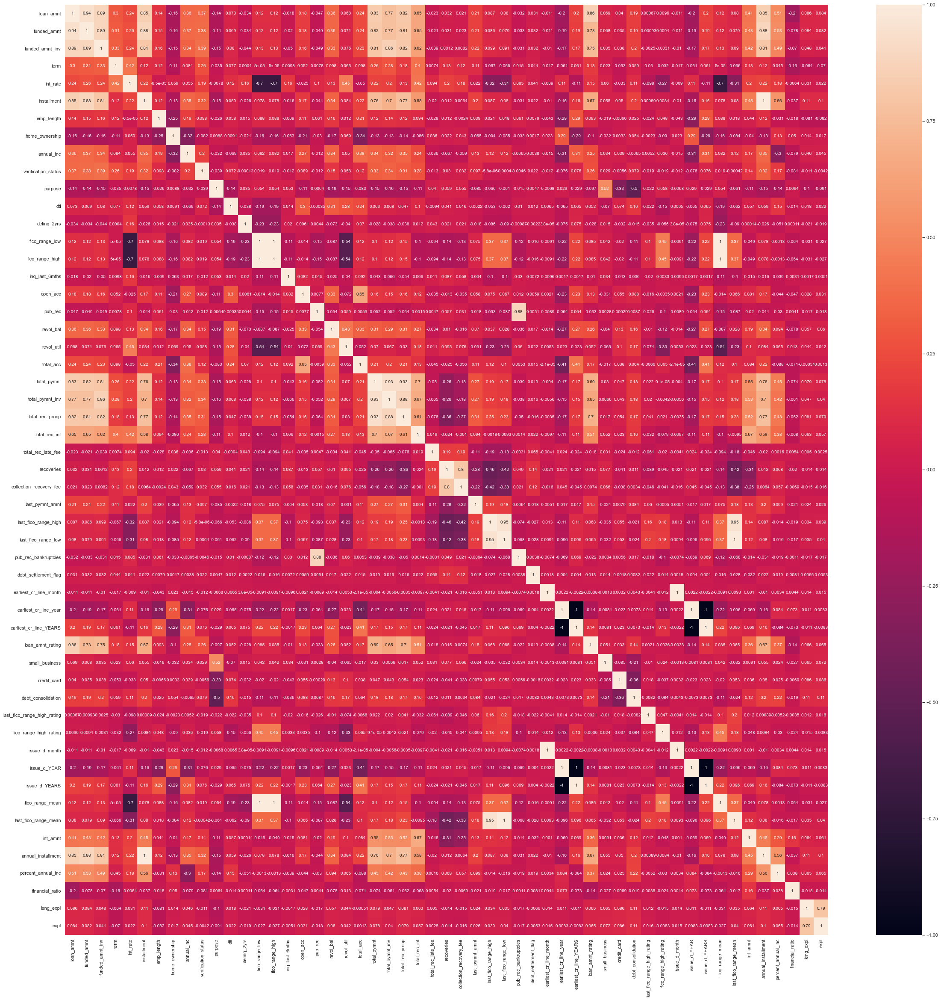

In [94]:
plt.figure(figsize = (40,40))       
sns.heatmap(X_scaled_df_FE6.corr(),annot = True)

In [95]:
from sklearn.decomposition import PCA
pca = PCA(random_state=42)
pca.fit(X_scaled4)

pca.components_[0]

pca.explained_variance_ratio_

var_cumu = np.cumsum(pca.explained_variance_ratio_)
var_cumu

array([0.18890632, 0.30116782, 0.38116519, 0.43557247, 0.47400186,
       0.51133401, 0.54584713, 0.57943815, 0.6103538 , 0.63661145,
       0.66238007, 0.686634  , 0.70924531, 0.73017754, 0.75036229,
       0.76913413, 0.78722207, 0.80509027, 0.82257452, 0.83899824,
       0.85500006, 0.86982071, 0.88371537, 0.8966936 , 0.90900126,
       0.92026183, 0.9306062 , 0.94041813, 0.94907174, 0.95631689,
       0.96321796, 0.96831564, 0.97258049, 0.97655604, 0.98038148,
       0.98374145, 0.98683672, 0.98974981, 0.99203734, 0.99430911,
       0.99647792, 0.99785019, 0.99901689, 0.99956233, 0.99999998,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        ])

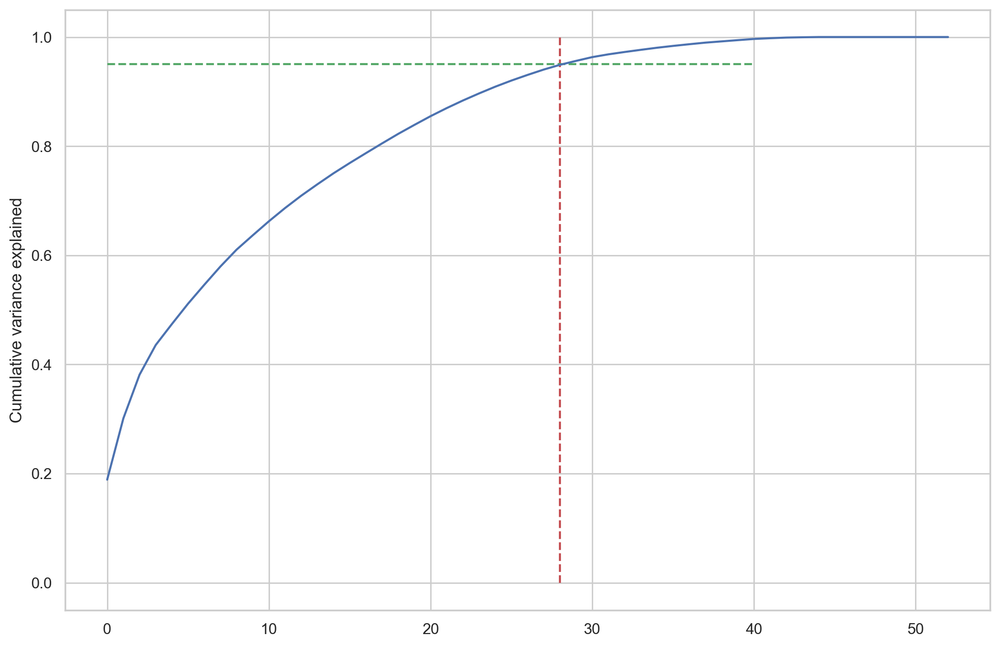

In [96]:
fig = plt.figure(figsize=[12,8],dpi=200)
plt.vlines(x=28, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.95, xmax=40, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

In [97]:
from sklearn.decomposition import IncrementalPCA
pca_final = IncrementalPCA(n_components=21)
X_pca_final4 = pca_final.fit_transform(X_scaled4)

print(X4.shape)
print(X_pca_final4.shape)

corrmat = np.corrcoef(X_pca_final4.transpose())

corrmat.shape

(42535, 53)
(42535, 21)


(21, 21)

<AxesSubplot:>

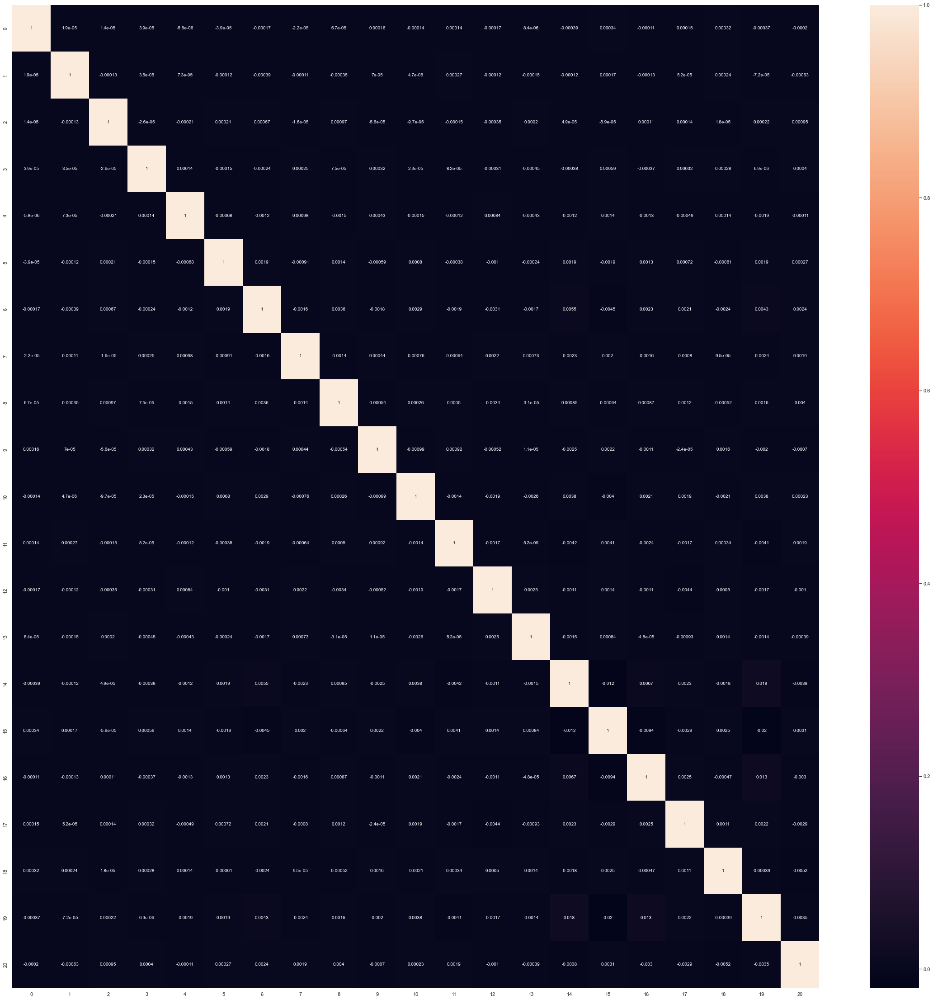

In [98]:
plt.figure(figsize=[40,40])
sns.heatmap(corrmat, annot=True)

In [99]:
colnames = list(X4.columns)
pca_df_FE6 = pd.DataFrame({'PC1':pca.components_[0],'PC2':pca.components_[1], 'Feature':colnames})
pca_df_FE6[:59]

,PC1,PC2,Feature
0,0.288937,-0.070977,loan_amnt
1,0.287486,-0.073999,funded_amnt
2,0.281678,-0.067699,funded_amnt_inv
3,0.092351,-0.077141,term
4,0.053967,-0.310569,int_rate
5,0.272478,-0.077036,installment
6,0.070635,0.050885,emp_length
7,-0.078630,-0.092734,home_ownership
8,0.143251,0.050322,annual_inc
9,0.125277,-0.052433,verification_status


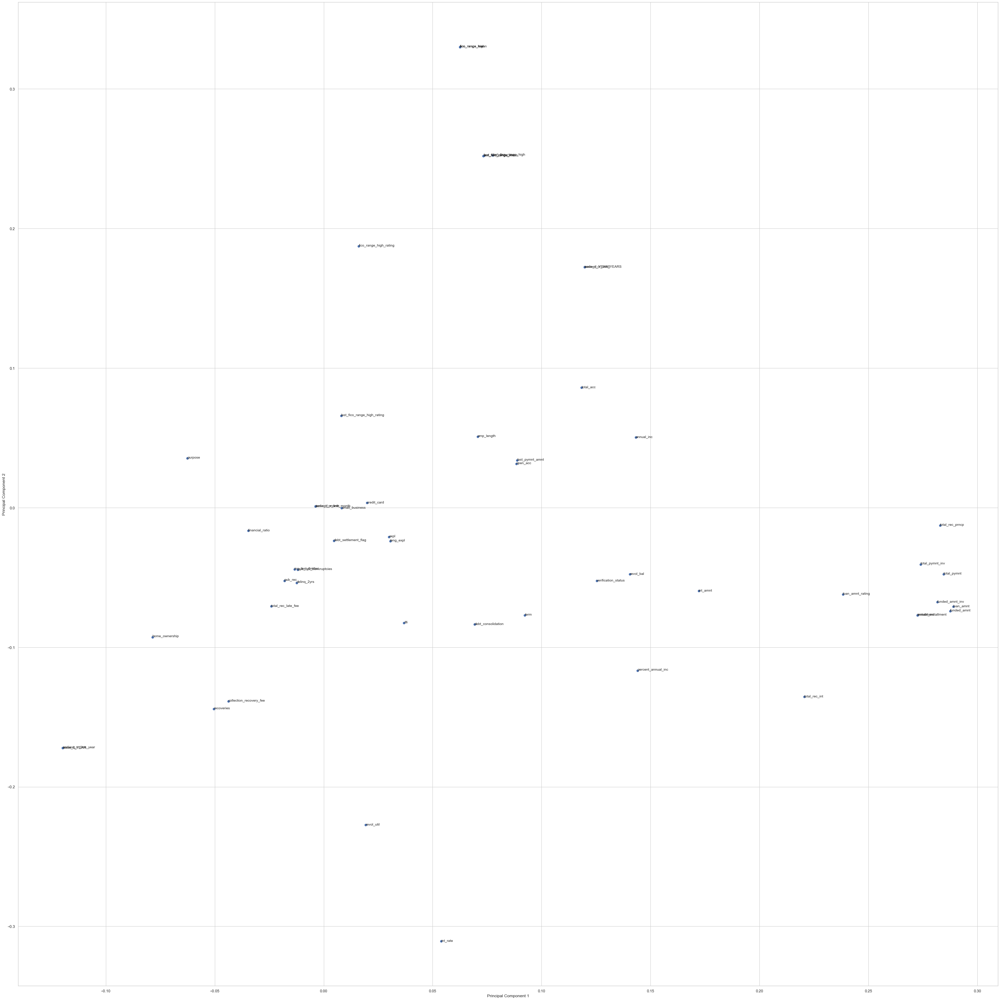

In [100]:
fig = plt.figure(figsize = (40,40))
plt.scatter(pca_df_FE6.PC1, pca_df_FE6.PC2)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
for i, txt in enumerate(pca_df_FE6.Feature):
    plt.annotate(txt, (pca_df_FE6.PC1[i],pca_df_FE6.PC2[i]))
plt.tight_layout()
plt.show()

* Ilość komponentów dla wartosci bez usuwania outliersow: 28,
* Ilość komponentów dla wartosci z medianą zamiast outliersow: 22, pojawiły się nulle
* Ilość komponentów dla wartości bez outliersow: 23, pojawiły się nulle
* Ilość komponentów dla wartości Dummies: 23,
* Ilość komponentów dla wartości z srednia zamiast outliersow: 21.

## Regresja logistyczna -kompresja

##### Bez usuwania wartości odstających

In [380]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X = df_FE2.iloc[:,:-1]
y = df_FE2.iloc[:,-1]

#Split train-test data
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train, y_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X_test)

pca = IncrementalPCA(n_components=28)
pca.fit(X_scaled_df_FE)

X = pd.DataFrame(pca.transform(X_scaled_df_FE))
y = df_FE['loan_status']

X_train_SMOTE, X_test, y_train_SMOTE, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [381]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(solver = 'lbfgs')

In [382]:
logisticRegr.fit(X_train_SMOTE, y_train_SMOTE)

C:\Users\patry\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [384]:
score = logisticRegr.score(X_test, y_test)
print(score)

0.9876968889585456


In [385]:
predictions = logisticRegr.predict(X_test)

In [386]:
predictions

array([1, 1, 1, ..., 1, 0, 1], dtype=int64)

In [387]:
import numpy as np 
import matplotlib.pyplot as plt
index = 0
misclassifiedIndexes = []
for label, predict in zip(y_test, predictions):
    if label != predict:
        misclassifiedIndexes.append(index)
        index +=1

In [388]:
misclass = y_test!=predictions

In [389]:
misclass

19496    False
11187    False
17617    False
322      False
21334    False
         ...  
40373    False
34982    False
24719    False
16975    False
32877    False
Name: loan_status, Length: 12761, dtype: bool

In [390]:
misclass = pd.Series(misclass)
misclass= misclass[misclass==True]
misclass.index

Int64Index([38836, 18973, 13985, 21412, 12733,  2000, 23773, 23774, 23002,
            10453,
            ...
            23493,  3610, 14756,  4540,  2973,  4498,  6128, 34776, 33430,
            20296],
           dtype='int64', length=157)

In [391]:
predictions = pd.Series(predictions) 

In [392]:
predictions.index = y_test.index

In [393]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
cm = metrics.confusion_matrix(y_test, predictions)
print(cm)

[[ 1740   131]
 [   26 10864]]


In [394]:
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

Precision: 0.9852774631936579
Recall: 0.9299839657936932
Specificity: 0.9976124885215795


In [395]:
predictions = logisticRegr.predict(X_test)
expected=y_test
accuracy = metrics.accuracy_score(predictions, y_test)
print("Accuracy : %s" % "{0:.3%}".format(accuracy))

Accuracy : 98.770%


In [396]:
from sklearn.metrics import classification_report,confusion_matrix

def evaluate(predictions,y_test): 
    result = classification_report(y_test,predictions,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [397]:
result = classification_report(y_test,predictions,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [398]:
roc_auc=metrics.roc_auc_score(predictions,y_test)

In [399]:
results = pd.DataFrame({'DataFrame':['Bez modyfikacji'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUC_ROC':[roc_auc]},index={'1'})
results = results[['DataFrame', 'accuracy', 'f1-score', 'AUC_ROC']]

results

,DataFrame,accuracy,f1-score,AUC_ROC
1,Bez modyfikacji,0.987697,0.992826,0.986681


Wytrenowany model ma wysoką trafność, czułość oraz specyficzność (prawdopodobieństwo niespłacenia pożyczki w przypadku klientów z wyższą zdolnością kredytową). Model posiada także bardzo wysoki wskaźnik AUROC i wysoką dokładność.

##### Mediana

In [405]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X2 = df_FE3.iloc[:,:-1]
y2 = df_FE3.iloc[:,-1]

#Split train-test data
X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X2_train, y2_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X2_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X2_scaled_df_FE3)

X2 = pd.DataFrame(pca.transform(X2_scaled_df_FE3))
y2 = df_FE3['loan_status']


X_train_SMOTE, X2_test, y_train_SMOTE, y2_test = train_test_split(X2, y2, test_size=0.3, random_state=42)

In [406]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(solver = 'lbfgs', random_state=1)

In [407]:
logisticRegr.fit(X_train_SMOTE, y_train_SMOTE)

LogisticRegression(random_state=1)

In [408]:
score = logisticRegr.score(X2_test, y2_test)
print(score)

0.9402868113784186


In [409]:
predictions2 = logisticRegr.predict(X2_test)

In [410]:
predictions2

array([1, 1, 1, ..., 1, 0, 1], dtype=int64)

In [411]:
import numpy as np 
import matplotlib.pyplot as plt
index = 0
misclassifiedIndexes = []
for label, predict in zip(y2_test, predictions2):
    if label != predict:
        misclassifiedIndexes.append(index)
        index +=1

In [412]:
misclass = y2_test!=predictions2

In [413]:
misclass

19496    False
11187    False
17617    False
322      False
21334    False
         ...  
40373    False
34982    False
24719    False
16975    False
32877    False
Name: loan_status, Length: 12761, dtype: bool

In [414]:
misclass = pd.Series(misclass)
misclass= misclass[misclass==True]
misclass.index

Int64Index([40056, 32911, 38836, 27995, 34612, 24126, 15159, 13168,  2830,
            36705,
            ...
             7204,  3639, 37589, 37980, 36681, 33430, 38605, 41432, 33886,
            20296],
           dtype='int64', length=762)

In [415]:
predictions2 = pd.Series(predictions2) 

In [416]:
predictions2.index = y2_test.index

In [417]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
cm = metrics.confusion_matrix(y2_test, predictions2)
print(cm)

[[ 1388   483]
 [  279 10611]]


In [418]:
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

Precision: 0.8326334733053389
Recall: 0.7418492784607162
Specificity: 0.9743801652892562


In [419]:
predictions2 = logisticRegr.predict(X2_test)
accuracy = metrics.accuracy_score(predictions2, y2_test)
print("Accuracy : %s" % "{0:.3%}".format(accuracy))

Accuracy : 94.029%


In [420]:
def evaluate(predictions2,y2_test): 
    result = classification_report(y2_test,predictions2,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [421]:
result = classification_report(y2_test,predictions2,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [422]:
predictions2

array([1, 1, 1, ..., 1, 0, 1], dtype=int64)

In [423]:
roc_auc2=metrics.roc_auc_score(predictions2,y2_test)
roc_auc2

0.8945482131264391

In [424]:
tempResultsDflogit = pd.DataFrame({'DataFrame':['Mediana'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUC_ROC':[roc_auc2]},index={'2'})
results = pd.concat([results, tempResultsDflogit])
results = results[['DataFrame', 'accuracy', 'f1-score','AUC_ROC']]
results

,DataFrame,accuracy,f1-score,AUC_ROC
1,Bez modyfikacji,0.987697,0.992826,0.986681
2,Mediana,0.940287,0.965338,0.894548


Wytrenowany model ma wysoką trafność i czułość oraz niższą specyficzność (prawdopodobieństwo niespłacenia pożyczki w przypadku klientów z wyższą zdolnością kredytową). Model posiada także bardzo wysoki wskaźnik AUROC i wysoką dokładność. Jednak otrzymane wartosci sa nizsze niz dla modelu wyuczonego na surowych danych.

##### Usunięcie outliersów

In [425]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X3 = df_FE4.iloc[:,:-1]
y3 = df_FE4.iloc[:,-1]

#Split train-test data
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X3_train, y3_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X3_test)

pca = IncrementalPCA(n_components=23)
pca.fit(X3_scaled_df_FE4)

X3 = pd.DataFrame(pca.transform(X3_scaled_df_FE4))
y3 = df_FE4['loan_status']


X_train_SMOTE, X3_test, y_train_SMOTE, y3_test = train_test_split(X3, y3, test_size=0.3, random_state=42)

In [426]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(solver = 'lbfgs', random_state=1)

In [427]:
logisticRegr.fit(X_train_SMOTE, y_train_SMOTE)

LogisticRegression(random_state=1)

In [428]:
score = logisticRegr.score(X3_test, y3_test)
print(score)

0.9956606143656503


In [429]:
predictions3 = logisticRegr.predict(X3_test)

In [430]:
predictions3

array([1, 1, 1, ..., 0, 1, 1], dtype=int64)

In [431]:
import numpy as np 
import matplotlib.pyplot as plt
index = 0
misclassifiedIndexes = []
for label, predict in zip(y_test, predictions3):
    if label != predict:
        misclassifiedIndexes.append(index)
        index +=1

In [432]:
misclass = y3_test!=predictions3

In [433]:
misclass

10985    False
32610    False
9039     False
16640    False
38795    False
         ...  
5768     False
11329    False
31486    False
22945    False
23860    False
Name: loan_status, Length: 8757, dtype: bool

In [434]:
misclass = pd.Series(misclass)
misclass= misclass[misclass==True]
misclass.index

Int64Index([24038, 20978, 22345,  5749, 27121, 24777, 29116, 21672, 42232,
            35453, 34797,  2973, 20400, 30172, 34402, 14173, 29972,   361,
             2385, 12800, 11117, 21029, 42459,   563, 37924, 10868, 42117,
            33593, 41609, 29008, 22340, 30362,  8240, 13696, 14543, 39737,
            22167, 24188],
           dtype='int64')

In [435]:
predictions3 = pd.Series(predictions3) 

In [436]:
predictions3.index = y3_test.index

In [437]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
cm = metrics.confusion_matrix(y3_test, predictions3)
print(cm)

[[ 894   37]
 [   1 7825]]


In [438]:
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

Precision: 0.9988826815642458
Recall: 0.9602577873254565
Specificity: 0.9998722208024534


In [439]:
predictions3 = logisticRegr.predict(X3_test)
accuracy = metrics.accuracy_score(predictions3, y3_test)
print("Accuracy : %s" % "{0:.3%}".format(accuracy))

Accuracy : 99.566%


In [440]:
def evaluate(predictions3,y3_test): 
    result = classification_report(y3_test,predictions3,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [441]:
result = classification_report(y3_test,predictions3,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [442]:
roc_auc3=metrics.roc_auc_score(predictions3,y3_test)
roc_auc3

0.9970882499655368

In [443]:
tempResultsDflogit = pd.DataFrame({'DataFrame':['Bez outliersów'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUC_ROC':[roc_auc3]},index={'2'})
results = pd.concat([results, tempResultsDflogit])
results = results[['DataFrame', 'accuracy', 'f1-score','AUC_ROC']]
results

,DataFrame,accuracy,f1-score,AUC_ROC
1,Bez modyfikacji,0.987697,0.992826,0.986681
2,Mediana,0.940287,0.965338,0.894548
2,Bez outliersów,0.995661,0.997578,0.997088


Wytrenowany model ma wysoką trafność i czułość oraz niską specyficzność (prawdopodobieństwo niespłacenia pożyczki w przypadku klientów z wyższą zdolnością kredytową). Model posiada także bardzo wysoki wskaźnik AUROC i wysoką dokładność. Model ten ma lepsze wyniki w porównaniu do modelu wytrenowanego na niemodyfikowanym DF.

##### Dummies

In [444]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X4 = df_dummies
y4 = target

#Split train-test data
X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X4_train, y4_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X4_test)

pca = IncrementalPCA(n_components=45)
pca.fit(X4_scaled_df_dummies)

X4 = pd.DataFrame(pca.transform(X4_scaled_df_dummies))
y4 = target


X_train_SMOTE, X4_test, y_train_SMOTE, y4_test = train_test_split(X4, y4, test_size=1/7.0, random_state=42)

In [445]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(solver = 'lbfgs')

In [446]:
logisticRegr.fit(X_train_SMOTE, y_train_SMOTE)

C:\Users\patry\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [447]:
score = logisticRegr.score(X4_test, y4_test)
print(score)

0.9896330426197136


In [448]:
predictions4 = logisticRegr.predict(X4_test)

In [449]:
predictions4

array([1, 1, 1, ..., 1, 1, 1], dtype=int64)

In [450]:
import numpy as np 
import matplotlib.pyplot as plt
index = 0
misclassifiedIndexes = []
for label, predict in zip(y_test, predictions3):
    if label != predict:
        misclassifiedIndexes.append(index)
        index +=1

In [451]:
misclass = y4_test!=predictions4

In [452]:
misclass

19496    False
11187    False
17617    False
322      False
21334    False
         ...  
37183    False
24062    False
21968    False
14295    False
9194     False
Name: loan_status, Length: 6077, dtype: bool

In [453]:
misclass = pd.Series(misclass)
misclass= misclass[misclass==True]
misclass.index

Int64Index([38836, 18973, 13985, 21412, 12733, 23773, 23774, 23002, 10453,
            29708,  3519, 22247, 14154,  8508, 37924, 39942, 14543, 23329,
             1864,  2385, 26738, 28463, 42459,  8829, 23981, 41239, 35938,
            42257, 37974, 12272,  5749, 42434, 38790, 19318, 12800, 42279,
            33597,  7653, 38187,  3298, 41506, 40169, 32192,  6366, 42468,
            38761, 29731, 39190, 34621, 31965, 38906, 25295, 16899, 39769,
            14173,  2680, 32837, 42460, 11841, 18634,  8761, 17149, 28685],
           dtype='int64')

In [454]:
predictions4 = pd.Series(predictions4) 

In [455]:
predictions4.index = y4_test.index

In [456]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
cm = metrics.confusion_matrix(y4_test, predictions4)
print(cm)

[[ 815   54]
 [   9 5199]]


In [457]:
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

Precision: 0.9890776699029126
Recall: 0.9378596087456847
Specificity: 0.9982718894009217


In [458]:
predictions4 = logisticRegr.predict(X4_test)
accuracy = metrics.accuracy_score(predictions4, y4_test)
print("Accuracy : %s" % "{0:.3%}".format(accuracy))

Accuracy : 98.963%


In [459]:
def evaluate(predictions4,y4_test): 
    result = classification_report(y4_test,predictions4,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [460]:
result = classification_report(y4_test,predictions4,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [461]:
roc_auc4=metrics.roc_auc_score(predictions4,y4_test)
roc_auc4

0.9893989149057681

In [203]:
tempResultsDflogit = pd.DataFrame({'DataFrame':['Dummies'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUC_ROC':[roc_auc4]},index={'4'})
results = pd.concat([results, tempResultsDflogit])
results = results[['DataFrame', 'accuracy', 'f1-score','AUC_ROC']]
results

NameError: name 'results' is not defined

Wytrenowany model ma wysoką trafność i czułość oraz niską specyficzność (prawdopodobieństwo niespłacenia pożyczki w przypadku klientów z wyższą zdolnością kredytową). Model posiada także bardzo wysoki wskaźnik AUROC i wysoką dokładność wynoszącą 1. Najpeliej wytrenowany model spośród wszystkich.

##### Uzupełnienie średnią

In [462]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X6 = df_FE6.iloc[:, :-1]
y6= df_FE6.iloc[:, -1]

#Split train-test data
X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X6_train, y6_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X6_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X_scaled_df_FE6)

X6 = pd.DataFrame(pca.transform(X_scaled_df_FE6))
y6 = target


X_train_SMOTE, X6_test, y_train_SMOTE, y6_test = train_test_split(X6, y6, test_size=0.3, random_state=42)

In [463]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(solver = 'lbfgs')

In [464]:
logisticRegr.fit(X_train_SMOTE, y_train_SMOTE)

LogisticRegression()

In [465]:
score = logisticRegr.score(X6_test, y6_test)
print(score)

0.9982759971789045


In [466]:
predictions = logisticRegr.predict(X6_test)

In [467]:
predictions

array([1, 1, 1, ..., 1, 0, 1], dtype=int64)

In [468]:
import numpy as np 
import matplotlib.pyplot as plt
index = 0
misclassifiedIndexes = []
for label, predict in zip(y_test, predictions):
    if label != predict:
        misclassifiedIndexes.append(index)
        index +=1

In [469]:
misclass = y6_test!=predictions

In [470]:
misclass

19496    False
11187    False
17617    False
322      False
21334    False
         ...  
40373    False
34982    False
24719    False
16975    False
32877    False
Name: loan_status, Length: 12761, dtype: bool

In [471]:
misclass = pd.Series(misclass)
misclass= misclass[misclass==True]
misclass.index

Int64Index([ 2000, 37818, 38628, 40786,  6988, 26828,  3197, 12474, 17737,
             5225,  6551, 41482,  1732, 39070, 11699, 41146, 14686, 15709,
             7792, 16227, 28781, 14756],
           dtype='int64')

In [472]:
predictions = pd.Series(predictions) 

In [473]:
predictions.index = y6_test.index

In [474]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
cm = metrics.confusion_matrix(y6_test, predictions)
print(cm)

[[ 1851    20]
 [    2 10888]]


In [475]:
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

Precision: 0.9989206691851052
Recall: 0.9893105291288081
Specificity: 0.9998163452708907


In [476]:
predictions = logisticRegr.predict(X6_test)
expected=y6_test
accuracy = metrics.accuracy_score(predictions, y6_test)
print("Accuracy : %s" % "{0:.3%}".format(accuracy))

Accuracy : 99.828%


In [477]:
from sklearn.metrics import classification_report,confusion_matrix

def evaluate(predictions,y6_test): 
    result = classification_report(y6_test,predictions,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [478]:
result = classification_report(y6_test,predictions,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [479]:
roc_auc6=metrics.roc_auc_score(predictions,y6_test)
roc_auc6

0.9985435762500516

In [480]:
tempResultsDflogit = pd.DataFrame({'DataFrame':['Srednia'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUC_ROC':[roc_auc6]},index={'2'})
results = pd.concat([results, tempResultsDflogit])
results = results[['DataFrame', 'accuracy', 'f1-score',
'AUC_ROC']]
results

,DataFrame,accuracy,f1-score,AUC_ROC
1,Bez modyfikacji,0.987697,0.992826,0.986681
2,Mediana,0.940287,0.965338,0.894548
2,Bez outliersów,0.995661,0.997578,0.997088
2,Srednia,0.998276,0.998991,0.998544


Wytrenowany model ma wysoką trafność, czułość i specyficzność (prawdopodobieństwo niespłacenia pożyczki w przypadku klientów z wyższą zdolnością kredytową). Model posiada także bardzo wysoki wskaźnik AUROC i wysoką dokładność. Model ten ma niższą precyzję w porównaniu do tego wytrenowanego dla DF, w którym wartości odstające zamieniono na medianę. Z kolei model ten jest bardziej czuły od tego, w którym wartości odstające zamieniono na medianę.

Dla tego modelu wszystkie cechy są ważne ;)

### Drzewo decyzyjne 

##### Bez usuwania wartości odstających

In [495]:
from sklearn.tree import DecisionTreeClassifier

In [496]:
from sklearn.model_selection import train_test_split
from sklearn import datasets
from imblearn.over_sampling import SMOTE

X = df_FE2.iloc[:,:-1]
y = df_FE2.iloc[:,-1]

#Split train-test data
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train, y_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X_test)

pca = IncrementalPCA(n_components=28)
pca.fit(X_scaled_df_FE)

X = pd.DataFrame(pca.transform(X_scaled_df_FE))
y = df_FE['loan_status']


X_train_SMOTE, X_test, y_train_SMOTE, y_test = train_test_split(X, y, test_size=0.30,random_state=42)

In [497]:
dtree = DecisionTreeClassifier()

In [498]:
dtree.fit(X_train_SMOTE, y_train_SMOTE)

DecisionTreeClassifier()

In [499]:
print('Feature importances: \n',pd.DataFrame(dtree.feature_importances_,columns=['Imp'],index=X_train_SMOTE.columns))

Feature importances: 
          Imp
0   0.041214
1   0.078291
2   0.059985
3   0.286110
4   0.023589
5   0.045679
6   0.014996
7   0.010195
8   0.011926
9   0.012589
10  0.020916
11  0.008535
12  0.013639
13  0.009864
14  0.007221
15  0.015383
16  0.006302
17  0.009059
18  0.009074
19  0.011562
20  0.011137
21  0.013778
22  0.024731
23  0.011355
24  0.120935
25  0.099616
26  0.013586
27  0.008734


In [494]:
y_pred = dtree.predict(X_test)
# performance on train data
print('Performance on training data using DT:',dtree.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using DT:',dtree.score(X_test,y_test))
#Evaluate the model using accuracy
acc_DT=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_DT)
print('MSE: ',metrics.mean_squared_error(y_test, y_pred))

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.9144267690619857
Accuracy DT:  0.31607940833925985
MSE:  0.08557323093801426


In [500]:
cm = metrics.confusion_matrix(y_test, y_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1319   552]
 [  540 10350]]
Precision: 0.7095212479827865
Recall: 0.7049706039551042
Specificity: 0.9504132231404959


In [501]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import precision_score

In [502]:
print(classification_report(y_test,y_pred))

dtree_pr= evaluate(y_pred,y_test)
dtree_pr

              precision    recall  f1-score   support

           0       0.71      0.70      0.71      1871
           1       0.95      0.95      0.95     10890

    accuracy                           0.91     12761
   macro avg       0.83      0.83      0.83     12761
weighted avg       0.91      0.91      0.91     12761



{'f1-score': 0.95, 'accuracy': 0.91}

In [503]:
def evaluate(y_pred,y_test): 
    result = classification_report(y_test,y_pred,output_dict=True)
    f1 = result['1']['f1-score']

    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [504]:
metrics.roc_auc_score(y_pred,y_test)

0.8294441682951906

Po zbalansowaniu zbioru wskaznik aucroc sie obnizyl.

In [505]:
result = classification_report(y_test,y_pred,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [506]:
from IPython.display import Image  
from sklearn.tree import export_graphviz

[Text(0.38604530686090516, 0.98, 'X[3] <= -1.559\ngini = 0.259\nsamples = 29774\nvalue = [4560, 25214]'),
 Text(0.16541376930549406, 0.94, 'X[24] <= 0.687\ngini = 0.484\nsamples = 3835\nvalue = [2262, 1573]'),
 Text(0.10481799653238896, 0.9, 'X[1] <= -0.607\ngini = 0.498\nsamples = 2695\nvalue = [1255, 1440]'),
 Text(0.05399005828537701, 0.86, 'X[5] <= -0.34\ngini = 0.451\nsamples = 1311\nvalue = [860, 451]'),
 Text(0.017116718311937434, 0.82, 'X[6] <= -1.352\ngini = 0.291\nsamples = 555\nvalue = [457, 98]'),
 Text(0.007869755545718362, 0.78, 'X[25] <= 0.043\ngini = 0.472\nsamples = 230\nvalue = [142, 88]'),
 Text(0.0031479022182873445, 0.74, 'X[2] <= -1.882\ngini = 0.116\nsamples = 81\nvalue = [76, 5]'),
 Text(0.0015739511091436723, 0.7, 'X[10] <= 0.611\ngini = 0.5\nsamples = 6\nvalue = [3, 3]'),
 Text(0.0007869755545718361, 0.66, 'gini = 0.0\nsamples = 3\nvalue = [3, 0]'),
 Text(0.0023609266637155085, 0.66, 'gini = 0.0\nsamples = 3\nvalue = [0, 3]'),
 Text(0.004721853327431017, 0.7, 

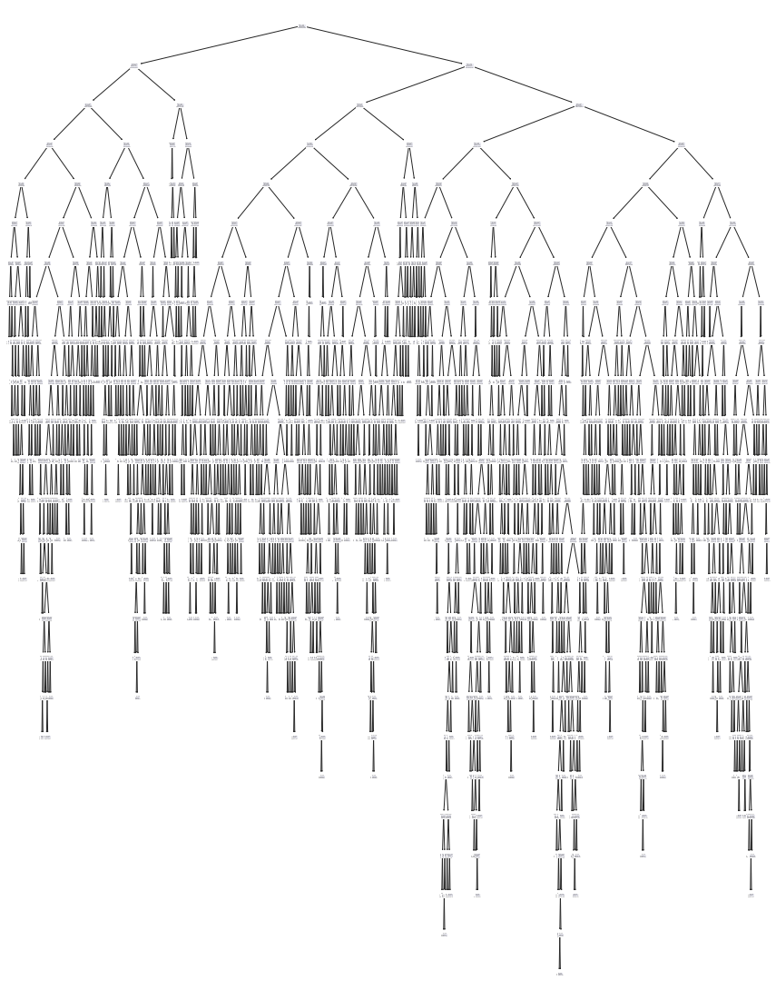

In [507]:
from sklearn import tree

tree.plot_tree(dtree)

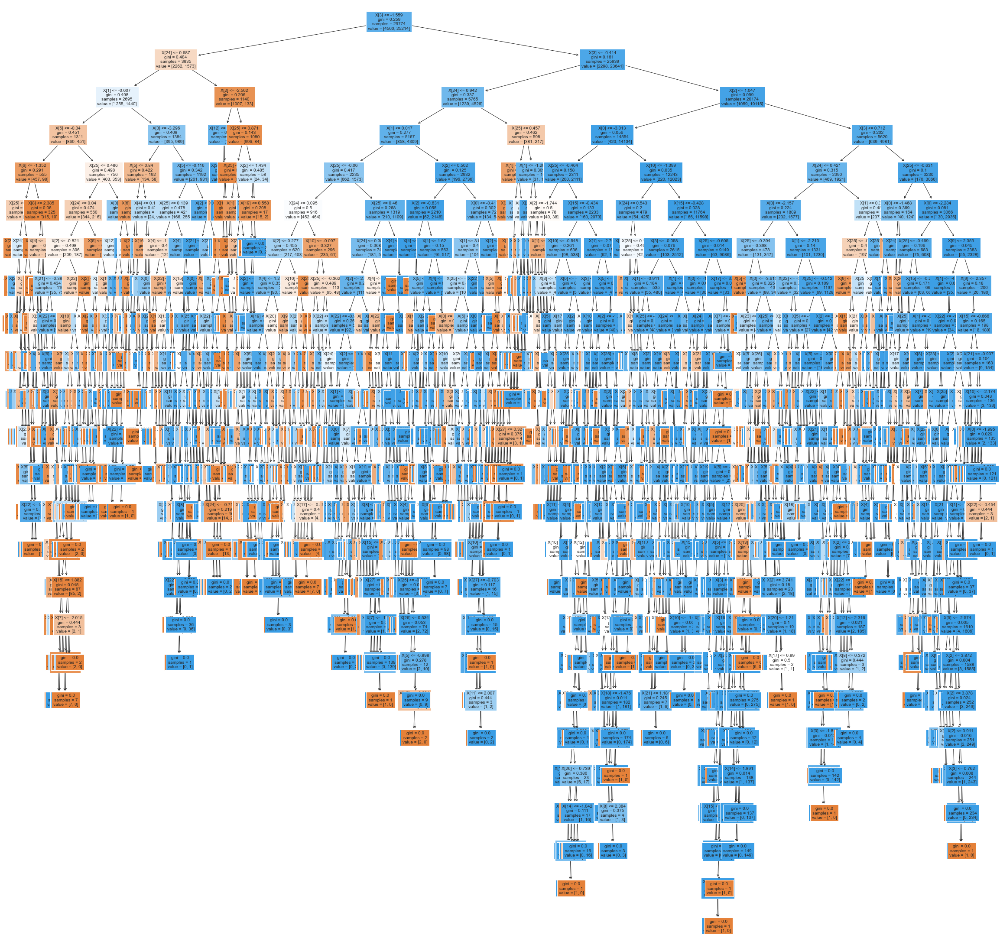

In [508]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtree, fontsize=10, filled=True)
plt.show()

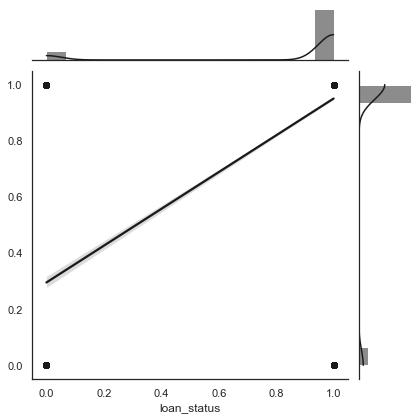

In [509]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y_test, y=y_pred,kind="reg", color="k");

In [167]:
results1 = pd.DataFrame({'DataFrame':['Bez modyfikacji dt1'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc]},index={'1'})
results1 = results1[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results1

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji dt1,0.99906,0.999449,0.998562


#### Mediana

In [515]:
from imblearn.over_sampling import SMOTE
X2 = df_FE3.iloc[:,:-1]
y2 = df_FE3.iloc[:,-1]

#Split train-test data
X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X2_train, y2_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X2_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X2_scaled_df_FE3)

X2 = pd.DataFrame(pca.transform(X2_scaled_df_FE3))
y2 = df_FE3['loan_status']


X2_train_SMOTE, X2_test, y2_train_SMOTE, y2_test = train_test_split(X2,y2, test_size = 0.3, random_state = 1)

In [516]:
dtree2 = DecisionTreeClassifier()

In [517]:
dtree2.fit(X_train_SMOTE, y_train_SMOTE)

DecisionTreeClassifier()

In [518]:
print('Feature importances: \n',pd.DataFrame(dtree2.feature_importances_,columns=['Imp'],index=X_train_SMOTE.columns))

Feature importances: 
                                   Imp
loan_amnt                    0.006396
funded_amnt                  0.069660
funded_amnt_inv              0.006090
term                         0.032988
int_rate                     0.001154
installment                  0.016735
emp_length                   0.000727
home_ownership               0.000277
annual_inc                   0.001576
verification_status          0.000000
purpose                      0.000215
dti                          0.001024
delinq_2yrs                  0.000000
fico_range_low               0.000626
fico_range_high              0.000616
inq_last_6mths               0.002554
open_acc                     0.001476
pub_rec                      0.000000
revol_bal                    0.001843
revol_util                   0.000615
total_acc                    0.000755
total_pymnt                  0.001567
total_pymnt_inv              0.004391
total_rec_prncp              0.118446
total_rec_int              

In [519]:
y2_pred = dtree2.predict(X2_test)
# performance on train data
print('Performance on training data using DT:',dtree2.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using DT:',dtree2.score(X2_test,y2_test))
#Evaluate the model using accuracy
acc_DT2=metrics.r2_score(y2_test, y2_pred)
print('Accuracy DT: ',acc_DT2)
print('MSE: ',metrics.mean_squared_error(y2_test, y2_pred))

C:\Users\patry\anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


ValueError: X has 21 features, but DecisionTreeClassifier is expecting 53 features as input.

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import precision_score

In [ ]:
print(classification_report(y2_test,y2_pred))

dtree_pr2= evaluate(y2_pred,y2_test)
dtree_pr2

In [ ]:
def evaluate(y2_pred,y2_test): 
    result = classification_report(y2_test,y2_pred,output_dict=True)
    f1 = result['1']['f1-score']

    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [ ]:
result = classification_report(y2_test,y2_pred,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [ ]:
from IPython.display import Image  
from sklearn.tree import export_graphviz

[Text(0.40538088622678675, 0.9807692307692307, 'X[3] <= -0.97\ngini = 0.259\nsamples = 29774\nvalue = [4545, 25229]'),
 Text(0.21622410910017076, 0.9423076923076923, 'X[11] <= 0.041\ngini = 0.442\nsamples = 7535\nvalue = [2479, 5056]'),
 Text(0.1468015806060263, 0.9038461538461539, 'X[1] <= 1.574\ngini = 0.5\nsamples = 3789\nvalue = [1839, 1950]'),
 Text(0.09989480052068044, 0.8653846153846154, 'X[18] <= -0.062\ngini = 0.488\nsamples = 2924\nvalue = [1691, 1233]'),
 Text(0.058899996050358214, 0.8269230769230769, 'X[2] <= 1.556\ngini = 0.376\nsamples = 1511\nvalue = [1131, 380]'),
 Text(0.040864331485311815, 0.7884615384615384, 'X[0] <= 4.215\ngini = 0.31\nsamples = 1273\nvalue = [1029, 244]'),
 Text(0.022146775971835973, 0.75, 'X[19] <= -0.557\ngini = 0.259\nsamples = 1150\nvalue = [974, 176]'),
 Text(0.007744659299977814, 0.7115384615384616, 'X[11] <= -0.768\ngini = 0.483\nsamples = 206\nvalue = [122, 84]'),
 Text(0.0028683923333251166, 0.6730769230769231, 'X[10] <= 1.751\ngini = 0.27

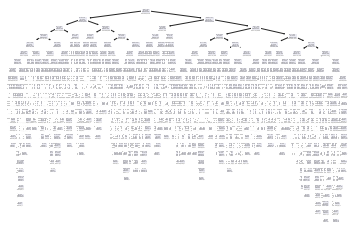

In [279]:
from sklearn import tree

tree.plot_tree(dtree2)

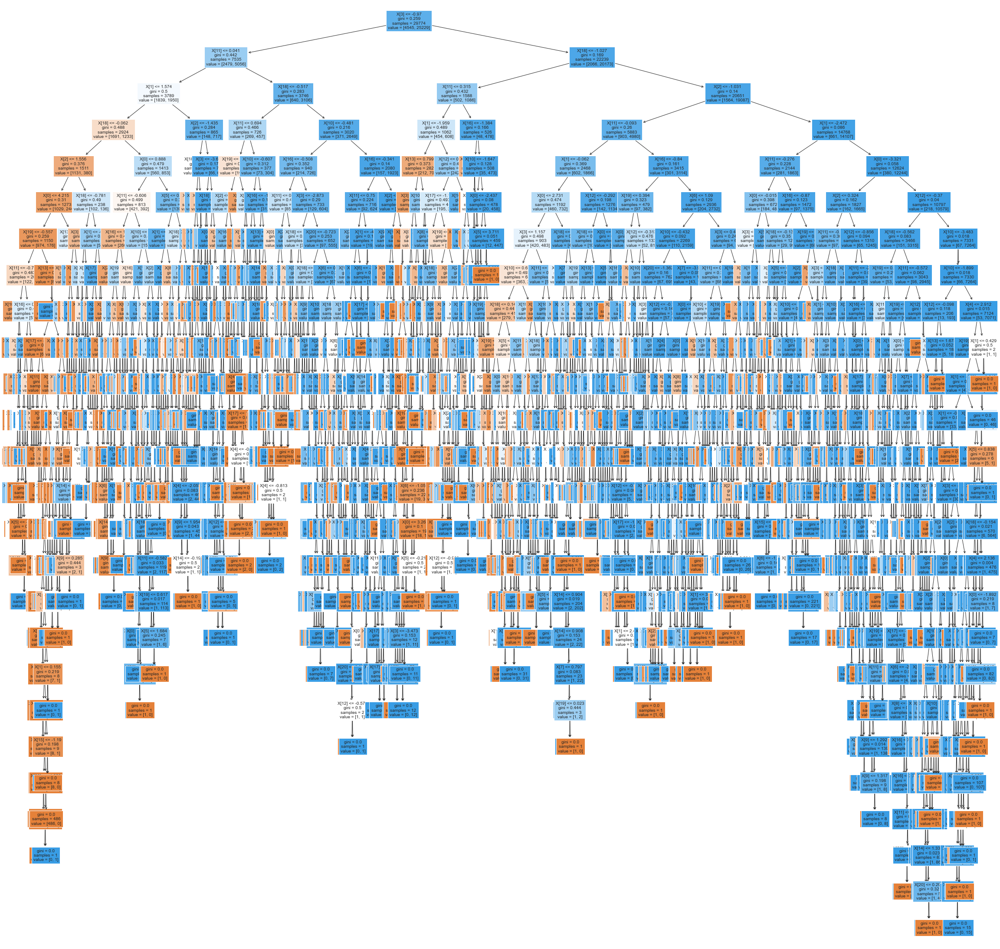

In [280]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtree2, fontsize=10, filled=True)
plt.show()

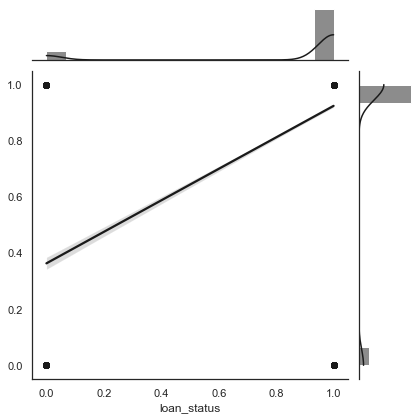

In [281]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y2_test, y=y2_pred,kind="reg", color="k");

In [301]:
cm = metrics.confusion_matrix(y2_test, y2_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1201   685]
 [  823 10052]]
Precision: 0.5933794466403162
Recall: 0.6367974549310711
Specificity: 0.9243218390804597


In [302]:
roc_auc2=metrics.roc_auc_score(y2_pred,y2_test)
roc_auc2

0.7647906826197761

Obniżenie wartości wskaźnika aucroc.

In [ ]:
dtreee = pd.DataFrame({'DataFrame':['Mediana dt2'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc2]},index={'2'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

#### Bez outliersów

In [520]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X3 = df_FE4.iloc[:,:-1]
y3 = df_FE4.iloc[:,-1]

#Split train-test data
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X3_train, y3_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X3_test)

pca = IncrementalPCA(n_components=23)
pca.fit(X3_scaled_df_FE4)

X3 = pd.DataFrame(pca.transform(X3_scaled_df_FE4))
y3 = df_FE4['loan_status']


X_train_SMOTE, X3_test, y_train_SMOTE, y3_test = train_test_split(X3,y3, test_size = 0.3, random_state = 1)

In [521]:
dtree3 = DecisionTreeClassifier()

In [522]:
dtree3.fit(X_train_SMOTE, y_train_SMOTE)

DecisionTreeClassifier()

In [523]:
print('Feature importances: \n',pd.DataFrame(dtree3.feature_importances_,columns=['Imp'],index=X_train_SMOTE.columns))

Feature importances: 
          Imp
0   0.072957
1   0.023579
2   0.047166
3   0.160438
4   0.014244
5   0.038625
6   0.014931
7   0.063400
8   0.006758
9   0.011200
10  0.006195
11  0.012330
12  0.006146
13  0.020131
14  0.005765
15  0.008238
16  0.010975
17  0.005463
18  0.009948
19  0.004785
20  0.013847
21  0.011970
22  0.430909


In [524]:
y3_pred = dtree3.predict(X3_test)
# performance on train data
print('Performance on training data using DT:',dtree3.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using DT:',dtree3.score(X3_test,y3_test))
#Evaluate the model using accuracy
acc_DT3=metrics.r2_score(y3_test, y3_pred)
print('Accuracy DT: ',acc_DT3)
print('MSE: ',metrics.mean_squared_error(y3_test, y3_pred))

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.9456434852118305
Accuracy DT:  0.41795851525335503
MSE:  0.05435651478816946


In [525]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import precision_score

In [526]:
print(classification_report(y3_test,y3_pred))

dtree_pr3= evaluate(y3_pred,y3_test)
dtree_pr3

              precision    recall  f1-score   support

           0       0.73      0.75      0.74       913
           1       0.97      0.97      0.97      7844

    accuracy                           0.95      8757
   macro avg       0.85      0.86      0.86      8757
weighted avg       0.95      0.95      0.95      8757



{'f1-score': 0.97, 'accuracy': 0.95}

In [527]:
def evaluate(y3_pred,y3_test): 
    result = classification_report(y3_test,y3_pred,output_dict=True)
    f1 = result['1']['f1-score']

    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [528]:
result = classification_report(y3_test,y3_pred,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [529]:
from IPython.display import Image  
from sklearn.tree import export_graphviz

[Text(0.17980472486250598, 0.9782608695652174, 'X[22] <= -1.075\ngini = 0.194\nsamples = 20430\nvalue = [2218, 18212]'),
 Text(0.038483381157340985, 0.9347826086956522, 'X[3] <= 0.381\ngini = 0.209\nsamples = 1128\nvalue = [994, 134]'),
 Text(0.021969153515064562, 0.8913043478260869, 'X[2] <= -1.243\ngini = 0.113\nsamples = 1001\nvalue = [941, 60]'),
 Text(0.009564801530368245, 0.8478260869565217, 'X[3] <= -1.288\ngini = 0.486\nsamples = 89\nvalue = [52, 37]'),
 Text(0.005738880918220947, 0.8043478260869565, 'X[0] <= 5.482\ngini = 0.187\nsamples = 48\nvalue = [43, 5]'),
 Text(0.003825920612147298, 0.7608695652173914, 'X[5] <= -2.59\ngini = 0.085\nsamples = 45\nvalue = [43, 2]'),
 Text(0.001912960306073649, 0.717391304347826, 'gini = 0.0\nsamples = 1\nvalue = [0, 1]'),
 Text(0.005738880918220947, 0.717391304347826, 'X[3] <= -1.425\ngini = 0.044\nsamples = 44\nvalue = [43, 1]'),
 Text(0.003825920612147298, 0.6739130434782609, 'gini = 0.0\nsamples = 41\nvalue = [41, 0]'),
 Text(0.00765184

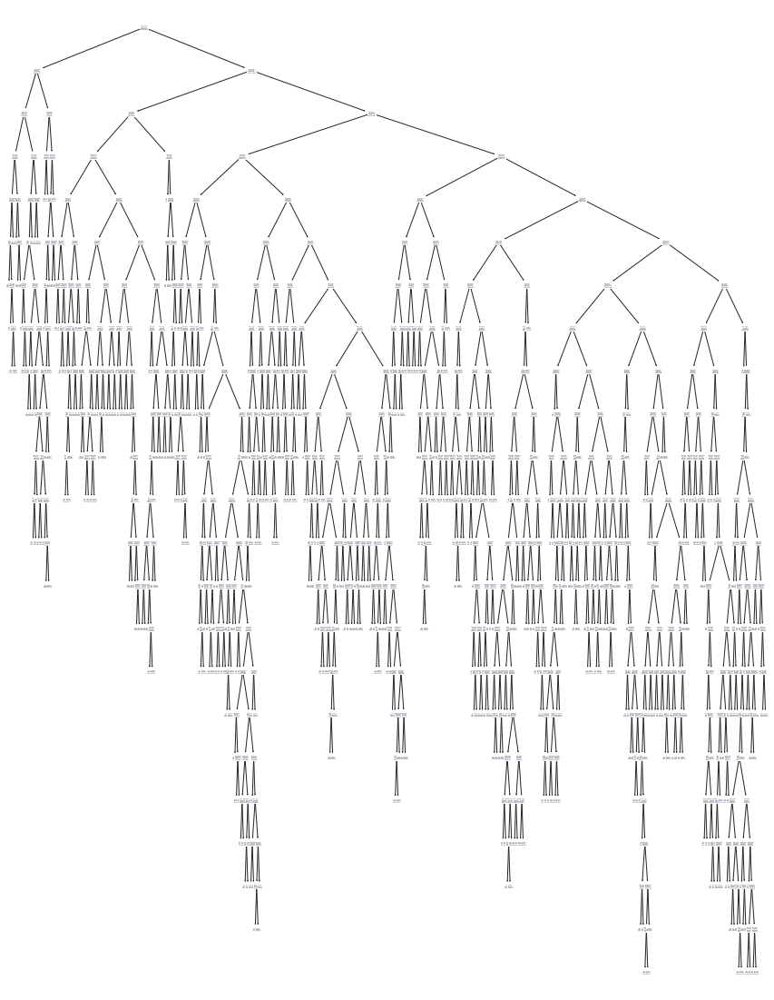

In [530]:
from sklearn import tree

tree.plot_tree(dtree3)

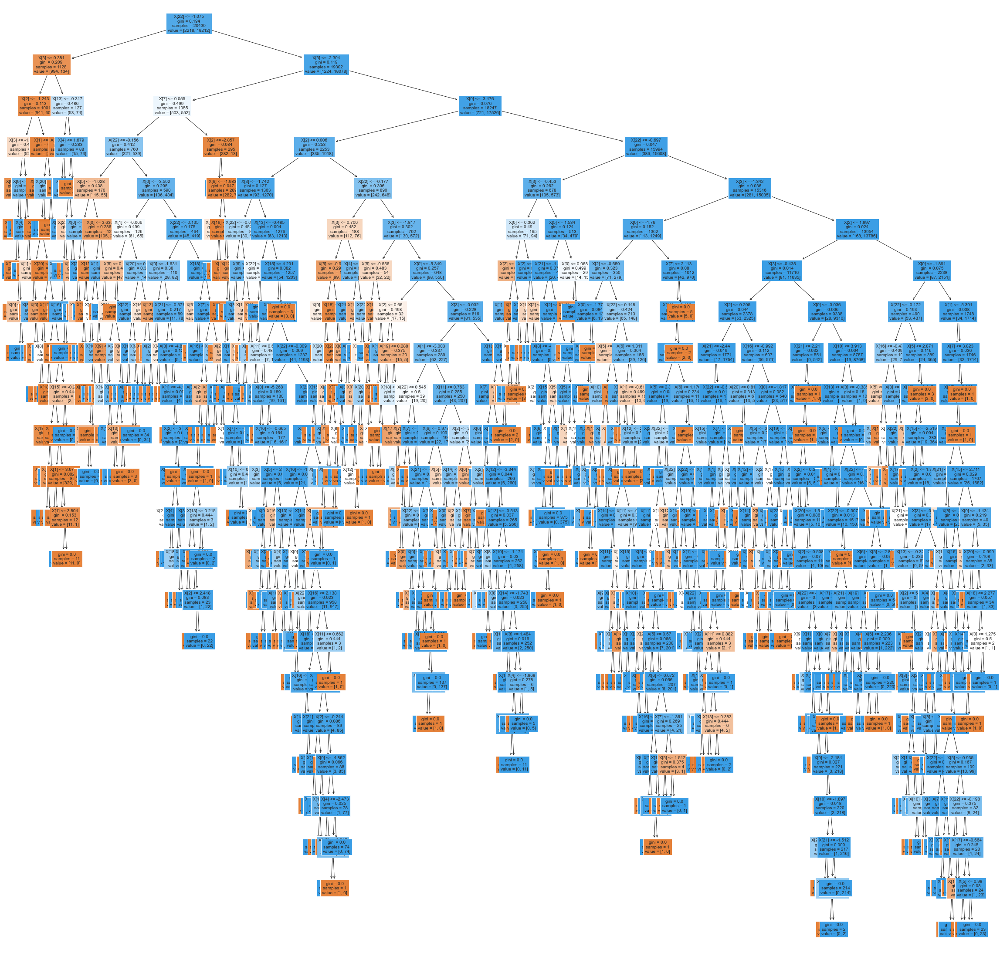

In [531]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtree3, fontsize=10, filled=True)
plt.show()

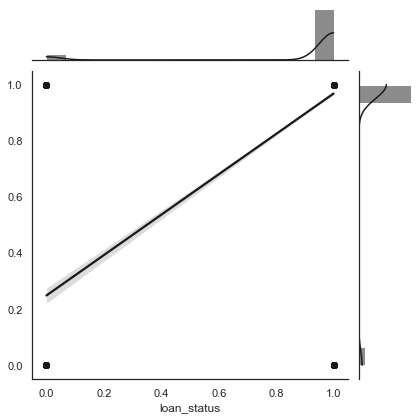

In [532]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y3_test, y=y3_pred,kind="reg", color="k");

In [533]:
cm = metrics.confusion_matrix(y3_test, y3_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 686  227]
 [ 249 7595]]
Precision: 0.7336898395721925
Recall: 0.7513691128148959
Specificity: 0.9682559918408975


In [534]:
roc_auc3=metrics.roc_auc_score(y3_pred,y3_test)
roc_auc3

0.852334564378272

Obnizenie wartosci parametru aucroc

In [535]:
dtreee = pd.DataFrame({'DataFrame':['Bez outliersow dt2'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc3]},index={'6'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

NameError: name 'results1' is not defined

#### Dummies

In [536]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X4 = df_dummies
y4 = target

#Split train-test data
X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X4_train, y4_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X4_test)

pca = IncrementalPCA(n_components=45)
pca.fit(X4_scaled_df_dummies)

X4 = pd.DataFrame(pca.transform(X4_scaled_df_dummies))
y4 = target


X_train_SMOTE, X4_test, y_train_SMOTE, y4_test = train_test_split(X4,y4, test_size = 0.3, random_state = 1)

In [537]:
dtree4 = DecisionTreeClassifier()

In [538]:
dtree4.fit(X_train_SMOTE, y_train_SMOTE)

DecisionTreeClassifier()

In [539]:
print('Feature importances: \n',pd.DataFrame(dtree4.feature_importances_,columns=['Imp'],index=X_train_SMOTE.columns))

Feature importances: 
          Imp
0   0.030177
1   0.065738
2   0.036597
3   0.151801
4   0.035492
5   0.020642
6   0.071617
7   0.008400
8   0.008060
9   0.006453
10  0.007913
11  0.015430
12  0.020755
13  0.014610
14  0.011575
15  0.006739
16  0.009095
17  0.009324
18  0.020815
19  0.006900
20  0.009432
21  0.010430
22  0.006055
23  0.004106
24  0.009643
25  0.006637
26  0.004700
27  0.003325
28  0.005741
29  0.004683
30  0.003832
31  0.005833
32  0.008684
33  0.003047
34  0.019504
35  0.007459
36  0.009944
37  0.005609
38  0.004953
39  0.004744
40  0.006006
41  0.006195
42  0.007988
43  0.260565
44  0.022754


In [540]:
y4_pred = dtree4.predict(X4_test)
# performance on train data
print('Performance on training data using DT:',dtree4.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using DT:',dtree4.score(X4_test,y4_test))
#Evaluate the model using accuracy
acc_DT4=metrics.r2_score(y4_test, y4_pred)
print('Accuracy DT: ',acc_DT4)
print('MSE: ',metrics.mean_squared_error(y4_test, y4_pred))

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.8985189248491497
Accuracy DT:  0.19428115210687347
MSE:  0.10148107515085025


In [541]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import precision_score

In [542]:
print(classification_report(y4_test,y4_pred))

dtree_pr4= evaluate(y4_pred,y4_test)
dtree_pr4

              precision    recall  f1-score   support

           0       0.65      0.69      0.67      1886
           1       0.95      0.93      0.94     10875

    accuracy                           0.90     12761
   macro avg       0.80      0.81      0.80     12761
weighted avg       0.90      0.90      0.90     12761



{'f1-score': 0.94, 'accuracy': 0.9}

In [543]:
def evaluate(y4_pred,y4_test): 
    result = classification_report(y4_test,y4_pred,output_dict=True)
    f1 = result['1']['f1-score']

    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [544]:
result = classification_report(y4_test,y4_pred,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [545]:
from IPython.display import Image  
from sklearn.tree import export_graphviz

[Text(0.6877322709669491, 0.9833333333333333, 'X[43] <= 1.072\ngini = 0.259\nsamples = 29774\nvalue = [4545, 25229]'),
 Text(0.4175368634885325, 0.95, 'X[3] <= -2.467\ngini = 0.201\nsamples = 27899\nvalue = [3155, 24744]'),
 Text(0.13716984719352066, 0.9166666666666666, 'X[6] <= 0.753\ngini = 0.499\nsamples = 2207\nvalue = [1050, 1157]'),
 Text(0.11127766047568317, 0.8833333333333333, 'X[43] <= 0.297\ngini = 0.485\nsamples = 1966\nvalue = [812, 1154]'),
 Text(0.07299621994891475, 0.85, 'X[1] <= -0.405\ngini = 0.435\nsamples = 1562\nvalue = [499, 1063]'),
 Text(0.035414714602934196, 0.8166666666666667, 'X[43] <= -0.633\ngini = 0.497\nsamples = 816\nvalue = [379, 437]'),
 Text(0.01868846988152845, 0.7833333333333333, 'X[3] <= -3.814\ngini = 0.368\nsamples = 333\nvalue = [81, 252]'),
 Text(0.010679125646587686, 0.75, 'X[6] <= -2.487\ngini = 0.464\nsamples = 164\nvalue = [60, 104]'),
 Text(0.005339562823293843, 0.7166666666666667, 'X[15] <= 0.659\ngini = 0.2\nsamples = 62\nvalue = [7, 55]'

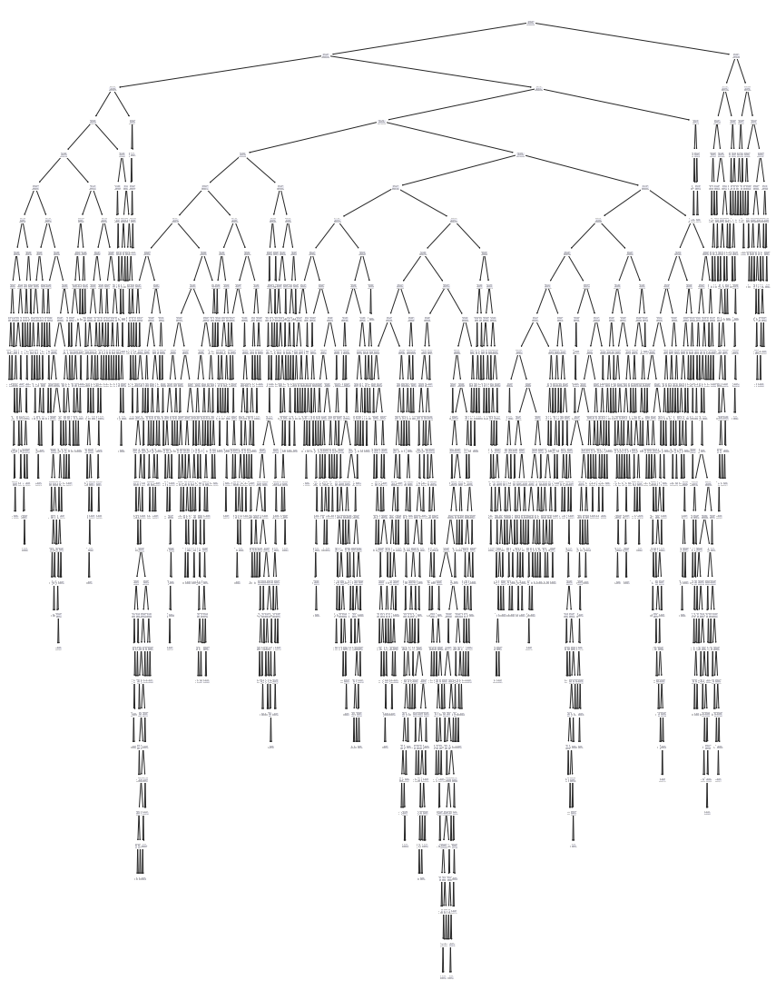

In [546]:
from sklearn import tree

tree.plot_tree(dtree4)

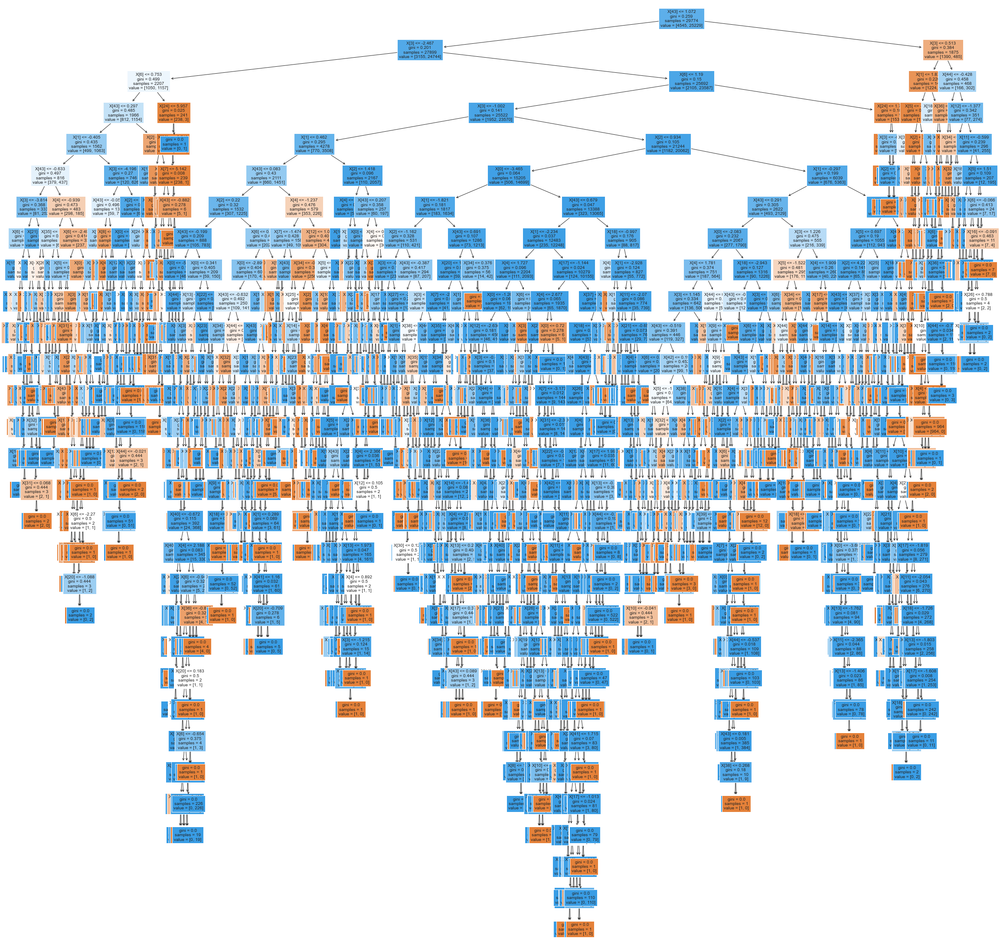

In [547]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtree4, fontsize=10, filled=True)
plt.show()

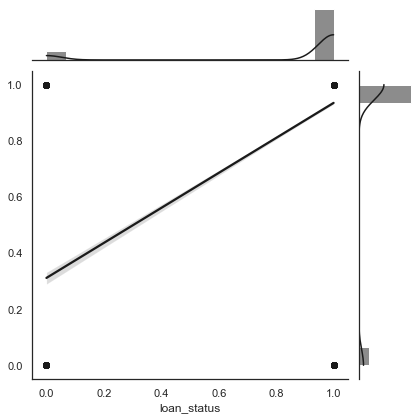

In [548]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y4_test, y=y4_pred,kind="reg", color="k");

In [549]:
cm = metrics.confusion_matrix(y4_test, y4_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1299   587]
 [  708 10167]]
Precision: 0.6472346786248132
Recall: 0.6887592788971368
Specificity: 0.9348965517241379


In [550]:
roc_auc4=metrics.roc_auc_score(y4_pred,y4_test)
roc_auc4

0.7963251689571899

`Obniżenie wartości wskaźników klasyfikatorow po zbalansowaniu danych i pca.`

In [ ]:
dtreee = pd.DataFrame({'DataFrame':['Bez modyfikacji dt2'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc4]},index={'2'})
results1 = pd.concat([results1, dtreee])
results1 = results1[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results1

Wysokie wartości klasyfikatorów. Nie ma koniecznosci usuwania nadmiarowych cech.

##### Srednia

In [551]:
from sklearn.tree import DecisionTreeClassifier

In [552]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X6 = df_FE6.iloc[:, :-1]
y6= df_FE6.iloc[:, -1]

#Split train-test data
X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X6_train, y6_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X6_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X_scaled_df_FE6)

X6 = pd.DataFrame(pca.transform(X_scaled_df_FE6))
y6 = target

X_train_SMOTE, X6_test, y_train_SMOTE, y6_test = train_test_split(X6, y6, test_size=0.30,random_state=42)

In [553]:
dtree6 = DecisionTreeClassifier()

In [554]:
dtree6.fit(X_train_SMOTE, y_train_SMOTE)

DecisionTreeClassifier()

In [555]:
print('Feature importances: \n',pd.DataFrame(dtree6.feature_importances_,columns=['Imp'],index=X_train_SMOTE.columns))

Feature importances: 
          Imp
0   0.033314
1   0.192095
2   0.079527
3   0.407425
4   0.017879
5   0.024899
6   0.001793
7   0.002920
8   0.025335
9   0.157797
10  0.004234
11  0.003099
12  0.014100
13  0.001717
14  0.002975
15  0.008833
16  0.002288
17  0.006298
18  0.006081
19  0.002221
20  0.005170


In [556]:
y6_pred = dtree6.predict(X6_test)
# performance on train data
print('Performance on training data using DT:',dtree6.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using DT:',dtree6.score(X6_test,y6_test))
#Evaluate the model using accuracy
acc_DT=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_DT)
print('MSE: ',metrics.mean_squared_error(y6_test, y6_pred))

Performance on training data using DT: 1.0
Performance on testing data using DT: 0.9677924927513518
Accuracy DT:  0.7425903267650511
MSE:  0.03220750724864822


In [557]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import precision_score

In [558]:
print(classification_report(y6_test,y6_pred))

dtree_pr6= evaluate(y6_pred,y6_test)
dtree_pr6

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      1871
           1       0.98      0.98      0.98     10890

    accuracy                           0.97     12761
   macro avg       0.93      0.94      0.94     12761
weighted avg       0.97      0.97      0.97     12761



{'f1-score': 0.98, 'accuracy': 0.97}

In [559]:
def evaluate(y6_pred,y6_test): 
    result = classification_report(y6_test,y6_pred,output_dict=True)
    f1 = result['1']['f1-score']

    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [560]:
result = classification_report(y6_test,y6_pred,output_dict=True)
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [561]:
from IPython.display import Image  
from sklearn.tree import export_graphviz

In [562]:
cm = metrics.confusion_matrix(y6_test, y6_pred)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1681   190]
 [  221 10669]]
Precision: 0.8838065194532071
Recall: 0.8984500267236771
Specificity: 0.9797061524334252


[Text(0.6739090547154836, 0.9761904761904762, 'X[3] <= 1.727\ngini = 0.259\nsamples = 29774\nvalue = [4560, 25214]'),
 Text(0.47745829178199284, 0.9285714285714286, 'X[3] <= 0.571\ngini = 0.122\nsamples = 25172\nvalue = [1640, 23532]'),
 Text(0.33221971500868336, 0.8809523809523809, 'X[2] <= 2.956\ngini = 0.06\nsamples = 20047\nvalue = [619, 19428]'),
 Text(0.2598209561217844, 0.8333333333333334, 'X[9] <= 3.027\ngini = 0.038\nsamples = 18401\nvalue = [354, 18047]'),
 Text(0.20736578069032888, 0.7857142857142857, 'X[9] <= 1.271\ngini = 0.036\nsamples = 18377\nvalue = [337, 18040]'),
 Text(0.12121289210897644, 0.7380952380952381, 'X[2] <= 0.666\ngini = 0.026\nsamples = 16532\nvalue = [214, 16318]'),
 Text(0.05980340280039075, 0.6904761904761905, 'X[4] <= 3.773\ngini = 0.01\nsamples = 11656\nvalue = [61, 11595]'),
 Text(0.04442771084337349, 0.6428571428571429, 'X[1] <= -2.62\ngini = 0.01\nsamples = 11652\nvalue = [58, 11594]'),
 Text(0.018886356235753826, 0.5952380952380952, 'X[17] <= -1.

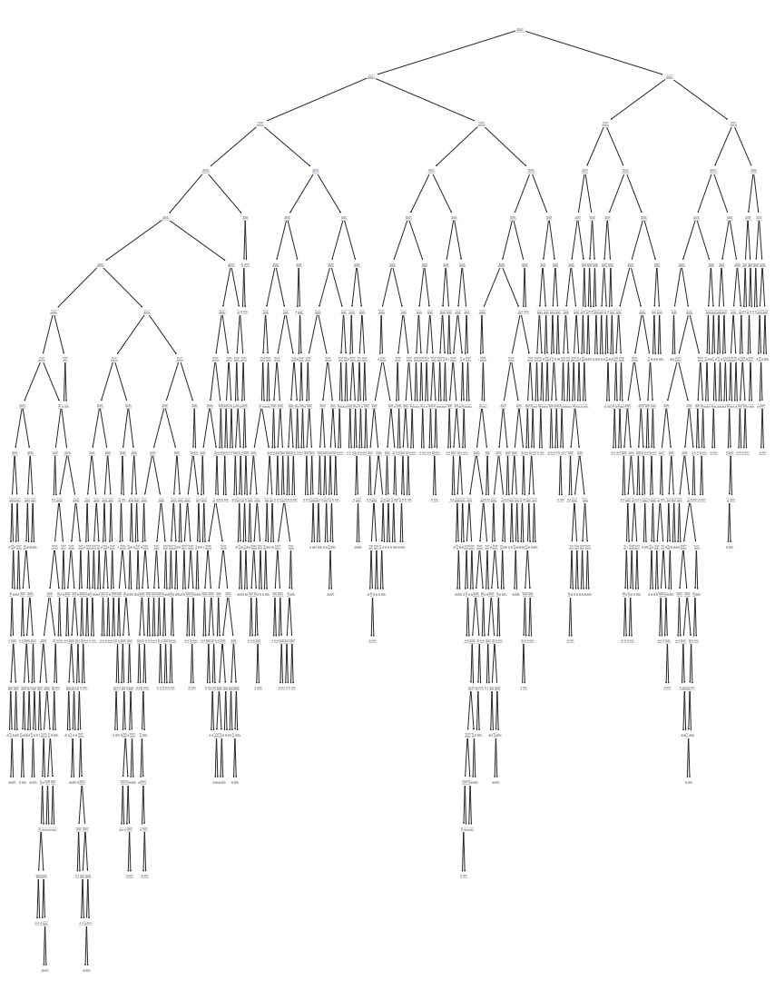

In [563]:
from sklearn import tree

tree.plot_tree(dtree6)

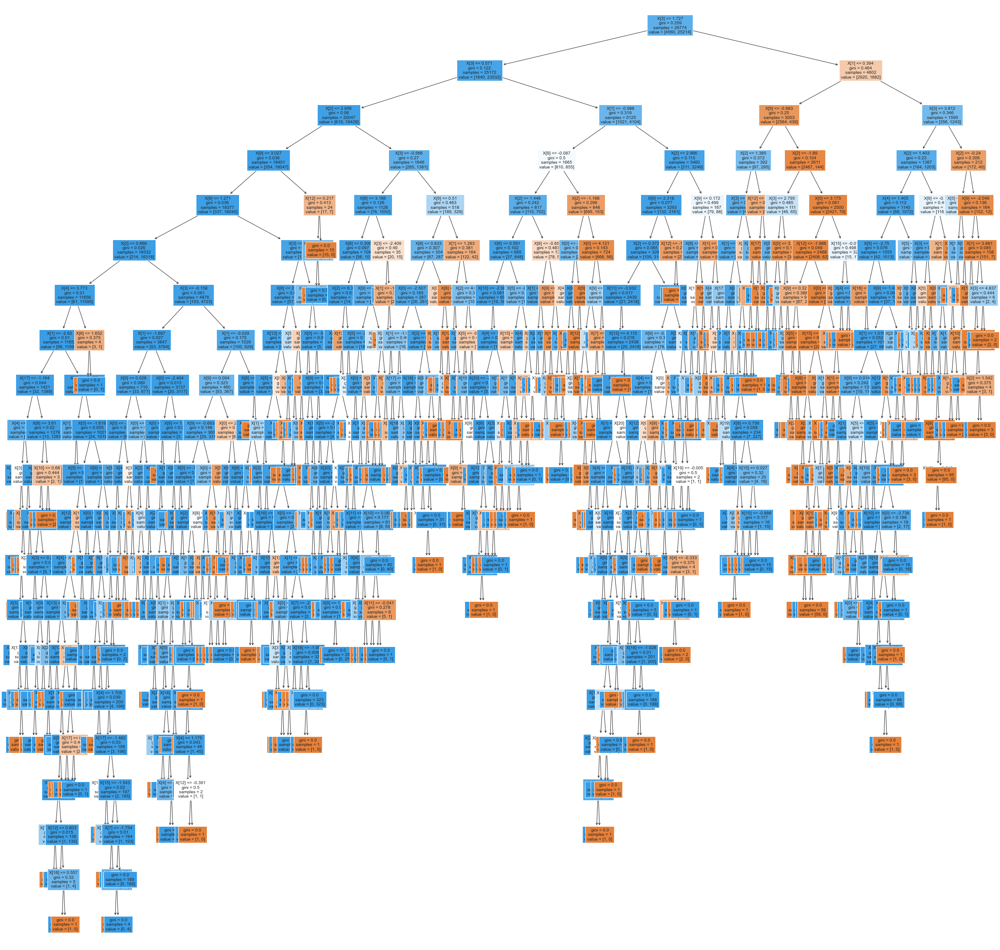

In [564]:
from sklearn import tree

plt.figure(figsize=(40,40))
tree.plot_tree(dtree6, fontsize=10, filled=True)
plt.show()

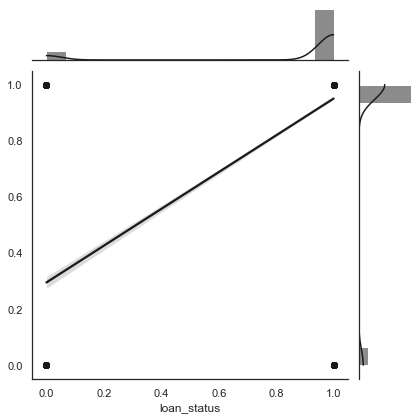

In [565]:
from scipy.stats import pearsonr
sns.set(style="darkgrid", color_codes=True)   
with sns.axes_style("white"):
    sns.jointplot(x=y_test, y=y_pred,kind="reg", color="k");

In [566]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc6

0.9331547561811574

`Obniżenie wartości wskaźników klasyfikatorow po zbalansowaniu danych i pca.`

In [ ]:
results1 = pd.DataFrame({'DataFrame':['Srednia dt1'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc6]},index={'1'})
results1 = results1[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results1

### K Nearest Neighbors (KNN)

#### Bez usuwania outliersow

In [567]:
from imblearn.over_sampling import SMOTE

X = df_FE2.iloc[:,:-1]
y = df_FE2.iloc[:,-1]

#Split train-test data
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train, y_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X_test)

pca = IncrementalPCA(n_components=28)
pca.fit(X_scaled_df_FE)

X = pd.DataFrame(pca.transform(X_scaled_df_FE))
y = df_FE['loan_status']

X_train_SMOTE, X_test, y_train_SMOTE, y_test = train_test_split(X,y,
                                                    test_size=0.30)

In [568]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=2)

In [569]:
knn.fit(X_train_SMOTE, y_train_SMOTE)

KNeighborsClassifier(n_neighbors=2)

In [570]:
knn_prediction = knn.predict(X_test)

In [571]:
print(classification_report(knn_prediction,y_test))
knn1_pr = evaluate(knn_prediction,y_test)
knn1_pr

              precision    recall  f1-score   support

           0       0.74      0.65      0.69      2167
           1       0.93      0.95      0.94     10594

    accuracy                           0.90     12761
   macro avg       0.83      0.80      0.82     12761
weighted avg       0.90      0.90      0.90     12761



{'f1-score': 0.94, 'accuracy': 0.9}

In [572]:
cm = metrics.confusion_matrix(y_test, knn_prediction)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1408   495]
 [  759 10099]]
Precision: 0.649746192893401
Recall: 0.7398843930635838
Specificity: 0.9300976238717996


In [573]:
def evaluate(knn_prediction,y_test): 
    result = classification_report(y_test,knn_prediction,output_dict=True)
    f1_a = result['1']['f1-score']
    accuracy_a = result['accuracy']
    performance_data= {'f1-score':round(f1_a, 2),
                      'accuracy':round(accuracy_a, 2)}
    return performance_data

In [574]:
f1_a = result['1']['f1-score']
accuracy_a = result['accuracy']

In [575]:
roc_auc=metrics.roc_auc_score(knn_prediction,y_test)
roc_auc

0.801510815910548

Best alpha using built-in LassoCV: 0.001524
Best score using built-in LassoCV: 0.592287
Lasso picked 27 variables and eliminated the other 1 variables


Text(0.5, 1.0, 'Feature importance using Lasso Model')

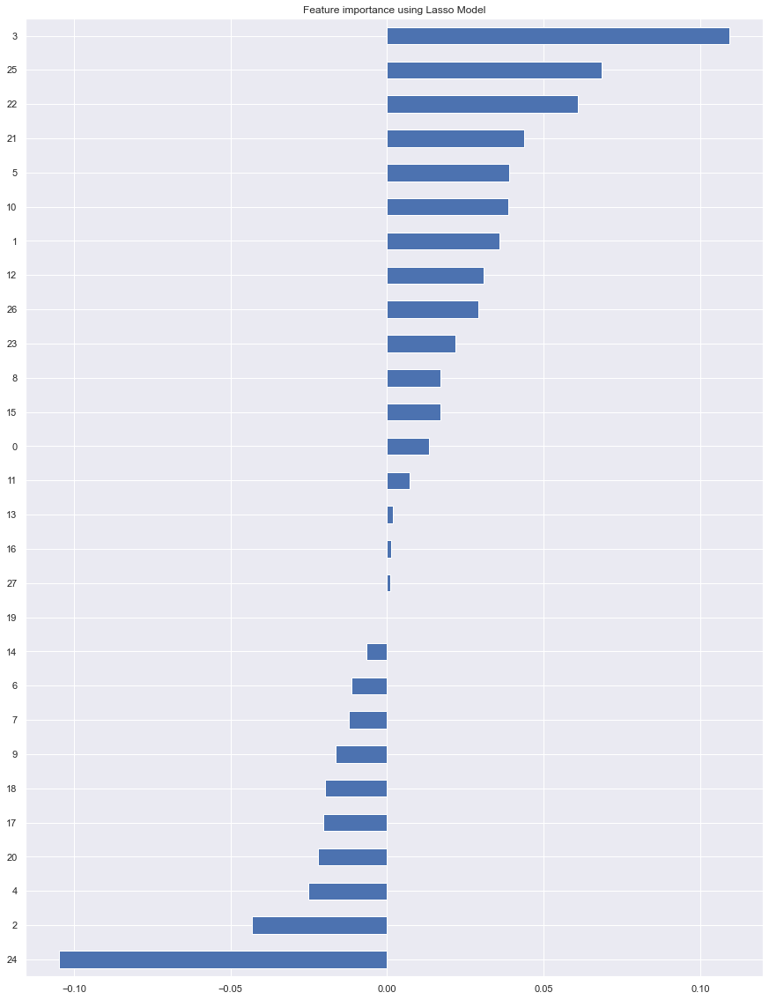

In [576]:
#Atrybuty, ktore sa istotne dla modelu
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE
from sklearn.linear_model import RidgeCV, LassoCV, Ridge, Lasso#Loading the dataset

X = pd.DataFrame(pca.transform(X_scaled_df_FE))
y = df_FE['loan_status']

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

In [354]:
results3= pd.DataFrame({'DataFrame':['Bez modyfikacji'], 'accuracy': [accuracy_a], 'f1-score': [f1_a], 'AUCROC':[roc_auc]},index={'1'})
results3 = results3[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results3

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.967792,0.981111,0.810792


Otrzymane wartości klasyfikatorów są znacznie niższe niż dla modeli regresji logistycznej i drzewa decyzyjnego. Model wyeliminowal 22 wartosci nadmiarowe a pozostawił .

#### Mediana

In [577]:
from imblearn.over_sampling import SMOTE
X2 = df_FE3.iloc[:,:-1]
y2 = df_FE3.iloc[:,-1]

#Split train-test data
X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X2_train, y2_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X2_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X2_scaled_df_FE3)

X2 = pd.DataFrame(pca.transform(X2_scaled_df_FE3))
y2 = df_FE3['loan_status']


X_train_SMOTE, X2_test, y2_train_SMOTE, y2_test = train_test_split(X2, y2,
                                                    test_size=0.30)

In [578]:
from sklearn.neighbors import KNeighborsClassifier
knn2 = KNeighborsClassifier(n_neighbors=2)

In [579]:
knn2.fit(X_train_SMOTE, y_train_SMOTE)

ValueError: Found input variables with inconsistent numbers of samples: [29774, 50596]

In [580]:
knn_prediction2 = knn2.predict(X2_test)

NotFittedError: This KNeighborsClassifier instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.

In [581]:
print(classification_report(knn_prediction2,y2_test))
knn1_pr2 = evaluate(knn_prediction2,y2_test)
knn1_pr2

              precision    recall  f1-score   support

           0       0.19      0.15      0.17      2438
           1       0.81      0.84      0.83     10323

    accuracy                           0.71     12761
   macro avg       0.50      0.50      0.50     12761
weighted avg       0.69      0.71      0.70     12761



{'f1-score': 0.83, 'accuracy': 0.71}

In [582]:
def evaluate(knn_prediction2,y2_test): 
    result = classification_report(y2_test,knn_prediction2,output_dict=True)
    f1_2 = result['1']['f1-score']
    accuracy2 = result['accuracy']
    performance_data= {'f1-score':round(f1_2, 2),
                      'accuracy':round(accuracy2, 2)}
    return performance_data

In [583]:
f1_2 = result['1']['f1-score']
accuracy2 = result['accuracy']

In [584]:
cm = metrics.confusion_matrix(y2_test,knn_prediction2)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 366 1604]
 [2072 8719]]
Precision: 0.1501230516817063
Recall: 0.18578680203045686
Specificity: 0.8079881382633676


In [585]:
roc_auc2=metrics.roc_auc_score(knn_prediction2,y2_test)
roc_auc2

0.49737093202122706

Best alpha using built-in LassoCV: 0.001663
Best score using built-in LassoCV: 0.444843
Lasso picked 21 variables and eliminated the other 0 variables


Text(0.5, 1.0, 'Feature importance using Lasso Model')

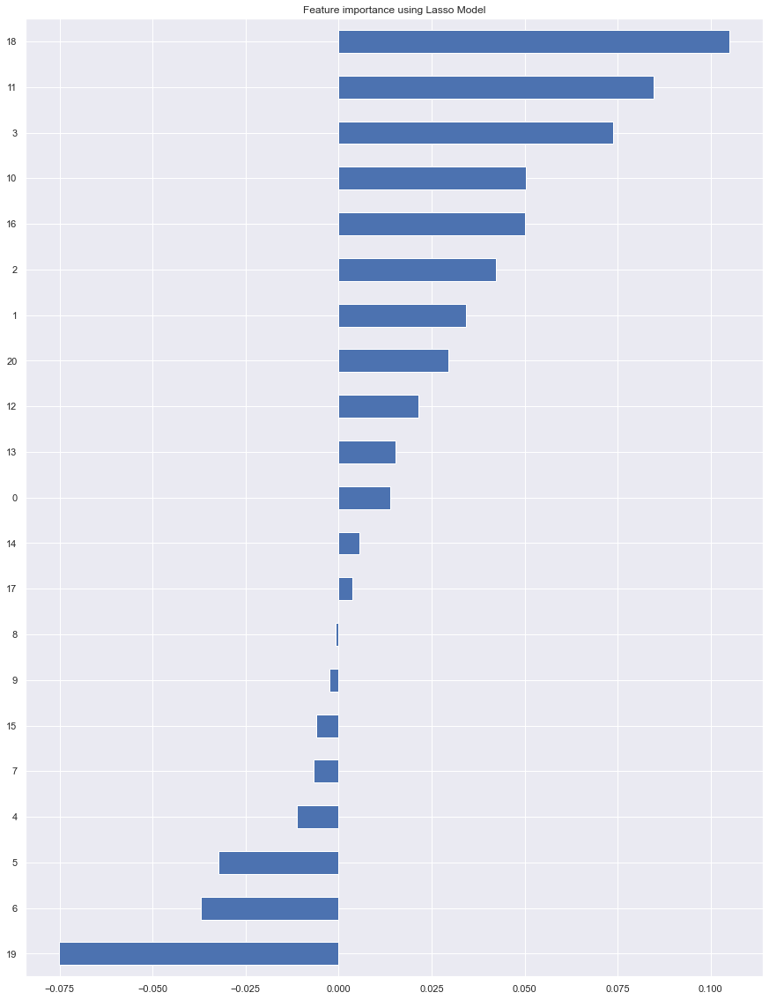

In [586]:
X = pd.DataFrame(pca.transform(X2_scaled_df_FE3))
y= df_FE3['loan_status']

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

In [587]:
KNN= pd.DataFrame({'DataFrame':['Mediana'], 'accuracy': [accuracy2], 'f1-score': [f1_2],'AUCROC':[roc_auc2]},index={'2'})
results3 = pd.concat([results3, KNN])
results3 = results3[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results3

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.967792,0.981111,0.810792
2,Mediana,0.967792,0.981103,0.497371


`Obniżenie wartości wskaźników klasyfikatorow po zbalansowaniu danych i pca.`

#### Usunięcie outliersów

In [588]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X3 = df_FE4.iloc[:,:-1]
y3 = df_FE4.iloc[:,-1]

#Split train-test data
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X3_train, y3_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X3_test)

pca = IncrementalPCA(n_components=23)
pca.fit(X3_scaled_df_FE4)

X3 = pd.DataFrame(pca.transform(X3_scaled_df_FE4))
y3 = df_FE4['loan_status']

X_train_SMOTE, X3_test, y_train_SMOTE, y3_test = train_test_split(X3, y3,
                                                    test_size=0.30)

In [589]:
from sklearn.neighbors import KNeighborsClassifier
knn3 = KNeighborsClassifier(n_neighbors=2)

In [590]:
knn3.fit(X_train_SMOTE, y_train_SMOTE)

KNeighborsClassifier(n_neighbors=2)

In [591]:
knn_prediction3 = knn3.predict(X3_test)

In [592]:
print(classification_report(knn_prediction3,y3_test))
knn1_pr3 = evaluate(knn_prediction3,y3_test)
knn1_pr3

              precision    recall  f1-score   support

           0       0.74      0.71      0.72       987
           1       0.96      0.97      0.97      7770

    accuracy                           0.94      8757
   macro avg       0.85      0.84      0.84      8757
weighted avg       0.94      0.94      0.94      8757



{'f1-score': 0.97, 'accuracy': 0.94}

In [593]:
def evaluate(knn_prediction3,y3_test): 
    result = classification_report(y3_scaled_test,knn_prediction3,output_dict=True)
    f1_3 = result['1']['f1-score']
    accuracy3 = result['accuracy']
    performance_data= {'f1-score':round(f1_3, 2),
                      'accuracy':round(accuracy3, 2)}
    return performance_data

In [594]:
f1_3 = result['1']['f1-score']
accuracy3 = result['accuracy']

In [595]:
cm = metrics.confusion_matrix(knn_prediction3,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 696  291]
 [ 245 7525]]
Precision: 0.7396386822529224
Recall: 0.7051671732522796
Specificity: 0.9684684684684685


In [596]:
roc_auc3=metrics.roc_auc_score(knn_prediction3,y3_test)
roc_auc3

0.836817820860374

Best alpha using built-in LassoCV: 0.000845
Best score using built-in LassoCV: 0.640523
Lasso picked 22 variables and eliminated the other 1 variables


Text(0.5, 1.0, 'Feature importance using Lasso Model')

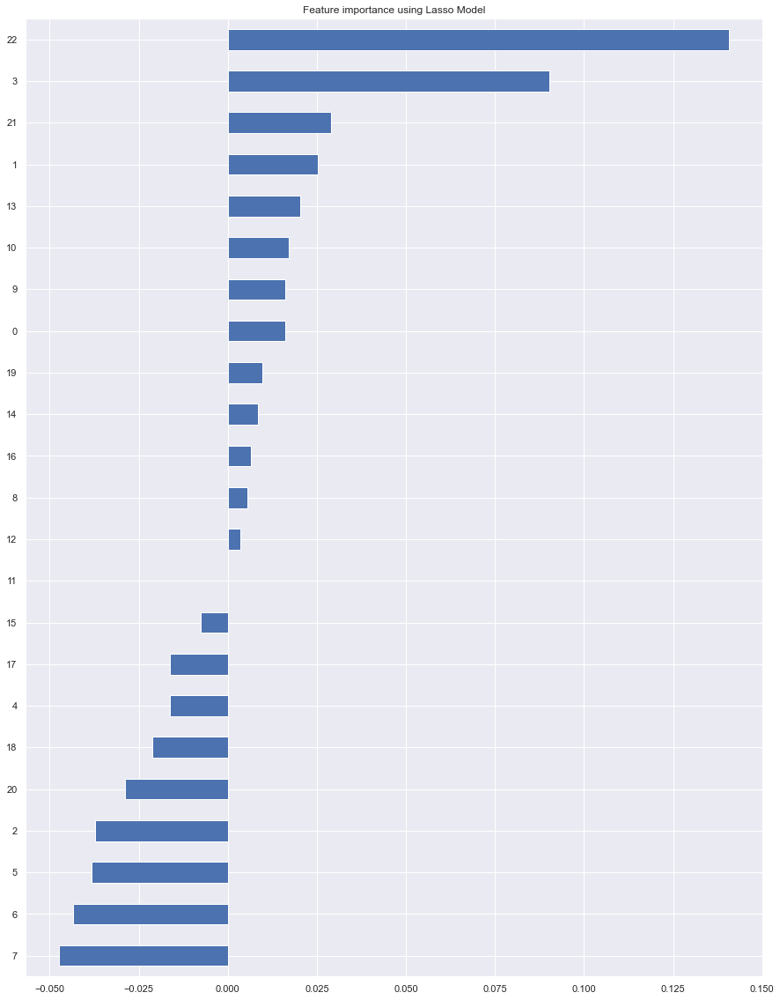

In [597]:
X = pd.DataFrame(pca.transform(X3_scaled_df_FE4))
y= df_FE4['loan_status']

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

In [598]:
KNN= pd.DataFrame({'DataFrame':['Bez outliersow'], 'accuracy': [accuracy3], 'f1-score': [f1_3],'AUCROC':[roc_auc3]},index={'3'})
results3 = pd.concat([results3, KNN])
results3 = results3[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results3

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.967792,0.981111,0.810792
2,Mediana,0.967792,0.981103,0.497371
3,Bez outliersow,0.967792,0.981103,0.836818


Wartosci klasyfikatorow sa delikatnie wyzsze jak w przypadku poprzednich modeli. W tym przypadku model odrzuil 12 wartosci nadmiarowych.


#### Dummies

In [599]:
from imblearn.over_sampling import SMOTE

X4 = df_dummies
y4 = target

#Split train-test data
X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X4_train, y4_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X4_test)

pca = IncrementalPCA(n_components=45)
pca.fit(X4_scaled_df_dummies)

X4 = pd.DataFrame(pca.transform(X4_scaled_df_dummies))
y4 = target

X_train_SMOTE, X4_test, y_train_SMOTE, y4_test = train_test_split(X4, target,
                                                    test_size=0.30)

In [600]:
from sklearn.neighbors import KNeighborsClassifier
knn4 = KNeighborsClassifier(n_neighbors=2)

In [601]:
knn4.fit(X_train_SMOTE, y_train_SMOTE)

KNeighborsClassifier(n_neighbors=2)

In [603]:
knn_prediction4 = knn4.predict(X4_test)

In [608]:
print(classification_report(knn_prediction4,y4_test))
knn1_pr4 = evaluate(knn_prediction4,y4_test)
knn1_pr4

              precision    recall  f1-score   support

           0       0.71      0.57      0.63      2378
           1       0.91      0.95      0.93     10383

    accuracy                           0.88     12761
   macro avg       0.81      0.76      0.78     12761
weighted avg       0.87      0.88      0.87     12761



{'f1-score': 0.93, 'accuracy': 0.88}

In [609]:
def evaluate(knn_prediction4,y4_test): 
    result = classification_report(y4_test,knn_prediction4,output_dict=True)
    f1_4 = result['1']['f1-score']
    accuracy4 = result['accuracy']
    performance_data= {'f1-score':round(f1_4, 2),
                      'accuracy':round(accuracy4, 2)}
    return performance_data

In [618]:
f1_4 = result['1']['f1-score']
accuracy4 = result['accuracy']

In [619]:
cm = metrics.confusion_matrix(knn_prediction4,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[1347 1031]
 [ 558 9825]]
Precision: 0.7070866141732284
Recall: 0.5664423885618166
Specificity: 0.9462583068477318


In [620]:
roc_auc4=metrics.roc_auc_score(knn_prediction4,y4_test)
roc_auc4

0.7563503477047743

Best alpha using built-in LassoCV: 0.001298
Best score using built-in LassoCV: 0.640111
Lasso picked 46 variables and eliminated the other 40 variables


Text(0.5, 1.0, 'Feature importance using Lasso Model')

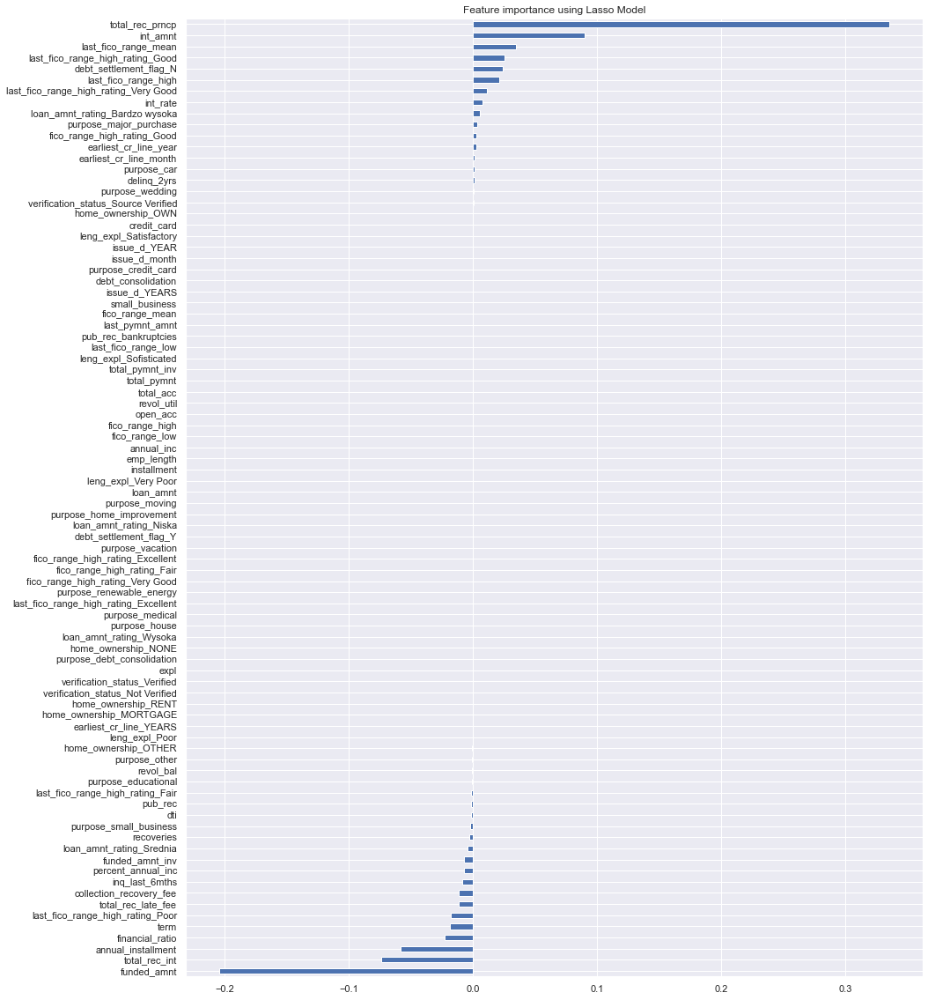

In [621]:
X = X4_scaled_df_dummies
y= df_FE2['loan_status']

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

In [622]:
KNN= pd.DataFrame({'DataFrame':['Dummies'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc4]},index={'4'})
results3 = pd.concat([results3, KNN])
results3 = results3[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results3

,DataFrame,accuracy,f1-score,AUCROC
1,Bez modyfikacji,0.967792,0.981111,0.810792
2,Mediana,0.967792,0.981103,0.497371
3,Bez outliersow,0.967792,0.981103,0.836818
4,Dummies,0.967792,0.981103,0.756350


DF z one-hot-encodingiem miał o wiele niższe wartości klasyfikatora. Model odrzucił 40 wartości nadmiarowych.

#### Srednia

In [623]:
from imblearn.over_sampling import SMOTE

X6 = df_FE6.iloc[:, :-1]
y6= df_FE6.iloc[:, -1]

#Split train-test data
X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X6_train, y6_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X6_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X_scaled_df_FE6)

X6 = pd.DataFrame(pca.transform(X_scaled_df_FE6))
y6 = target


X_train_SMOTE, X6_test, y_train_SMOTE, y6_test = train_test_split(X6, y6, test_size=0.3, random_state=42)

In [624]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=2)

In [625]:
knn.fit(X_train_SMOTE, y_train_SMOTE)

KNeighborsClassifier(n_neighbors=2)

In [627]:
knn_prediction6 = knn.predict(X6_test)

In [628]:
print(classification_report(knn_prediction6,y6_test))
knn1_pr6 = evaluate(knn_prediction6,y6_test)
knn1_pr6

              precision    recall  f1-score   support

           0       0.96      0.96      0.96      1872
           1       0.99      0.99      0.99     10889

    accuracy                           0.99     12761
   macro avg       0.98      0.98      0.98     12761
weighted avg       0.99      0.99      0.99     12761



{'f1-score': 0.99, 'accuracy': 0.99}

In [629]:
def evaluate(knn_prediction6,y6_test): 
    result = classification_report(y6_test,knn_prediction6,output_dict=True)
    f1_a = result['1']['f1-score']
    accuracy_a = result['accuracy']
    performance_data= {'f1-score':round(f1_a, 2),
                      'accuracy':round(accuracy_a, 2)}
    return performance_data

In [630]:
f1_a = result['1']['f1-score']
accuracy_a = result['accuracy']

In [631]:
cm = metrics.confusion_matrix(knn_prediction6,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1792    80]
 [   79 10810]]
Precision: 0.9577765900587921
Recall: 0.9572649572649573
Specificity: 0.9927449719900817


In [632]:
roc_auc6=metrics.roc_auc_score(knn_prediction6,y6_test)
roc_auc6

0.9750049646275196

In [633]:
X = df_FE6_scaled
y= df_FE6['loan_status']

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (15.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

NameError: name 'df_FE6_scaled' is not defined

In [ ]:
KNN= pd.DataFrame({'DataFrame':['Srednia'], 'accuracy': [accuracy2], 'f1-score': [f1_2],'AUCROC':[roc_auc2]},index={'2'})
results3 = pd.concat([results3, KNN])
results3 = results3[['DataFrame', 'accuracy', 'f1-score', 'AUCROC']]
results3

In [ ]:
Najlepiej wytrenowany model sposrod wszystkich KNN. Najwyższe wartosci wskaźników. Model odrzucił 35 nadmiarowych cech. Istotna okazala sie cecha recoveries  

### Bagging

In [634]:
!pip install xgboost 
!pip install lightgbm
!pip install catboost

#### Bez usuwania outliersow

In [635]:
from sklearn.ensemble import BaggingClassifier
from sklearn import tree

from imblearn.over_sampling import SMOTE

X = df_FE2.iloc[:,:-1]
y = df_FE2.iloc[:,-1]

#Split train-test data
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train, y_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X_test)

pca = IncrementalPCA(n_components=28)
pca.fit(X_scaled_df_FE)

X = pd.DataFrame(pca.transform(X_scaled_df_FE))
y = df_FE['loan_status']

X_train_SMOTE, X_test, y_train_SMOTE, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

model = BaggingClassifier(tree.DecisionTreeClassifier(random_state=1))
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X_test,y_test)

0.9442833633727764

In [637]:
y_pred = model.predict(X_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X_test,y_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y_test, y_pred))

Performance on training data using GBR: 0.9978504735675422
Performance on testing data using GBR: 0.9442833633727764
Accuracy DT:  0.5547000543307818
MSE:  0.05571663662722357


In [638]:
cm = metrics.confusion_matrix(y_pred,y_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1377   217]
 [  494 10673]]
Precision: 0.7359700694815606
Recall: 0.8638644918444166
Specificity: 0.9557625145518044


In [639]:
roc_auc=metrics.roc_auc_score(y_pred,y_test)
roc_auc

0.9098135031981104

In [640]:
results4= pd.DataFrame({'Bez modyfikacji':['BaggingClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y_test, y_pred)], 'AUCROC':[roc_auc]},index={'1'})
results4 = results4[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results4

,Bez modyfikacji,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.5547,0.055717,0.909814


In [641]:
from sklearn.ensemble import AdaBoostClassifier

from imblearn.over_sampling import SMOTE

X = df_FE2.iloc[:,:-1]
y = df_FE2.iloc[:,-1]

#Split train-test data
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train, y_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X_test)

pca = IncrementalPCA(n_components=28)
pca.fit(X_scaled_df_FE)

X = pd.DataFrame(pca.transform(X_scaled_df_FE))
y = df_FE['loan_status']

X_train_SMOTE, X_test, y_train_SMOTE, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


model = AdaBoostClassifier(random_state=1)
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X_test,y_test)

0.9507875558341823

In [642]:
y_pred = model.predict(X_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X_test,y_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y_test, y_pred))

Performance on training data using GBR: 0.9567407805467858
Performance on testing data using GBR: 0.9507875558341823
Accuracy DT:  0.6066830297042629
MSE:  0.04921244416581773


In [643]:
cm = metrics.confusion_matrix(y_pred,y_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1410   167]
 [  461 10723]]
Precision: 0.7536076964190273
Recall: 0.8941027266962587
Specificity: 0.9587804005722461


In [644]:
roc_auc=metrics.roc_auc_score(y_pred,y_test)
roc_auc

0.9264415636342523

In [ ]:
BAG= pd.DataFrame({'Bez modyfikacji':['AdaBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y_test, y_pred)], 'AUCROC':[roc_auc]},index={'4'})
results4 = pd.concat([results4, BAG])
results4 = results4[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results4

In [645]:
import xgboost as xgb #wczytanie

from imblearn.over_sampling import SMOTE

X = df_FE2.iloc[:,:-1]
y = df_FE2.iloc[:,-1]

#Split train-test data
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train, y_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X_test)

pca = IncrementalPCA(n_components=28)
pca.fit(X_scaled_df_FE)

X = pd.DataFrame(pca.transform(X_scaled_df_FE))
y = df_FE['loan_status']

X_train_SMOTE, X_test, y_train_SMOTE, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X_test,y_test)

0.9334691638586318

In [646]:
y_pred = model.predict(X_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X_test,y_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y_test, y_pred))

Performance on training data using GBR: 0.9437764492510243
Performance on testing data using GBR: 0.9334691638586318
Accuracy DT:  0.46827052901101796
MSE:  0.06653083614136823


In [647]:
cm = metrics.confusion_matrix(y_pred,y_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1122   100]
 [  749 10790]]
Precision: 0.5996793158738642
Recall: 0.9181669394435352
Specificity: 0.9350896958141953


In [648]:
roc_auc=metrics.roc_auc_score(y_pred,y_test)
roc_auc

0.9266283176288653

In [ ]:
BAG= pd.DataFrame({'Bez modyfikacji':['xgboost'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y_test, y_pred)], 'AUCROC':[roc_auc]},index={'4'})
results4 = pd.concat([results4, BAG])
results4 = results4[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results4

In [649]:
from catboost import CatBoostClassifier
from imblearn.over_sampling import SMOTE

X = df_FE2.iloc[:,:-1]
y = df_FE2.iloc[:,-1]

#Split train-test data
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train, y_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X_test)

pca = IncrementalPCA(n_components=28)
pca.fit(X_scaled_df_FE)

X = pd.DataFrame(pca.transform(X_scaled_df_FE))
y = df_FE['loan_status']

X_train_SMOTE, X_test, y_train_SMOTE, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

model=CatBoostClassifier()
categorical_features_indices = np.where(df_FE2.dtypes != np.float64)[0]
print(categorical_features_indices)
model.fit(X_train_SMOTE, y_train_SMOTE,eval_set=(X_test, y_test))
model.score(X_test,y_test)

[ 7  9 10 32 33 36 37 38 39 40 41 42 51 52 53]
Learning rate set to 0.073273
0:	learn: 0.6027544	test: 0.6031380	best: 0.6031380 (0)	total: 189ms	remaining: 3m 9s
1:	learn: 0.5251591	test: 0.5255702	best: 0.5255702 (1)	total: 212ms	remaining: 1m 45s
2:	learn: 0.4619282	test: 0.4619961	best: 0.4619961 (2)	total: 235ms	remaining: 1m 17s
3:	learn: 0.4134613	test: 0.4137683	best: 0.4137683 (3)	total: 256ms	remaining: 1m 3s
4:	learn: 0.3793961	test: 0.3796273	best: 0.3796273 (4)	total: 277ms	remaining: 55.1s
5:	learn: 0.3493872	test: 0.3498048	best: 0.3498048 (5)	total: 298ms	remaining: 49.3s
6:	learn: 0.3267444	test: 0.3270629	best: 0.3270629 (6)	total: 318ms	remaining: 45.1s
7:	learn: 0.3076300	test: 0.3082049	best: 0.3082049 (7)	total: 337ms	remaining: 41.8s
8:	learn: 0.2931886	test: 0.2938978	best: 0.2938978 (8)	total: 355ms	remaining: 39.1s
9:	learn: 0.2803366	test: 0.2811706	best: 0.2811706 (9)	total: 373ms	remaining: 36.9s
10:	learn: 0.2636942	test: 0.2645314	best: 0.2645314 (10)	tot

93:	learn: 0.1060230	test: 0.1171738	best: 0.1171738 (93)	total: 4.29s	remaining: 41.3s
94:	learn: 0.1054620	test: 0.1166945	best: 0.1166945 (94)	total: 4.34s	remaining: 41.3s
95:	learn: 0.1049094	test: 0.1162798	best: 0.1162798 (95)	total: 4.39s	remaining: 41.4s
96:	learn: 0.1045120	test: 0.1159861	best: 0.1159861 (96)	total: 4.45s	remaining: 41.4s
97:	learn: 0.1040071	test: 0.1155941	best: 0.1155941 (97)	total: 4.49s	remaining: 41.3s
98:	learn: 0.1034418	test: 0.1151640	best: 0.1151640 (98)	total: 4.54s	remaining: 41.3s
99:	learn: 0.1030220	test: 0.1149366	best: 0.1149366 (99)	total: 4.59s	remaining: 41.3s
100:	learn: 0.1025231	test: 0.1144909	best: 0.1144909 (100)	total: 4.63s	remaining: 41.2s
101:	learn: 0.1019292	test: 0.1140012	best: 0.1140012 (101)	total: 4.68s	remaining: 41.2s
102:	learn: 0.1015447	test: 0.1137446	best: 0.1137446 (102)	total: 4.73s	remaining: 41.2s
103:	learn: 0.1011816	test: 0.1134653	best: 0.1134653 (103)	total: 4.78s	remaining: 41.2s
104:	learn: 0.1006751	te

185:	learn: 0.0732609	test: 0.0921449	best: 0.0921449 (185)	total: 8.7s	remaining: 38.1s
186:	learn: 0.0729972	test: 0.0919637	best: 0.0919637 (186)	total: 8.75s	remaining: 38s
187:	learn: 0.0728066	test: 0.0917875	best: 0.0917875 (187)	total: 8.79s	remaining: 38s
188:	learn: 0.0725436	test: 0.0915311	best: 0.0915311 (188)	total: 8.84s	remaining: 38s
189:	learn: 0.0723320	test: 0.0914270	best: 0.0914270 (189)	total: 8.89s	remaining: 37.9s
190:	learn: 0.0720341	test: 0.0911403	best: 0.0911403 (190)	total: 8.94s	remaining: 37.8s
191:	learn: 0.0717781	test: 0.0909473	best: 0.0909473 (191)	total: 8.98s	remaining: 37.8s
192:	learn: 0.0714591	test: 0.0906796	best: 0.0906796 (192)	total: 9.03s	remaining: 37.8s
193:	learn: 0.0712570	test: 0.0905933	best: 0.0905933 (193)	total: 9.08s	remaining: 37.7s
194:	learn: 0.0709199	test: 0.0903319	best: 0.0903319 (194)	total: 9.13s	remaining: 37.7s
195:	learn: 0.0707473	test: 0.0902111	best: 0.0902111 (195)	total: 9.19s	remaining: 37.7s
196:	learn: 0.070

277:	learn: 0.0543619	test: 0.0794986	best: 0.0794986 (277)	total: 13.1s	remaining: 34.1s
278:	learn: 0.0541805	test: 0.0793966	best: 0.0793966 (278)	total: 13.2s	remaining: 34.1s
279:	learn: 0.0540600	test: 0.0793463	best: 0.0793463 (279)	total: 13.2s	remaining: 34s
280:	learn: 0.0539036	test: 0.0792816	best: 0.0792816 (280)	total: 13.3s	remaining: 34s
281:	learn: 0.0537551	test: 0.0792341	best: 0.0792341 (281)	total: 13.3s	remaining: 33.9s
282:	learn: 0.0535692	test: 0.0791188	best: 0.0791188 (282)	total: 13.4s	remaining: 33.9s
283:	learn: 0.0534226	test: 0.0790225	best: 0.0790225 (283)	total: 13.4s	remaining: 33.8s
284:	learn: 0.0532718	test: 0.0789070	best: 0.0789070 (284)	total: 13.5s	remaining: 33.8s
285:	learn: 0.0531306	test: 0.0787844	best: 0.0787844 (285)	total: 13.5s	remaining: 33.7s
286:	learn: 0.0529678	test: 0.0787177	best: 0.0787177 (286)	total: 13.6s	remaining: 33.7s
287:	learn: 0.0528836	test: 0.0785939	best: 0.0785939 (287)	total: 13.6s	remaining: 33.6s
288:	learn: 0.

370:	learn: 0.0420859	test: 0.0724099	best: 0.0724099 (370)	total: 17.5s	remaining: 29.7s
371:	learn: 0.0419689	test: 0.0723481	best: 0.0723481 (371)	total: 17.6s	remaining: 29.6s
372:	learn: 0.0418448	test: 0.0723033	best: 0.0723033 (372)	total: 17.6s	remaining: 29.6s
373:	learn: 0.0417628	test: 0.0722910	best: 0.0722910 (373)	total: 17.7s	remaining: 29.6s
374:	learn: 0.0416567	test: 0.0722263	best: 0.0722263 (374)	total: 17.7s	remaining: 29.5s
375:	learn: 0.0415812	test: 0.0721630	best: 0.0721630 (375)	total: 17.8s	remaining: 29.5s
376:	learn: 0.0414791	test: 0.0721344	best: 0.0721344 (376)	total: 17.8s	remaining: 29.4s
377:	learn: 0.0413797	test: 0.0720975	best: 0.0720975 (377)	total: 17.8s	remaining: 29.4s
378:	learn: 0.0412796	test: 0.0720606	best: 0.0720606 (378)	total: 17.9s	remaining: 29.3s
379:	learn: 0.0411652	test: 0.0720103	best: 0.0720103 (379)	total: 17.9s	remaining: 29.3s
380:	learn: 0.0410972	test: 0.0719722	best: 0.0719722 (380)	total: 18s	remaining: 29.2s
381:	learn: 

462:	learn: 0.0334196	test: 0.0679285	best: 0.0679285 (462)	total: 22.2s	remaining: 25.8s
463:	learn: 0.0333431	test: 0.0678890	best: 0.0678890 (463)	total: 22.3s	remaining: 25.8s
464:	learn: 0.0332682	test: 0.0678216	best: 0.0678216 (464)	total: 22.4s	remaining: 25.8s
465:	learn: 0.0331491	test: 0.0678123	best: 0.0678123 (465)	total: 22.4s	remaining: 25.7s
466:	learn: 0.0330943	test: 0.0677600	best: 0.0677600 (466)	total: 22.5s	remaining: 25.7s
467:	learn: 0.0330043	test: 0.0677352	best: 0.0677352 (467)	total: 22.5s	remaining: 25.6s
468:	learn: 0.0329262	test: 0.0677364	best: 0.0677352 (467)	total: 22.6s	remaining: 25.6s
469:	learn: 0.0328524	test: 0.0676821	best: 0.0676821 (469)	total: 22.6s	remaining: 25.5s
470:	learn: 0.0327699	test: 0.0676253	best: 0.0676253 (470)	total: 22.7s	remaining: 25.5s
471:	learn: 0.0326826	test: 0.0675451	best: 0.0675451 (471)	total: 22.7s	remaining: 25.4s
472:	learn: 0.0326027	test: 0.0674929	best: 0.0674929 (472)	total: 22.8s	remaining: 25.4s
473:	learn

555:	learn: 0.0272501	test: 0.0647512	best: 0.0647512 (555)	total: 26.8s	remaining: 21.4s
556:	learn: 0.0272012	test: 0.0647408	best: 0.0647408 (556)	total: 26.8s	remaining: 21.3s
557:	learn: 0.0271343	test: 0.0647377	best: 0.0647377 (557)	total: 26.9s	remaining: 21.3s
558:	learn: 0.0270790	test: 0.0647064	best: 0.0647064 (558)	total: 26.9s	remaining: 21.3s
559:	learn: 0.0270355	test: 0.0647009	best: 0.0647009 (559)	total: 27s	remaining: 21.2s
560:	learn: 0.0269889	test: 0.0646636	best: 0.0646636 (560)	total: 27s	remaining: 21.1s
561:	learn: 0.0269161	test: 0.0646605	best: 0.0646605 (561)	total: 27.1s	remaining: 21.1s
562:	learn: 0.0268680	test: 0.0646672	best: 0.0646605 (561)	total: 27.1s	remaining: 21s
563:	learn: 0.0267955	test: 0.0646805	best: 0.0646605 (561)	total: 27.2s	remaining: 21s
564:	learn: 0.0267022	test: 0.0646482	best: 0.0646482 (564)	total: 27.2s	remaining: 20.9s
565:	learn: 0.0266637	test: 0.0646218	best: 0.0646218 (565)	total: 27.3s	remaining: 20.9s
566:	learn: 0.0265

649:	learn: 0.0222995	test: 0.0630315	best: 0.0630315 (649)	total: 32.4s	remaining: 17.4s
650:	learn: 0.0222737	test: 0.0630230	best: 0.0630230 (650)	total: 32.4s	remaining: 17.4s
651:	learn: 0.0222415	test: 0.0630310	best: 0.0630230 (650)	total: 32.5s	remaining: 17.4s
652:	learn: 0.0221819	test: 0.0630331	best: 0.0630230 (650)	total: 32.6s	remaining: 17.3s
653:	learn: 0.0221426	test: 0.0630365	best: 0.0630230 (650)	total: 32.6s	remaining: 17.3s
654:	learn: 0.0221053	test: 0.0630032	best: 0.0630032 (654)	total: 32.7s	remaining: 17.2s
655:	learn: 0.0220548	test: 0.0629714	best: 0.0629714 (655)	total: 32.7s	remaining: 17.2s
656:	learn: 0.0220149	test: 0.0629613	best: 0.0629613 (656)	total: 32.8s	remaining: 17.1s
657:	learn: 0.0219853	test: 0.0629453	best: 0.0629453 (657)	total: 32.9s	remaining: 17.1s
658:	learn: 0.0219228	test: 0.0629207	best: 0.0629207 (658)	total: 33s	remaining: 17.1s
659:	learn: 0.0218878	test: 0.0629349	best: 0.0629207 (658)	total: 33s	remaining: 17s
660:	learn: 0.02

742:	learn: 0.0184213	test: 0.0616910	best: 0.0616542 (741)	total: 37.7s	remaining: 13s
743:	learn: 0.0183952	test: 0.0616766	best: 0.0616542 (741)	total: 37.8s	remaining: 13s
744:	learn: 0.0183673	test: 0.0616435	best: 0.0616435 (744)	total: 37.9s	remaining: 13s
745:	learn: 0.0183407	test: 0.0616204	best: 0.0616204 (745)	total: 37.9s	remaining: 12.9s
746:	learn: 0.0183178	test: 0.0616140	best: 0.0616140 (746)	total: 38s	remaining: 12.9s
747:	learn: 0.0182979	test: 0.0616264	best: 0.0616140 (746)	total: 38.1s	remaining: 12.8s
748:	learn: 0.0182404	test: 0.0615971	best: 0.0615971 (748)	total: 38.1s	remaining: 12.8s
749:	learn: 0.0182104	test: 0.0615755	best: 0.0615755 (749)	total: 38.1s	remaining: 12.7s
750:	learn: 0.0181698	test: 0.0615677	best: 0.0615677 (750)	total: 38.2s	remaining: 12.7s
751:	learn: 0.0181315	test: 0.0615359	best: 0.0615359 (751)	total: 38.3s	remaining: 12.6s
752:	learn: 0.0180937	test: 0.0615298	best: 0.0615298 (752)	total: 38.3s	remaining: 12.6s
753:	learn: 0.0180

836:	learn: 0.0154441	test: 0.0607060	best: 0.0607060 (836)	total: 42.8s	remaining: 8.34s
837:	learn: 0.0154144	test: 0.0606833	best: 0.0606833 (837)	total: 42.9s	remaining: 8.29s
838:	learn: 0.0153856	test: 0.0606840	best: 0.0606833 (837)	total: 42.9s	remaining: 8.24s
839:	learn: 0.0153567	test: 0.0606677	best: 0.0606677 (839)	total: 43s	remaining: 8.19s
840:	learn: 0.0153329	test: 0.0606620	best: 0.0606620 (840)	total: 43.1s	remaining: 8.14s
841:	learn: 0.0153129	test: 0.0606368	best: 0.0606368 (841)	total: 43.1s	remaining: 8.09s
842:	learn: 0.0152964	test: 0.0606248	best: 0.0606248 (842)	total: 43.2s	remaining: 8.04s
843:	learn: 0.0152676	test: 0.0606175	best: 0.0606175 (843)	total: 43.2s	remaining: 7.99s
844:	learn: 0.0152328	test: 0.0606298	best: 0.0606175 (843)	total: 43.3s	remaining: 7.94s
845:	learn: 0.0152123	test: 0.0606400	best: 0.0606175 (843)	total: 43.3s	remaining: 7.89s
846:	learn: 0.0151909	test: 0.0606251	best: 0.0606175 (843)	total: 43.4s	remaining: 7.84s
847:	learn: 

931:	learn: 0.0130245	test: 0.0599764	best: 0.0599532 (930)	total: 48.4s	remaining: 3.53s
932:	learn: 0.0129921	test: 0.0599567	best: 0.0599532 (930)	total: 48.4s	remaining: 3.48s
933:	learn: 0.0129522	test: 0.0599727	best: 0.0599532 (930)	total: 48.5s	remaining: 3.43s
934:	learn: 0.0129522	test: 0.0599726	best: 0.0599532 (930)	total: 48.6s	remaining: 3.38s
935:	learn: 0.0129332	test: 0.0599548	best: 0.0599532 (930)	total: 48.6s	remaining: 3.33s
936:	learn: 0.0129117	test: 0.0599188	best: 0.0599188 (936)	total: 48.7s	remaining: 3.27s
937:	learn: 0.0128888	test: 0.0599130	best: 0.0599130 (937)	total: 48.8s	remaining: 3.22s
938:	learn: 0.0128678	test: 0.0598836	best: 0.0598836 (938)	total: 48.9s	remaining: 3.17s
939:	learn: 0.0128423	test: 0.0598833	best: 0.0598833 (939)	total: 48.9s	remaining: 3.12s
940:	learn: 0.0128188	test: 0.0599233	best: 0.0598833 (939)	total: 49s	remaining: 3.07s
941:	learn: 0.0127919	test: 0.0599132	best: 0.0598833 (939)	total: 49.1s	remaining: 3.02s
942:	learn: 

0.9789201473238774

In [650]:
y_pred = model.predict(X_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X_test,y_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y_test, y_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y_test, y_pred))

Performance on training data using GBR: 0.9994962047423926
Performance on testing data using GBR: 0.9789201473238774
Accuracy DT:  0.8315250557172719
MSE:  0.02107985267612256


In [651]:
roc_auc=metrics.roc_auc_score(y_pred,y_test)
roc_auc

0.9819537262403255

In [652]:
cm = metrics.confusion_matrix(y_pred,y_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1625    23]
 [  246 10867]]
Precision: 0.8685195082843399
Recall: 0.9860436893203883
Specificity: 0.9778637631602628


In [ ]:
BAG= pd.DataFrame({'Bez modyfikacji':['CatBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y_test, y_pred)], 'AUCROC':[roc_auc]},index={'4'})
results4 = pd.concat([results4, BAG])
results4 = results4[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results4

POwyzsze modele mialy bardzo wysokie wartosci klasyfikatorow. Byc moze dobre dopasowanie wynika z niezbalansowanych danych.

#### Mediana

In [653]:
from sklearn.ensemble import BaggingClassifier
from sklearn import tree

from imblearn.over_sampling import SMOTE
X2 = df_FE3.iloc[:,:-1]
y2 = df_FE3.iloc[:,-1]

#Split train-test data
X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X2_train, y2_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X2_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X2_scaled_df_FE3)

X2 = pd.DataFrame(pca.transform(X2_scaled_df_FE3))
y2 = df_FE3['loan_status']


X_train_SMOTE, X2_test, y_train_SMOTE, y2_test = train_test_split(X2, y2, test_size=0.3, random_state=42)

model = BaggingClassifier(tree.DecisionTreeClassifier(random_state=1))
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X2_test,y2_test)

0.9228116918736776

In [654]:
y2_pred = model.predict(X2_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X2_test,y2_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y2_test, y2_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y2_test, y_pred))

Performance on training data using GBR: 0.9975481964129778
Performance on testing data using GBR: 0.9228116918736776
Accuracy DT:  0.3830936055074825
MSE:  0.02107985267612256


In [655]:
cm = metrics.confusion_matrix(y2_pred,y2_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

[[ 1201   315]
 [  670 10575]]
Precision: 0.6419027258150721
Recall: 0.7922163588390502
Specificity: 0.9404179635393508


In [656]:
roc_auc2=metrics.roc_auc_score(y2_pred,y2_test)
roc_auc2

0.8663171611892004

In [657]:
results5= pd.DataFrame({'Mediana':['BaggingClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y_test, y_pred)], 'AUCROC':[roc_auc2]},index={'1'})
results5 = results5[['Mediana', 'Accuracy DT', 'MSE','AUCROC']]
results5

,Mediana,Accuracy DT,MSE,AUCROC
1,BaggingClassifier,0.383094,0.02108,0.866317


In [ ]:
from sklearn.ensemble import AdaBoostClassifier

from imblearn.over_sampling import SMOTE
X2 = df_FE3.iloc[:,:-1]
y2 = df_FE3.iloc[:,-1]

#Split train-test data
X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X2_train, y2_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X2_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X2_scaled_df_FE3)

X2 = pd.DataFrame(pca.transform(X2_scaled_df_FE3))
y2 = df_FE3['loan_status']


X_train_SMOTE, X2_test, y_train_SMOTE, y2_test = train_test_split(X2, y2, test_size=0.3, random_state=42)
model = AdaBoostClassifier(random_state=1)
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X2_test,y2_test)

In [ ]:
y2_pred = model.predict(X2_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X2_test,y2_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y2_test, y2_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y2_test, y2_pred))

In [ ]:
roc_auc2=metrics.roc_auc_score(y2_pred,y2_test)
roc_auc2

In [ ]:
cm = metrics.confusion_matrix(y2_pred,y2_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))



In [ ]:
BAG= pd.DataFrame({'Mediana':['AdaBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y2_test, y2_pred)], 'AUCROC':[roc_auc2]},index={'4'})
results5 = pd.concat([results5, BAG])
results5 = results5[['Mediana', 'Accuracy DT', 'MSE','AUCROC']]
results5

In [ ]:
import xgboost as xgb #wczytanie

from imblearn.over_sampling import SMOTE
X2 = df_FE3.iloc[:,:-1]
y2 = df_FE3.iloc[:,-1]

#Split train-test data
X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train_SMOTE, y_train_SMOTE)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X2_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X2_scaled_df_FE3)

X2 = pd.DataFrame(pca.transform(X2_scaled_df_FE3))
y2 = df_FE3['loan_status']


X_train_SMOTE, X2_test, y_train_SMOTE, y2_test = train_test_split(X2, y2, test_size=0.3, random_state=42)

model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X2_test,y2_test)

In [ ]:
y2_pred = model.predict(X2_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X2_test,y2_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y2_test, y2_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y2_test, y2_pred))

In [ ]:
cm = metrics.confusion_matrix(y2_pred,y2_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc2=metrics.roc_auc_score(y2_pred,y2_test)
roc_auc2

In [ ]:
BAG= pd.DataFrame({'Bez modyfikacji':['xgboost'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y2_test, y2_pred)], 'AUCROC':[roc_auc2]},index={'4'})
results5 = pd.concat([results5, BAG])
results5 = results5[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results5

In [ ]:
from catboost import CatBoostClassifier
from imblearn.over_sampling import SMOTE
X2 = df_FE3.iloc[:,:-1]
y2 = df_FE3.iloc[:,-1]

#Split train-test data
X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train_SMOTE, y_train_SMOTE)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X2_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X2_scaled_df_FE3)

X2 = pd.DataFrame(pca.transform(X2_scaled_df_FE3))
y2 = df_FE3['loan_status']


X_train_SMOTE, X2_test, y_train_SMOTE, y2_test = train_test_split(X2, y2, test_size=0.3, random_state=42)
model=CatBoostClassifier()
categorical_features_indices = np.where(df_FE3.dtypes != np.float64)[0]
print(categorical_features_indices)
model.fit(X_train_SMOTE, y_train_SMOTE,eval_set=(X2_test, y2_test))
model.score(X2_test,y2_test)

In [ ]:
y2_pred = model.predict(X2_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X2_test,y2_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y2_test, y2_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y2_test, y2_pred))

In [ ]:
roc_auc2=metrics.roc_auc_score(y2_pred,y2_test)
roc_auc2

In [ ]:
cm = metrics.confusion_matrix(y2_pred,y2_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
BAG= pd.DataFrame({'Bez modyfikacji':['CatBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y2_test, y2_pred)], 'AUCROC':[roc_auc2]},index={'4'})
results5 = pd.concat([results5, BAG])
results5 = results5[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results5

Wartosci klasyfikatorow otrzymane dla wytrenownych modeli sa nizsze niz dla modeli wytrenowanych na danych bez modyfikacji.

#### Usunięcie outliersow

In [ ]:
from sklearn.ensemble import BaggingClassifier
from sklearn import tree

from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X3 = df_FE4.iloc[:,:-1]
y3 = df_FE4.iloc[:,-1]

#Split train-test data
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X3_train, y3_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X3_test)

pca = IncrementalPCA(n_components=23)
pca.fit(X3_scaled_df_FE4)

X3 = pd.DataFrame(pca.transform(X3_scaled_df_FE4))
y3 = df_FE4['loan_status']


X_train_SMOTE, X3_test, y_train_SMOTE, y3_test = train_test_split(X3, y3, test_size=0.3, random_state=42)
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3, test_size = 0.3, random_state = 42)

model = BaggingClassifier(tree.DecisionTreeClassifier(random_state=1))
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X3_test,y3_test)

In [ ]:
y3_pred = model.predict(X3_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X3_test,y3_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y3_test, y3_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y3_test, y3_pred))

In [ ]:
cm = metrics.confusion_matrix(y3_pred,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc3=metrics.roc_auc_score(y3_pred,y3_test)
roc_auc3

In [ ]:
results6= pd.DataFrame({'Bez outliersow':['BaggingClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y3_test, y3_pred)], 'AUCROC':[roc_auc3]},index={'1'})
results6 = results6[['Bez outliersow', 'Accuracy DT', 'MSE','AUCROC']]
results6

In [ ]:
from sklearn.ensemble import AdaBoostClassifier

from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X3 = df_FE4.iloc[:,:-1]
y3 = df_FE4.iloc[:,-1]

#Split train-test data
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X3_train, y3_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X3_test)

pca = IncrementalPCA(n_components=23)
pca.fit(X3_scaled_df_FE4)

X3 = pd.DataFrame(pca.transform(X3_scaled_df_FE4))
y3 = df_FE4['loan_status']


X_train_SMOTE, X3_test, y_train_SMOTE, y3_test = train_test_split(X3, y3, test_size=0.3, random_state=42)
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3, test_size = 0.3, random_state = 42)

model = AdaBoostClassifier(random_state=1)
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X3_test,y3_test)

In [ ]:
y3_pred = model.predict(X3_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X3_test,y3_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y3_test, y3_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y3_test, y3_pred))

In [ ]:
cm = metrics.confusion_matrix(y3_pred,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc3=metrics.roc_auc_score(y3_pred,y3_test)
roc_auc3

In [ ]:
BAG= pd.DataFrame({'Bez outliersow':['AdaBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y3_test, y3_pred)], 'AUCROC':[roc_auc3]},index={'4'})
results6 = pd.concat([results6, BAG])
results6 = results6[['Bez outliersow', 'Accuracy DT', 'MSE','AUCROC']]
results6

In [ ]:
import xgboost as xgb #wczytanie
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X3 = df_FE4.iloc[:,:-1]
y3 = df_FE4.iloc[:,-1]

#Split train-test data
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X3_train, y3_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X3_test)

pca = IncrementalPCA(n_components=23)
pca.fit(X3_scaled_df_FE4)

X3 = pd.DataFrame(pca.transform(X3_scaled_df_FE4))
y3 = df_FE4['loan_status']


X_train_SMOTE, X3_test, y_train_SMOTE, y3_test = train_test_split(X3, y3, test_size=0.3, random_state=42)
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3, test_size = 0.3, random_state = 42)

model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X3_test,y3_test)

In [ ]:
y3_pred = model.predict(X3_test)
# performance on train data
print('Performance on training data using GBR:',model.scoreX_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X3_test,y3_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y3_test, y3_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y3_test, y3_pred))

In [ ]:
cm = metrics.confusion_matrix(y3_pred,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc3=metrics.roc_auc_score(y3_pred,y3_test)
roc_auc3

In [ ]:
BAG= pd.DataFrame({'Bez modyfikacji':['xgboost'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y3_test, y3_pred)], 'AUCROC':[roc_auc3]},index={'4'})
results6 = pd.concat([results6, BAG])
results6 = results6[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results6

In [ ]:
from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X3 = df_FE4.iloc[:,:-1]
y3 = df_FE4.iloc[:,-1]

#Split train-test data
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X3_train, y3_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X3_test)

pca = IncrementalPCA(n_components=23)
pca.fit(X3_scaled_df_FE4)

X3 = pd.DataFrame(pca.transform(X3_scaled_df_FE4))
y3 = df_FE4['loan_status']


X_train_SMOTE, X3_test, y_train_SMOTE, y3_test = train_test_split(X3, y3, test_size=0.3, random_state=42)

X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y3, test_size=0.3, random_state=0)
model=CatBoostClassifier()
categorical_features_indices = np.where(df_FE4.dtypes != np.float64)[0]
print(categorical_features_indices)
model.fit(X_train_SMOTE, y_train_SMOTE,eval_set=(X3_test, y3_test))
model.score(X3_test,y3_test)

In [ ]:
y3_pred = model.predict(X3_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X3_test,y3_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y3_test, y3_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y3_test, y3_pred))

In [ ]:
cm = metrics.confusion_matrix(y3_pred,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc3=metrics.roc_auc_score(y3_pred,y3_test)
roc_auc3

In [ ]:
BAG= pd.DataFrame({'Bez modyfikacji':['CatBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y3_test, y3_pred)], 'AUCROC':[roc_auc]},index={'4'})
results6 = pd.concat([results6, BAG])
results6 = results6[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results6

Bardzo wysokie wartosci klasyfikatorow.

#### Dummies

In [ ]:
from sklearn.ensemble import BaggingClassifier
from sklearn import tree

from sklearn.model_selection import train_test_split

from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X4 = df_dummies
y4 = target

#Split train-test data
X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X4_train, y4_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X4_test)

pca = IncrementalPCA(n_components=45)
pca.fit(X4_scaled_df_dummies)

X4 = pd.DataFrame(pca.transform(X4_scaled_df_dummies))
y4 = target


X_train_SMOTE, X4_test, y_train_SMOTE, y4_test = train_test_split(X4, y4, test_size=0.3, random_state=42)

model = BaggingClassifier(tree.DecisionTreeClassifier(random_state=1))
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X4_test,y4_test)

In [ ]:
y4_pred = model.predict(X4_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X4_test,y4_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y4_test, y4_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y4_test, y4_pred))

In [ ]:
cm = metrics.confusion_matrix(y4_pred,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc4=metrics.roc_auc_score(y4_pred,y4_test)
roc_auc4

In [ ]:
results7= pd.DataFrame({'Dummies':['BaggingClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y4_test, y4_pred)], 'AUCROC':[roc_auc4]},index={'1'})
results7 = results7[['Dummies', 'Accuracy DT', 'MSE','AUCROC']]
results7

In [ ]:
from sklearn.ensemble import AdaBoostClassifier

from imblearn.over_sampling import SMOTE

X4 = df_dummies
y4 = target

#Split train-test data
X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X4_train, y4_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X4_test)

pca = IncrementalPCA(n_components=45)
pca.fit(X4_scaled_df_dummies)

X4 = pd.DataFrame(pca.transform(X4_scaled_df_dummies))
y4 = target


X_train_SMOTE, X4_test, y_train_SMOTE, y4_test = train_test_split(X4, y4, test_size=0.3, random_state=42)

model = AdaBoostClassifier(random_state=1)
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X4_test,y4_test)

In [ ]:
y4_pred = model.predict(X4_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X4_test,y4_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y4_test, y4_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y4_test, y4_pred))

In [ ]:
cm = metrics.confusion_matrix(y4_pred,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc4=metrics.roc_auc_score(y4_pred,y4_test)
roc_auc4

In [ ]:
BAG= pd.DataFrame({'Dummies':['AdaBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y4_test, y4_pred)], 'AUCROC':[roc_auc4]},index={'4'})
results7 = pd.concat([results7, BAG])
results7 = results7[['Dummies', 'Accuracy DT', 'MSE','AUCROC']]
results7

In [ ]:
import xgboost as xgb #wczytanie

from imblearn.over_sampling import SMOTE

X4 = df_dummies
y4 = target

#Split train-test data
X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X4_train, y4_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X4_test)

pca = IncrementalPCA(n_components=45)
pca.fit(X4_scaled_df_dummies)

X4 = pd.DataFrame(pca.transform(X4_scaled_df_dummies))
y4 = target


X_train_SMOTE, X4_test, y_train_SMOTE, y4_test = train_test_split(X4, y4, test_size=0.3, random_state=42)

model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X4_test,y4_test)

In [ ]:
y4_pred = model.predict(X4_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X4_test,y4_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y4_test, y4_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y4_test, y4_pred))

In [ ]:
cm = metrics.confusion_matrix(y4_pred,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc4=metrics.roc_auc_score(y4_pred,y4_test)
roc_auc4

In [ ]:
BAG= pd.DataFrame({'Dummies':['xgboost'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y4_test, y4_pred)], 'AUCROC':[roc_auc4]},index={'4'})
results7 = pd.concat([results7, BAG])
results7 = results7[['Dummies', 'Accuracy DT', 'MSE','AUCROC']]
results7

In [ ]:
from catboost import CatBoostClassifier
from imblearn.over_sampling import SMOTE

X4 = df_dummies
y4 = target

#Split train-test data
X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X4_train, y4_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X4_test)

pca = IncrementalPCA(n_components=45)
pca.fit(X4_scaled_df_dummies)

X4 = pd.DataFrame(pca.transform(X4_scaled_df_dummies))
y4 = target


X_train_SMOTE, X4_test, y_train_SMOTE, y4_test = train_test_split(X4, y4, test_size=0.3, random_state=42)
model=CatBoostClassifier()
categorical_features_indices = np.where(df_dummies.dtypes != np.float64)[0]
print(categorical_features_indices)
model.fit(X_train_SMOTE, y_train_SMOTE,eval_set=(X4_test, y4_test))
model.score(X4_test,y4_test)

In [ ]:
y4_pred = model.predict(X4_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X4_test,y4_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y4_test, y4_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y4_test, y4_pred))

In [ ]:
cm = metrics.confusion_matrix(y4_pred,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc4=metrics.roc_auc_score(y4_pred,y4_test)
roc_auc4

In [ ]:
BAG= pd.DataFrame({'Bez modyfikacji':['CatBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y4_test, y4_pred)], 'AUCROC':[roc_auc4]},index={'4'})
results7 = pd.concat([results7, BAG])
results7 = results7[['Bez modyfikacji', 'Accuracy DT', 'MSE','AUCROC']]
results7

Bardzo wysokie wartosci klasyfikatorow.

#### Srednia

In [ ]:
from sklearn.ensemble import BaggingClassifier
from sklearn import tree

from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X6 = df_FE6.iloc[:, :-1]
y6= df_FE6.iloc[:, -1]

#Split train-test data
X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X6_train, y6_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X6_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X_scaled_df_FE6)

X6 = pd.DataFrame(pca.transform(X_scaled_df_FE6))
y6 = target


X_train_SMOTE, X6_test, y_train_SMOTE, y6_test = train_test_split(X6, y6, test_size=0.3, random_state=42)
model = BaggingClassifier(tree.DecisionTreeClassifier(random_state=1))
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X_test,y_test)

In [ ]:
y6_pred = model.predict(X6_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X6_test,y6_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y6_test, y6_pred))

In [ ]:
cm = metrics.confusion_matrix(y6_pred,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc6

In [ ]:
results9= pd.DataFrame({'Srednia':['BaggingClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y6_test, y6_pred)], 'AUCROC':[roc_auc6]},index={'1'})
results9 = results9[['Srednia', 'Accuracy DT', 'MSE','AUCROC']]
results9

In [ ]:
from sklearn.ensemble import AdaBoostClassifier

from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X6 = df_FE6.iloc[:, :-1]
y6= df_FE6.iloc[:, -1]

#Split train-test data
X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X6_train, y6_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X6_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X_scaled_df_FE6)

X6 = pd.DataFrame(pca.transform(X_scaled_df_FE6))
y6 = target


X_train_SMOTE, X6_test, y_train_SMOTE, y6_test = train_test_split(X6, y6, test_size=0.3, random_state=42)

model = AdaBoostClassifier(random_state=1)
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X6_test,y6_test)

In [ ]:
y6_pred = model.predict(X6_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X6_test,y6_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y6_test, y6_pred))

In [ ]:
cm = metrics.confusion_matrix(y6_pred,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc6

In [ ]:
BAG= pd.DataFrame({'Srednia':['AdaBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y6_test, y6_pred)], 'AUCROC':[roc_auc6]},index={'4'})
results9 = pd.concat([results9, BAG])
results9 = results9[['Srednia', 'Accuracy DT', 'MSE','AUCROC']]
results9

In [ ]:
import xgboost as xgb #wczytanie

from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X6 = df_FE6.iloc[:, :-1]
y6= df_FE6.iloc[:, -1]

#Split train-test data
X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X6_train, y6_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X6_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X_scaled_df_FE6)

X6 = pd.DataFrame(pca.transform(X_scaled_df_FE6))
y6 = target


X_train_SMOTE, X6_test, y_train_SMOTE, y6_test = train_test_split(X6, y6, test_size=0.3, random_state=42)
model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X_train_SMOTE, y_train_SMOTE)
model.score(X6_test,y6_test)

In [ ]:
y6_pred = model.predict(X6_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X6_test,y6_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y6_test, y6_pred))

In [ ]:
cm = metrics.confusion_matrix(y6_pred,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc6

In [ ]:
BAG= pd.DataFrame({'Srednia':['xgboost'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y6_test, y6_pred)], 'AUCROC':[roc_auc6]},index={'4'})
results9 = pd.concat([results9, BAG])
results9= results9[['Srednia', 'Accuracy DT', 'MSE','AUCROC']]
results9

In [ ]:
from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X6 = df_FE6.iloc[:, :-1]
y6= df_FE6.iloc[:, -1]

#Split train-test data
X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X6_train, y6_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X6_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X_scaled_df_FE6)

X6 = pd.DataFrame(pca.transform(X_scaled_df_FE6))
y6 = target


X_train_SMOTE, X6_test, y_train_SMOTE, y6_test = train_test_split(X6, y6, test_size=0.3, random_state=42)
model=CatBoostClassifier()
categorical_features_indices = np.where(df_FE6.dtypes != np.float64)[0]
print(categorical_features_indices)
model.fit(X_train_SMOTE, y_train_SMOTE,eval_set=(X6_test, y6_test))
model.score(X6_test,y6_test)

In [ ]:
y6_pred = model.predict(X6_test)
# performance on train data
print('Performance on training data using GBR:',model.score(X_train_SMOTE, y_train_SMOTE))
# performance on test data
print('Performance on testing data using GBR:',model.score(X6_test,y6_test))
#Evaluate the model using accuracy
acc_BR=metrics.r2_score(y6_test, y6_pred)
print('Accuracy DT: ',acc_BR)
print('MSE: ',metrics.mean_squared_error(y6_test, y6_pred))

In [ ]:
cm = metrics.confusion_matrix(y6_pred,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc6=metrics.roc_auc_score(y6_pred,y6_test)
roc_auc6

In [ ]:
BAG= pd.DataFrame({'Srednia':['CatBoostClassifier'], 'Accuracy DT': [acc_BR], 'MSE': [metrics.mean_squared_error(y6_test, y6_pred)], 'AUCROC':[roc_auc6]},index={'4'})
results9 = pd.concat([results9, BAG])
results9 = results9[['Srednia', 'Accuracy DT', 'MSE','AUCROC']]
results9

Bardzo wysokie wartosci klasyfikatora

### Support Vector Machine (SVM)

#### Bez usuwania outliersów

In [ ]:
from sklearn.svm import SVC #SVR

In [ ]:
model = SVC()

In [ ]:
from imblearn.over_sampling import SMOTE

X = df_FE2.iloc[:,:-1]
y = df_FE2.iloc[:,-1]

#Split train-test data
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train, y_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X_test)

pca = IncrementalPCA(n_components=28)
pca.fit(X_scaled_df_FE)

X = pd.DataFrame(pca.transform(X_scaled_df_FE))
y = df_FE['loan_status']

X_train_SMOTE, X_test, y_train_SMOTE, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


model.fit(X_train_SMOTE, y_train_SMOTE)

In [ ]:
svm_prediction = model.predict(X_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(y_test,svm_prediction))
svm_pr = evaluate(svm_prediction,y_test)
svm_pr

In [ ]:
def evaluate(svm_prediction,y_test): 
    result = classification_report(y_test,svm_prediction,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [ ]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [ ]:
cm = metrics.confusion_matrix(svm_prediction,y_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc=metrics.roc_auc_score(svm_prediction,y_test)
roc_auc

In [ ]:
results8= pd.DataFrame({'DataFrame':['Bez modyfikacji'], 'accuracy': [accuracy], 'f1-score': [f1], 'AUCROC':[roc_auc]},index={'1'})
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

In [ ]:
SVM= pd.DataFrame({'DataFrame':['Bez modyfikacji grid'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc]},index={'2'})
results8 = pd.concat([results8, SVM])
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

Wysoka wartosc wskaznika. Wartosc nizsza jak dla modeli trenowanych poprzez boosting.

#### Mediana

In [ ]:
from sklearn.svm import SVC #SVR

In [ ]:
model = SVC()

In [ ]:
from imblearn.over_sampling import SMOTE
X2 = df_FE3.iloc[:,:-1]
y2 = df_FE3.iloc[:,-1]

#Split train-test data
X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X2_train, y2_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X2_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X2_scaled_df_FE3)

X2 = pd.DataFrame(pca.transform(X2_scaled_df_FE3))
y2 = df_FE3['loan_status']


X_train_SMOTE, X2_test, y_train_SMOTE, y2_test = train_test_split(X2, y2, test_size=0.3, random_state=42)

model.fit(X_train_SMOTE, y_train_SMOTE)

In [ ]:
svm_prediction2 = model.predict(X2_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(y2_test,svm_prediction2))
svm_pr2 = evaluate(svm_prediction2,y2_test)
svm_pr2

In [ ]:
def evaluate(svm_prediction2,y2_test): 
    result = classification_report(y2_test,svm_prediction2,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [ ]:
y_test

In [ ]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [ ]:
cm = metrics.confusion_matrix(svm_prediction2,y2_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc2=metrics.roc_auc_score(svm_prediction2,y2_test)
roc_auc2

In [ ]:
SVM= pd.DataFrame({'DataFrame':['Mediana'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc2]},index={'3'})
results8 = pd.concat([results8, SVM])
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

#### Bez outliersow

In [ ]:
from sklearn.svm import SVC #SVR

In [ ]:
model = SVC()

In [ ]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

X3 = df_FE4.iloc[:,:-1]
y3 = df_FE4.iloc[:,-1]

#Split train-test data
X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X3_train, y3_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X3_test)

pca = IncrementalPCA(n_components=23)
pca.fit(X3_scaled_df_FE4)

X3 = pd.DataFrame(pca.transform(X3_scaled_df_FE4))
y3 = df_FE4['loan_status']


X_train_SMOTE, X3_test, y_train_SMOTE, y3_test = train_test_split(X3, y3, test_size=0.3, random_state=42)

model.fit(X_train_SMOTE, y_train_SMOTE)

In [ ]:
svm_prediction3= model.predict(X3_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(y3_test,svm_prediction3))
svm_pr3 = evaluate(svm_prediction3,y3_test)
svm_pr3

In [ ]:
def evaluate(svm_prediction3,y3_test): 
    result = classification_report(y3_test,svm_prediction3,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [ ]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [ ]:
cm = metrics.confusion_matrix(svm_prediction3,y3_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc3=metrics.roc_auc_score(svm_prediction3,y3_test)
roc_auc3

In [ ]:
SVM= pd.DataFrame({'DataFrame':['Bez outliersow'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc3]},index={'5'})
results8 = pd.concat([results8, SVM])
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

#### Dummies

In [ ]:
from sklearn.svm import SVC #SVR

In [ ]:
model = SVC()

In [ ]:
from imblearn.over_sampling import SMOTE

X4 = df_dummies
y4 = target

#Split train-test data
X4_train, X4_test, y4_train, y4_test = train_test_split(X4,y4,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X4_train, y4_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X4_test)

pca = IncrementalPCA(n_components=45)
pca.fit(X4_scaled_df_dummies)

X4 = pd.DataFrame(pca.transform(X4_scaled_df_dummies))
y4 = target


X_train_SMOTE, X4_test, y_train_SMOTE, y4_test = train_test_split(X4, y4, test_size=1/7.0, random_state=42)

model.fit(X_train_SMOTE, y_train_SMOTE)

In [ ]:
svm_prediction4= model.predict(X4_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(y4_test,svm_prediction4))
svm_pr4 = evaluate(svm_prediction4,y4_test)
svm_pr4

In [ ]:
def evaluate(svm_prediction4,y4_test): 
    result = classification_report(y4_test,svm_prediction4,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [ ]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [ ]:
cm = metrics.confusion_matrix(svm_prediction4,y4_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc4=metrics.roc_auc_score(svm_prediction4,y4_test)
roc_auc4

In [ ]:
SVM= pd.DataFrame({'DataFrame':['Bez outliersow grid'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc4]},index={'7'})
results8 = pd.concat([results8, SVM])
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8

#### outliersy zastąpione średnią

In [ ]:
from sklearn.svm import SVC #SVR

In [ ]:
model = SVC()

In [ ]:
from imblearn.over_sampling import SMOTE

X6 = df_FE6.iloc[:, :-1]
y6= df_FE6.iloc[:, -1]

#Split train-test data
X6_train, X6_test, y6_train, y6_test = train_test_split(X6,y6,test_size=0.30)


# define oversampling strategy
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X6_train, y6_train)

#PART 2
from sklearn import svm
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X6_test)

pca = IncrementalPCA(n_components=21)
pca.fit(X_scaled_df_FE6)

X6 = pd.DataFrame(pca.transform(X_scaled_df_FE6))
y6 = target


X_train_SMOTE, X6_test, y_train_SMOTE, y6_test = train_test_split(X6, y6, test_size=0.3, random_state=42)
model.fit(X_train_SMOTE, y_train_SMOTE)

In [ ]:
svm_prediction6 = model.predict(X6_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(y6_test,svm_prediction6))
svm_pr = evaluate(svm_prediction6,y6_test)
svm_pr

In [ ]:
def evaluate(svm_prediction6,y6_test): 
    result = classification_report(y6_test,svm_prediction,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

In [ ]:
f1 = result['1']['f1-score']
accuracy = result['accuracy']

In [ ]:
cm = metrics.confusion_matrix(svm_prediction6,y6_test)
print(cm)
print('Precision:', cm[0,0]/(cm[0,0]+cm[1,0]))
print('Recall:', cm[0,0]/(cm[0,0]+cm[0,1]))
print('Specificity:', cm[1,1]/(cm[1,1]+cm[1,0]))

In [ ]:
roc_auc6=metrics.roc_auc_score(svm_prediction6,y6_test)
roc_auc6

In [ ]:
SVM= pd.DataFrame({'DataFrame':['Srednia'], 'accuracy': [accuracy4], 'f1-score': [f1_4],'AUCROC':[roc_auc4]},index={'8'})
results8 = pd.concat([results8, SVM])
results8 = results8[['DataFrame', 'accuracy', 'f1-score','AUCROC']]
results8